# 정부-의회(성별)-정당 분석

In [1]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
import re
from tqdm import tqdm
from gensim.models import Word2Vec
from sklearn.cluster import KMeans
import os
from gensim import models
import fasttext.util
from sklearn.cluster import AgglomerativeClustering
from konlpy.tag import Okt
import logging
import hanja
from krwordrank.hangle import normalize
import datetime
%matplotlib inline

In [2]:
# 한글폰트 설정
import matplotlib as mpl
import matplotlib.pyplot as plt
 
%config InlineBackend.figure_format = 'retina'
 
!apt -qq -y install fonts-nanum
 
import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)
plt.rc('font', family='NanumBarunGothic') 
mpl.font_manager._rebuild()

Unable to locate an executable at "/Library/Java/JavaVirtualMachines/jdk-14.0.1.jdk/Contents/Home/bin/apt" (-1)


In [3]:
gender = pd.read_csv('whole-gender-bill-1320.csv', index_col=0,
                           parse_dates=['제안일자','의결일자'],encoding='utf-8-sig')
print(gender.shape)
gender.head(1)

(4521, 16)


,의안번호,의안명,제안일자,제안자구분,의결일자,의결결과,제안회기,제안이유,소관위원회,제안자,발의자,제안정당,성별,여성의원 수,정당성향,국회회기
0,131131,소득세법중개정법률안,1990-12-17,위원장,1990-12-18,원안가결,제13대 (1988~1992) 제151회,"정부제출,柳인학·강金식·금봉욱·林춘원·李경재·허만기·홍영기의원외64인 발의,1...",재무위원회,[],위원장,위원장,NaN,0,NaN,13


In [4]:
gender['제안일자'] = gender['제안일자'].dt.date
gender['의결일자'] = gender['의결일자'].dt.date

In [5]:
gender['제안일자'].unique()

array([datetime.date(1990, 12, 17), datetime.date(1990, 11, 20),
       datetime.date(1990, 10, 8), ..., datetime.date(2016, 6, 1),
       datetime.date(2016, 5, 31), datetime.date(2016, 5, 30)],
      dtype=object)

In [6]:
drop_list = [177919, 177064, 176854, 176797, 176796, 176795, 176794]

gender = gender[~gender['의안번호'].isin(drop_list)]
gender.shape

(4514, 16)

## 전체 성별-정권별 wordcloud

In [7]:
# 한글 전처리
def preprocessing(text): 
    text_pre1 = re.sub('[-=.#/:$}·,■?]', ' ', text)
    text_pre2 = re.sub('[^가-힣ㄱ-ㅎㅏ-ㅣa-zA-Z]', ' ', text_pre1)
    return str(text_pre2)

# 의미없는 단어 삭제 
def remove_stopword(text): 
    stopwords = ['사이','을','이','의','를','에','가','들','은','는','으로','한','도','항','관','정',
              '수','에서','로','것','그','과','제','입니다','할','하고','적','하는','로부터','면','관','항','이',
              '합니다','와','에게','고','인','하여','등','저','있습니다','말','까지','일명','보장하',
              '그리고','다','만','했습니다','안','된','못','일','더','위','최근','인한','있어'
              '있는','해','또한','명','하지','정말','물','많은','것임','류','줄','통해',
              '중','게','너무','자','이런','때','되지','위해','에는','없는','중','물이',
              '및','요','때문','관련','대한','전','라고','되었습니다','하기','나','후','같은','해서',
              '글','되어','주','차','하','내','없이','대해','잘','항','조','경우','함안','기간','하려는','일부',
              '마련','있도록','또는','함','하도록','개월','분','부터','제호','관','되고','년','월','및','등',\
              '안','바','이','것','부터','수','시','자','퍼센트',
            '조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출']

    text = [word for word in text if word not in stopwords]
    return text

In [8]:
gender['의안텍스트'] = (gender['의안명'] + ' ' + gender['제안이유']).str.strip()
gender['의안텍스트'] = gender['의안텍스트'].apply(lambda x:str(x).lower())

In [9]:
%time gender['의안텍스트'] = gender['의안텍스트'].apply(preprocessing)

CPU times: user 322 ms, sys: 6.06 ms, total: 328 ms
Wall time: 367 ms


In [10]:
from konlpy.tag import Mecab, Okt, Hannanum

# okt = Okt()
hannanum = Hannanum()

def get_tokens(x):
    try:
        return [i for i in hannanum.nouns(x) if len(i) > 1] if x else []
    except Exception as e:
        if str(x) == 'nan':
            return []
        print(e)
        print(str(x))
        raise e

In [11]:
# 단어에서 명사만 뽑아내기
# okt = Okt()
%time gender['tokens'] = gender['의안텍스트'].apply(get_tokens)
gender['tokens'][:3]

CPU times: user 3min 14s, sys: 2.01 s, total: 3min 16s
Wall time: 3min 13s


0    [소득세법중개정법률, 정부제출, 인학, 금봉욱, 춘원, 경재, 허만기, 홍영기의원외...
1    [특정범죄가중처벌등에관한법률중개정법률안, 정부, 제출, 특정범죄, 가중처벌, 법률,...
2    [유아의보호, 교육에관한법률안, 현대사회, 산업화, 여성, 사회참여, 가족구조, 핵...
Name: tokens, dtype: object

In [12]:
%time gender['tokens'] = gender['tokens'].apply(remove_stopword)

CPU times: user 1.62 s, sys: 19.3 ms, total: 1.64 s
Wall time: 1.83 s


In [13]:
%time gender['명사수'] = gender['tokens'].apply(len)

CPU times: user 2.91 ms, sys: 766 µs, total: 3.67 ms
Wall time: 4.11 ms


In [14]:
# 명사 수가 10개를 넘어가는 경우만 추출
#gender = gender[gender['명사수'] >= 10]
#gender = gender.reset_index(drop=True)
print(gender.shape)

(4514, 19)


## 정권 탐색 

### 노태우 정권 
- 1998.02.25 ~ 1993.02.24

In [15]:
notaewoo = gender[(gender['제안일자'] >= datetime.date(1988,5,3)) & 
                        (gender['제안일자'] <= datetime.date(1993,2,24))]
notaewoo.shape

(23, 19)

In [16]:
pd.DataFrame(notaewoo.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    4
     여성    4
진보   남성    3
     여성    2

In [17]:
pro_women = notaewoo[(notaewoo['성별'] == '여성') & (notaewoo['정당성향'] == '진보')]
pro_men = notaewoo[(notaewoo['성별'] == '남성') & (notaewoo['정당성향'] == '진보')]
con_women = notaewoo[(notaewoo['성별'] == '여성') & (notaewoo['정당성향'] == '보수')]
con_men = notaewoo[(notaewoo['성별'] == '남성') & (notaewoo['정당성향'] == '보수')]

In [18]:
# word2vec 모델 학습에 로그를 찍기
logging.basicConfig(
    format='%(asctime)s : %(levelname)s : %(message)s', 
    level=logging.INFO)

In [19]:
import nltk 
from wordcloud import WordCloud

def total_tokens(df): 
    gender_tokens = []
    for row in df: 
        for word in row: 
            gender_tokens.append(word)
    return gender_tokens

def frewords_vis(tokens): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    plt.figure(figsize=(12,6))
    ko.plot(50) # 상위 50 토큰를 정렬하여 보여줌 
    plt.show()
    
def wordcloud_vis(tokens, color): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    data = ko.vocab().most_common(150)
    data2 = dict(data)
    font_path = '/usr/share/fonts/BlackHanSans-Regular.ttf'

    wordcloud = WordCloud(font_path=font_path,
                          width = 800, 
                          colormap = f'{color}',
                         height = 800)

    wordcloud = wordcloud.generate_from_frequencies(data2)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [20]:
pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

In [21]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','만원이하','세부담',
            '현재','보고','중요','규정함','계산시','다음','퍼센트']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

In [23]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 1
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 0
아동 단어 수: 3


In [28]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 3

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 0
성희롱 단어 수: 0
성폭력 단어 수: 0
성폭력범죄 단어 수: 0

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


In [24]:
ko_pro_men = nltk.Text(pro_men_word, name='진보 여성')
print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))


부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 5
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 1
아동 단어 수: 0


In [29]:
# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 0

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 0
성희롱 단어 수: 0
성폭력 단어 수: 3
성폭력범죄 단어 수: 7

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


In [26]:
ko_con_women = nltk.Text(con_women_word, name='진보 여성')
print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 7
젠더 단어 수: 0

남녀평등 단어 수: 1
양성평등 단어 수: 1
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 0
아동 단어 수: 3


In [30]:
# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 6

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 2

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 0
성희롱 단어 수: 0
성폭력 단어 수: 2
성폭력범죄 단어 수: 2

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


In [27]:
ko_con_men = nltk.Text(con_men_word, name='진보 여성')
print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 5
여자 단어 수: 0
여성 단어 수: 1
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 0
아동 단어 수: 0


In [31]:
# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 0

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 5
성희롱 단어 수: 0
성폭력 단어 수: 3
성폭력범죄 단어 수: 3

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


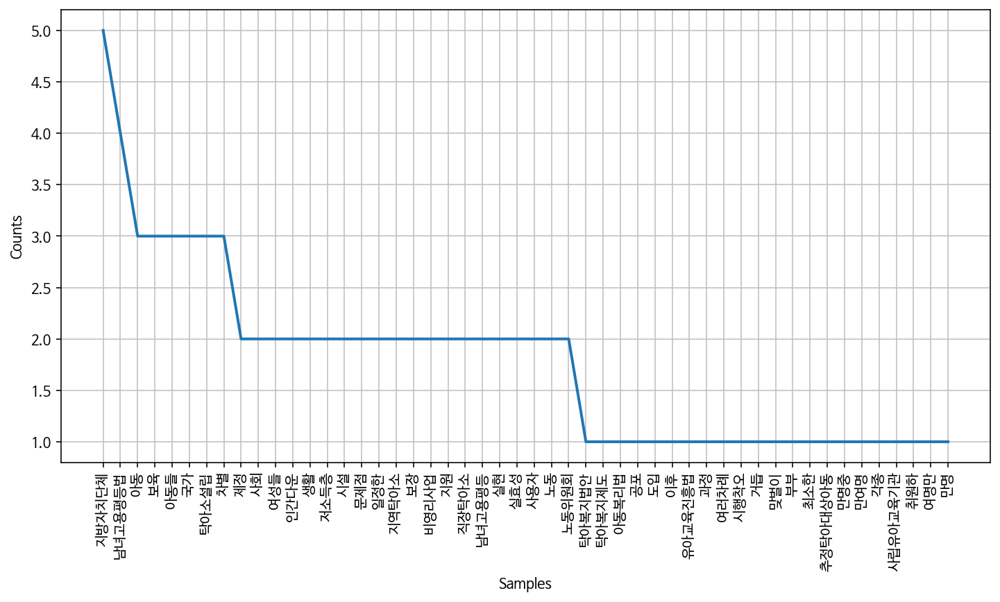

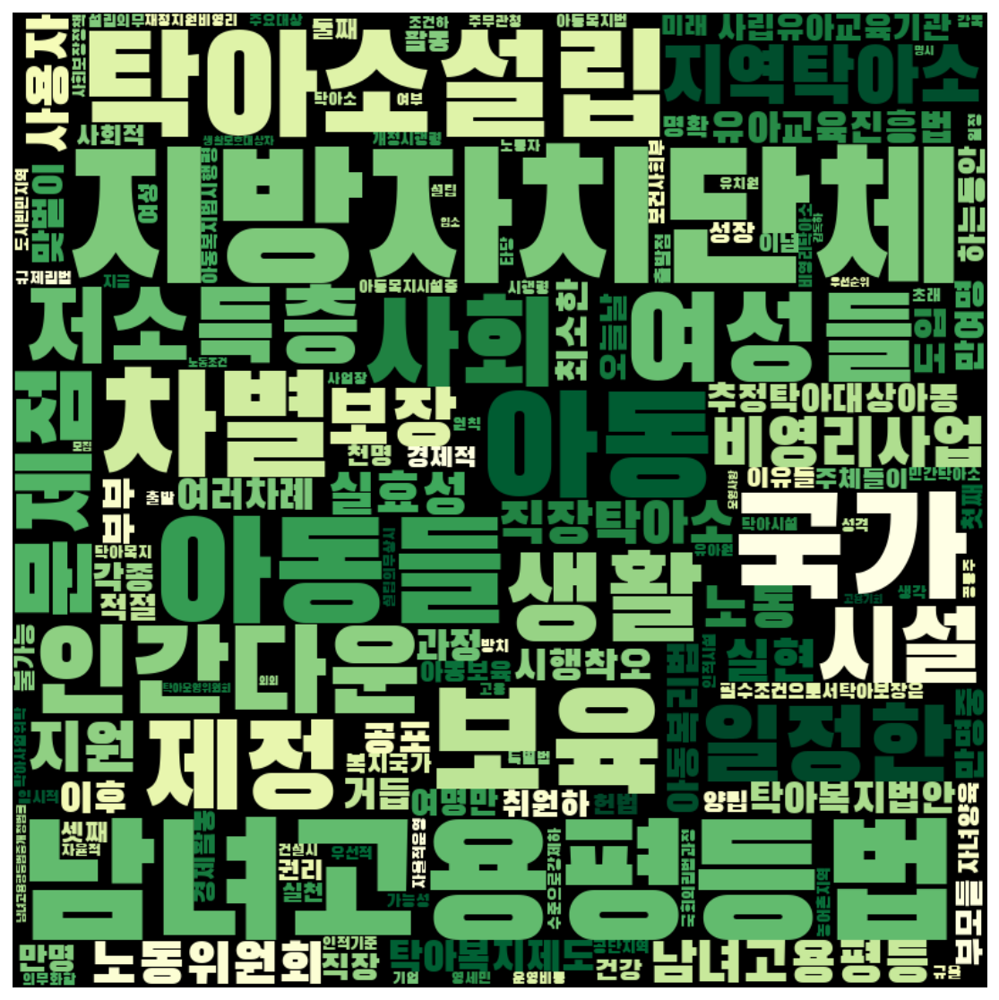

In [22]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

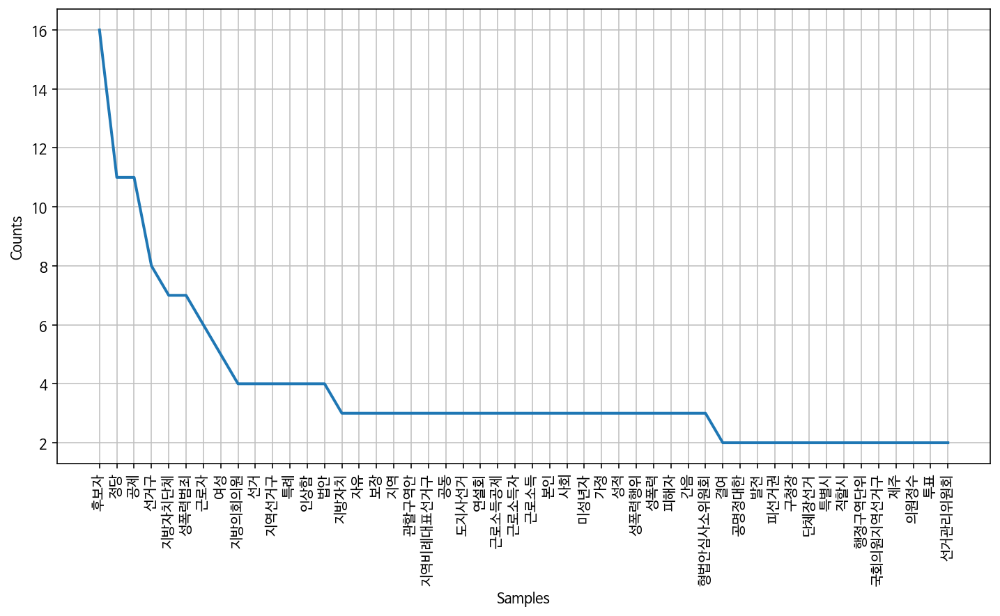

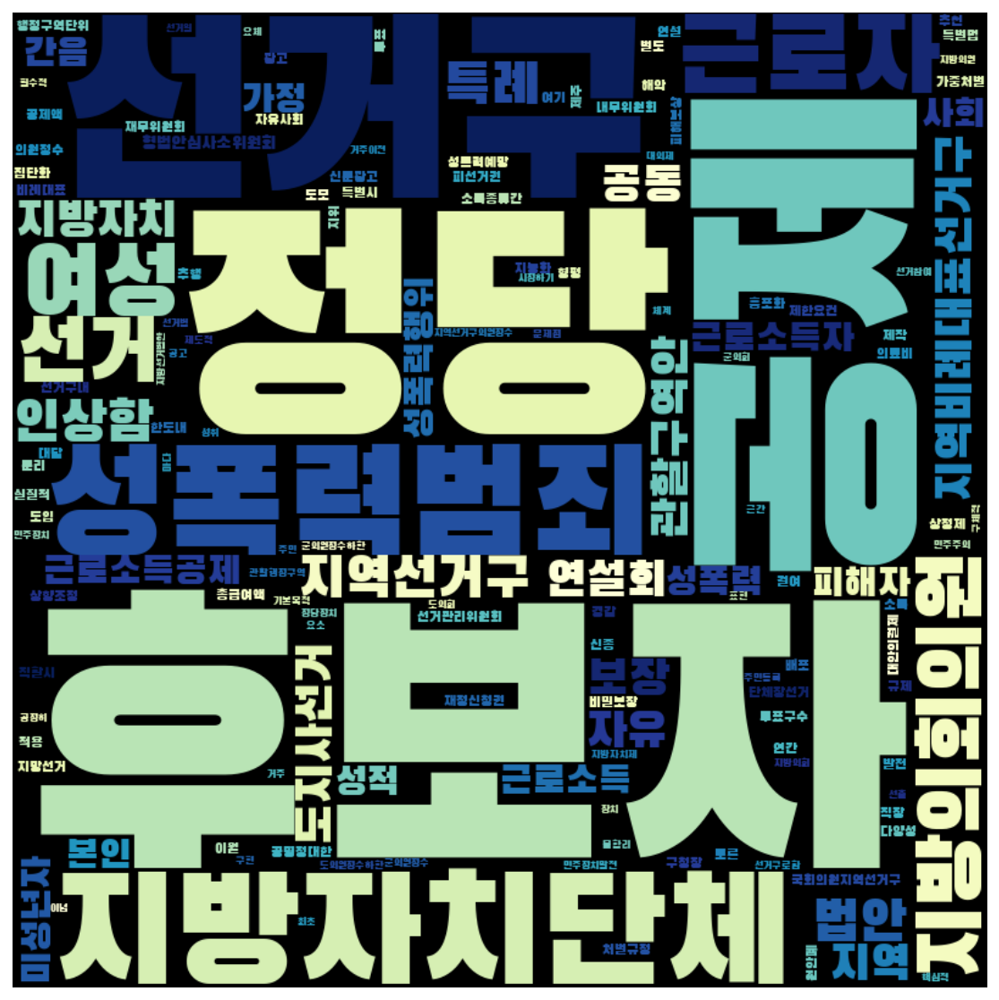

In [23]:
frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

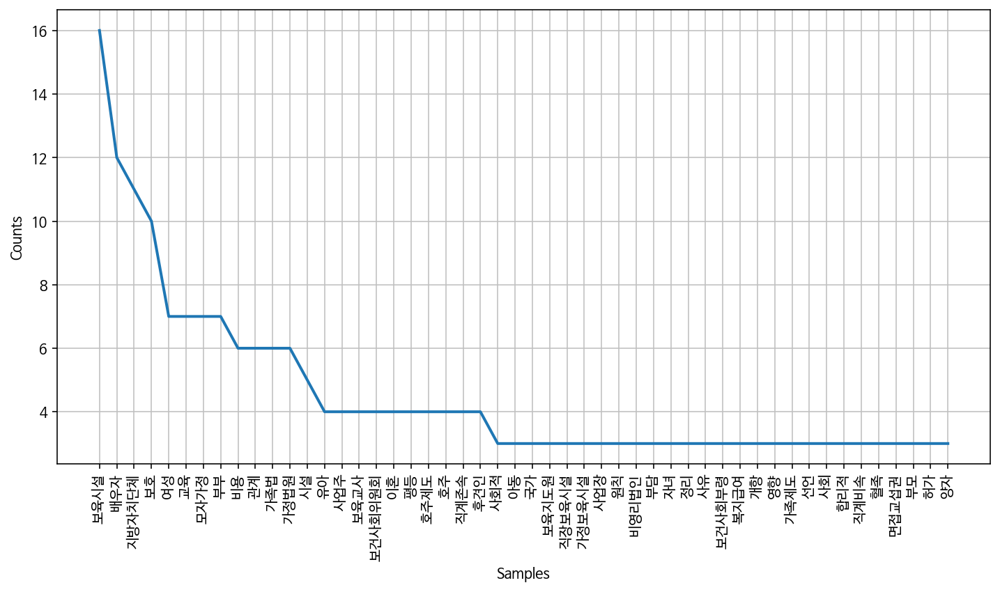

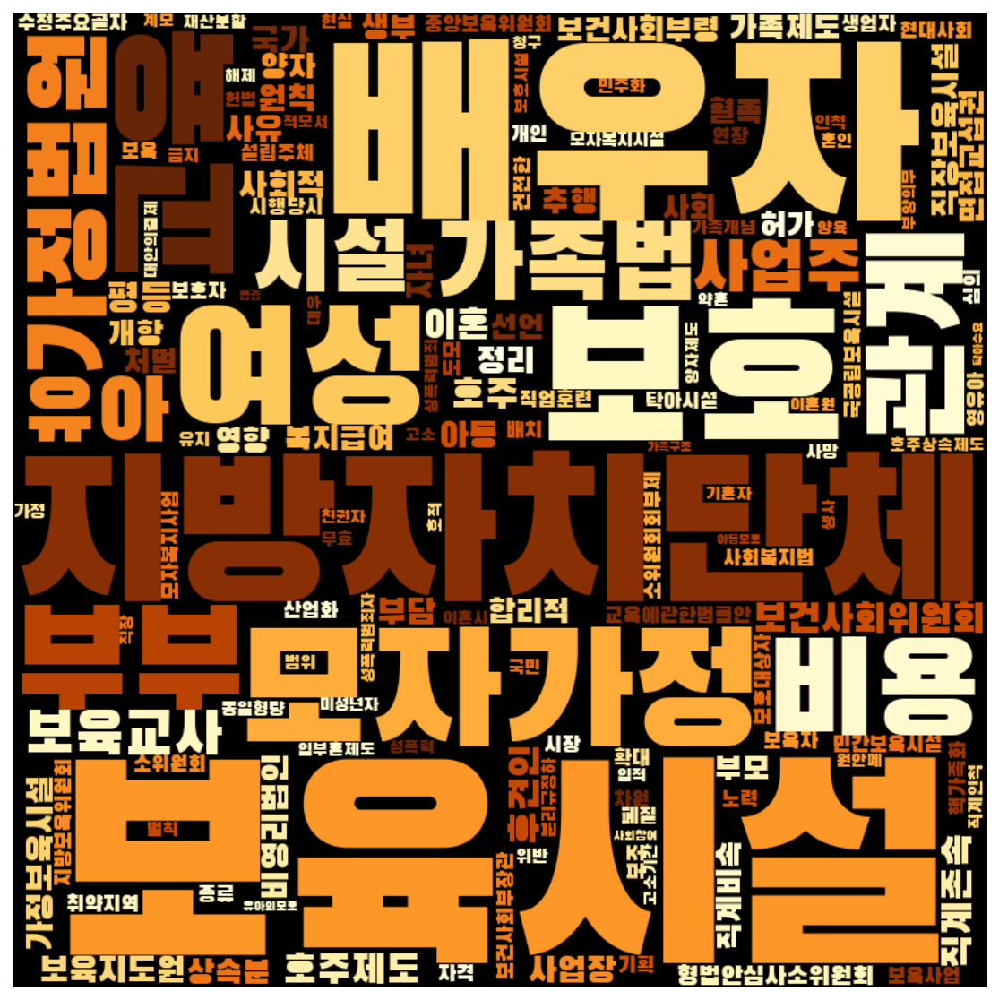

In [24]:
frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

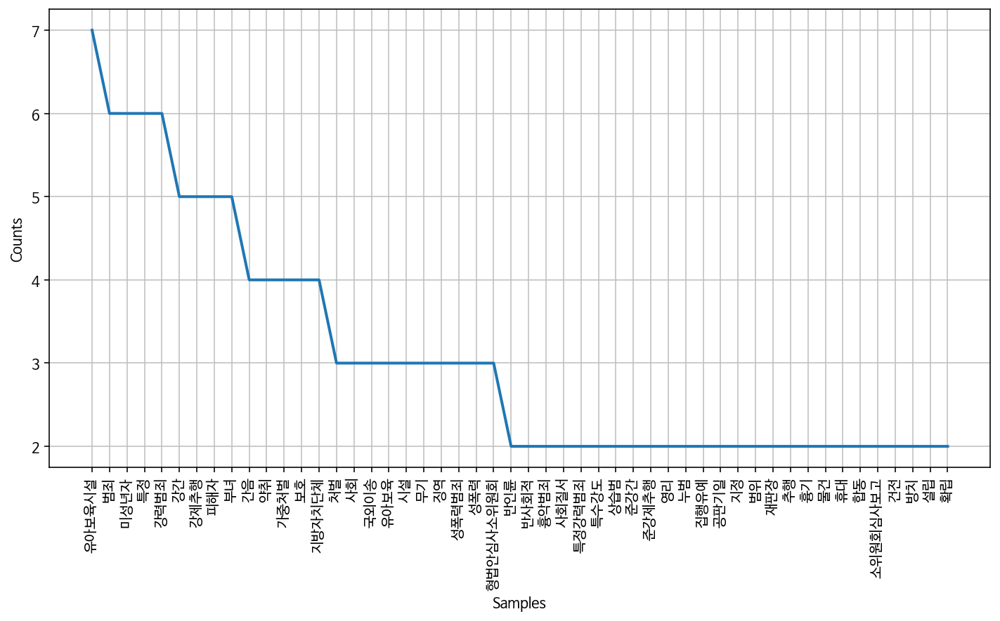

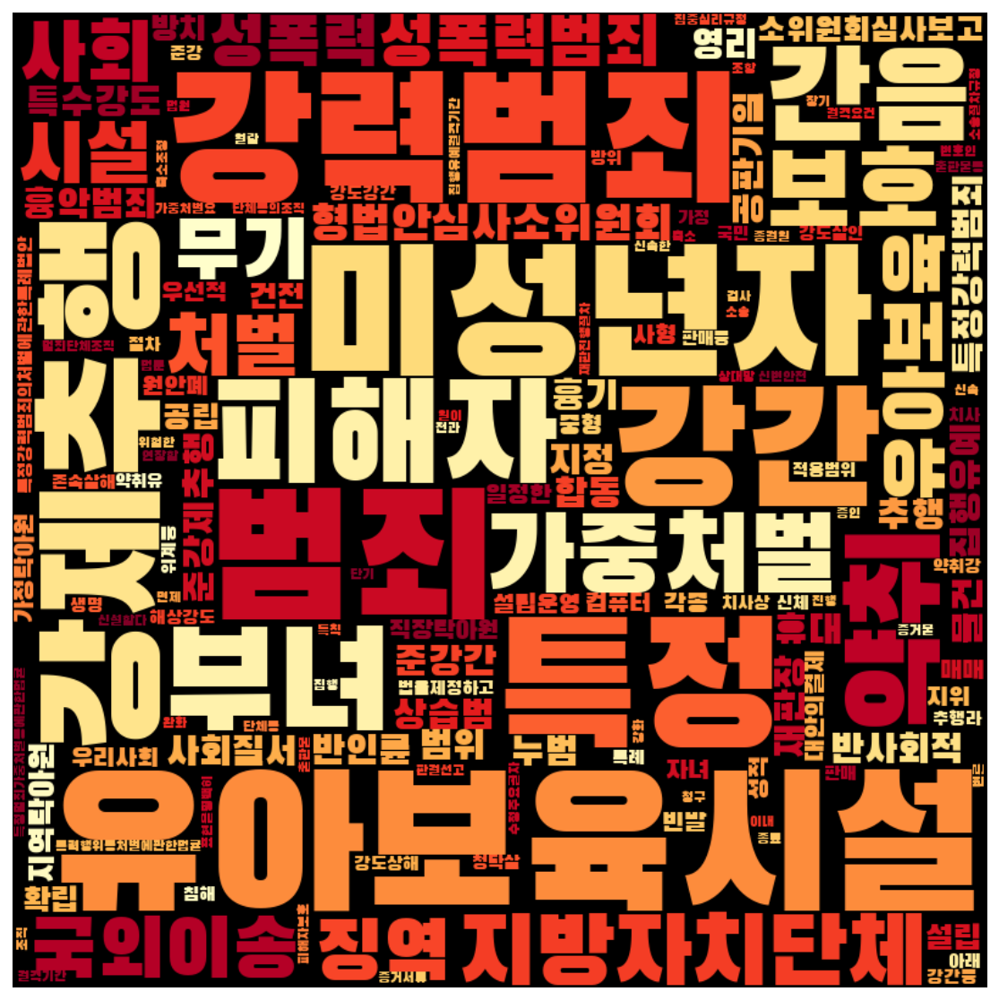

In [25]:
frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

## 김영삼 정권 
- 1993.02.25 ~ 1998.02.24

In [26]:
kimyoungsam = gender[(gender['제안일자'] >= datetime.date(1993,2,25)) & 
                        (gender['제안일자'] <= datetime.date(1998,2,24))]
kimyoungsam.shape

(62, 19)

In [27]:
kimyoungsam['성별'].value_counts()

남성    25
여성    15
Name: 성별, dtype: int64

In [28]:
pd.DataFrame(kimyoungsam.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    9
     여성    9
진보   남성   16
     여성    6

In [29]:
pro_women = kimyoungsam[(kimyoungsam['성별'] == '여성') & (kimyoungsam['정당성향'] == '진보')]
pro_men = kimyoungsam[(kimyoungsam['성별'] == '남성') & (kimyoungsam['정당성향'] == '진보')]
con_women = kimyoungsam[(kimyoungsam['성별'] == '여성') & (kimyoungsam['정당성향'] == '보수')]
con_men = kimyoungsam[(kimyoungsam['성별'] == '남성') & (kimyoungsam['정당성향'] == '보수')]

In [30]:
pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

In [31]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','만원이하','세부담',
            '현재','보고','중요','규정함','계산시','다음','퍼센트','기능']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

In [44]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
ko_pro_men = nltk.Text(pro_men_word, name='진보 남성')
ko_con_women = nltk.Text(con_women_word, name='보수 여성')
ko_con_men = nltk.Text(con_men_word, name='보수 남성')

print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 1
젠더 단어 수: 0

남녀평등 단어 수: 1
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 0
아동 단어 수: 5
###################
부녀 단어 수: 0
여자 단어 수: 1
여성 단어 수: 15
젠더 단어 수: 0

남녀평등 단어 수: 4
양성평등 단어 수: 1
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 20
아동 단어 수: 0
###################
부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 14
젠더 단어 수: 0

남녀평등 단어 수: 5
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 1
아동 단어 수: 3
###################
부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 9
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 13
아동 단어 수: 2


In [45]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 0

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 2
성희롱 단어 수: 1
성폭력 단어 수: 2
성폭력범죄 단어 수: 7

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 27

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 2

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 1
강간 단어 수: 0
성희롱 단어 수: 3
성폭력 단어 수: 0
성폭력범죄 단어 수: 1

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 1

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 4
보육 단어 수: 2

위안부 단어 수: 6
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 2
성희롱 단어 수: 4
성폭력 단어 수: 4
성폭력범죄 단어 수: 2

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 5

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 0

위안부 

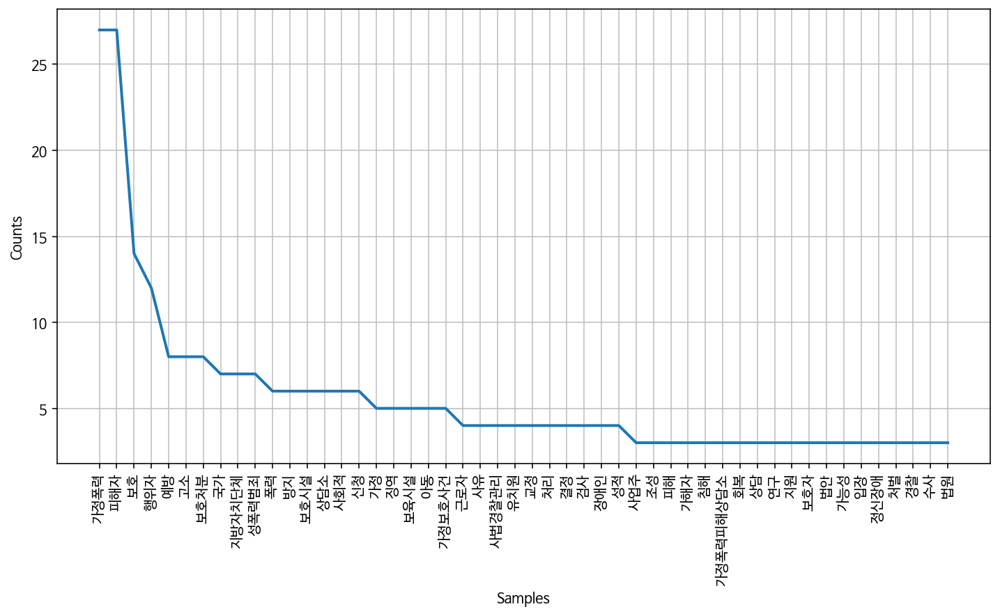

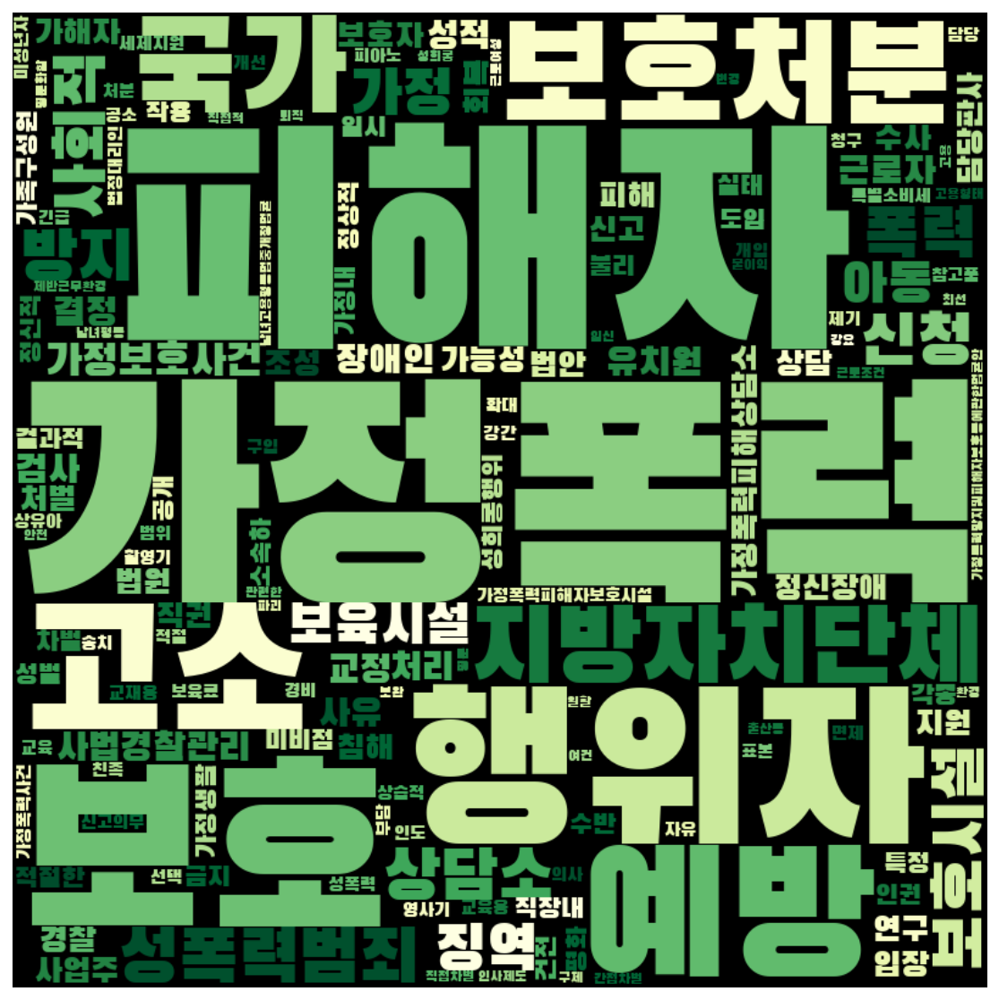

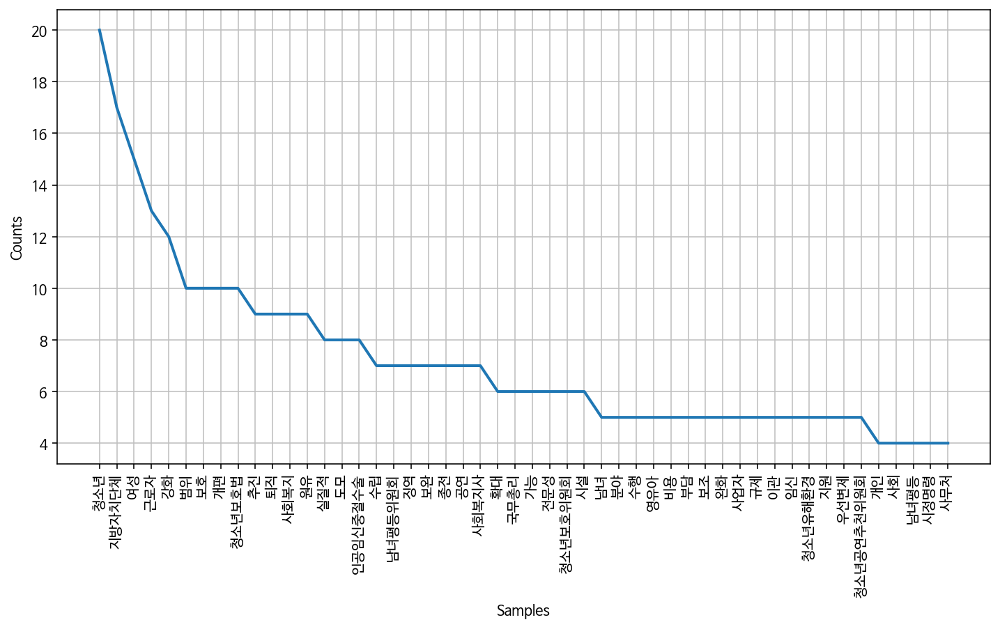

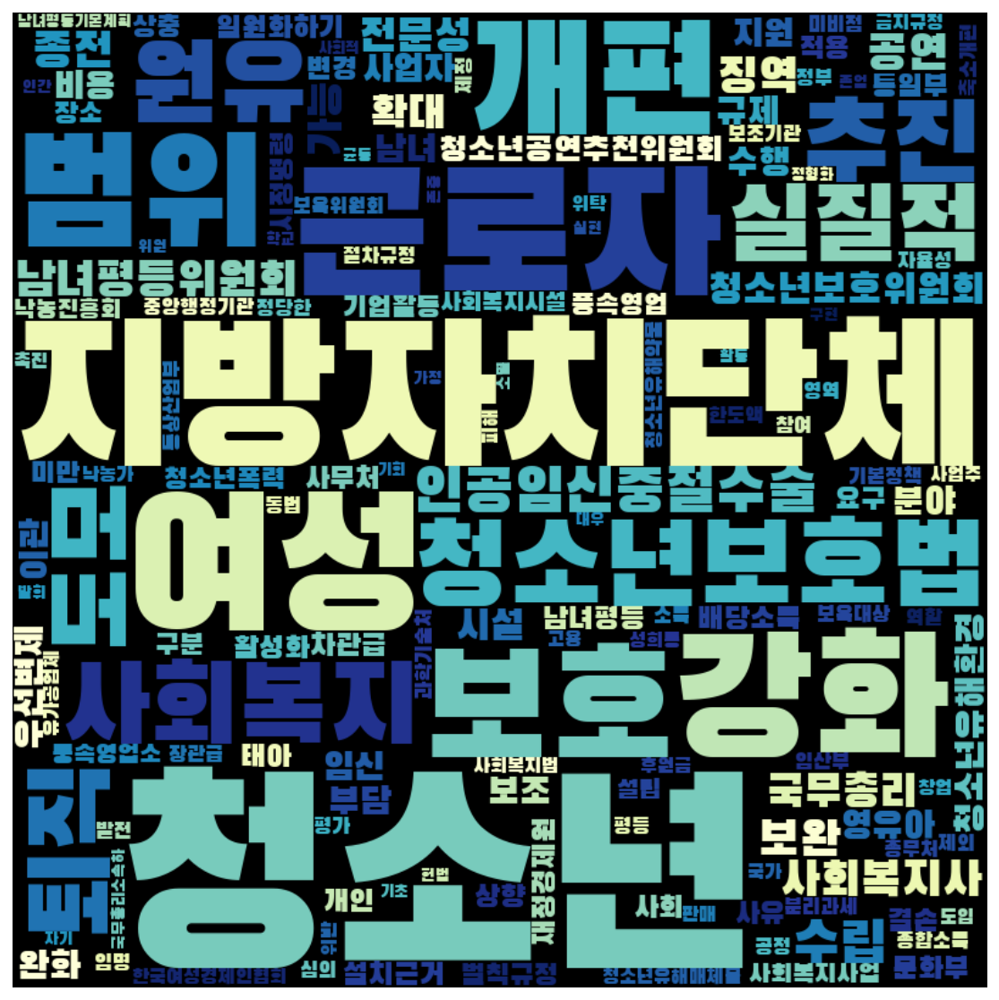

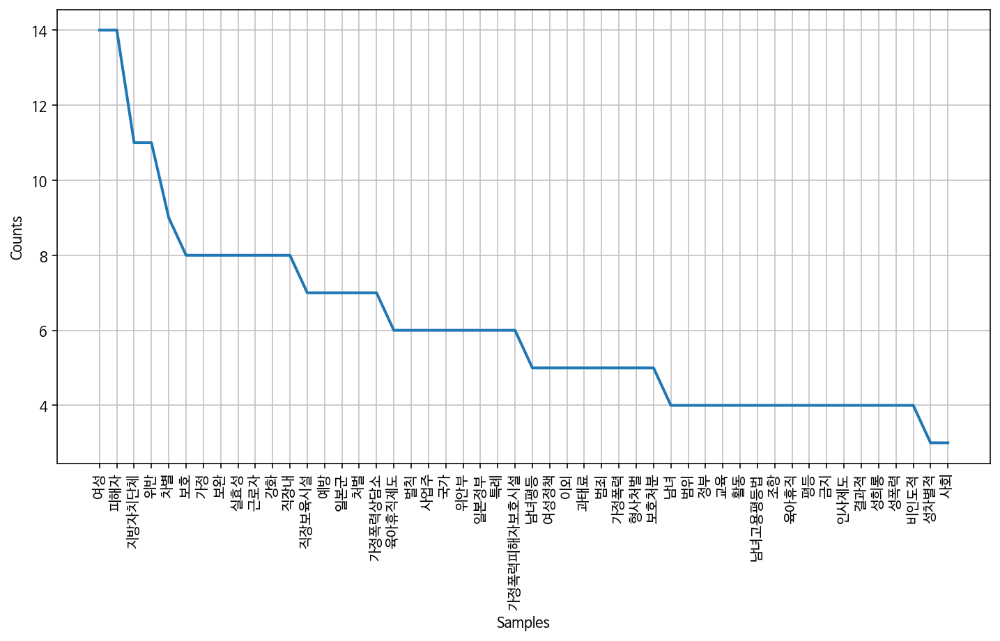

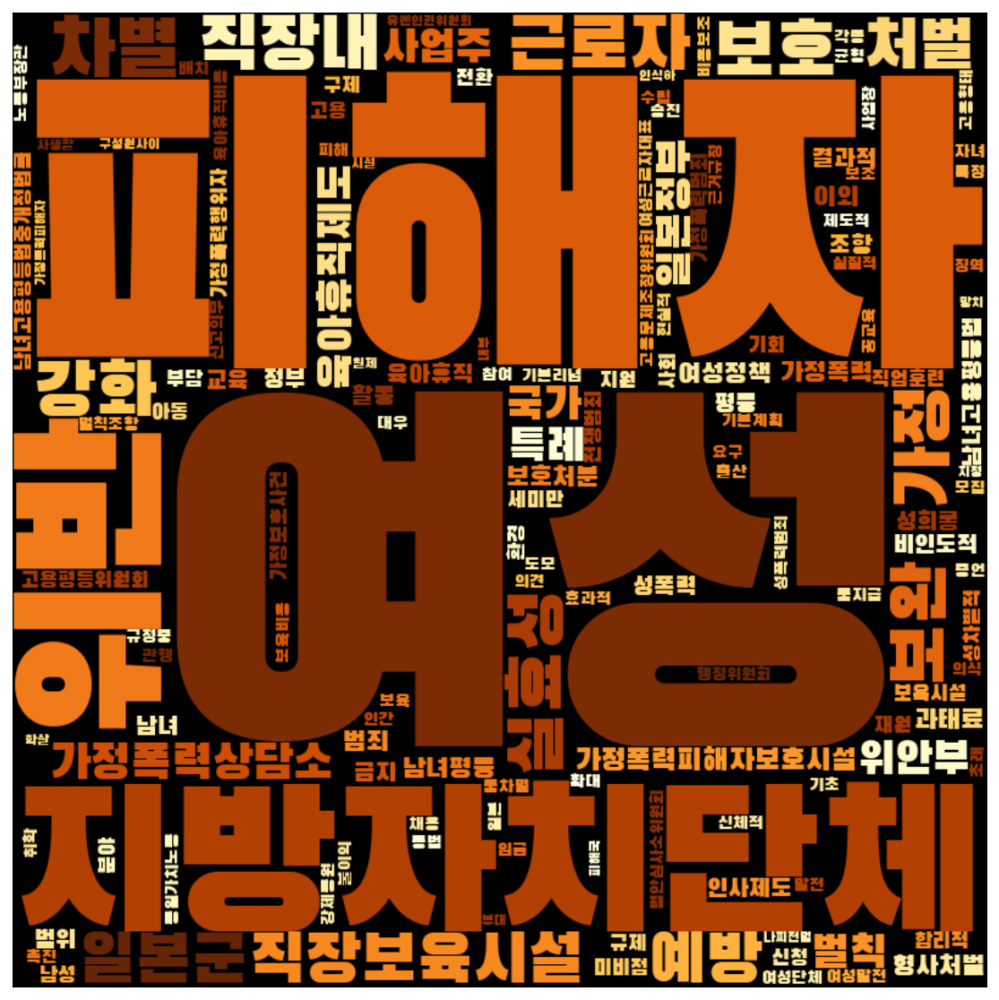

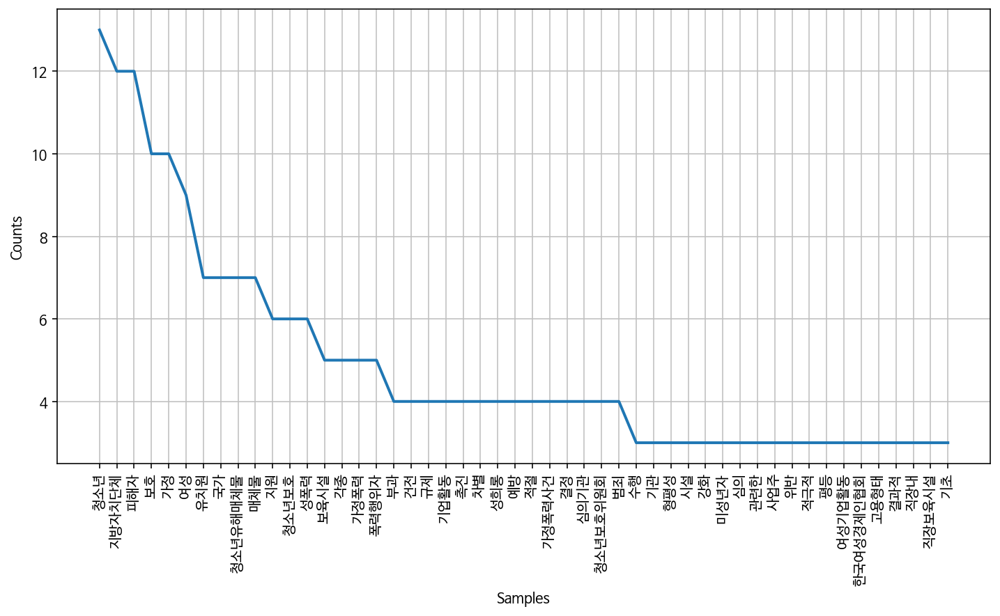

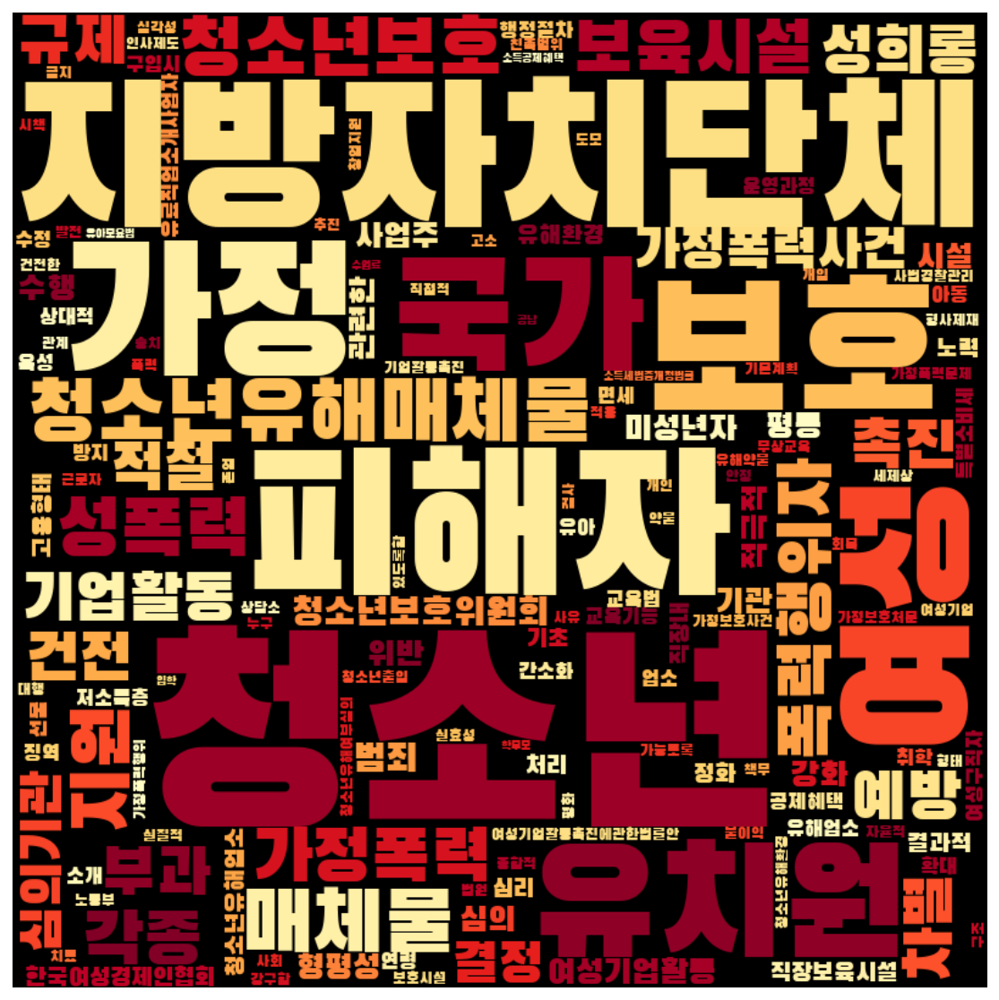

In [33]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

## 김대중 정권 
- 1998.02.25 ~ 2003.02.24

In [34]:
kimdaejoong = gender[(gender['제안일자'] >= datetime.date(1998,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2003,2,24))]
kimdaejoong.shape

(92, 19)

In [35]:
kimdaejoong['성별'].value_counts()

남성    31
여성    23
Name: 성별, dtype: int64

In [36]:
pd.DataFrame(kimdaejoong.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   22
     여성   16
진보   남성    7
     여성    7

In [37]:
pro_women = kimdaejoong[(kimdaejoong['성별'] == '여성') & (kimdaejoong['정당성향'] == '진보')]
pro_men = kimdaejoong[(kimdaejoong['성별'] == '남성') & (kimdaejoong['정당성향'] == '진보')]
con_women = kimdaejoong[(kimdaejoong['성별'] == '여성') & (kimdaejoong['정당성향'] == '보수')]
con_men = kimdaejoong[(kimdaejoong['성별'] == '남성') & (kimdaejoong['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','수립','보완','규정함',
            '회부','수정','법안심사소위원회','개선','범위','대안']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]


In [38]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
ko_pro_men = nltk.Text(pro_men_word, name='진보 남성')
ko_con_women = nltk.Text(con_women_word, name='보수 여성')
ko_con_men = nltk.Text(con_men_word, name='보수 남성')

print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 6
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 1
아동 단어 수: 0
###################
부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 2
젠더 단어 수: 0

남녀평등 단어 수: 3
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 95
아동 단어 수: 104
###################
부녀 단어 수: 0
여자 단어 수: 2
여성 단어 수: 17
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 28
아동 단어 수: 2
###################
부녀 단어 수: 0
여자 단어 수: 1
여성 단어 수: 27
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 11
아동 단어 수: 3


In [51]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 3
보육 단어 수: 0

위안부 단어 수: 0
일본군성노예제 단어 수: 12

성범죄 단어 수: 0
강간 단어 수: 2
성희롱 단어 수: 6
성폭력 단어 수: 0
성폭력범죄 단어 수: 0

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 5

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 7

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 0
성희롱 단어 수: 2
성폭력 단어 수: 0
성폭력범죄 단어 수: 0

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 4

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 3

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 11
보육 단어 수: 0

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 0
강간 단어 수: 0
성희롱 단어 수: 0
성폭력 단어 수: 4
성폭력범죄 단어 수: 2

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 0

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 1
보육 단어 수: 13

위안

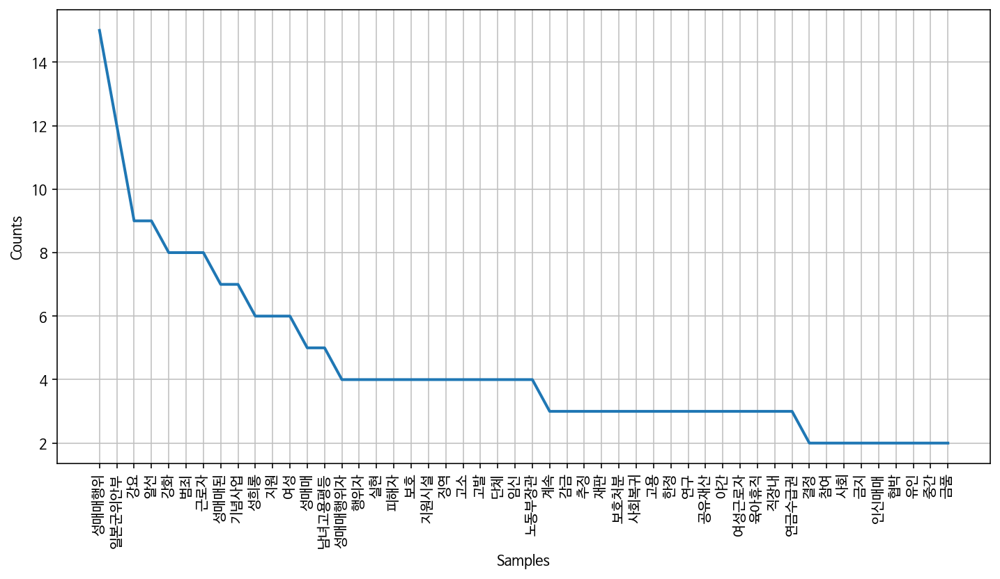

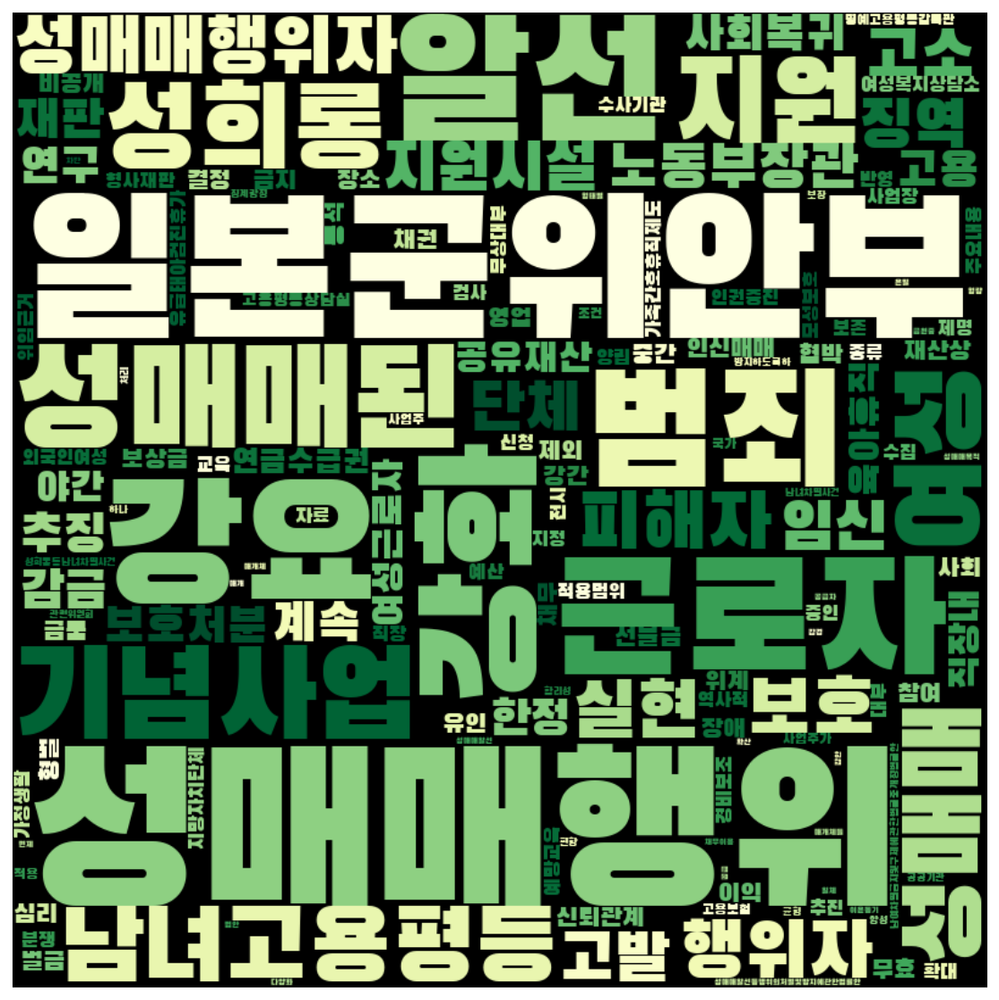

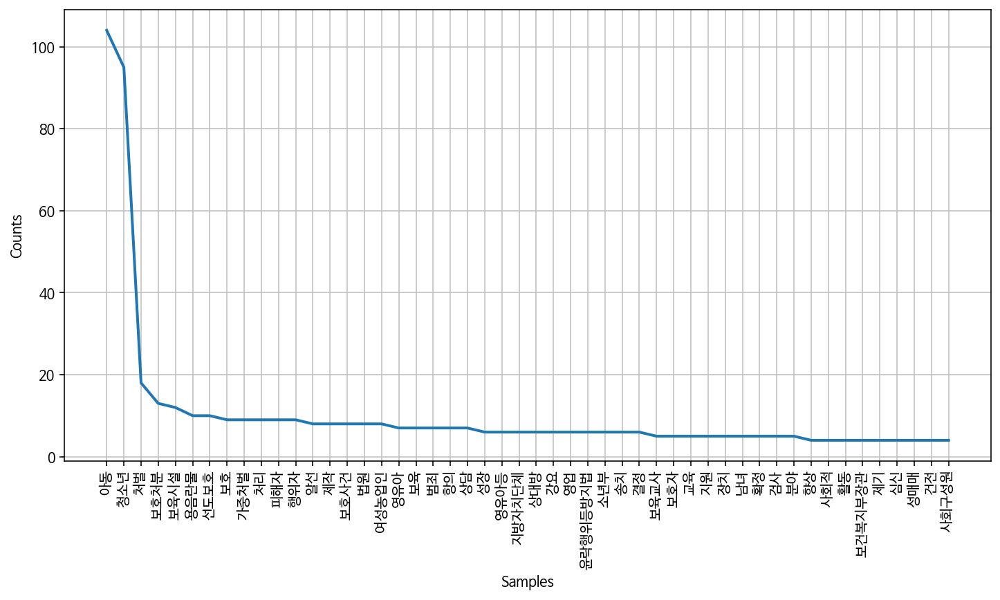

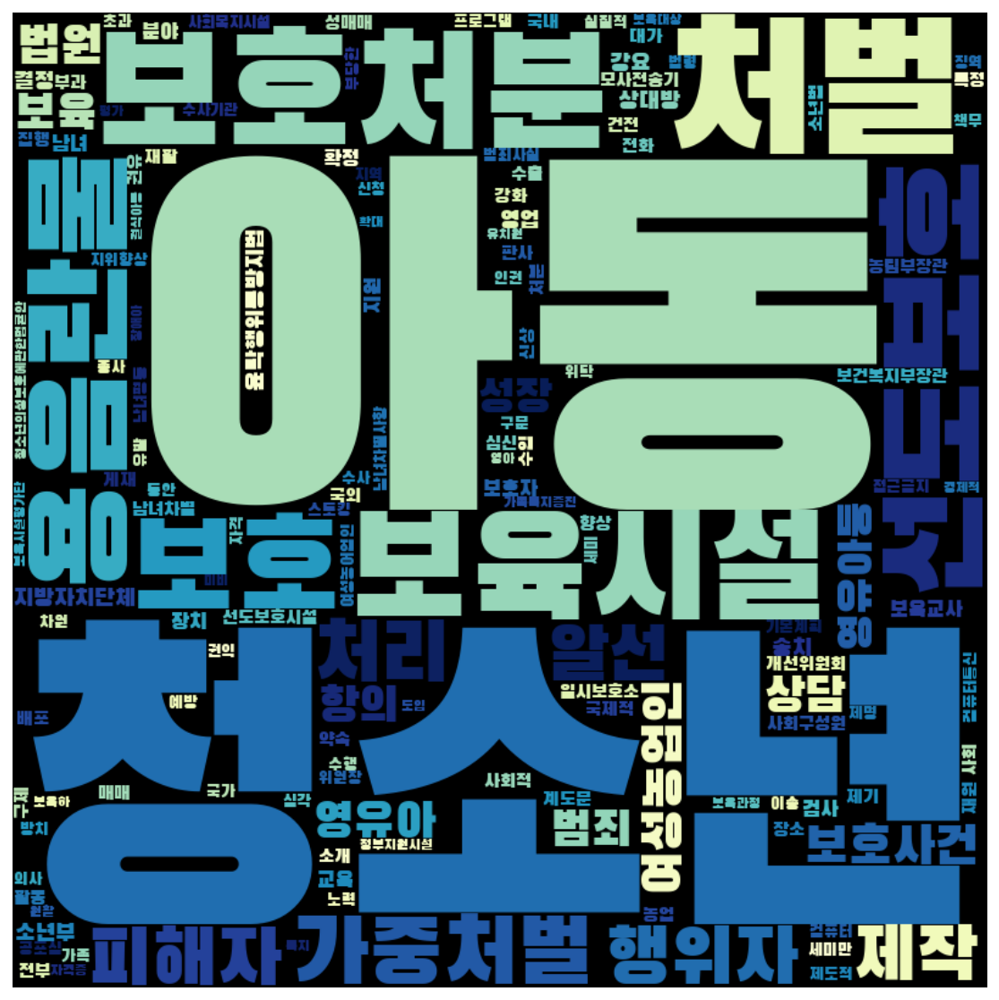

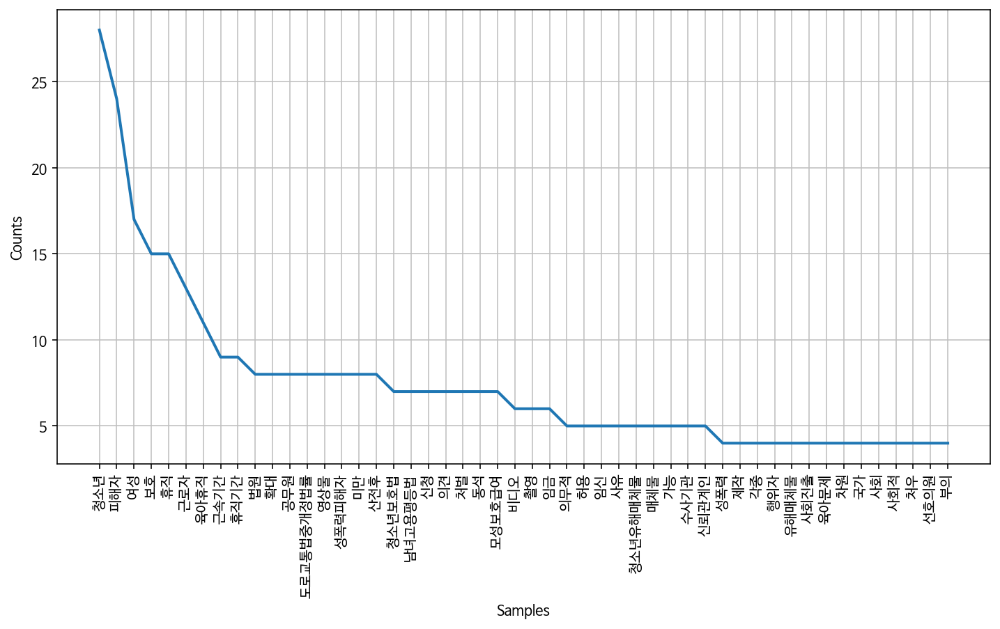

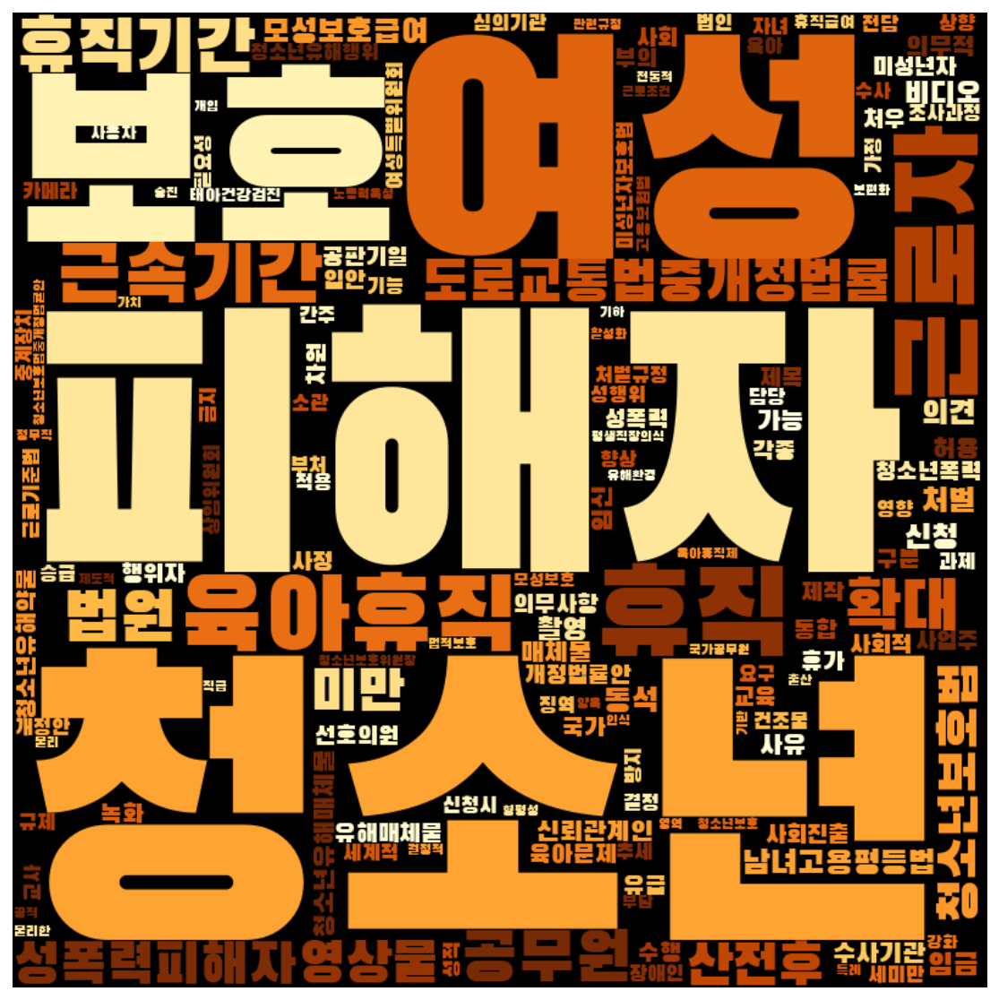

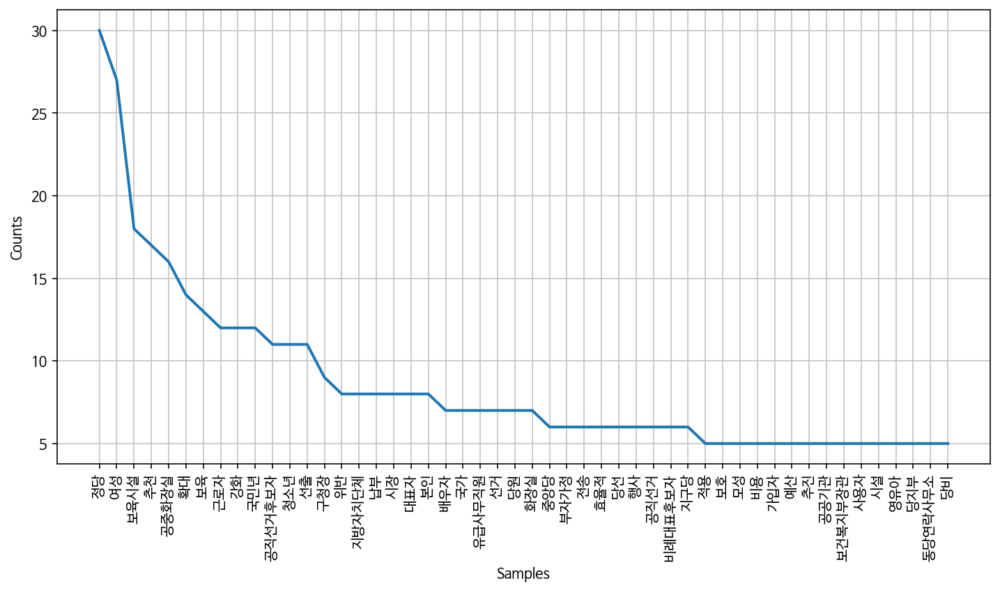

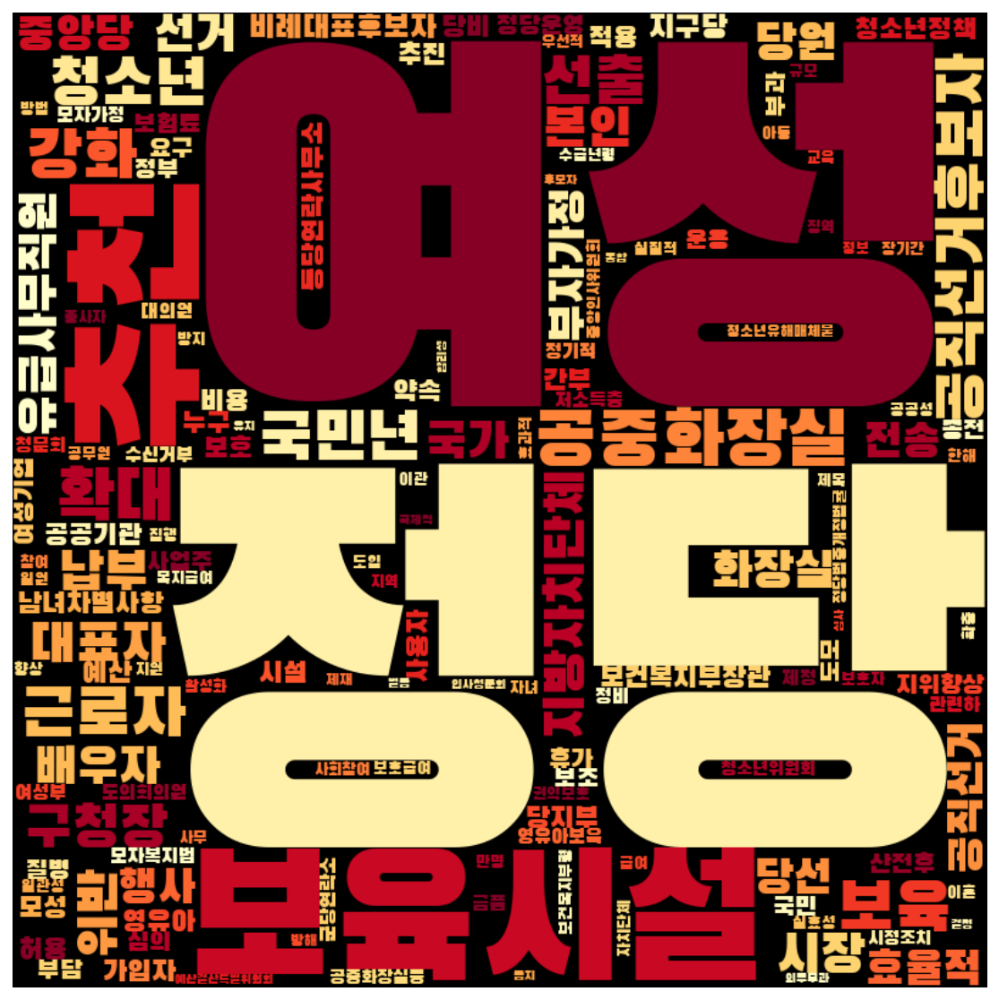

In [39]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

## 노무현 정권  
- 2003.02.25 ~ 2004.04.14

In [40]:
romoohyun = gender[(gender['제안일자'] >= datetime.date(2003,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2008,2,24))]
romoohyun.shape

(447, 19)

In [41]:
romoohyun['성별'].value_counts()

여성    182
남성    165
Name: 성별, dtype: int64

In [42]:
pd.DataFrame(romoohyun.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   86
     여성   97
진보   남성   77
     여성   85

In [43]:
pro_women = romoohyun[(romoohyun['성별'] == '여성') & (romoohyun['정당성향'] == '진보')]
print(pro_women.shape)
pro_men = romoohyun[(romoohyun['성별'] == '남성') & (romoohyun['정당성향'] == '진보')]
print(pro_men.shape)
con_women = romoohyun[(romoohyun['성별'] == '여성') & (romoohyun['정당성향'] == '보수')]
print(con_women.shape)
con_men = romoohyun[(romoohyun['성별'] == '남성') & (romoohyun['정당성향'] == '보수')]
print(con_men.shape)

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장',
            '범위','수립','대안','변경']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]


(85, 19)
(77, 19)
(97, 19)
(86, 19)


In [56]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
ko_pro_men = nltk.Text(pro_men_word, name='진보 남성')
ko_con_women = nltk.Text(con_women_word, name='보수 여성')
ko_con_men = nltk.Text(con_men_word, name='보수 남성')

print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 0
여자 단어 수: 5
여성 단어 수: 53
젠더 단어 수: 0

남녀평등 단어 수: 2
양성평등 단어 수: 3
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 25
아동 단어 수: 37
###################
부녀 단어 수: 0
여자 단어 수: 2
여성 단어 수: 37
젠더 단어 수: 0

남녀평등 단어 수: 3
양성평등 단어 수: 4
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 20
아동 단어 수: 10
###################
부녀 단어 수: 5
여자 단어 수: 3
여성 단어 수: 58
젠더 단어 수: 0

남녀평등 단어 수: 1
양성평등 단어 수: 4
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 16
아동 단어 수: 37
###################
부녀 단어 수: 0
여자 단어 수: 4
여성 단어 수: 45
젠더 단어 수: 0

남녀평등 단어 수: 1
양성평등 단어 수: 0
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 45
아동 단어 수: 27


In [57]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 3
가족법 단어 수: 0

저출산 단어 수: 13
육아휴직 단어 수: 25
보육 단어 수: 8

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 5
강간 단어 수: 10
성희롱 단어 수: 0
성폭력 단어 수: 13
성폭력범죄 단어 수: 39

윤락 단어 수: 0
윤락행위 단어 수: 1
기생관광 단어 수: 0
성매매 단어 수: 50

가정폭력 단어 수: 16

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 1
가족법 단어 수: 0

저출산 단어 수: 7
육아휴직 단어 수: 23
보육 단어 수: 5

위안부 단어 수: 2
일본군성노예제 단어 수: 0

성범죄 단어 수: 3
강간 단어 수: 0
성희롱 단어 수: 5
성폭력 단어 수: 7
성폭력범죄 단어 수: 17

윤락 단어 수: 0
윤락행위 단어 수: 1
기생관광 단어 수: 0
성매매 단어 수: 3

가정폭력 단어 수: 17

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 32

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 2
가족법 단어 수: 0

저출산 단어 수: 36
육아휴직 단어 수: 17
보육 단어 수: 13

위안부 단어 수: 0
일본군성노예제 단어 수: 15

성범죄 단어 수: 15
강간 단어 수: 5
성희롱 단어 수: 10
성폭력 단어 수: 19
성폭력범죄 단어 수: 11

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 21

가정폭력 단어 수: 10

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 15
육아휴직 단어 

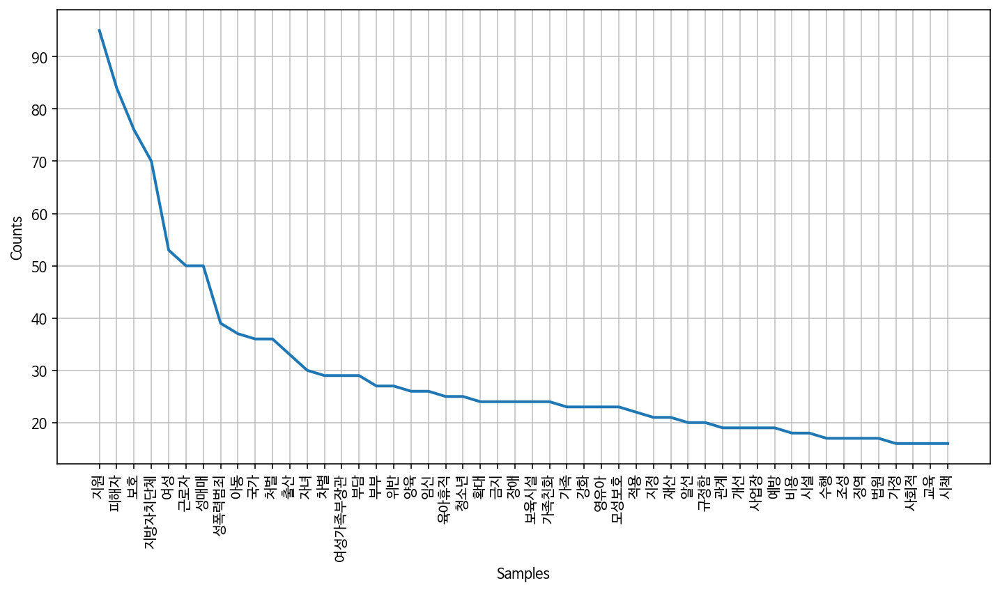

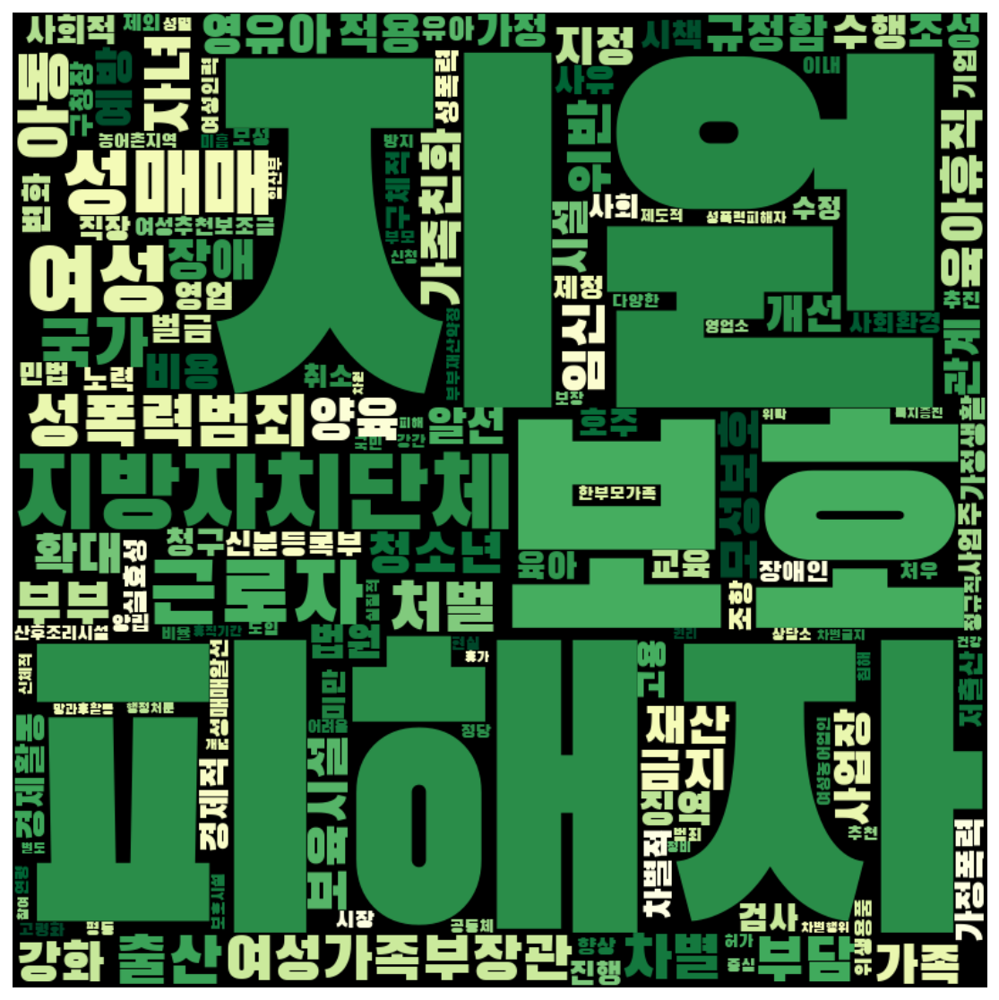

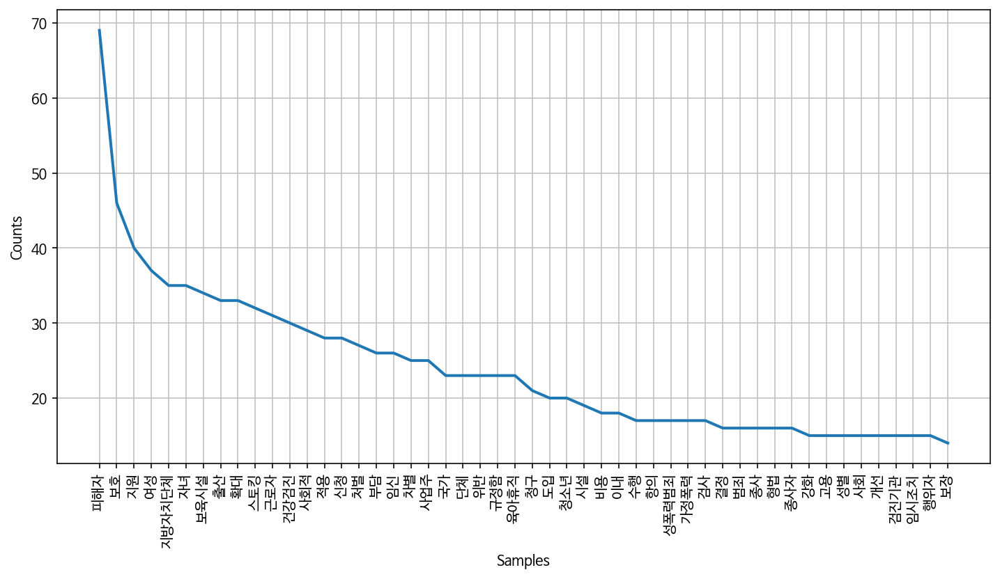

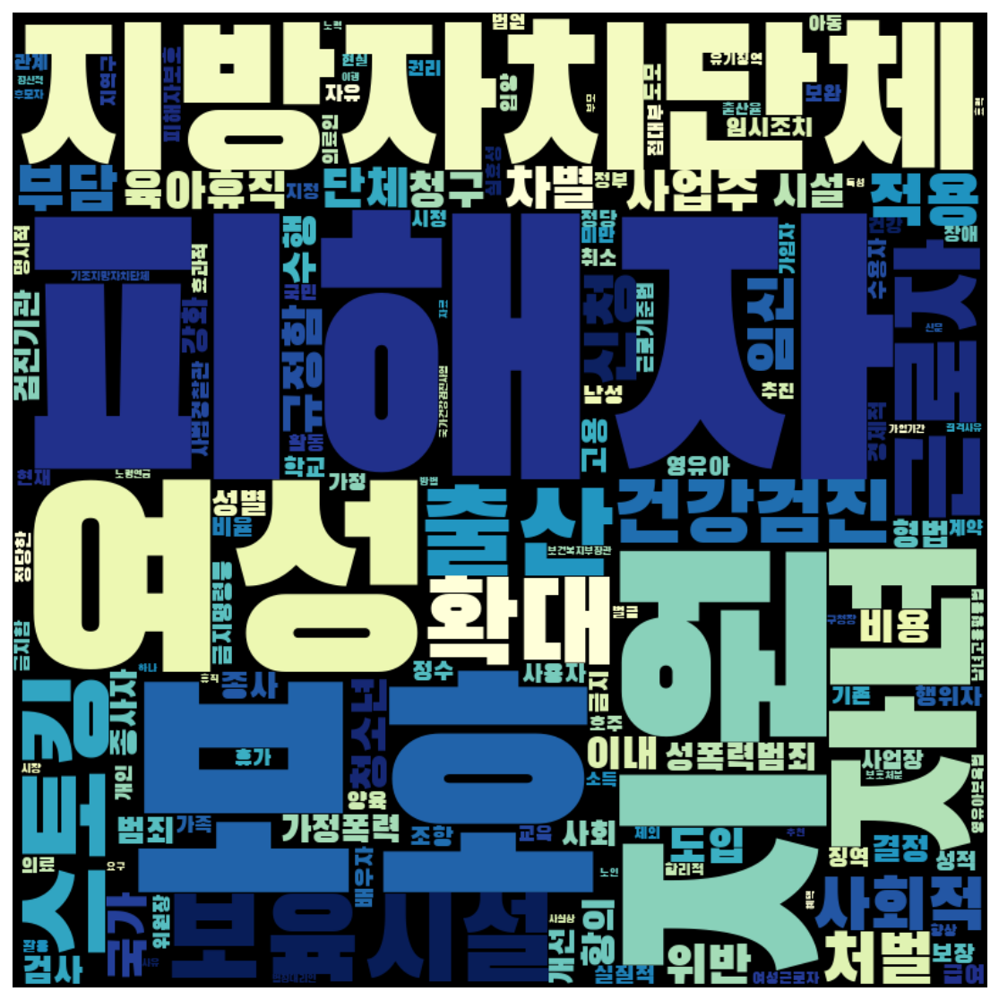

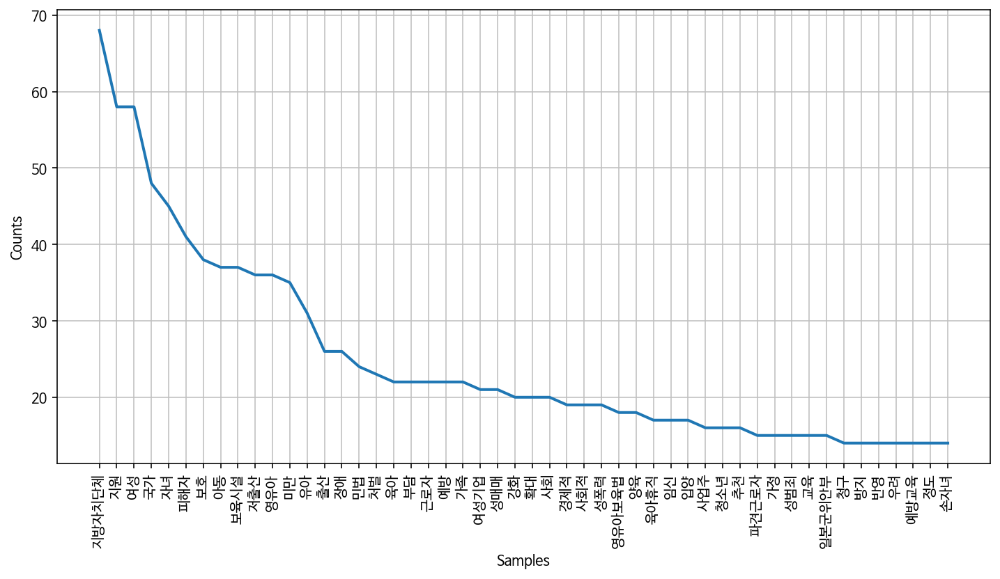

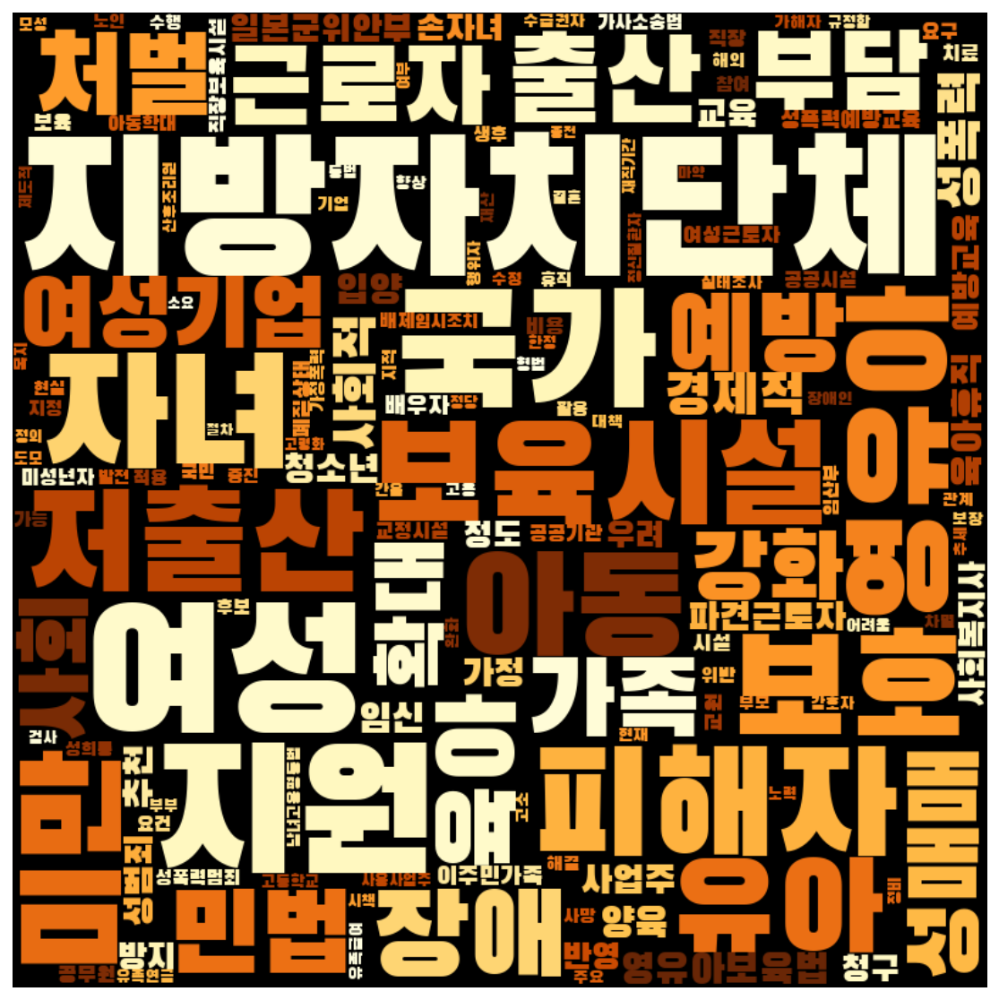

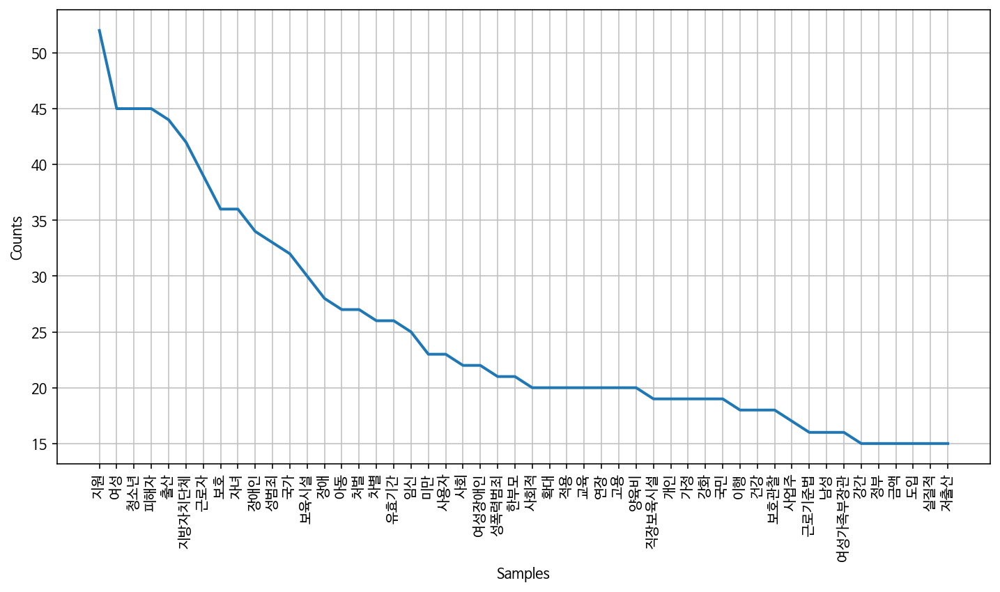

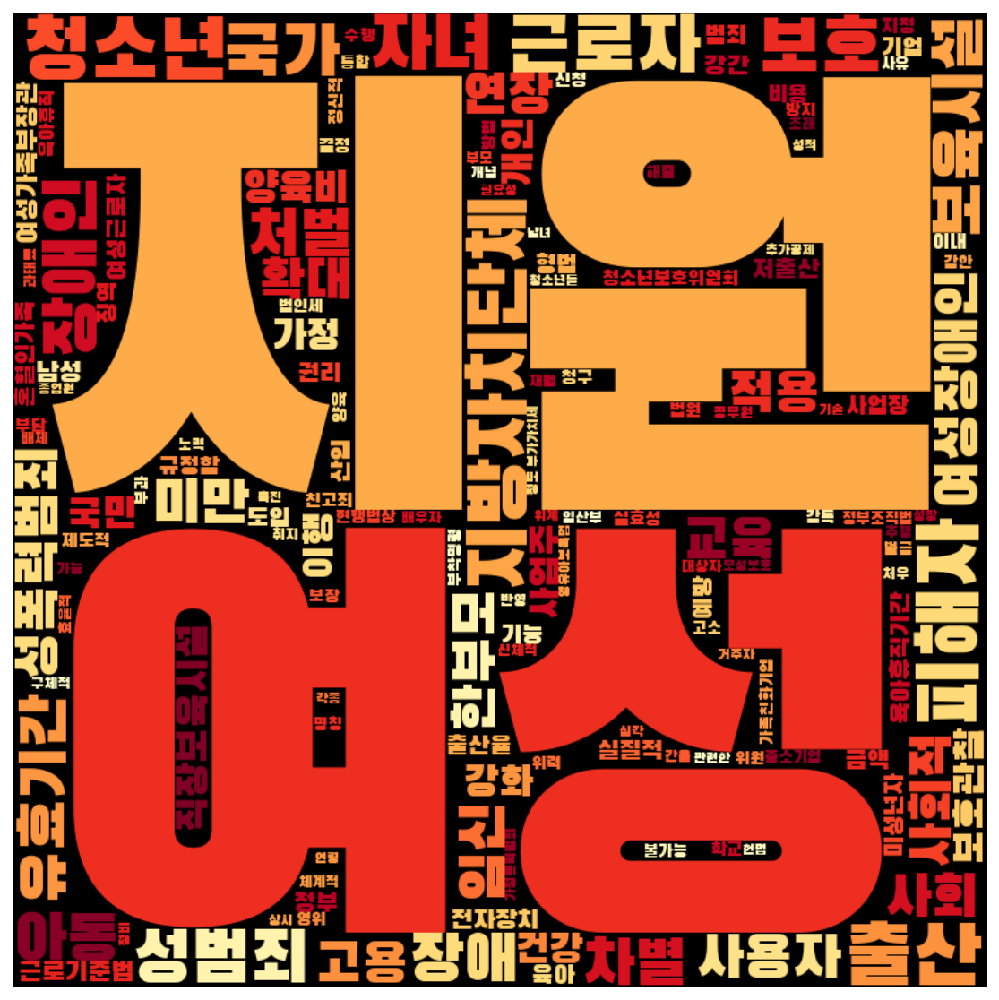

In [44]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [50]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-24 14:16:47,348 : INFO : collecting all words and their counts
2020-10-24 14:16:47,351 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-24 14:16:47,356 : INFO : collected 2688 word types from a corpus of 8305 raw words and 85 sentences
2020-10-24 14:16:47,357 : INFO : Loading a fresh vocabulary
2020-10-24 14:16:47,360 : INFO : effective_min_count=10 retains 155 unique words (5% of original 2688, drops 2533)
2020-10-24 14:16:47,363 : INFO : effective_min_count=10 leaves 3058 word corpus (36% of original 8305, drops 5247)
2020-10-24 14:16:47,365 : INFO : deleting the raw counts dictionary of 2688 items
2020-10-24 14:16:47,367 : INFO : sample=0.001 downsamples 155 most-common words
2020-10-24 14:16:47,367 : INFO : downsampling leaves estimated 1623 word corpus (53.1% of prior 3058)
2020-10-24 14:16:47,369 : INFO : estimated required memory for 155 words and 100 dimensions: 201500 bytes
2020-10-24 14:16:47,370 : INFO : resetting layer weights
2020-

2020-10-24 14:16:47,691 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:47,699 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:47,700 : INFO : EPOCH - 15 : training on 8305 raw words (1611 effective words) took 0.0s, 115750 effective words/s
2020-10-24 14:16:47,705 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:47,707 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:47,712 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:47,715 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:47,718 : INFO : EPOCH - 16 : training on 8305 raw words (1612 effective words) took 0.0s, 119450 effective words/s
2020-10-24 14:16:47,722 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:47,725 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-

2020-10-24 14:16:48,014 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,015 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,017 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,024 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,025 : INFO : EPOCH - 32 : training on 8305 raw words (1651 effective words) took 0.0s, 144328 effective words/s
2020-10-24 14:16:48,032 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,038 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,045 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,046 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,049 : INFO : EPOCH - 33 : training on 8305 raw words (1612 effective words) took 0.0s, 89022 effective words/s
2020-10-2

2020-10-24 14:16:48,311 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,313 : INFO : EPOCH - 48 : training on 8305 raw words (1649 effective words) took 0.0s, 149133 effective words/s
2020-10-24 14:16:48,318 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,320 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,323 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,331 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,332 : INFO : EPOCH - 49 : training on 8305 raw words (1582 effective words) took 0.0s, 116725 effective words/s
2020-10-24 14:16:48,344 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,348 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,349 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-

2020-10-24 14:16:48,632 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,633 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,635 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,636 : INFO : EPOCH - 65 : training on 8305 raw words (1633 effective words) took 0.0s, 236245 effective words/s
2020-10-24 14:16:48,646 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,648 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,651 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,652 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,655 : INFO : EPOCH - 66 : training on 8305 raw words (1672 effective words) took 0.0s, 113097 effective words/s
2020-10-24 14:16:48,665 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-24 14:16:48,914 : INFO : EPOCH - 81 : training on 8305 raw words (1635 effective words) took 0.0s, 125767 effective words/s
2020-10-24 14:16:48,921 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,927 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,929 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,931 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:48,932 : INFO : EPOCH - 82 : training on 8305 raw words (1637 effective words) took 0.0s, 105462 effective words/s
2020-10-24 14:16:48,940 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:48,947 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:48,951 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:48,954 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-

2020-10-24 14:16:49,274 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:49,283 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:49,285 : INFO : EPOCH - 98 : training on 8305 raw words (1623 effective words) took 0.0s, 112822 effective words/s
2020-10-24 14:16:49,296 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:49,300 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:49,301 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:49,304 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:49,305 : INFO : EPOCH - 99 : training on 8305 raw words (1607 effective words) took 0.0s, 172655 effective words/s
2020-10-24 14:16:49,312 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:49,323 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-

2020-10-24 14:16:49,599 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:49,603 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:49,604 : INFO : EPOCH - 12 : training on 7809 raw words (1151 effective words) took 0.0s, 142360 effective words/s
2020-10-24 14:16:49,608 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:49,609 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:49,609 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:49,616 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:49,617 : INFO : EPOCH - 13 : training on 7809 raw words (1178 effective words) took 0.0s, 126410 effective words/s
2020-10-24 14:16:49,621 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:49,623 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-

2020-10-24 14:16:49,802 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:49,803 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:49,804 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:49,811 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:49,812 : INFO : EPOCH - 29 : training on 7809 raw words (1126 effective words) took 0.0s, 120261 effective words/s
2020-10-24 14:16:49,816 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:49,817 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:49,817 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:49,823 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:49,824 : INFO : EPOCH - 30 : training on 7809 raw words (1154 effective words) took 0.0s, 121838 effective words/s
2020-10-

2020-10-24 14:16:50,086 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,088 : INFO : EPOCH - 45 : training on 7809 raw words (1124 effective words) took 0.0s, 80553 effective words/s
2020-10-24 14:16:50,094 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,101 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,104 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,105 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,106 : INFO : EPOCH - 46 : training on 7809 raw words (1124 effective words) took 0.0s, 81503 effective words/s
2020-10-24 14:16:50,110 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,114 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,118 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24

2020-10-24 14:16:50,370 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,372 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,374 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,376 : INFO : EPOCH - 62 : training on 7809 raw words (1110 effective words) took 0.0s, 132963 effective words/s
2020-10-24 14:16:50,381 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,383 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,387 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,388 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,389 : INFO : EPOCH - 63 : training on 7809 raw words (1120 effective words) took 0.0s, 135248 effective words/s
2020-10-24 14:16:50,393 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-24 14:16:50,594 : INFO : EPOCH - 78 : training on 7809 raw words (1166 effective words) took 0.0s, 137684 effective words/s
2020-10-24 14:16:50,603 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,605 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,608 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,610 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,611 : INFO : EPOCH - 79 : training on 7809 raw words (1106 effective words) took 0.0s, 89016 effective words/s
2020-10-24 14:16:50,618 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,621 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,623 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,626 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-2

2020-10-24 14:16:50,915 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,917 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,922 : INFO : EPOCH - 95 : training on 7809 raw words (1150 effective words) took 0.0s, 41374 effective words/s
2020-10-24 14:16:50,925 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,935 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:50,942 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:50,943 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:50,945 : INFO : EPOCH - 96 : training on 7809 raw words (1164 effective words) took 0.0s, 60219 effective words/s
2020-10-24 14:16:50,949 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:50,959 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24

2020-10-24 14:16:51,230 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,231 : INFO : EPOCH - 9 : training on 6640 raw words (957 effective words) took 0.0s, 98792 effective words/s
2020-10-24 14:16:51,239 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,241 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,243 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,244 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,245 : INFO : EPOCH - 10 : training on 6640 raw words (940 effective words) took 0.0s, 142493 effective words/s
2020-10-24 14:16:51,249 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,250 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,251 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 1

2020-10-24 14:16:51,425 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,427 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,429 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,430 : INFO : EPOCH - 26 : training on 6640 raw words (965 effective words) took 0.0s, 85785 effective words/s
2020-10-24 14:16:51,437 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,439 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,441 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,443 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,445 : INFO : EPOCH - 27 : training on 6640 raw words (946 effective words) took 0.0s, 94064 effective words/s
2020-10-24 14:16:51,451 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 1

2020-10-24 14:16:51,665 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,668 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,669 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,670 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,671 : INFO : EPOCH - 43 : training on 6640 raw words (938 effective words) took 0.0s, 131003 effective words/s
2020-10-24 14:16:51,675 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,678 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,680 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,681 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,688 : INFO : EPOCH - 44 : training on 6640 raw words (932 effective words) took 0.0s, 72830 effective words/s
2020-10-24 

2020-10-24 14:16:51,913 : INFO : EPOCH - 59 : training on 6640 raw words (952 effective words) took 0.0s, 41015 effective words/s
2020-10-24 14:16:51,923 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,926 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,933 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,934 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:51,936 : INFO : EPOCH - 60 : training on 6640 raw words (987 effective words) took 0.0s, 71905 effective words/s
2020-10-24 14:16:51,944 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:51,945 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:51,952 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:51,953 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 1

2020-10-24 14:16:52,198 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:52,199 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:52,200 : INFO : EPOCH - 76 : training on 6640 raw words (966 effective words) took 0.0s, 115732 effective words/s
2020-10-24 14:16:52,204 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:52,207 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:52,209 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:52,211 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:52,212 : INFO : EPOCH - 77 : training on 6640 raw words (946 effective words) took 0.0s, 112316 effective words/s
2020-10-24 14:16:52,215 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:52,217 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24

2020-10-24 14:16:52,457 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:52,463 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:52,468 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:52,470 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:52,472 : INFO : EPOCH - 93 : training on 6640 raw words (968 effective words) took 0.0s, 63937 effective words/s
2020-10-24 14:16:52,478 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:52,479 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:52,480 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:52,482 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:52,484 : INFO : EPOCH - 94 : training on 6640 raw words (954 effective words) took 0.0s, 165706 effective words/s
2020-10-24 

2020-10-24 14:16:52,750 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:52,752 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:52,754 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:52,755 : INFO : EPOCH - 7 : training on 7823 raw words (1134 effective words) took 0.0s, 104552 effective words/s
2020-10-24 14:16:52,761 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:52,763 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:52,766 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:52,768 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:52,769 : INFO : EPOCH - 8 : training on 7823 raw words (1131 effective words) took 0.0s, 113860 effective words/s
2020-10-24 14:16:52,777 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24

2020-10-24 14:16:53,029 : INFO : EPOCH - 23 : training on 7823 raw words (1147 effective words) took 0.0s, 178223 effective words/s
2020-10-24 14:16:53,032 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,034 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,037 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,039 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,040 : INFO : EPOCH - 24 : training on 7823 raw words (1108 effective words) took 0.0s, 139174 effective words/s
2020-10-24 14:16:53,047 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,055 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,056 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,057 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-

2020-10-24 14:16:53,284 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,288 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,289 : INFO : EPOCH - 40 : training on 7823 raw words (1113 effective words) took 0.0s, 59069 effective words/s
2020-10-24 14:16:53,298 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,307 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,309 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,309 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,310 : INFO : EPOCH - 41 : training on 7823 raw words (1152 effective words) took 0.0s, 76499 effective words/s
2020-10-24 14:16:53,317 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,325 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24

2020-10-24 14:16:53,599 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,604 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,604 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,606 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,606 : INFO : EPOCH - 57 : training on 7823 raw words (1134 effective words) took 0.0s, 132594 effective words/s
2020-10-24 14:16:53,612 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,626 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,627 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,629 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,632 : INFO : EPOCH - 58 : training on 7823 raw words (1148 effective words) took 0.0s, 57553 effective words/s
2020-10-2

2020-10-24 14:16:53,920 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,928 : INFO : EPOCH - 73 : training on 7823 raw words (1103 effective words) took 0.0s, 67292 effective words/s
2020-10-24 14:16:53,937 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,941 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,943 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:53,954 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:53,956 : INFO : EPOCH - 74 : training on 7823 raw words (1129 effective words) took 0.0s, 59133 effective words/s
2020-10-24 14:16:53,969 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:53,970 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:53,971 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24

2020-10-24 14:16:54,219 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:54,222 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:54,224 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:54,225 : INFO : EPOCH - 90 : training on 7823 raw words (1100 effective words) took 0.0s, 118443 effective words/s
2020-10-24 14:16:54,230 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:16:54,236 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:16:54,238 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:16:54,240 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:16:54,242 : INFO : EPOCH - 91 : training on 7823 raw words (1154 effective words) took 0.0s, 78830 effective words/s
2020-10-24 14:16:54,250 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-2

In [51]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-24 14:16:54,432 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:16:54,460 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:16:54,461 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:16:54,469 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('출산', 0.46442633867263794), ('고령화', 0.458171546459198), ('비율', 0.43976807594299316), ('저출산', 0.4087620973587036), ('경제활동', 0.39758923649787903), ('여성인력', 0.3899918496608734), ('정당', 0.37463968992233276), ('부부재산약정', 0.35211417078971863), ('국가', 0.34886234998703003), ('농어촌지역', 0.3431931436061859)]
진보 남성: [('사용자', 0.6039523482322693), ('임신', 0.5883409380912781), ('육아휴직', 0.5688896179199219), ('보장', 0.5665066242218018), ('근로자', 0.5388849973678589), ('성별', 0.5304347276687622), ('출산', 0.5230013132095337), ('배우자', 0.5162321925163269), ('휴가', 0.4954397976398468), ('남성', 0.48335564136505127)]
보수 여성: [('추천', 0.7190383672714233), ('후보', 0.7147397398948669), ('기업', 0.5546786785125732), ('가정', 0.5485693216323853), ('항제', 0.5418728590011597), ('경제적', 0.44234412908554077), ('배우자', 0.4341409206390381), ('지방자치단체', 0.4129083752632141), ('반영', 0.41196197271347046), ('임신', 0.4094774127006531)]
보수 남성: [('남성', 0.7208585143089294), ('정부', 0.5439160466194153), ('유효기간', 0.5392327904701233), ('임신', 0.5

In [52]:
# 문장 벡터 생성
def get_sentence_mean_vector(morphs, model):
    vector = []
    for i in morphs:
        try:
            vector.append(model.wv[i])
        except:
            pass
    try:
        return np.mean(vector, axis=0)
    except:
        pass
    
# 엘보우 함수
def elbow(X):
    sse = []
    for i in tqdm(range(1,15), desc = '엘보우'):
        km = KMeans(init='k-means++', n_clusters = i, random_state=0)
        km.fit(X)
        sse.append(km.inertia_)
        
    plt.plot(range(1,15), sse, marker='o')
    plt.xlabel("number of cluster")
    plt.ylabel("SSE")
    plt.show()

In [53]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

<ipython-input-53-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-53-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
<ipython-input-53-4fb28107e7ed>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [54]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [55]:
pro_women['category'].value_counts()

0    56
1    29
Name: category, dtype: int64

In [56]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

In [57]:
pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

In [58]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

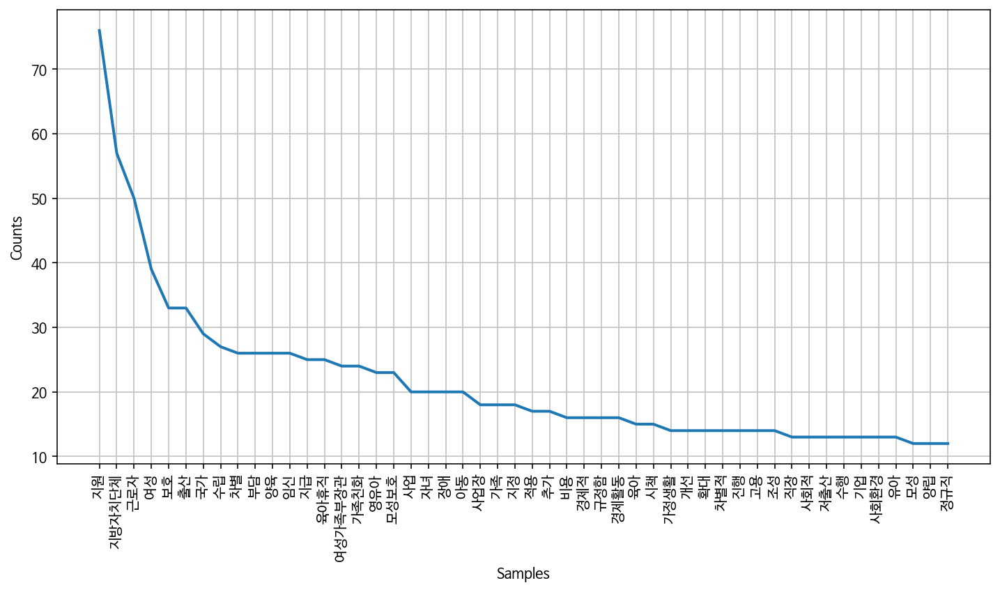

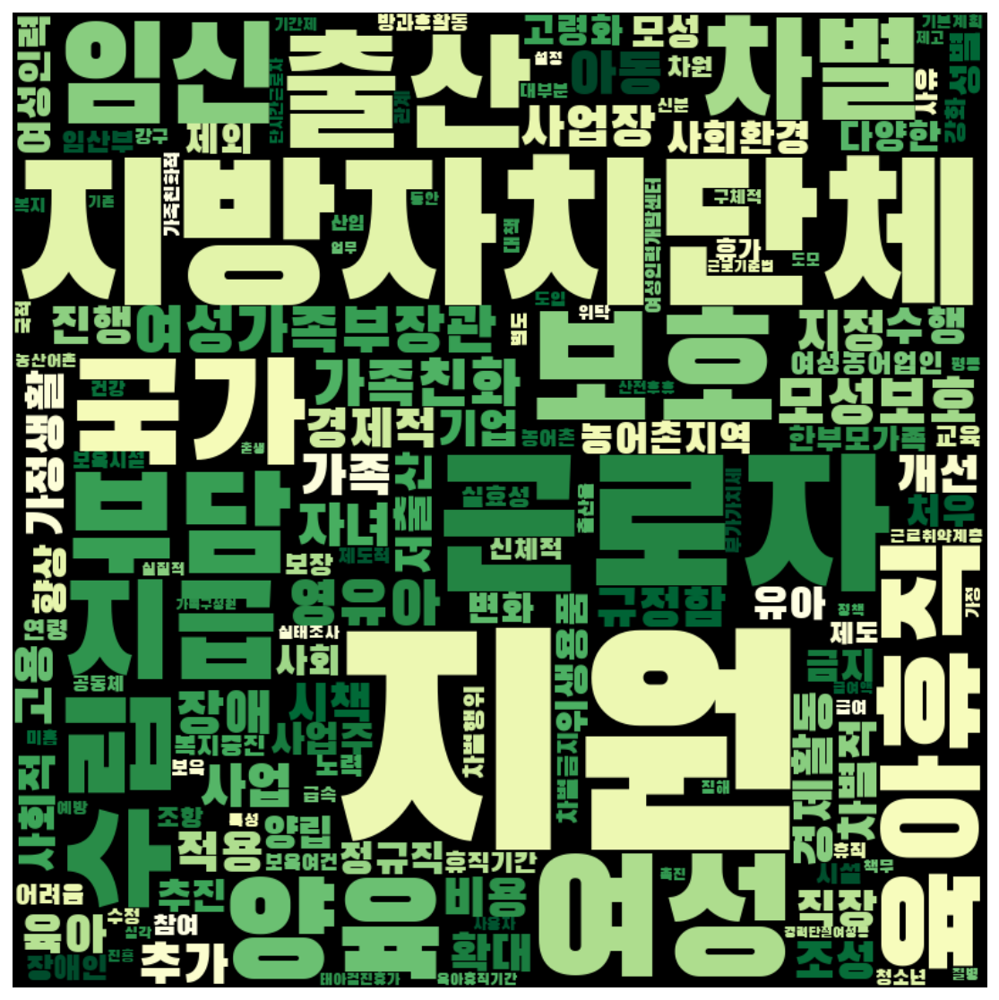

In [59]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

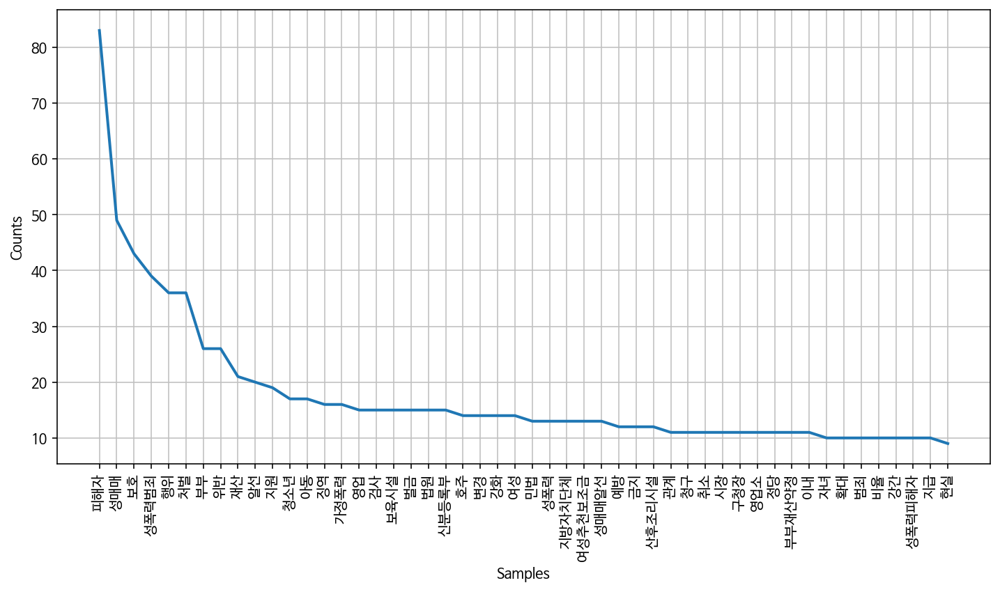

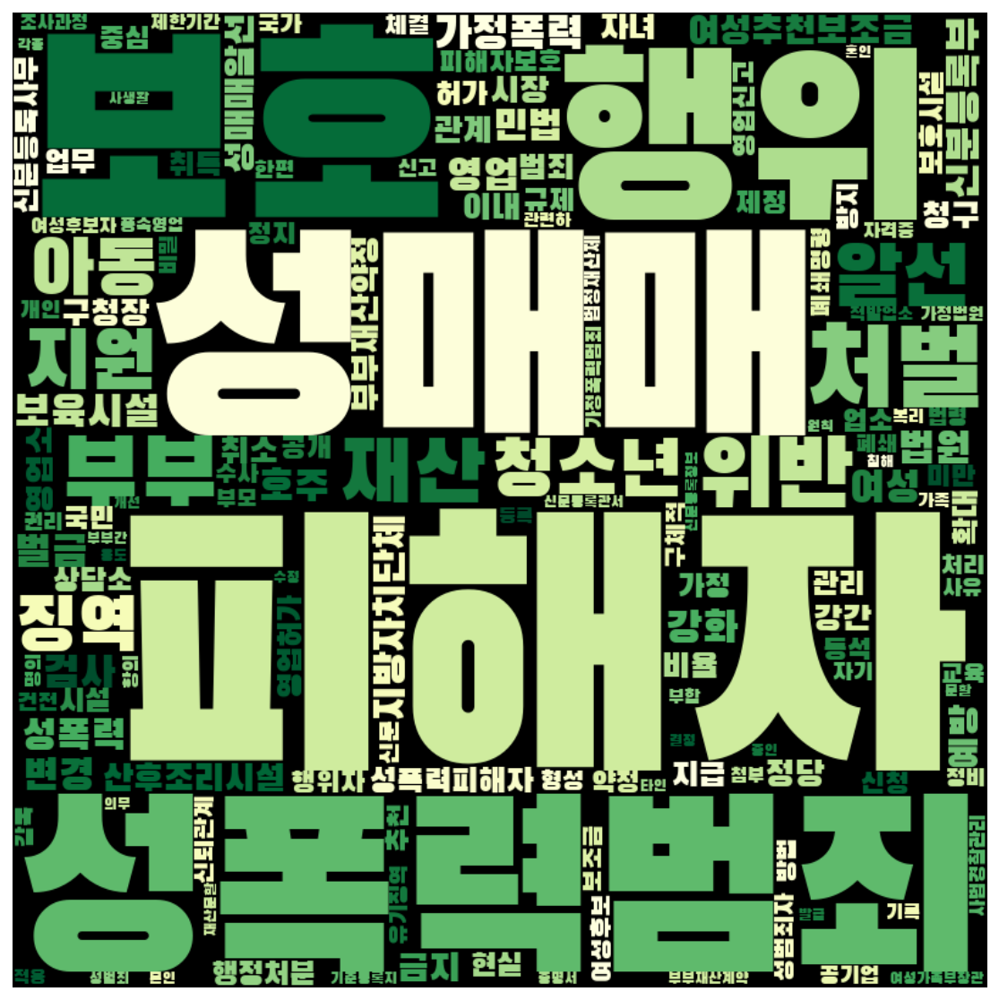

In [60]:
frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens, 'YlGn')

In [61]:
pro_men = pro_men[pro_men['명사수'] > 1]

# K means 수행 
word_vectors_pro_men = pro_men['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_men)
pro_men['category'] = idx

print(pro_men['category'].value_counts())

pro_men_g1 = pro_men[pro_men['category'] == 0]
pro_men_g2 = pro_men[pro_men['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

pro_men_g1_tokens = total_tokens(pro_men_g1['tokens'])
pro_men_g2_tokens = total_tokens(pro_men_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_men_g1_tokens = [each_word for each_word in pro_men_g1_tokens if each_word not in stopwords]
pro_men_g2_tokens = [each_word for each_word in pro_men_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

1    61
0    16
Name: category, dtype: int64


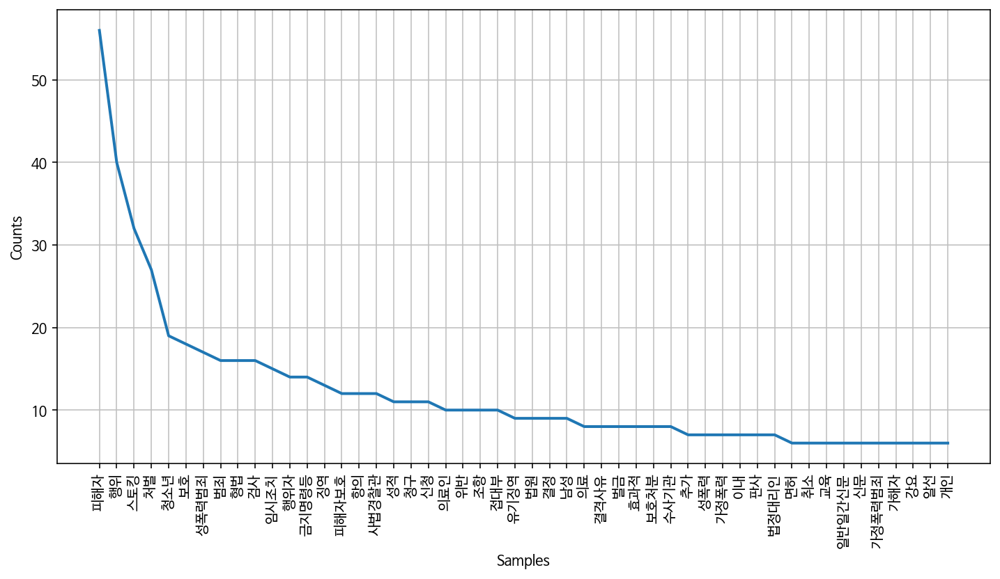

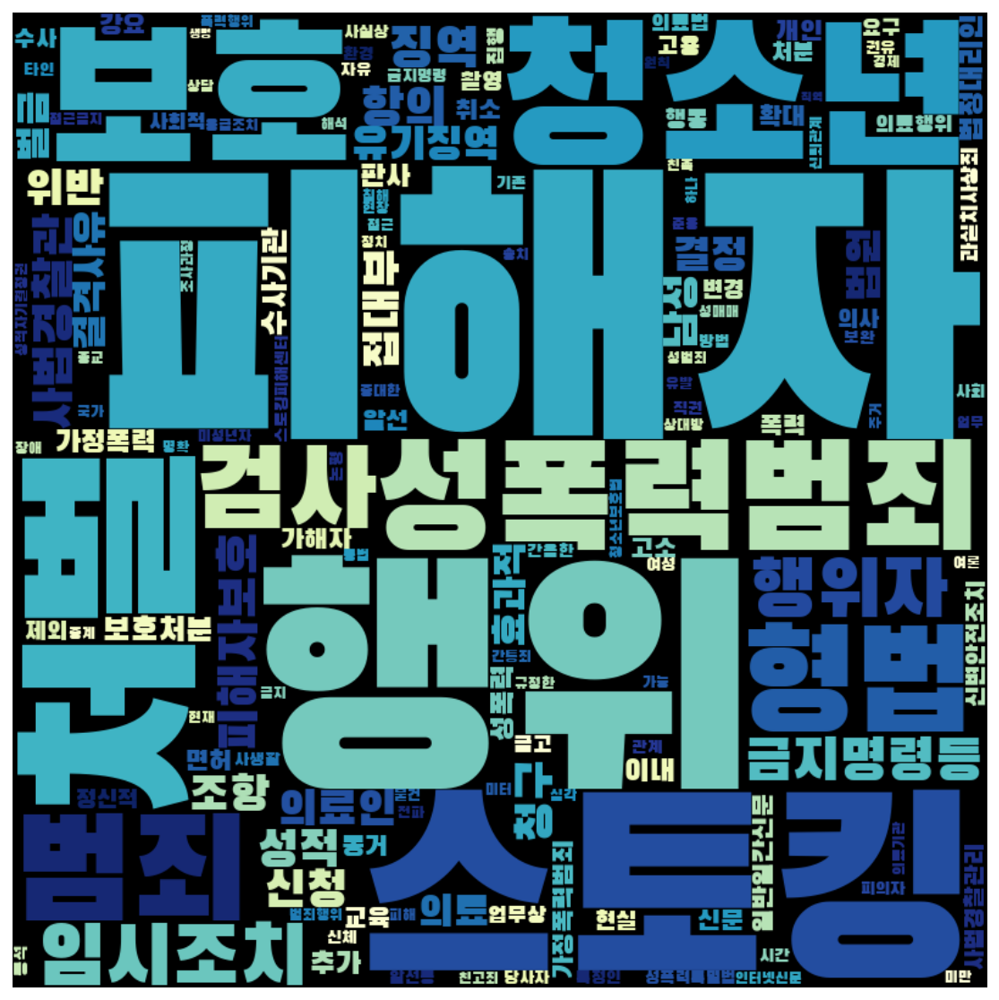

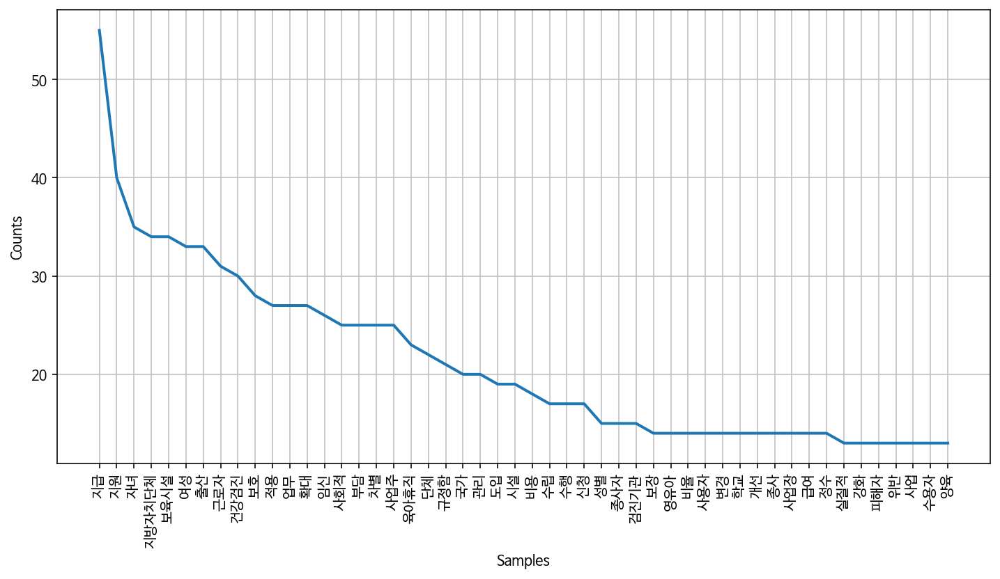

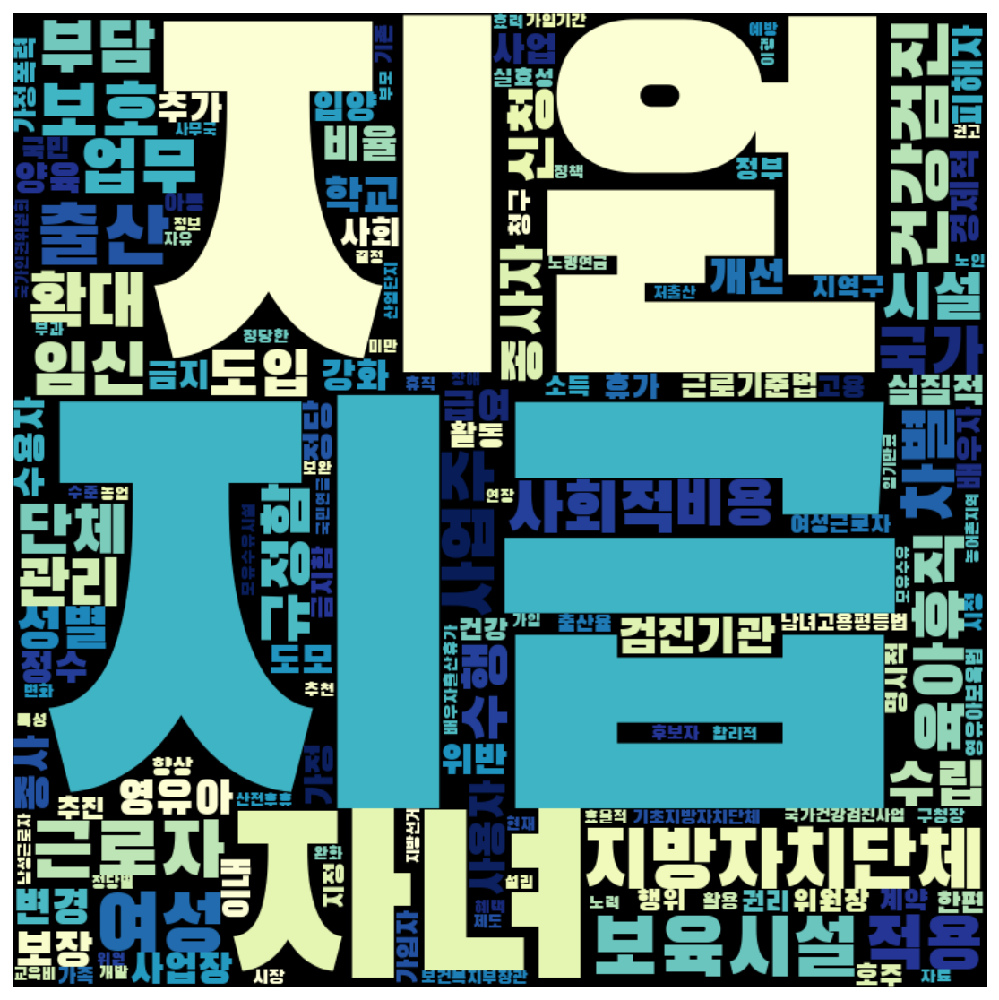

In [62]:
frewords_vis(pro_men_g1_tokens)
wordcloud_vis(pro_men_g1_tokens, 'YlGnBu')

frewords_vis(pro_men_g2_tokens)
wordcloud_vis(pro_men_g2_tokens, 'YlGnBu')

In [63]:
con_women = con_women[con_women['명사수'] > 1]

# K means 수행 
word_vectors_con_women = con_women['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_women)
con_women['category'] = idx

print(con_women['category'].value_counts())

con_women_g1 = con_women[con_women['category'] == 0]
con_women_g2 = con_women[con_women['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

con_women_g1_tokens = total_tokens(con_women_g1['tokens'])
con_women_g2_tokens = total_tokens(con_women_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_women_g1_tokens = [each_word for each_word in con_women_g1_tokens if each_word not in stopwords]
con_women_g2_tokens = [each_word for each_word in con_women_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

0    64
1    33
Name: category, dtype: int64


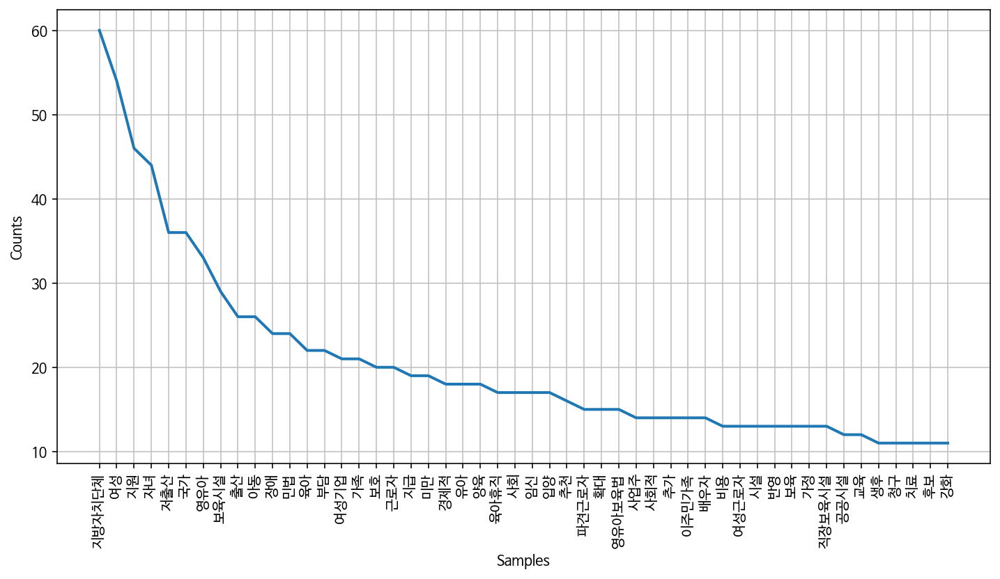

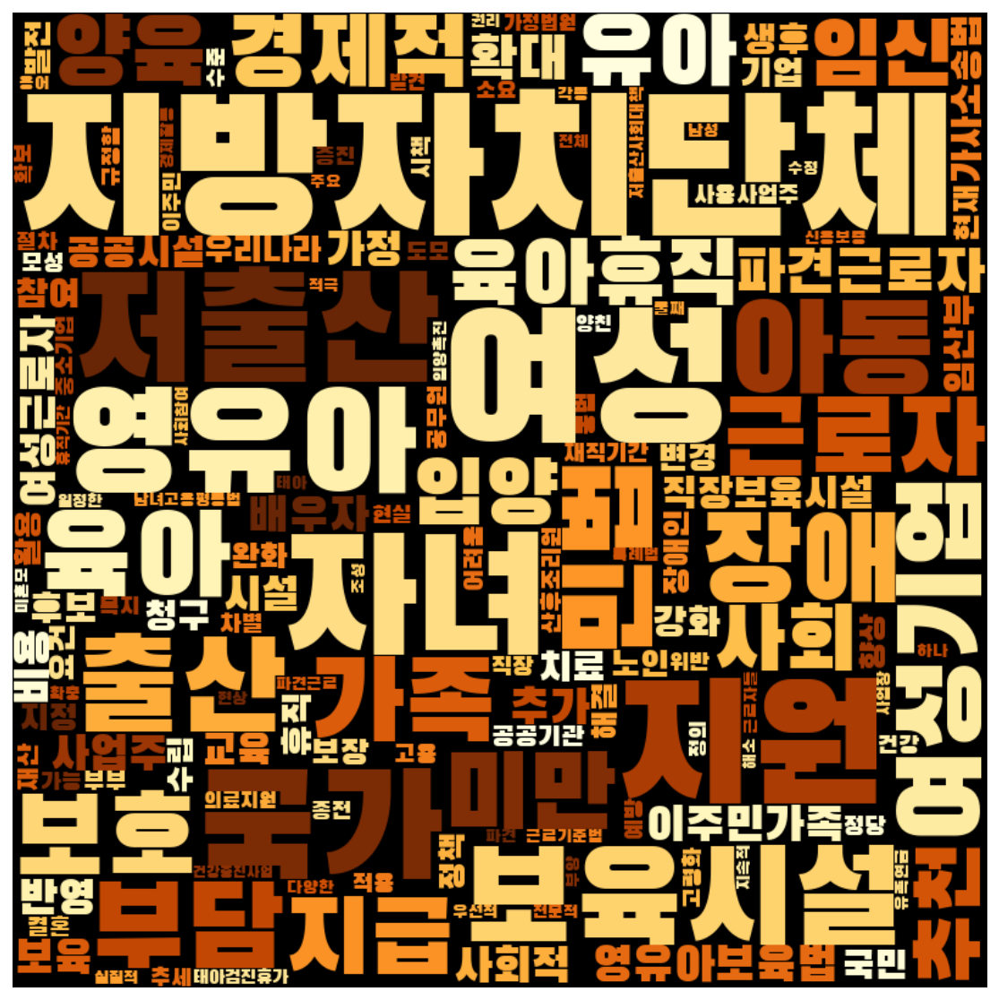

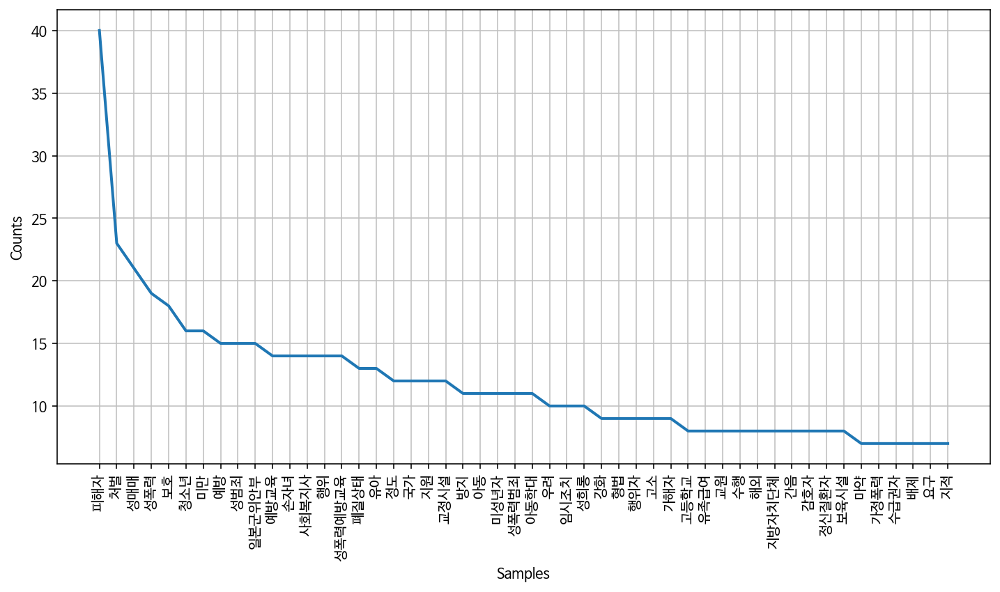

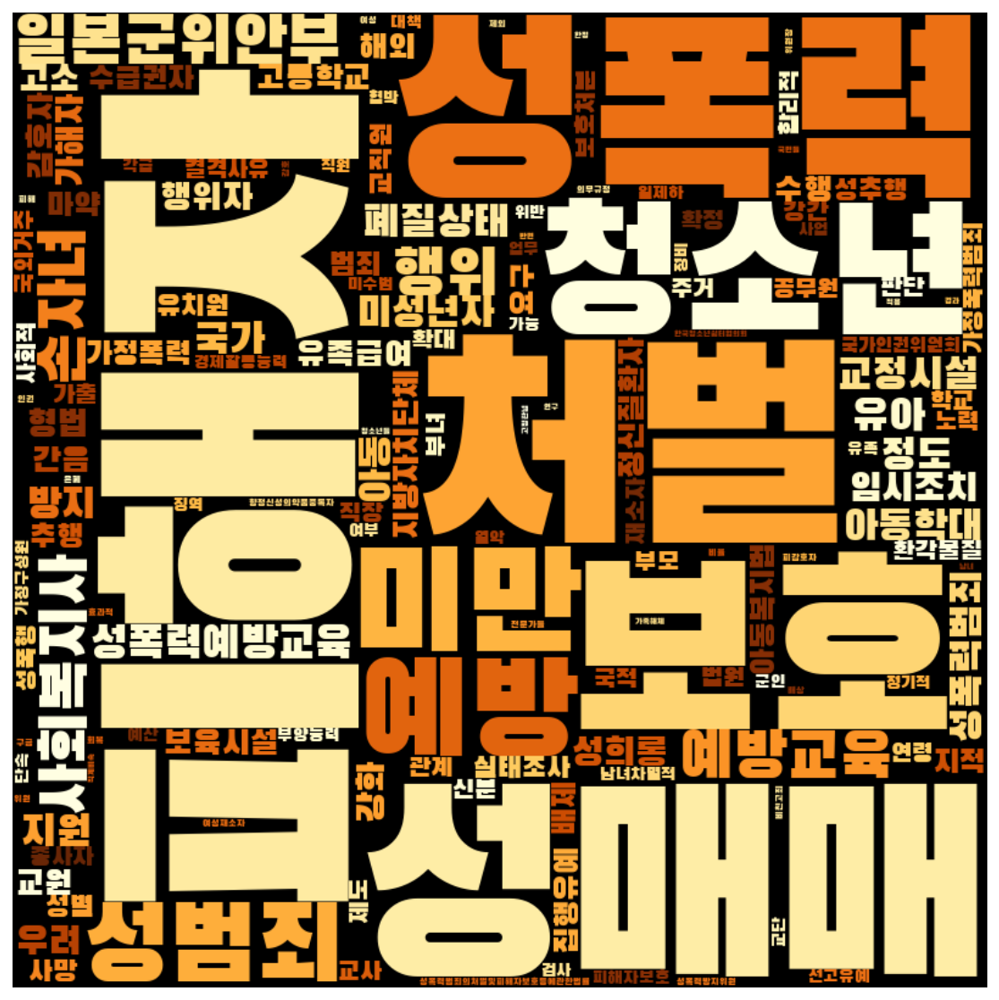

In [64]:
frewords_vis(con_women_g1_tokens)
wordcloud_vis(con_women_g1_tokens, 'YlOrBr')

frewords_vis(con_women_g2_tokens)
wordcloud_vis(con_women_g2_tokens, 'YlOrBr')

In [65]:
con_men = con_men[con_men['명사수'] > 1]

# K means 수행 
word_vectors_con_men = con_men['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_men)
con_men['category'] = idx

print(con_men['category'].value_counts())

con_men_g1 = con_men[con_men['category'] == 0]
con_men_g2 = con_men[con_men['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

con_men_g1_tokens = total_tokens(con_men_g1['tokens'])
con_men_g2_tokens = total_tokens(con_men_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_men_g1_tokens = [each_word for each_word in con_men_g1_tokens if each_word not in stopwords]
con_men_g2_tokens = [each_word for each_word in con_men_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

1    62
0    24
Name: category, dtype: int64


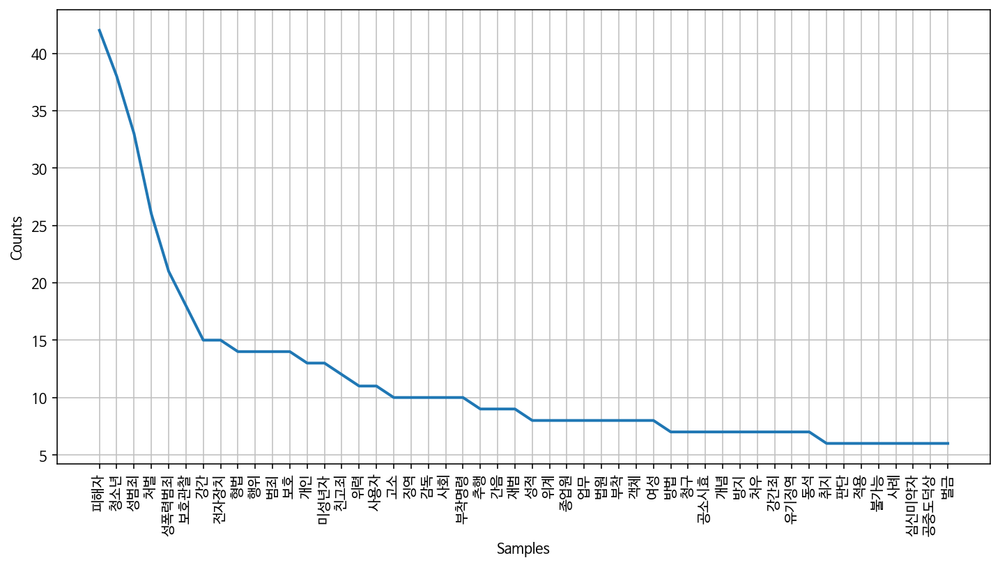

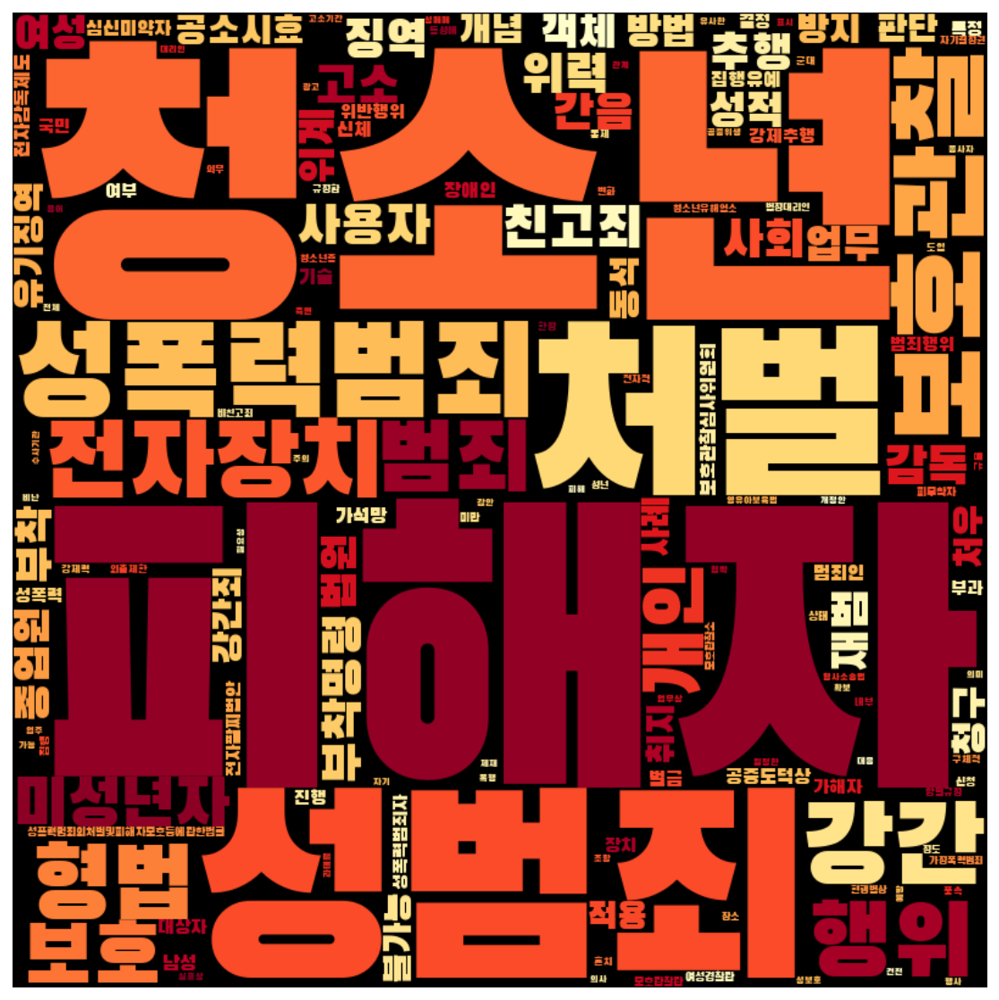

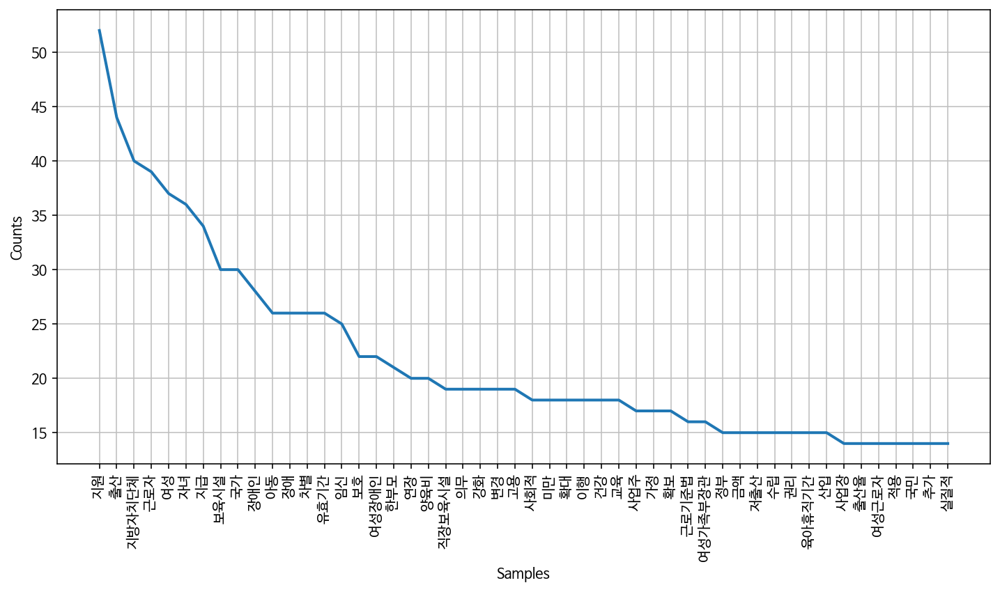

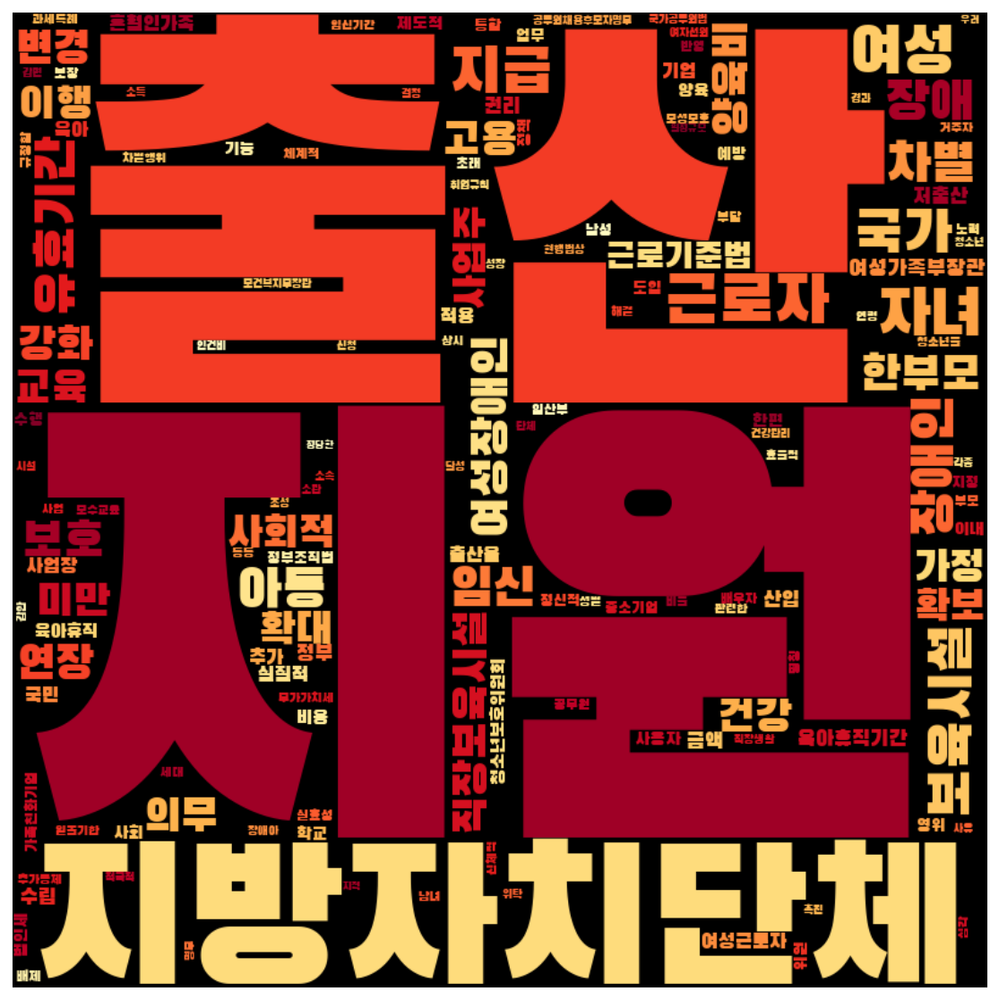

In [66]:
frewords_vis(con_men_g1_tokens)
wordcloud_vis(con_men_g1_tokens, 'YlOrRd')

frewords_vis(con_men_g2_tokens)
wordcloud_vis(con_men_g2_tokens, 'YlOrRd')

## 이명박 정권
- 2008.02.25 ~ 2013.02.24

In [45]:
leemyungbak = gender[(gender['제안일자'] >= datetime.date(2008,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2013,2,24))]
leemyungbak.shape

(1131, 19)

In [46]:
leemyungbak['성별'].value_counts()

남성    590
여성    412
Name: 성별, dtype: int64

In [47]:
pd.DataFrame(leemyungbak.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  321
     여성  242
진보   남성  244
     여성  169

In [48]:
pro_women = leemyungbak[(leemyungbak['성별'] == '여성') & (leemyungbak['정당성향'] == '진보')]
pro_men = leemyungbak[(leemyungbak['성별'] == '남성') & (leemyungbak['정당성향'] == '진보')]
con_women = leemyungbak[(leemyungbak['성별'] == '여성') & (leemyungbak['정당성향'] == '보수')]
con_men = leemyungbak[(leemyungbak['성별'] == '남성') & (leemyungbak['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장',
            '대표발의','대안']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]


In [63]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
ko_pro_men = nltk.Text(pro_men_word, name='진보 남성')
ko_con_women = nltk.Text(con_women_word, name='보수 여성')
ko_con_men = nltk.Text(con_men_word, name='보수 남성')

print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 16
여자 단어 수: 5
여성 단어 수: 71
젠더 단어 수: 0

남녀평등 단어 수: 2
양성평등 단어 수: 3
성평등 단어 수: 22
성인지적 단어 수: 5
성주류화 단어 수: 0

청소년 단어 수: 189
아동 단어 수: 290
###################
부녀 단어 수: 21
여자 단어 수: 56
여성 단어 수: 145
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 2
성평등 단어 수: 2
성인지적 단어 수: 9
성주류화 단어 수: 0

청소년 단어 수: 67
아동 단어 수: 127
###################
부녀 단어 수: 7
여자 단어 수: 8
여성 단어 수: 130
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 11
성평등 단어 수: 1
성인지적 단어 수: 1
성주류화 단어 수: 0

청소년 단어 수: 222
아동 단어 수: 269
###################
부녀 단어 수: 11
여자 단어 수: 8
여성 단어 수: 79
젠더 단어 수: 0

남녀평등 단어 수: 1
양성평등 단어 수: 8
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 251
아동 단어 수: 393


In [64]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 26
육아휴직 단어 수: 20
보육 단어 수: 30

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 140
강간 단어 수: 39
성희롱 단어 수: 52
성폭력 단어 수: 100
성폭력범죄 단어 수: 75

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 56

가정폭력 단어 수: 41

낙태 단어 수: 8
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 61
육아휴직 단어 수: 16
보육 단어 수: 57

위안부 단어 수: 0
일본군성노예제 단어 수: 6

성범죄 단어 수: 50
강간 단어 수: 12
성희롱 단어 수: 7
성폭력 단어 수: 41
성폭력범죄 단어 수: 47

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 8

가정폭력 단어 수: 56

낙태 단어 수: 3
임신중절 단어 수: 0

스토킹 단어 수: 14

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 32
가족법 단어 수: 0

저출산 단어 수: 35
육아휴직 단어 수: 40
보육 단어 수: 33

위안부 단어 수: 0
일본군성노예제 단어 수: 29

성범죄 단어 수: 174
강간 단어 수: 25
성희롱 단어 수: 10
성폭력 단어 수: 73
성폭력범죄 단어 수: 119

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 16

가정폭력 단어 수: 66

낙태 단어 수: 11
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어

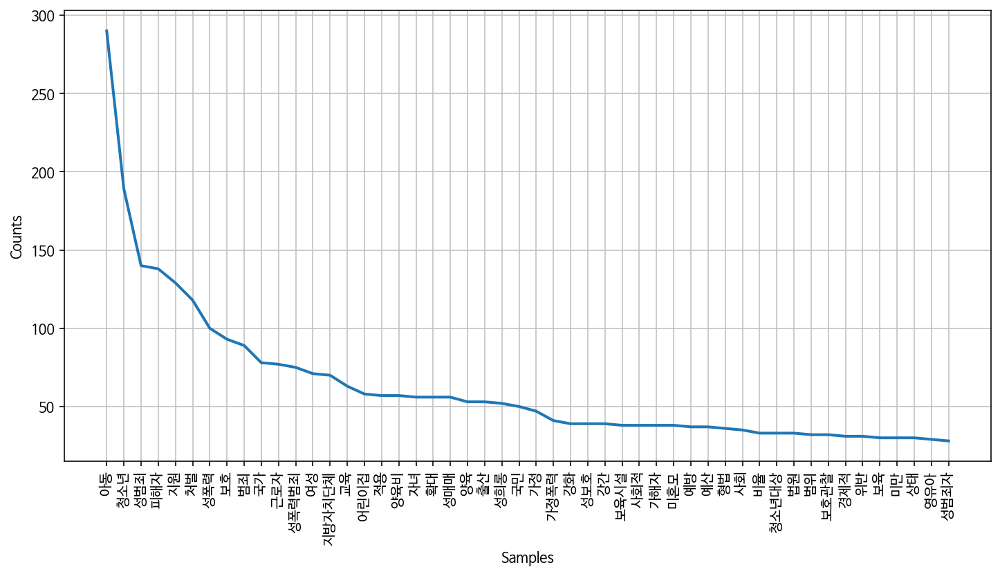

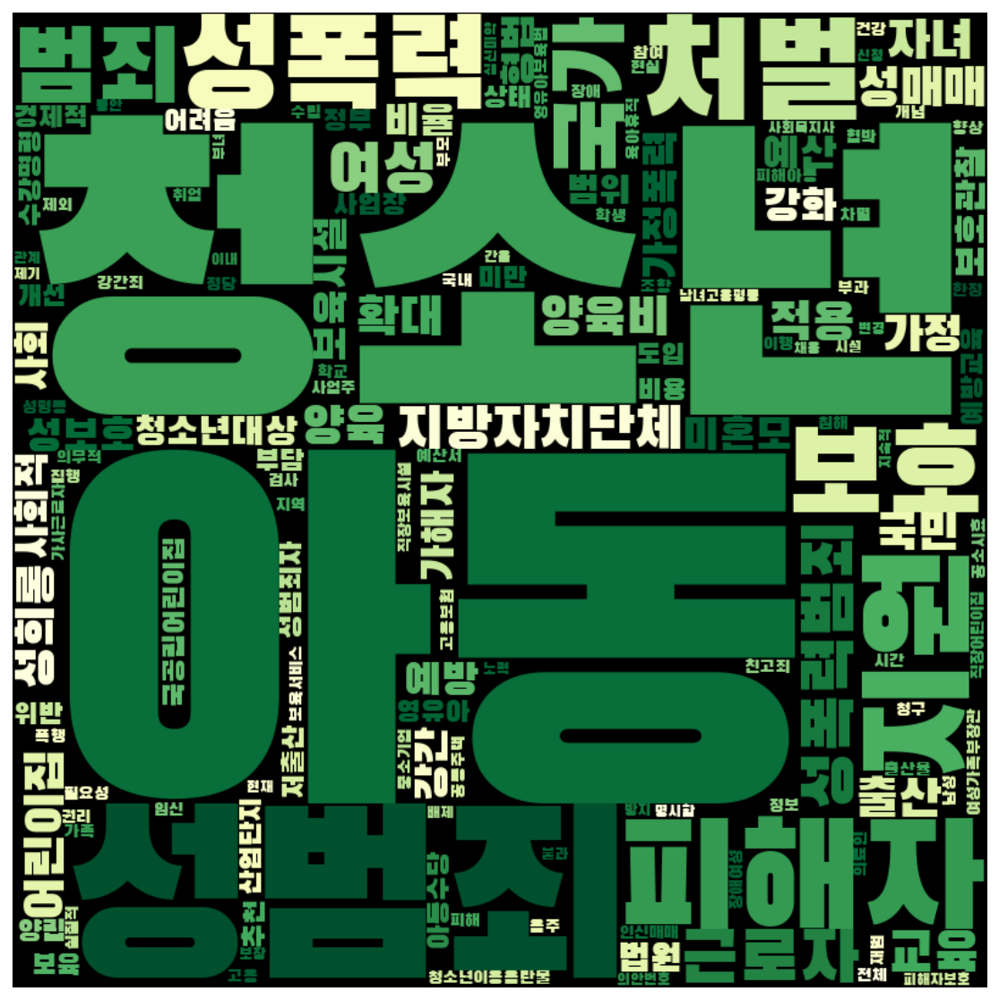

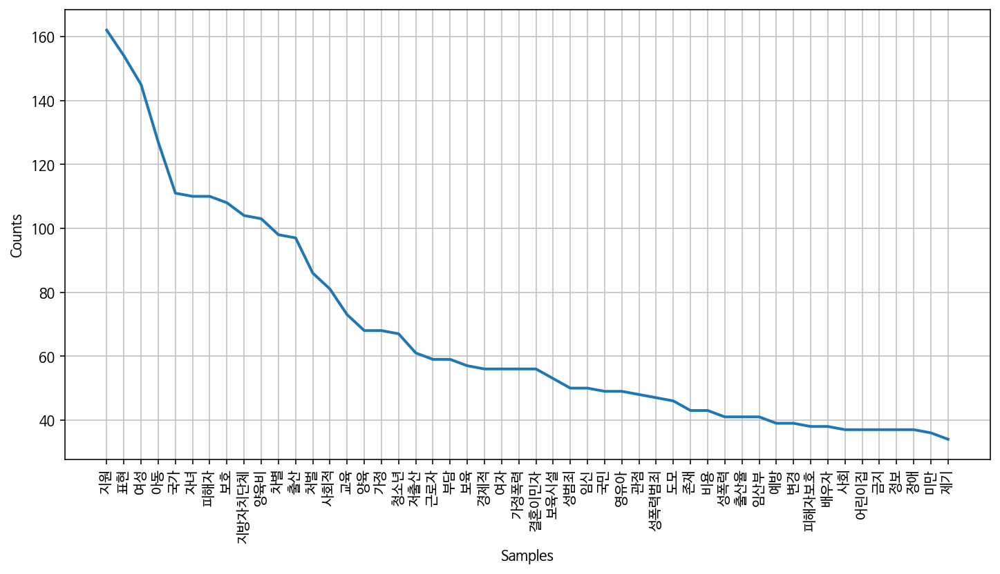

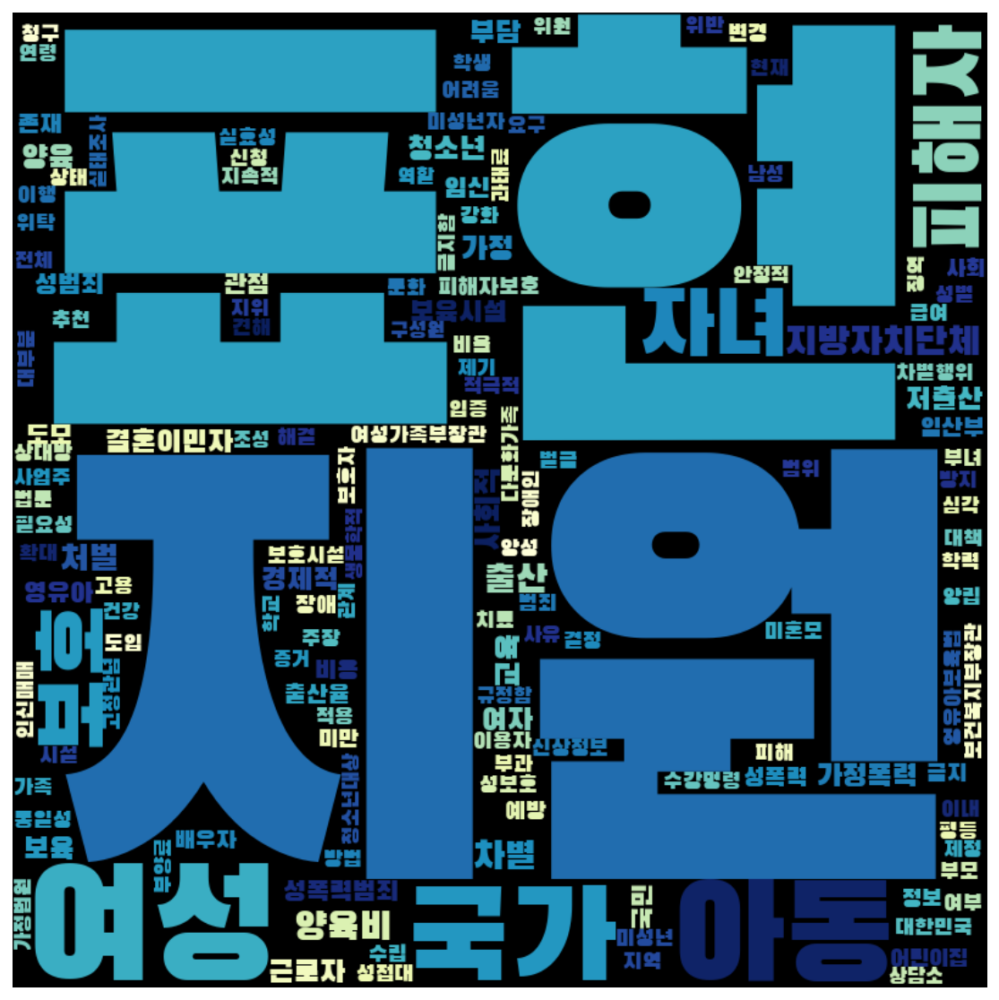

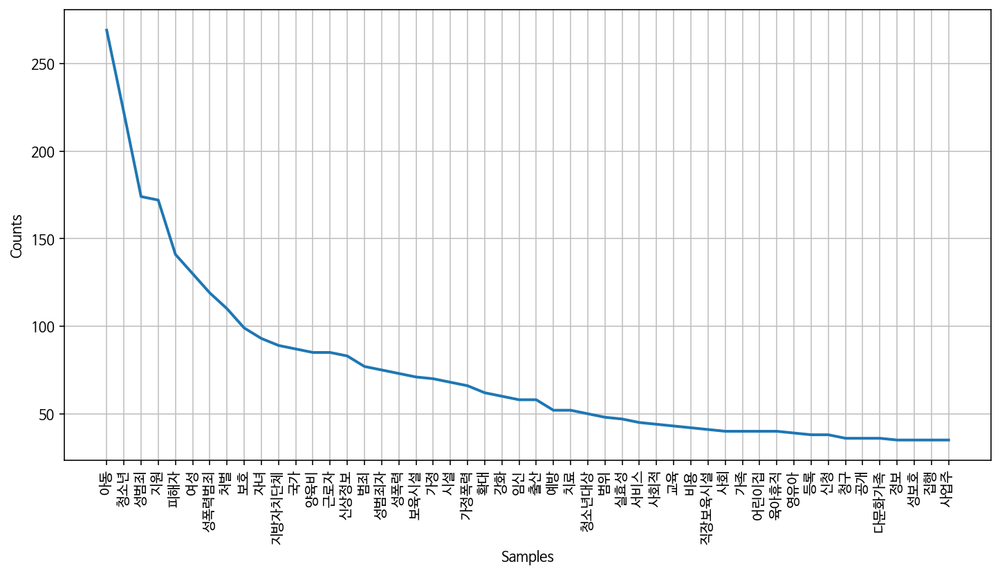

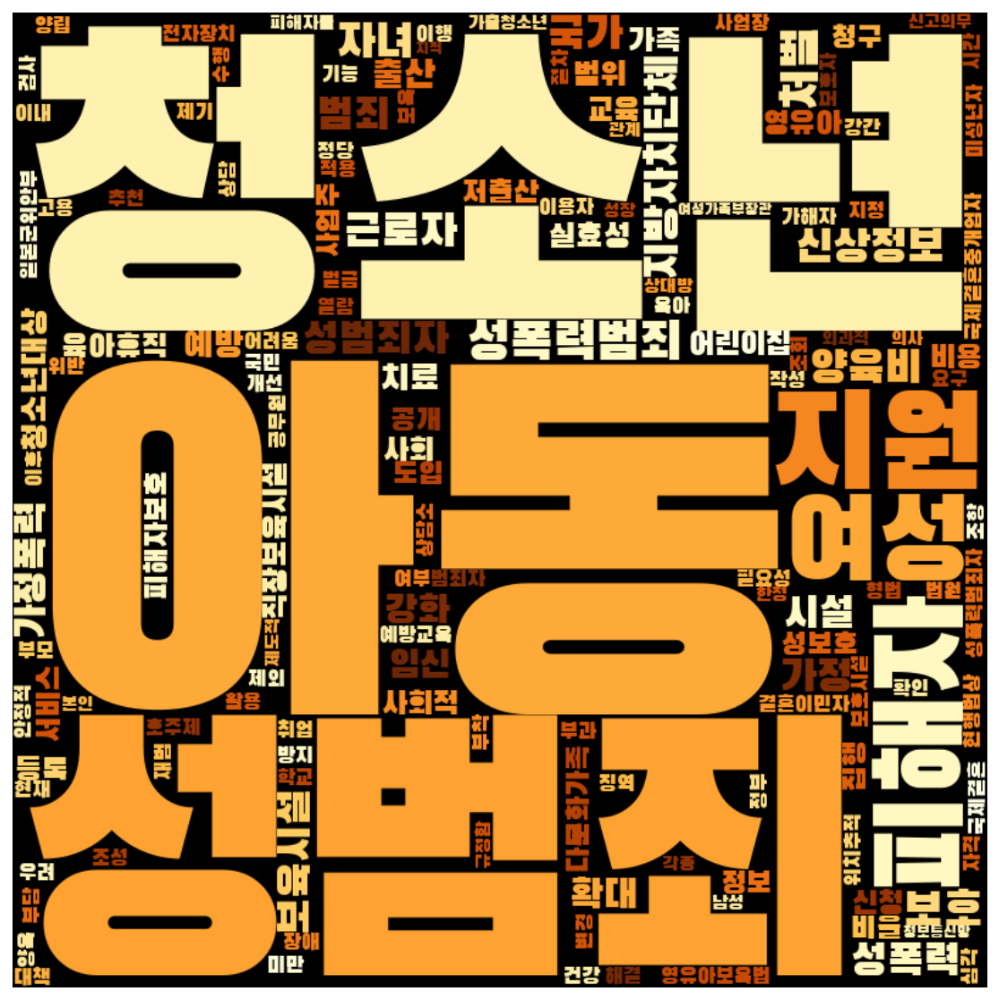

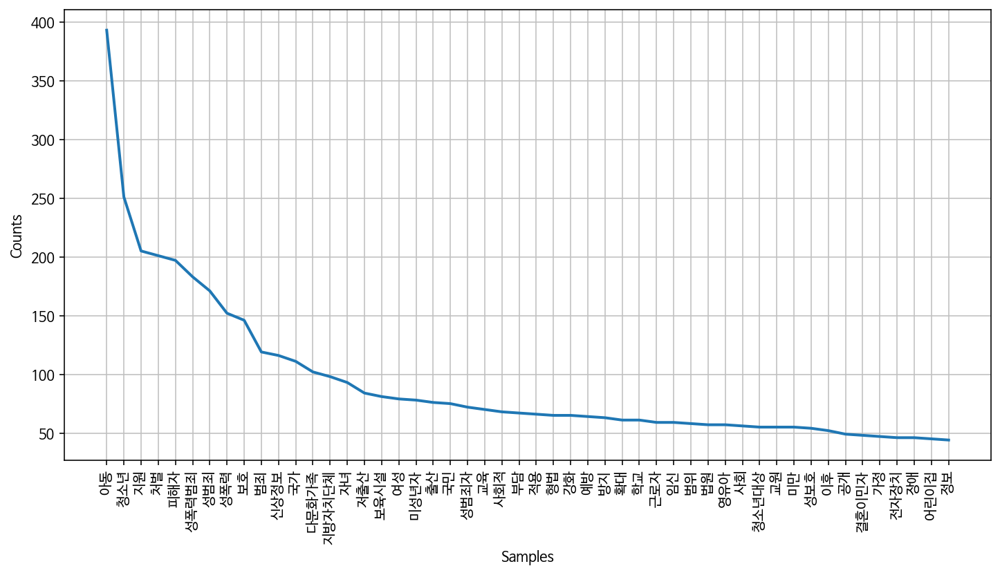

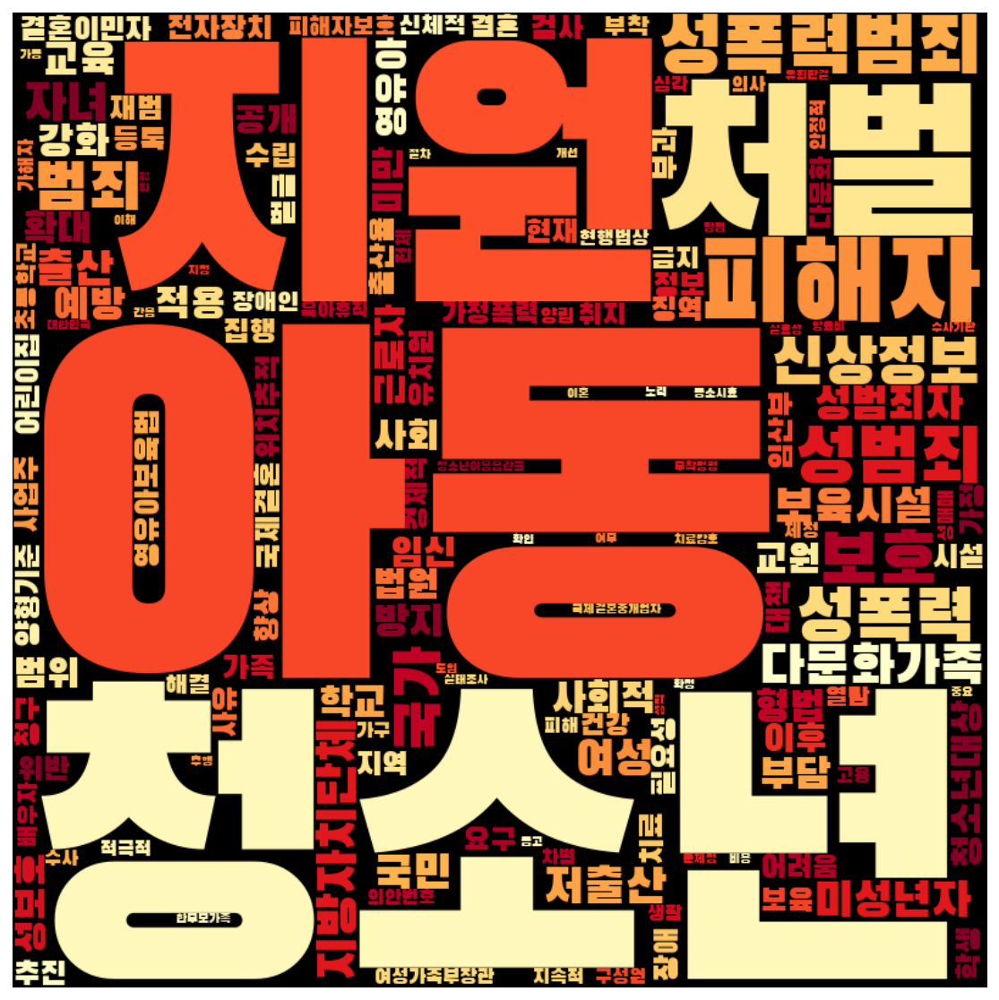

In [49]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [73]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-24 14:17:42,459 : INFO : collecting all words and their counts
2020-10-24 14:17:42,460 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-24 14:17:42,467 : INFO : collected 3476 word types from a corpus of 14847 raw words and 169 sentences
2020-10-24 14:17:42,468 : INFO : Loading a fresh vocabulary
2020-10-24 14:17:42,471 : INFO : effective_min_count=10 retains 305 unique words (8% of original 3476, drops 3171)
2020-10-24 14:17:42,472 : INFO : effective_min_count=10 leaves 7684 word corpus (51% of original 14847, drops 7163)
2020-10-24 14:17:42,476 : INFO : deleting the raw counts dictionary of 3476 items
2020-10-24 14:17:42,483 : INFO : sample=0.001 downsamples 111 most-common words
2020-10-24 14:17:42,487 : INFO : downsampling leaves estimated 5443 word corpus (70.8% of prior 7684)
2020-10-24 14:17:42,490 : INFO : estimated required memory for 305 words and 100 dimensions: 396500 bytes
2020-10-24 14:17:42,491 : INFO : resetting layer weights
20

2020-10-24 14:17:43,192 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:43,202 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:43,202 : INFO : EPOCH - 15 : training on 14847 raw words (5465 effective words) took 0.0s, 174452 effective words/s
2020-10-24 14:17:43,208 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:43,215 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:43,227 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:43,239 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:43,240 : INFO : EPOCH - 16 : training on 14847 raw words (5466 effective words) took 0.0s, 158987 effective words/s
2020-10-24 14:17:43,247 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:43,251 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:17:43,811 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:43,819 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:43,827 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:43,838 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:43,842 : INFO : EPOCH - 32 : training on 14847 raw words (5362 effective words) took 0.0s, 166280 effective words/s
2020-10-24 14:17:43,848 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:43,851 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:43,867 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:43,877 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:43,878 : INFO : EPOCH - 33 : training on 14847 raw words (5462 effective words) took 0.0s, 170416 effective words/s
2020-1

2020-10-24 14:17:44,422 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:44,422 : INFO : EPOCH - 48 : training on 14847 raw words (5479 effective words) took 0.0s, 182415 effective words/s
2020-10-24 14:17:44,428 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:44,430 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:44,446 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:44,457 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:44,458 : INFO : EPOCH - 49 : training on 14847 raw words (5503 effective words) took 0.0s, 185800 effective words/s
2020-10-24 14:17:44,462 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:44,464 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:44,480 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:17:45,036 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:45,047 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:45,051 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:45,052 : INFO : EPOCH - 65 : training on 14847 raw words (5434 effective words) took 0.0s, 162333 effective words/s
2020-10-24 14:17:45,057 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:45,061 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:45,077 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:45,086 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:45,087 : INFO : EPOCH - 66 : training on 14847 raw words (5436 effective words) took 0.0s, 181343 effective words/s
2020-10-24 14:17:45,095 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-24 14:17:45,632 : INFO : EPOCH - 81 : training on 14847 raw words (5495 effective words) took 0.0s, 198890 effective words/s
2020-10-24 14:17:45,638 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:45,645 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:45,655 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:45,665 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:45,666 : INFO : EPOCH - 82 : training on 14847 raw words (5462 effective words) took 0.0s, 196774 effective words/s
2020-10-24 14:17:45,671 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:45,677 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:45,692 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:45,698 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:17:46,243 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:46,251 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:46,252 : INFO : EPOCH - 98 : training on 14847 raw words (5435 effective words) took 0.0s, 226095 effective words/s
2020-10-24 14:17:46,257 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:46,260 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:46,275 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:46,289 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:46,290 : INFO : EPOCH - 99 : training on 14847 raw words (5433 effective words) took 0.0s, 165183 effective words/s
2020-10-24 14:17:46,297 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:46,305 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:17:47,040 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:47,043 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:47,044 : INFO : EPOCH - 12 : training on 18295 raw words (7192 effective words) took 0.0s, 227142 effective words/s
2020-10-24 14:17:47,053 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:47,059 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:47,084 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:47,086 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:47,087 : INFO : EPOCH - 13 : training on 18295 raw words (7238 effective words) took 0.0s, 216840 effective words/s
2020-10-24 14:17:47,099 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:47,100 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:17:47,733 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:47,739 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:47,764 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:47,768 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:47,770 : INFO : EPOCH - 29 : training on 18295 raw words (7193 effective words) took 0.0s, 195919 effective words/s
2020-10-24 14:17:47,777 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:47,781 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:47,806 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:47,810 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:47,811 : INFO : EPOCH - 30 : training on 18295 raw words (7192 effective words) took 0.0s, 196962 effective words/s
2020-1

2020-10-24 14:17:48,449 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:48,450 : INFO : EPOCH - 45 : training on 18295 raw words (7167 effective words) took 0.0s, 179233 effective words/s
2020-10-24 14:17:48,461 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:48,465 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:48,492 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:48,498 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:48,501 : INFO : EPOCH - 46 : training on 18295 raw words (7121 effective words) took 0.0s, 170716 effective words/s
2020-10-24 14:17:48,508 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:48,514 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:48,538 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:17:49,176 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:49,201 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:49,206 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:49,207 : INFO : EPOCH - 62 : training on 18295 raw words (7229 effective words) took 0.0s, 195000 effective words/s
2020-10-24 14:17:49,213 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:49,223 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:49,241 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:49,246 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:49,247 : INFO : EPOCH - 63 : training on 18295 raw words (7163 effective words) took 0.0s, 196314 effective words/s
2020-10-24 14:17:49,252 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-24 14:17:49,878 : INFO : EPOCH - 78 : training on 18295 raw words (7203 effective words) took 0.0s, 241214 effective words/s
2020-10-24 14:17:49,882 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:49,885 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:49,906 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:49,910 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:49,911 : INFO : EPOCH - 79 : training on 18295 raw words (7194 effective words) took 0.0s, 235534 effective words/s
2020-10-24 14:17:49,915 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:49,927 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:49,944 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:49,947 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:17:50,608 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:50,611 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:50,613 : INFO : EPOCH - 95 : training on 18295 raw words (7188 effective words) took 0.0s, 175720 effective words/s
2020-10-24 14:17:50,623 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:50,627 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:50,653 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:50,658 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:50,659 : INFO : EPOCH - 96 : training on 18295 raw words (7160 effective words) took 0.0s, 166967 effective words/s
2020-10-24 14:17:50,668 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:50,672 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:17:51,408 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:51,411 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:51,412 : INFO : EPOCH - 9 : training on 19744 raw words (8007 effective words) took 0.0s, 186017 effective words/s
2020-10-24 14:17:51,424 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:51,427 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:51,457 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:51,460 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:51,462 : INFO : EPOCH - 10 : training on 19744 raw words (7914 effective words) took 0.0s, 209896 effective words/s
2020-10-24 14:17:51,477 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:51,482 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10

2020-10-24 14:17:52,228 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:52,235 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:52,263 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:52,267 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:52,269 : INFO : EPOCH - 26 : training on 19744 raw words (8041 effective words) took 0.0s, 185362 effective words/s
2020-10-24 14:17:52,278 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:52,288 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:52,309 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:52,317 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:52,318 : INFO : EPOCH - 27 : training on 19744 raw words (7958 effective words) took 0.0s, 177024 effective words/s
2020-1

2020-10-24 14:17:53,064 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:53,066 : INFO : EPOCH - 42 : training on 19744 raw words (8027 effective words) took 0.0s, 184091 effective words/s
2020-10-24 14:17:53,072 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:53,080 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:53,109 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:53,111 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:53,112 : INFO : EPOCH - 43 : training on 19744 raw words (8005 effective words) took 0.0s, 184907 effective words/s
2020-10-24 14:17:53,117 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:53,122 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:53,152 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:17:53,898 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:53,923 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:53,932 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:53,934 : INFO : EPOCH - 59 : training on 19744 raw words (8008 effective words) took 0.1s, 152833 effective words/s
2020-10-24 14:17:53,947 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:53,952 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:53,985 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:53,987 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:53,990 : INFO : EPOCH - 60 : training on 19744 raw words (7970 effective words) took 0.0s, 162486 effective words/s
2020-10-24 14:17:53,999 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-24 14:17:54,749 : INFO : EPOCH - 75 : training on 19744 raw words (7958 effective words) took 0.0s, 198066 effective words/s
2020-10-24 14:17:54,757 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:54,767 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:54,790 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:54,793 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:54,795 : INFO : EPOCH - 76 : training on 19744 raw words (7935 effective words) took 0.0s, 193050 effective words/s
2020-10-24 14:17:54,800 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:54,810 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:54,836 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:54,838 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:17:55,557 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:55,565 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:55,567 : INFO : EPOCH - 92 : training on 19744 raw words (8009 effective words) took 0.0s, 190742 effective words/s
2020-10-24 14:17:55,574 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:55,589 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:55,608 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:55,618 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:55,619 : INFO : EPOCH - 93 : training on 19744 raw words (8029 effective words) took 0.0s, 167909 effective words/s
2020-10-24 14:17:55,629 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:55,638 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:17:56,526 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:56,531 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:56,532 : INFO : EPOCH - 6 : training on 24929 raw words (11804 effective words) took 0.1s, 196753 effective words/s
2020-10-24 14:17:56,544 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:56,572 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:56,585 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:56,592 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:56,593 : INFO : EPOCH - 7 : training on 24929 raw words (11741 effective words) took 0.0s, 237849 effective words/s
2020-10-24 14:17:56,605 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:56,632 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:17:57,504 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:57,534 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:57,546 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:57,552 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:57,553 : INFO : EPOCH - 23 : training on 24929 raw words (11784 effective words) took 0.1s, 214306 effective words/s
2020-10-24 14:17:57,563 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:57,603 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:57,606 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:57,622 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:57,625 : INFO : EPOCH - 24 : training on 24929 raw words (11768 effective words) took 0.1s, 190004 effective words/s
2020

2020-10-24 14:17:58,472 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:58,472 : INFO : EPOCH - 39 : training on 24929 raw words (11748 effective words) took 0.1s, 228383 effective words/s
2020-10-24 14:17:58,488 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:58,512 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:58,521 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:58,527 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:58,529 : INFO : EPOCH - 40 : training on 24929 raw words (11713 effective words) took 0.0s, 291372 effective words/s
2020-10-24 14:17:58,534 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:58,572 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:58,582 : INFO : worker thread finished; awaiting finish of 1 more threads
2020

2020-10-24 14:17:59,365 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:59,396 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:59,407 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:59,410 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:59,412 : INFO : EPOCH - 56 : training on 24929 raw words (11774 effective words) took 0.0s, 238330 effective words/s
2020-10-24 14:17:59,420 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:17:59,455 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:17:59,479 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:17:59,486 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:17:59,487 : INFO : EPOCH - 57 : training on 24929 raw words (11793 effective words) took 0.1s, 167251 effective words/s
2020

2020-10-24 14:18:00,356 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:00,358 : INFO : EPOCH - 72 : training on 24929 raw words (11761 effective words) took 0.1s, 218785 effective words/s
2020-10-24 14:18:00,366 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:00,401 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:00,413 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:00,418 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:00,419 : INFO : EPOCH - 73 : training on 24929 raw words (11791 effective words) took 0.1s, 210047 effective words/s
2020-10-24 14:18:00,429 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:00,460 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:00,466 : INFO : worker thread finished; awaiting finish of 1 more threads
2020

2020-10-24 14:18:01,274 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:01,305 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:01,317 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:01,320 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:01,321 : INFO : EPOCH - 89 : training on 24929 raw words (11821 effective words) took 0.1s, 235961 effective words/s
2020-10-24 14:18:01,328 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:01,358 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:01,371 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:01,376 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:01,377 : INFO : EPOCH - 90 : training on 24929 raw words (11770 effective words) took 0.1s, 224776 effective words/s
2020

In [74]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-24 14:18:01,954 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:18:01,957 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:18:01,959 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:18:01,961 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('추천', 0.3714101016521454), ('증진', 0.344480037689209), ('정부', 0.3387606739997864), ('육아휴직', 0.3362370431423187), ('근로자', 0.33276084065437317), ('비율', 0.3314574062824249), ('정당', 0.3303881287574768), ('정책', 0.32855403423309326), ('후보자', 0.3005009889602661), ('가사사용인', 0.2993597984313965)]
진보 남성: [('관념', 0.4597322642803192), ('역할', 0.450239896774292), ('고정관념', 0.434964120388031), ('내포', 0.4309632182121277), ('여성비하적', 0.429130882024765), ('관점', 0.4239234924316406), ('표현', 0.41794267296791077), ('부녀', 0.40491920709609985), ('견해', 0.39984050393104553), ('남성', 0.3990161716938019)]
보수 여성: [('남성', 0.4550321102142334), ('임원', 0.42015597224235535), ('여성조합원', 0.4037879705429077), ('출산', 0.38708943128585815), ('모자보건법', 0.38426071405410767), ('후보', 0.37448570132255554), ('보조생식', 0.35842108726501465), ('추천', 0.3509148955345154), ('양립', 0.3503198027610779), ('비율', 0.3456701338291168)]
보수 남성: [('세계', 0.4306662976741791), ('보호휴가', 0.4096198081970215), ('유산', 0.40922918915748596), ('산후', 0.403992

In [75]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

<ipython-input-75-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-75-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
<ipython-input-75-4fb28107e7ed>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [76]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [77]:
pro_women['category'].value_counts()

0    77
1    68
2    24
Name: category, dtype: int64

In [78]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
pro_women_g3 = pro_women[pro_women['category'] == 2]

pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
pro_women_g3_tokens = total_tokens(pro_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
pro_women_g3_tokens = [each_word for each_word in pro_women_g3_tokens if each_word not in stopwords]

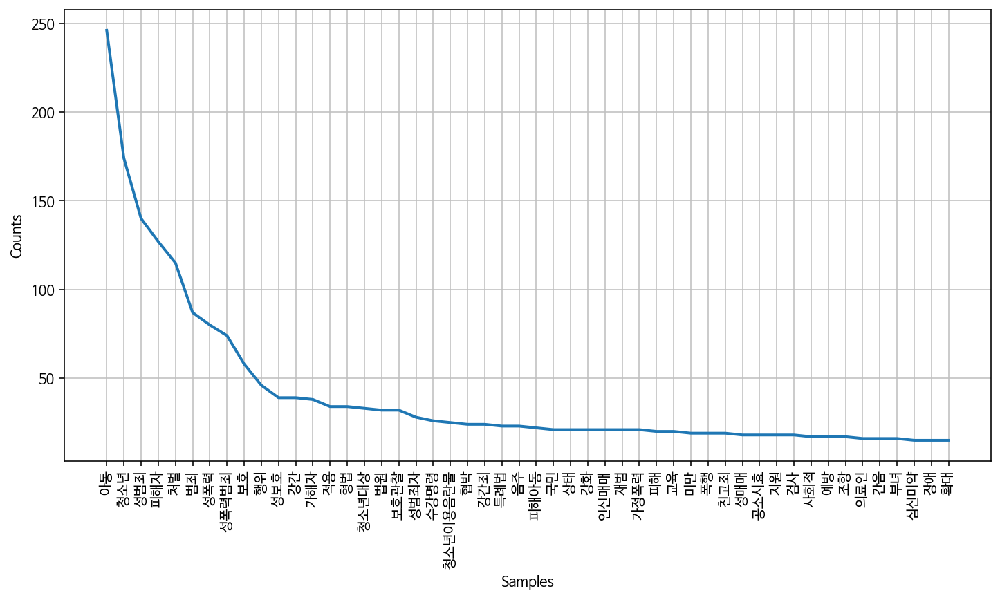

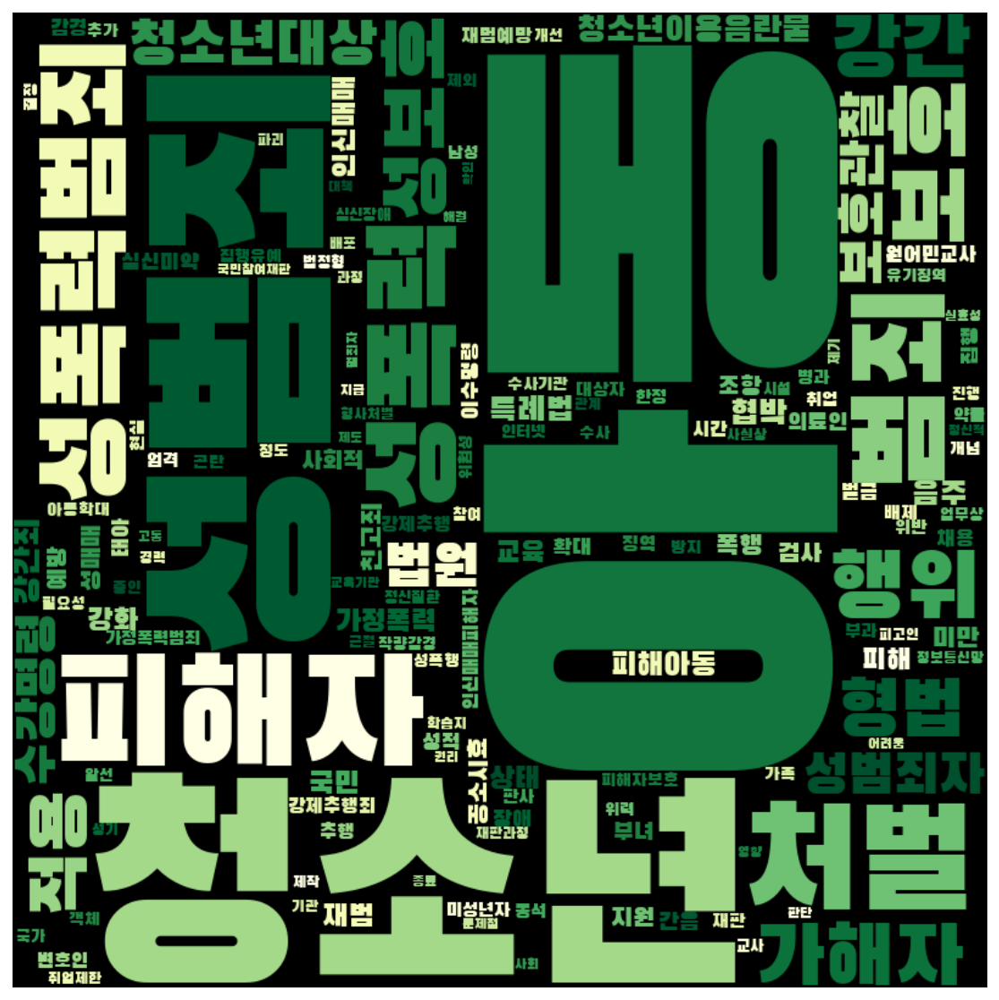

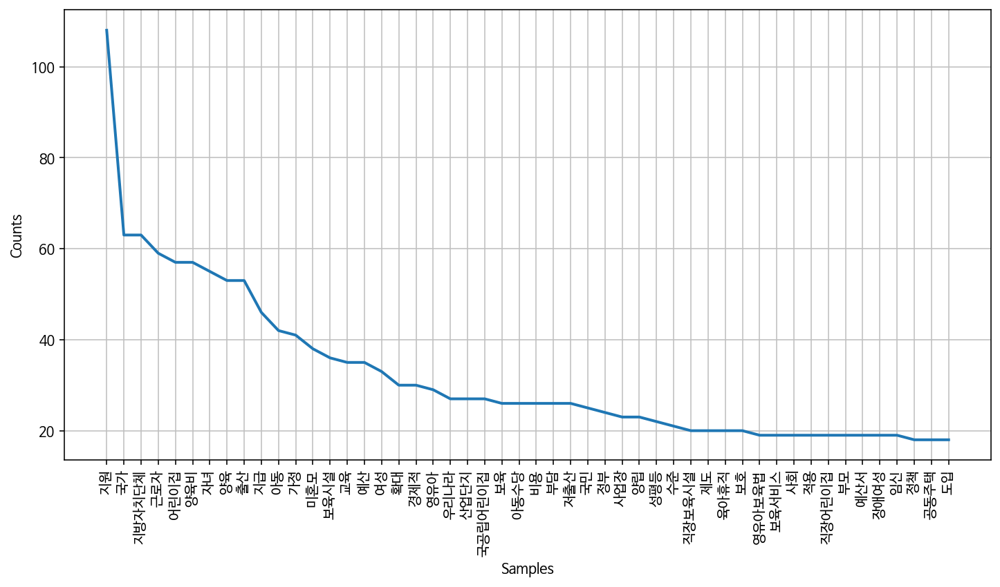

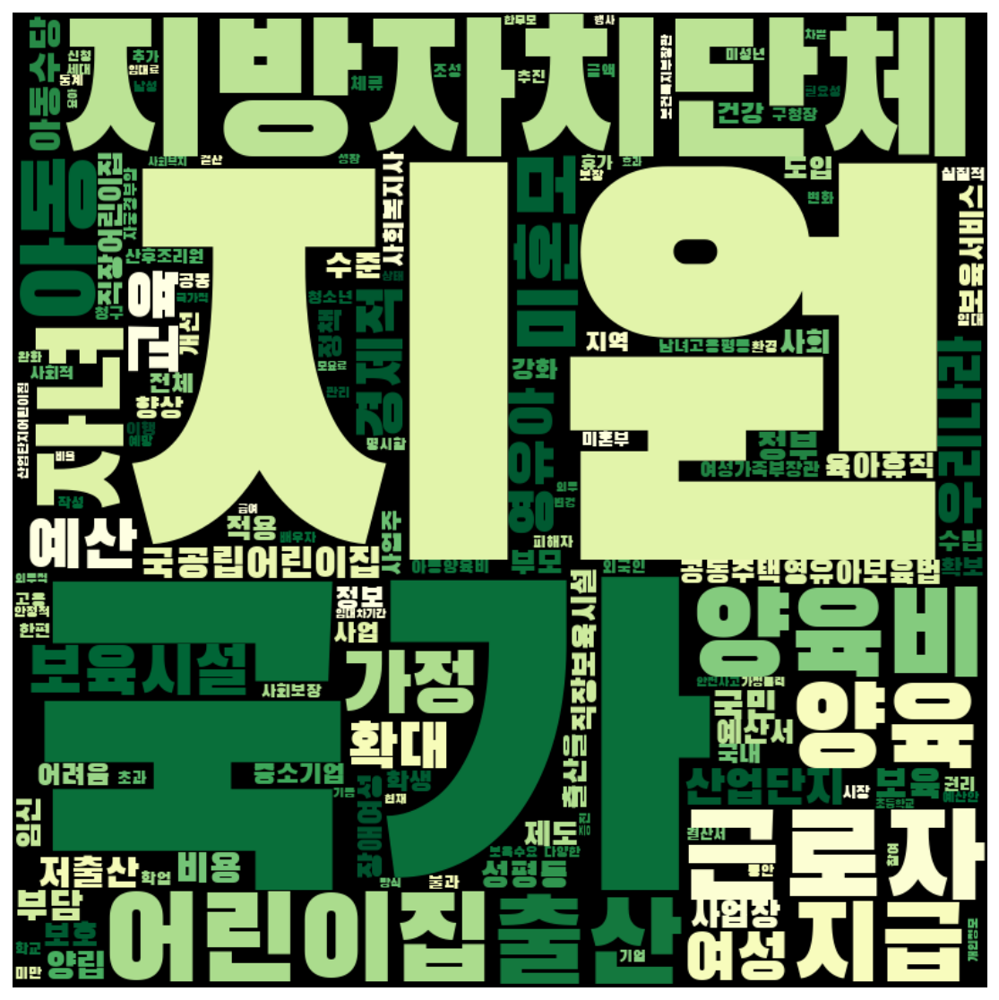

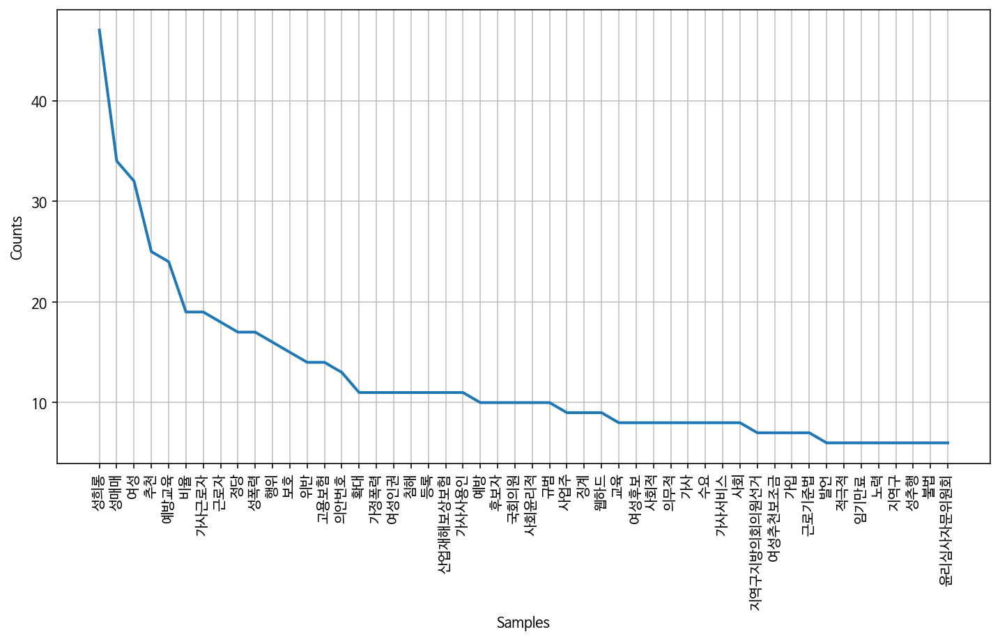

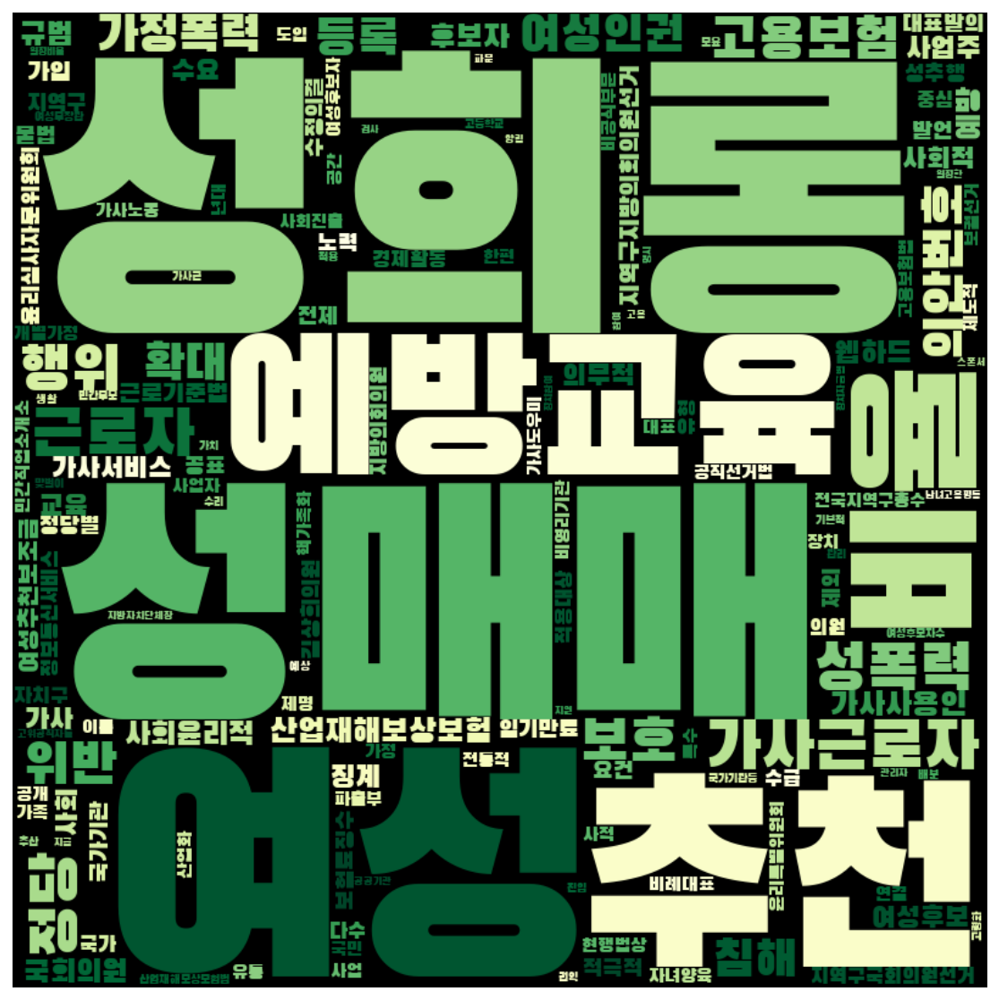

In [79]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens,'YlGn')

frewords_vis(pro_women_g3_tokens)
wordcloud_vis(pro_women_g3_tokens,'YlGn')

In [80]:
pro_men = pro_men[pro_men['명사수'] > 1]

# K means 수행 
word_vectors_pro_men = pro_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_men)
pro_men['category'] = idx

print(pro_men['category'].value_counts())

pro_men_g1 = pro_men[pro_men['category'] == 0]
pro_men_g2 = pro_men[pro_men['category'] == 1]
pro_men_g3 = pro_men[pro_men['category'] == 2]

pro_men_g1_tokens = total_tokens(pro_men_g1['tokens'])
pro_men_g2_tokens = total_tokens(pro_men_g2['tokens'])
pro_men_g3_tokens = total_tokens(pro_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_men_g1_tokens = [each_word for each_word in pro_men_g1_tokens if each_word not in stopwords]
pro_men_g2_tokens = [each_word for each_word in pro_men_g2_tokens if each_word not in stopwords]
pro_men_g3_tokens = [each_word for each_word in pro_men_g3_tokens if each_word not in stopwords]

0    152
1     64
2     28
Name: category, dtype: int64


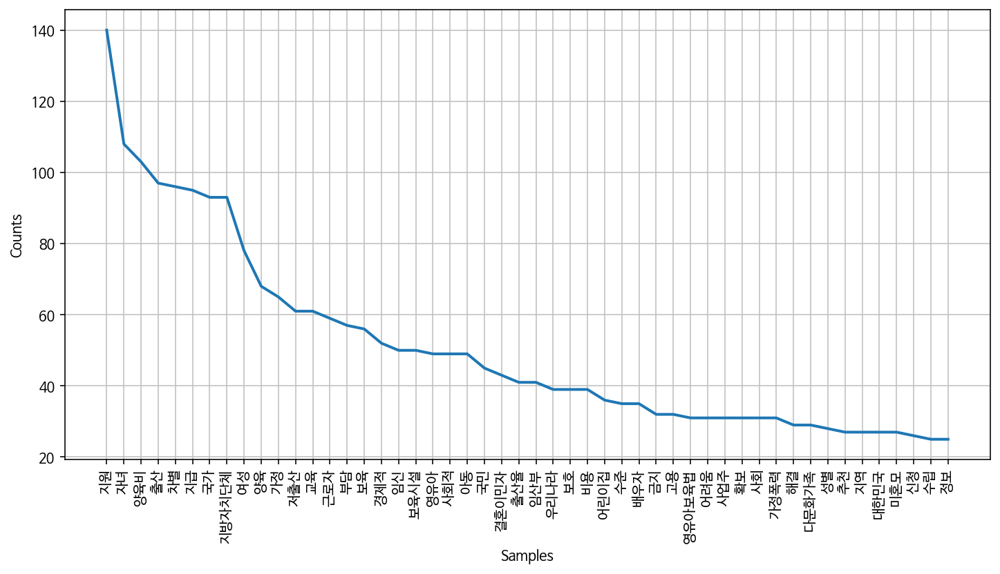

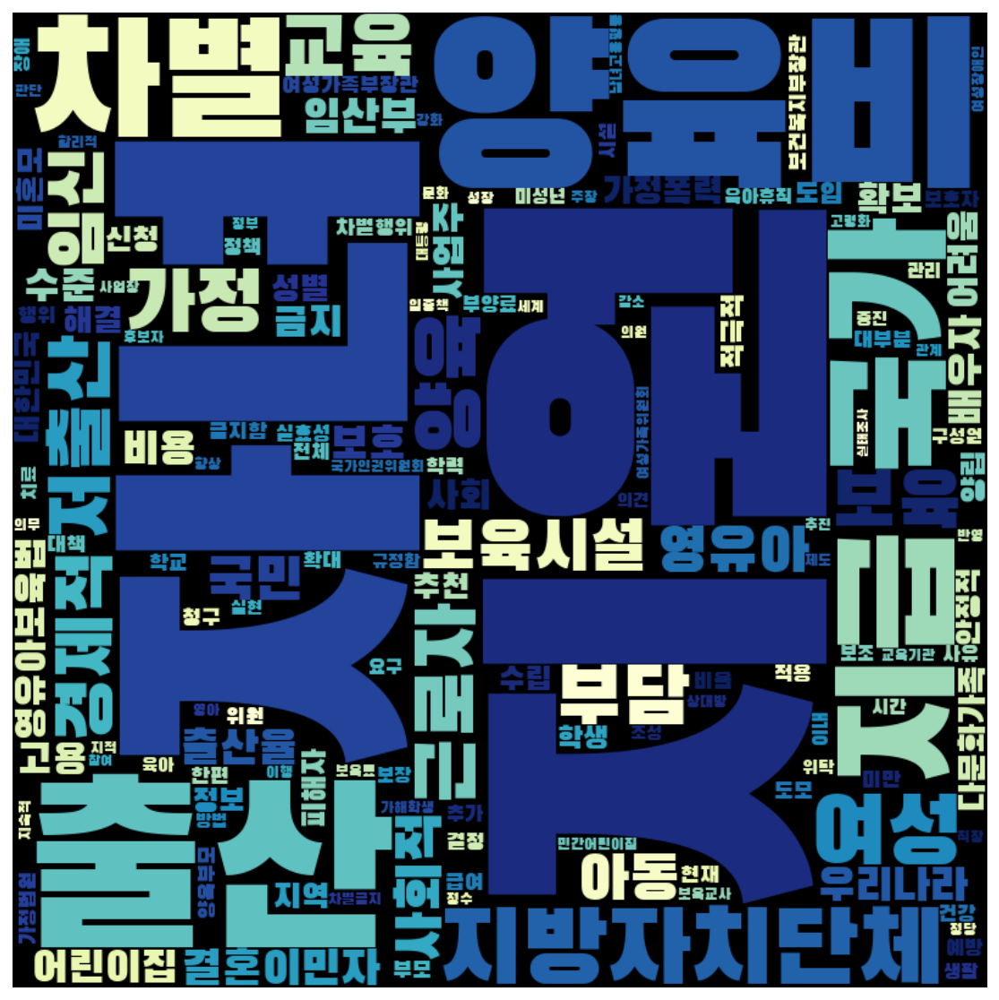

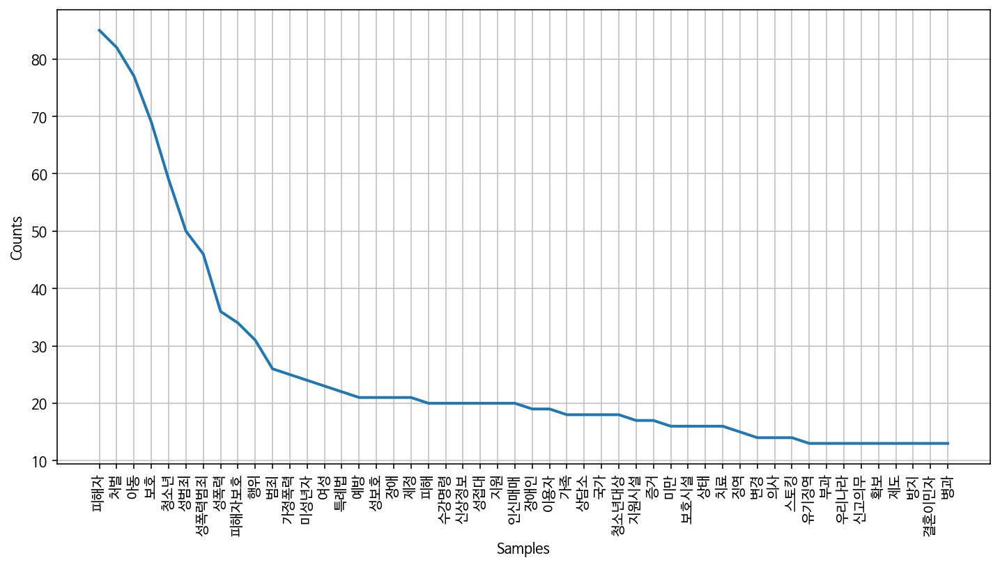

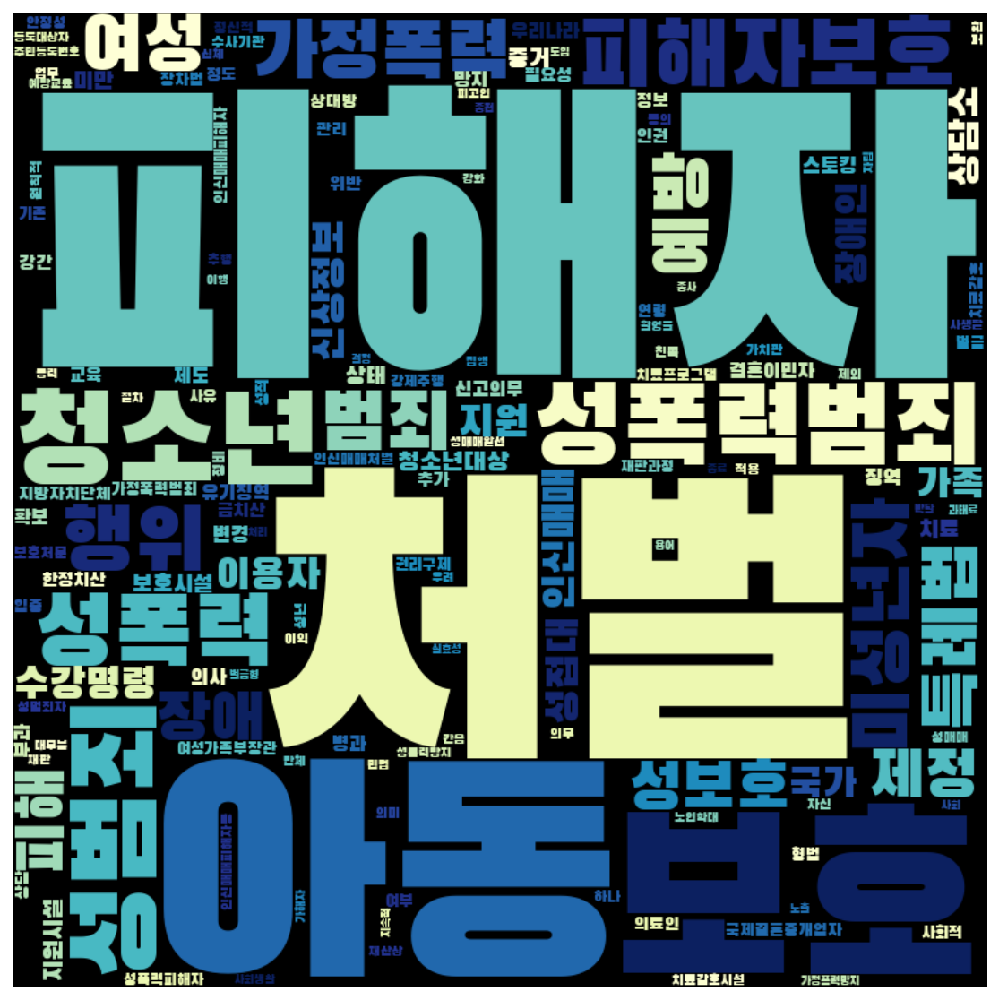

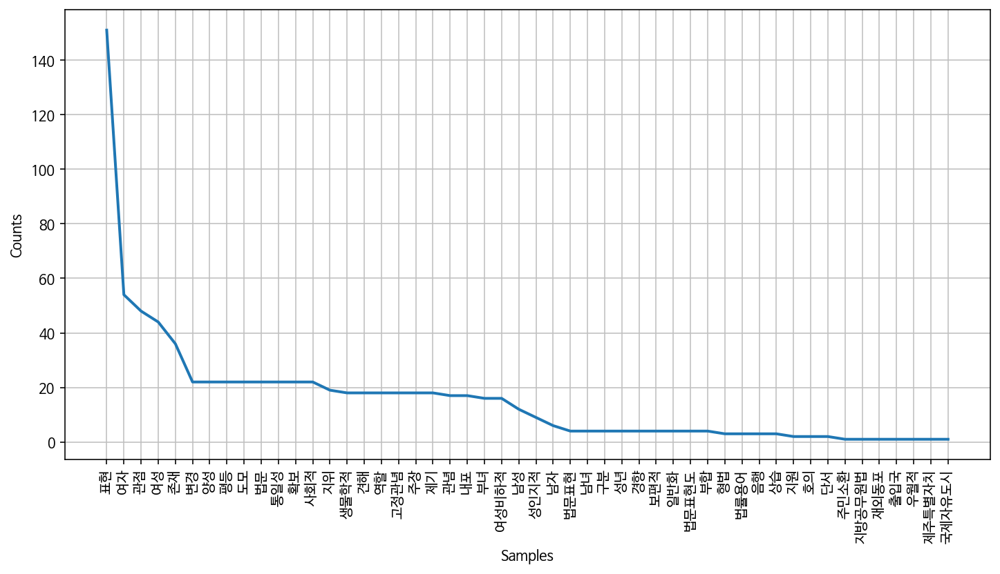

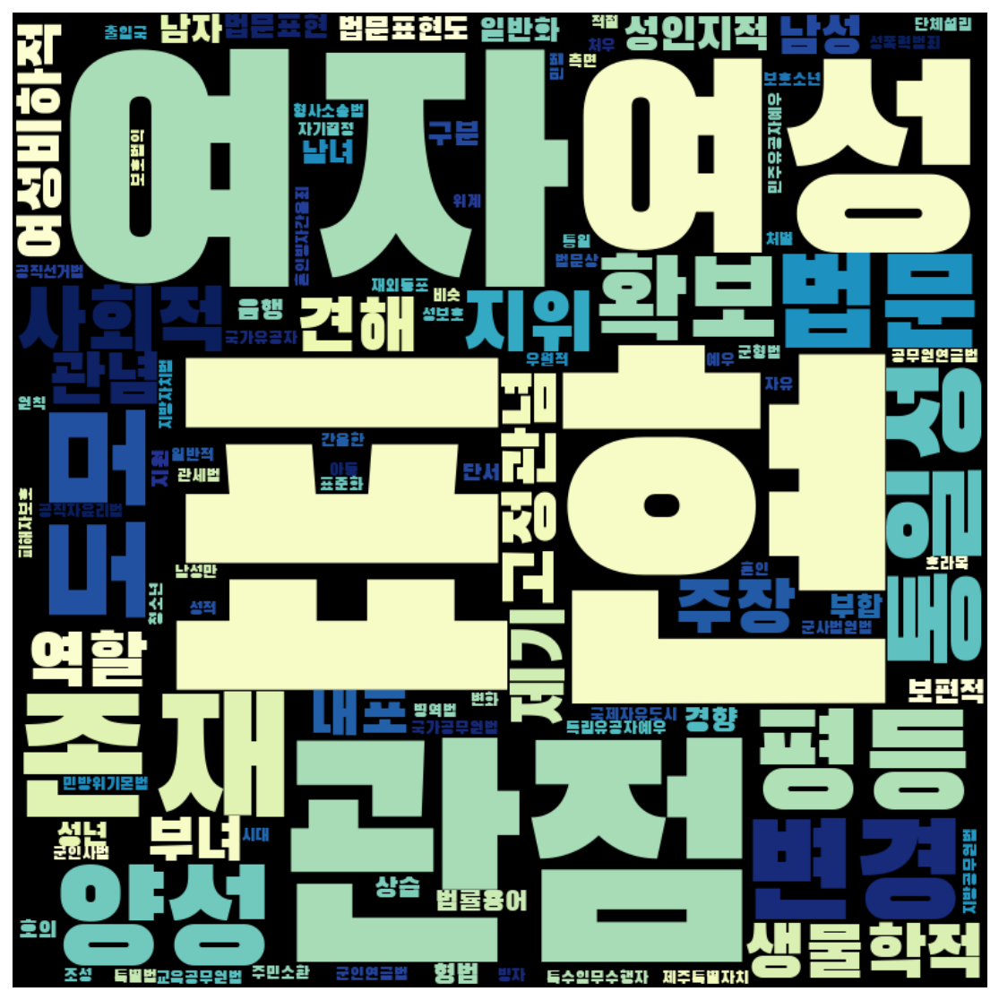

In [81]:
frewords_vis(pro_men_g1_tokens)
wordcloud_vis(pro_men_g1_tokens, 'YlGnBu')

frewords_vis(pro_men_g2_tokens)
wordcloud_vis(pro_men_g2_tokens, 'YlGnBu')

frewords_vis(pro_men_g3_tokens)
wordcloud_vis(pro_men_g3_tokens, 'YlGnBu')

In [82]:
con_women = con_women[con_women['명사수'] > 1]

# K means 수행 
word_vectors_con_women = con_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_women)
con_women['category'] = idx

print(con_women['category'].value_counts())

con_women_g1 = con_women[con_women['category'] == 0]
con_women_g2 = con_women[con_women['category'] == 1]
con_women_g3 = con_women[con_women['category'] == 2]

con_women_g1_tokens = total_tokens(con_women_g1['tokens'])
con_women_g2_tokens = total_tokens(con_women_g2['tokens'])
con_women_g3_tokens = total_tokens(con_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_women_g1_tokens = [each_word for each_word in con_women_g1_tokens if each_word not in stopwords]
con_women_g2_tokens = [each_word for each_word in con_women_g2_tokens if each_word not in stopwords]
con_women_g3_tokens = [each_word for each_word in con_women_g3_tokens if each_word not in stopwords]

2    126
1    104
0     12
Name: category, dtype: int64


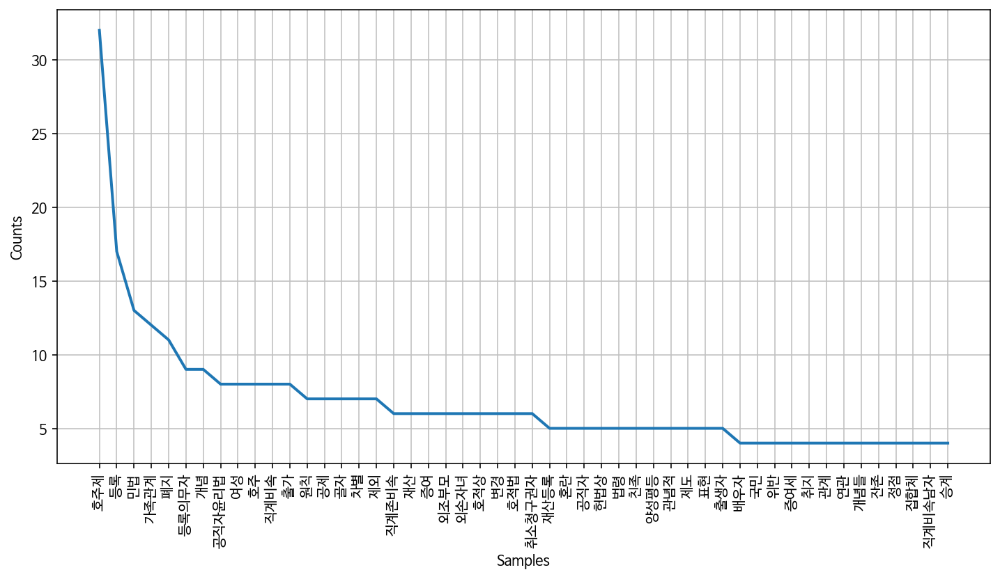

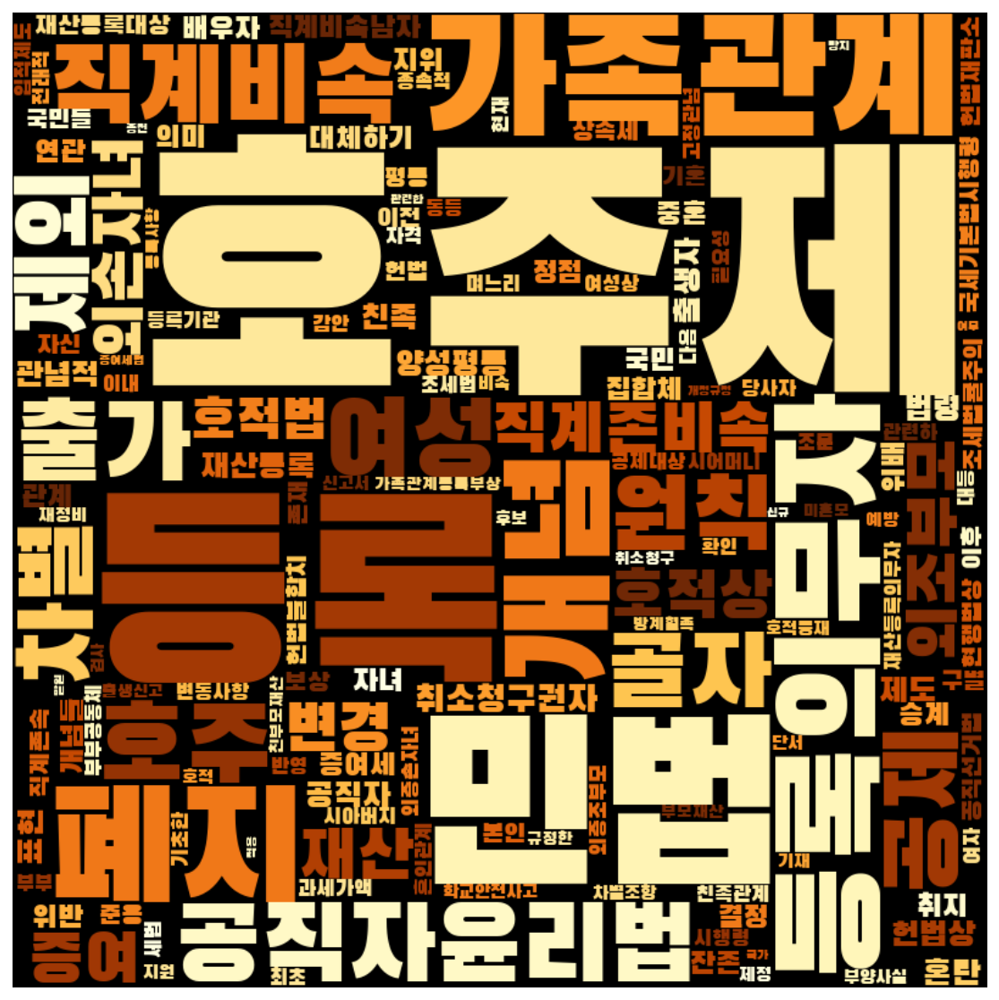

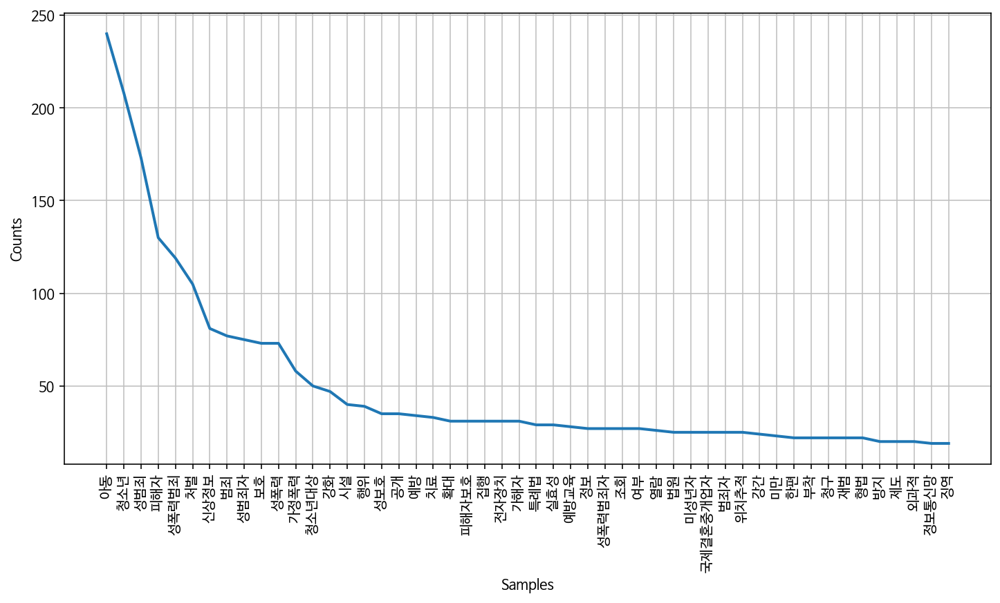

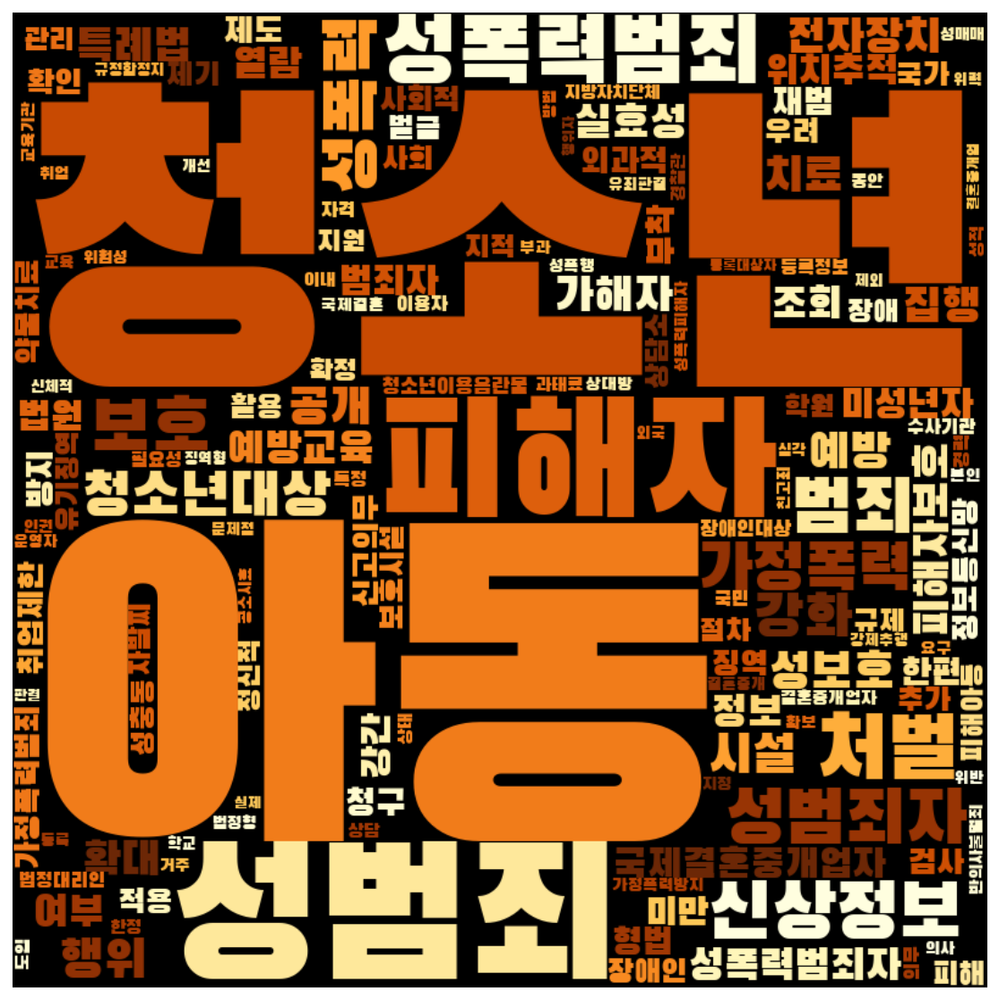

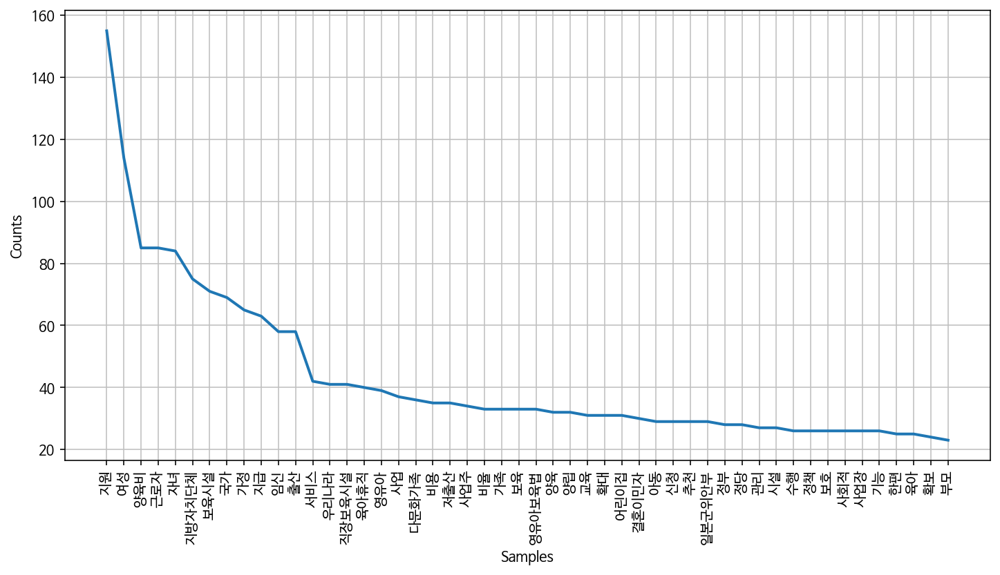

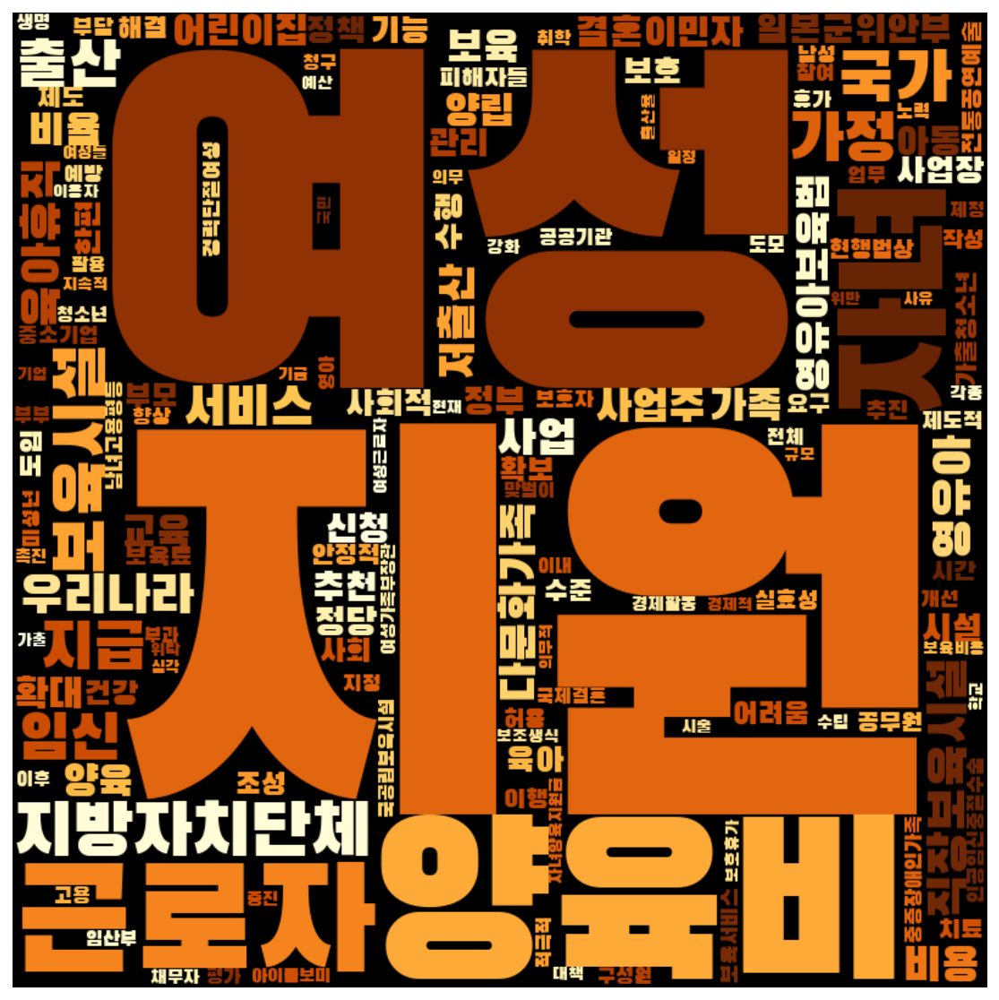

In [83]:
frewords_vis(con_women_g1_tokens)
wordcloud_vis(con_women_g1_tokens, 'YlOrBr')

frewords_vis(con_women_g2_tokens)
wordcloud_vis(con_women_g2_tokens, 'YlOrBr')

frewords_vis(con_women_g3_tokens)
wordcloud_vis(con_women_g3_tokens, 'YlOrBr')

In [84]:
con_men = con_men[con_men['명사수'] > 1]

# K means 수행 
word_vectors_con_men = con_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_men)
con_men['category'] = idx

print(con_men['category'].value_counts())

con_men_g1 = con_men[con_men['category'] == 0]
con_men_g2 = con_men[con_men['category'] == 1]
con_men_g3 = con_men[con_men['category'] == 2]

con_men_g1_tokens = total_tokens(con_men_g1['tokens'])
con_men_g2_tokens = total_tokens(con_men_g2['tokens'])
con_men_g3_tokens = total_tokens(con_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_men_g1_tokens = [each_word for each_word in con_men_g1_tokens if each_word not in stopwords]
con_men_g2_tokens = [each_word for each_word in con_men_g2_tokens if each_word not in stopwords]
con_men_g3_tokens = [each_word for each_word in con_men_g3_tokens if each_word not in stopwords]

1    148
0     92
2     81
Name: category, dtype: int64


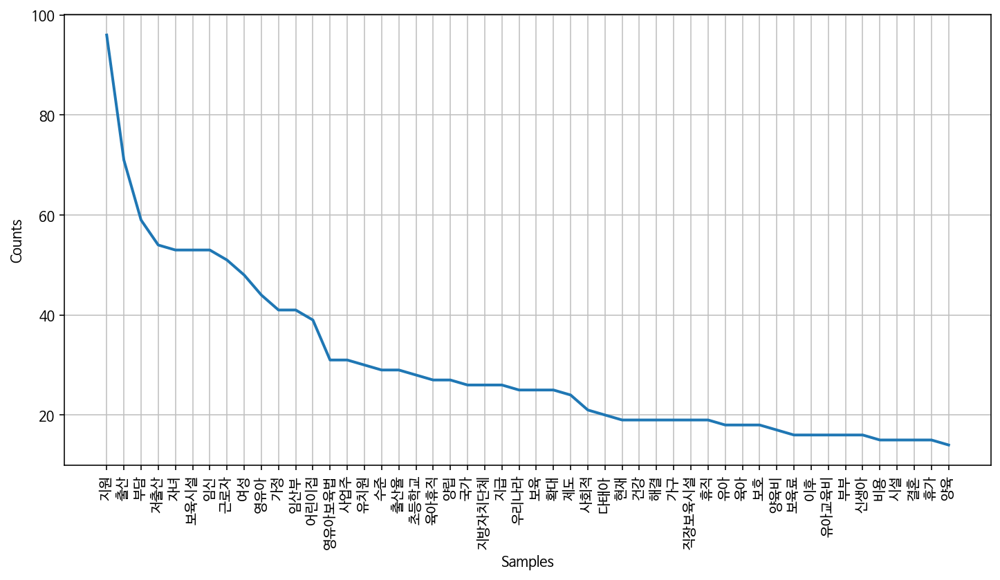

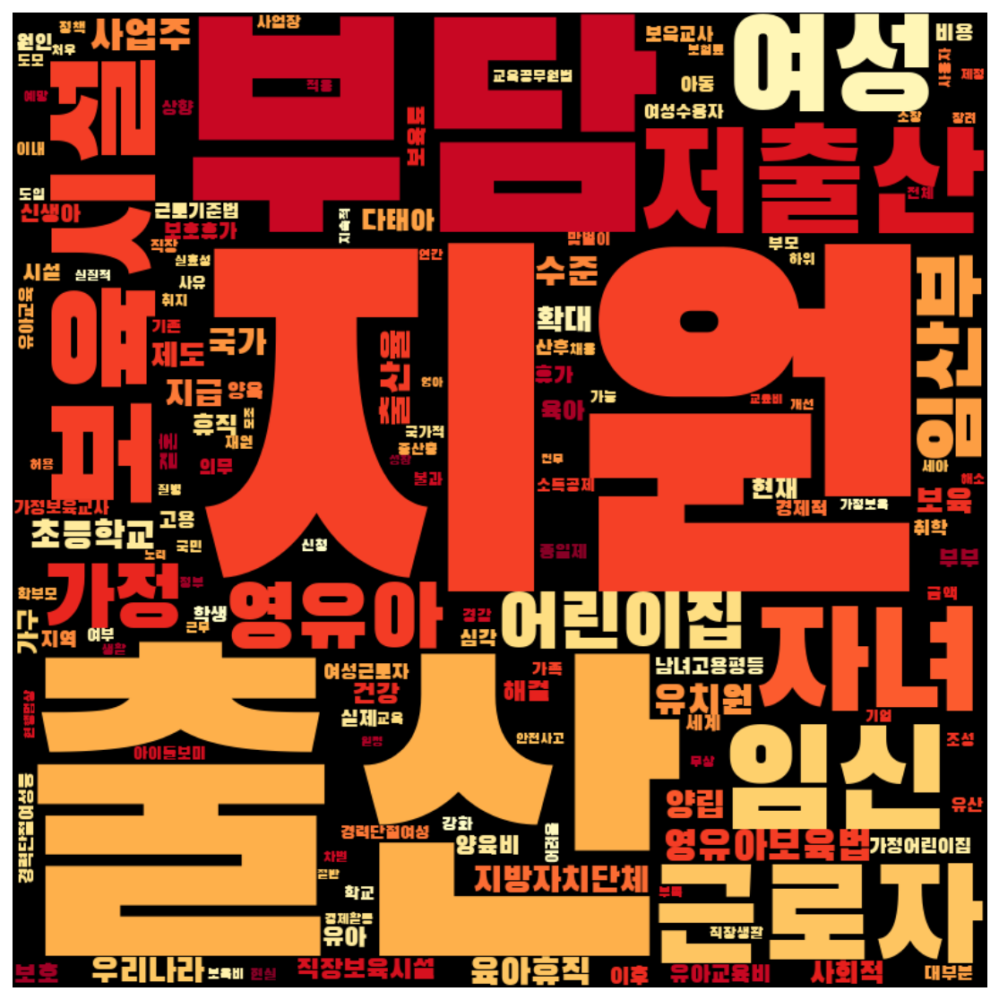

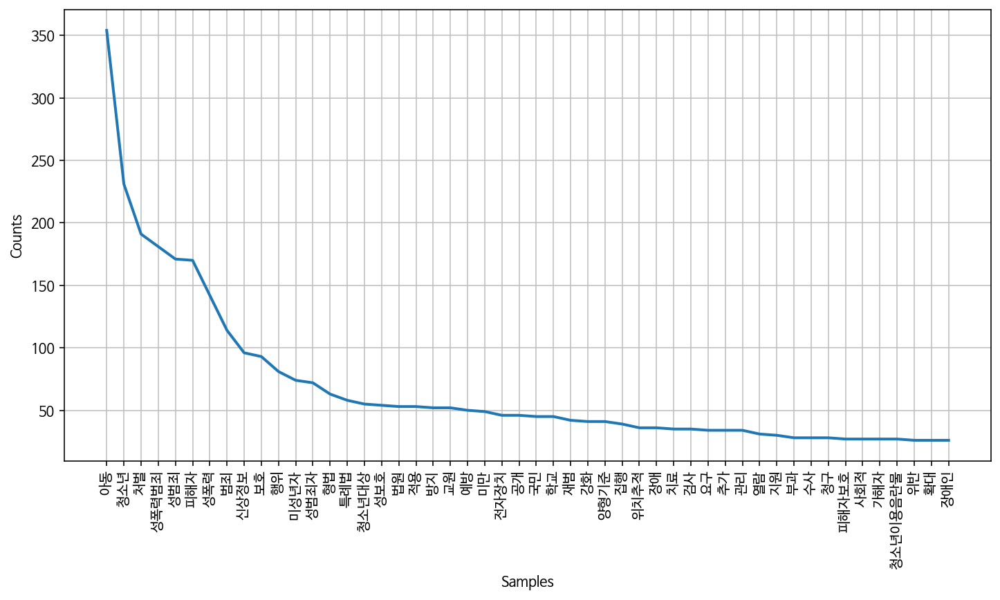

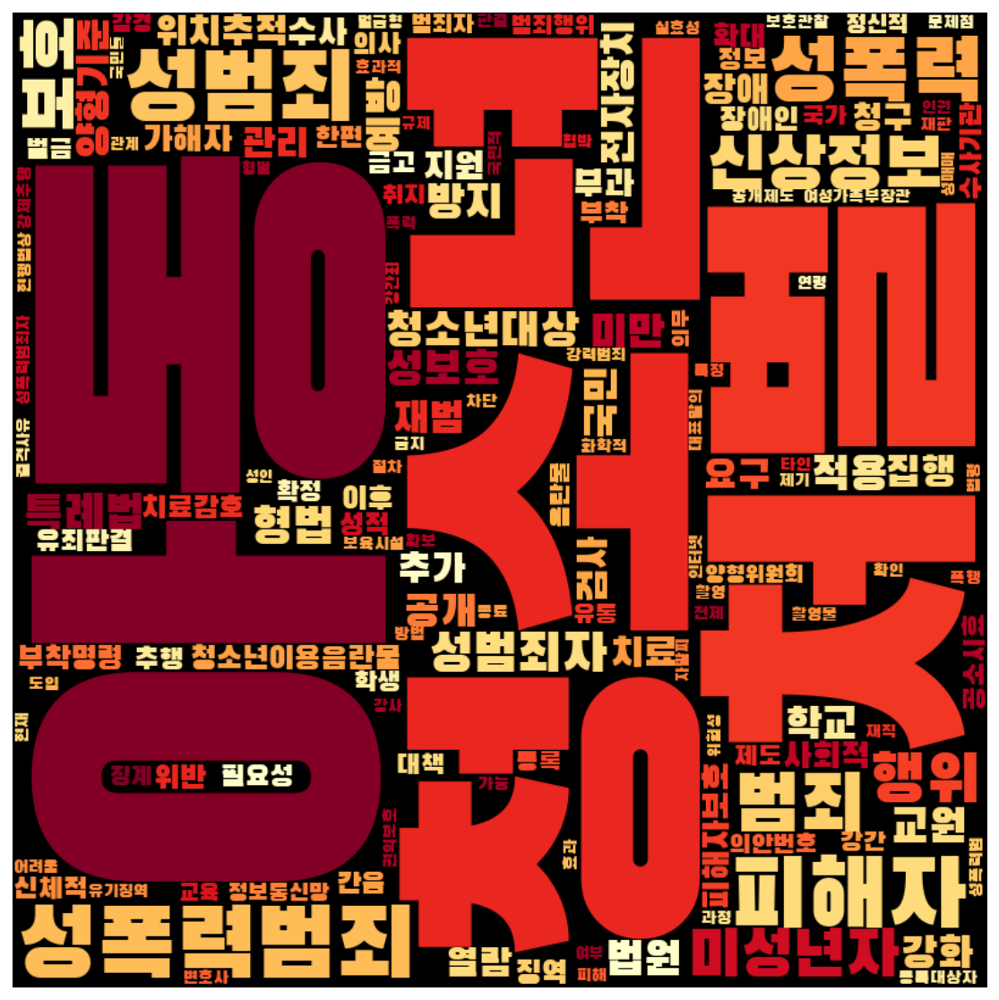

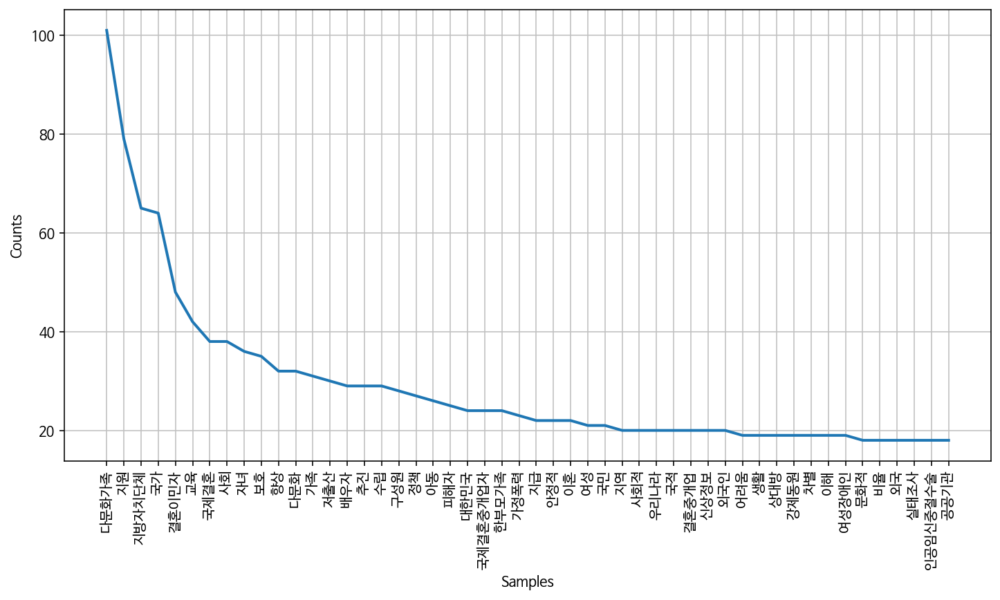

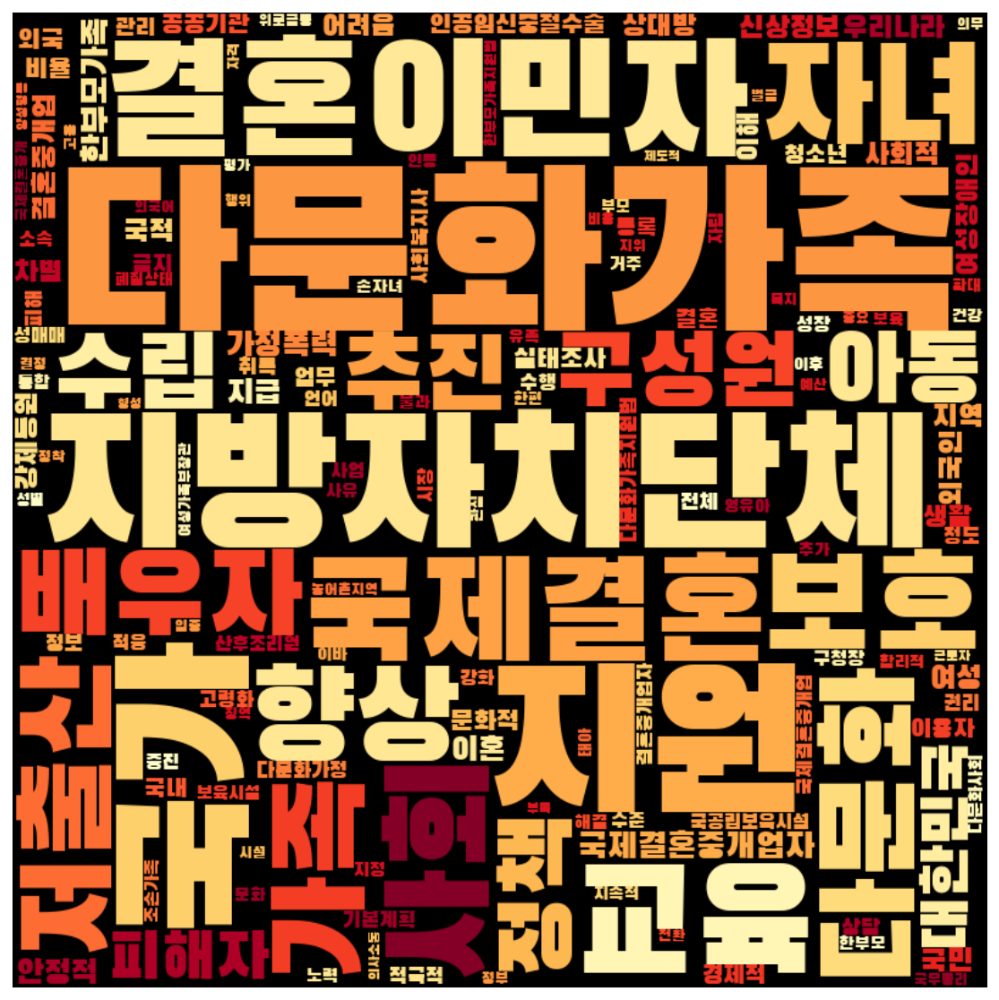

In [85]:
frewords_vis(con_men_g1_tokens)
wordcloud_vis(con_men_g1_tokens, 'YlOrRd')

frewords_vis(con_men_g2_tokens)
wordcloud_vis(con_men_g2_tokens, 'YlOrRd')

frewords_vis(con_men_g3_tokens)
wordcloud_vis(con_men_g3_tokens, 'YlOrRd')

## 박근혜 정권
- 2013.02.25 ~ 2017.03.13

In [50]:
parkkeunhye = gender[(gender['제안일자'] >= datetime.date(2013,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2017,5,10))]
parkkeunhye.shape

(1123, 19)

In [51]:
parkkeunhye['성별'].value_counts()

남성    567
여성    457
Name: 성별, dtype: int64

In [52]:
pd.DataFrame(parkkeunhye.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  170
     여성  168
진보   남성  392
     여성  285

In [53]:
pro_women = parkkeunhye[(parkkeunhye['성별'] == '여성') & (parkkeunhye['정당성향'] == '진보')]
pro_men = parkkeunhye[(parkkeunhye['성별'] == '남성') & (parkkeunhye['정당성향'] == '진보')]
con_women = parkkeunhye[(parkkeunhye['성별'] == '여성') & (parkkeunhye['정당성향'] == '보수')]
con_men = parkkeunhye[(parkkeunhye['성별'] == '남성') & (parkkeunhye['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]


In [69]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
ko_pro_men = nltk.Text(pro_men_word, name='진보 남성')
ko_con_women = nltk.Text(con_women_word, name='보수 여성')
ko_con_men = nltk.Text(con_men_word, name='보수 남성')

print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 241
젠더 단어 수: 0

남녀평등 단어 수: 5
양성평등 단어 수: 20
성평등 단어 수: 44
성인지적 단어 수: 5
성주류화 단어 수: 3

청소년 단어 수: 261
아동 단어 수: 192
###################
부녀 단어 수: 5
여자 단어 수: 14
여성 단어 수: 151
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 3
성평등 단어 수: 1
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 86
아동 단어 수: 128
###################
부녀 단어 수: 0
여자 단어 수: 1
여성 단어 수: 164
젠더 단어 수: 0

남녀평등 단어 수: 2
양성평등 단어 수: 17
성평등 단어 수: 10
성인지적 단어 수: 1
성주류화 단어 수: 0

청소년 단어 수: 91
아동 단어 수: 143
###################
부녀 단어 수: 3
여자 단어 수: 1
여성 단어 수: 74
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 2
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 78
아동 단어 수: 95


In [70]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 19
육아휴직 단어 수: 58
보육 단어 수: 24

위안부 단어 수: 23
일본군성노예제 단어 수: 41

성범죄 단어 수: 68
강간 단어 수: 14
성희롱 단어 수: 186
성폭력 단어 수: 89
성폭력범죄 단어 수: 75

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 137

가정폭력 단어 수: 87

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 51

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 1
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 133
육아휴직 단어 수: 69
보육 단어 수: 57

위안부 단어 수: 28
일본군성노예제 단어 수: 46

성범죄 단어 수: 73
강간 단어 수: 7
성희롱 단어 수: 49
성폭력 단어 수: 41
성폭력범죄 단어 수: 85

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 23

가정폭력 단어 수: 27

낙태 단어 수: 1
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 2
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 70
육아휴직 단어 수: 76
보육 단어 수: 16

위안부 단어 수: 0
일본군성노예제 단어 수: 3

성범죄 단어 수: 74
강간 단어 수: 5
성희롱 단어 수: 35
성폭력 단어 수: 41
성폭력범죄 단어 수: 17

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 29

가정폭력 단어 수: 19

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어

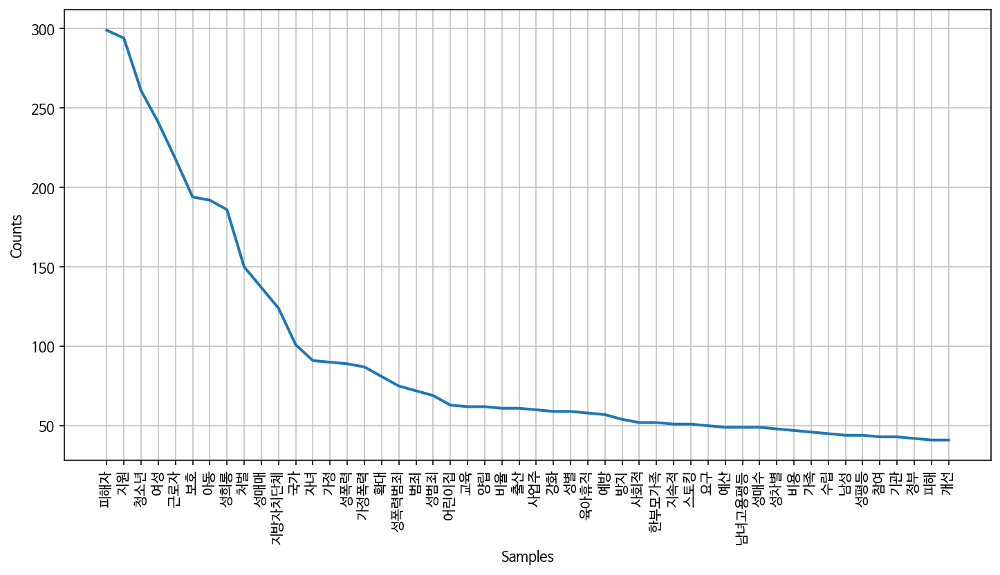

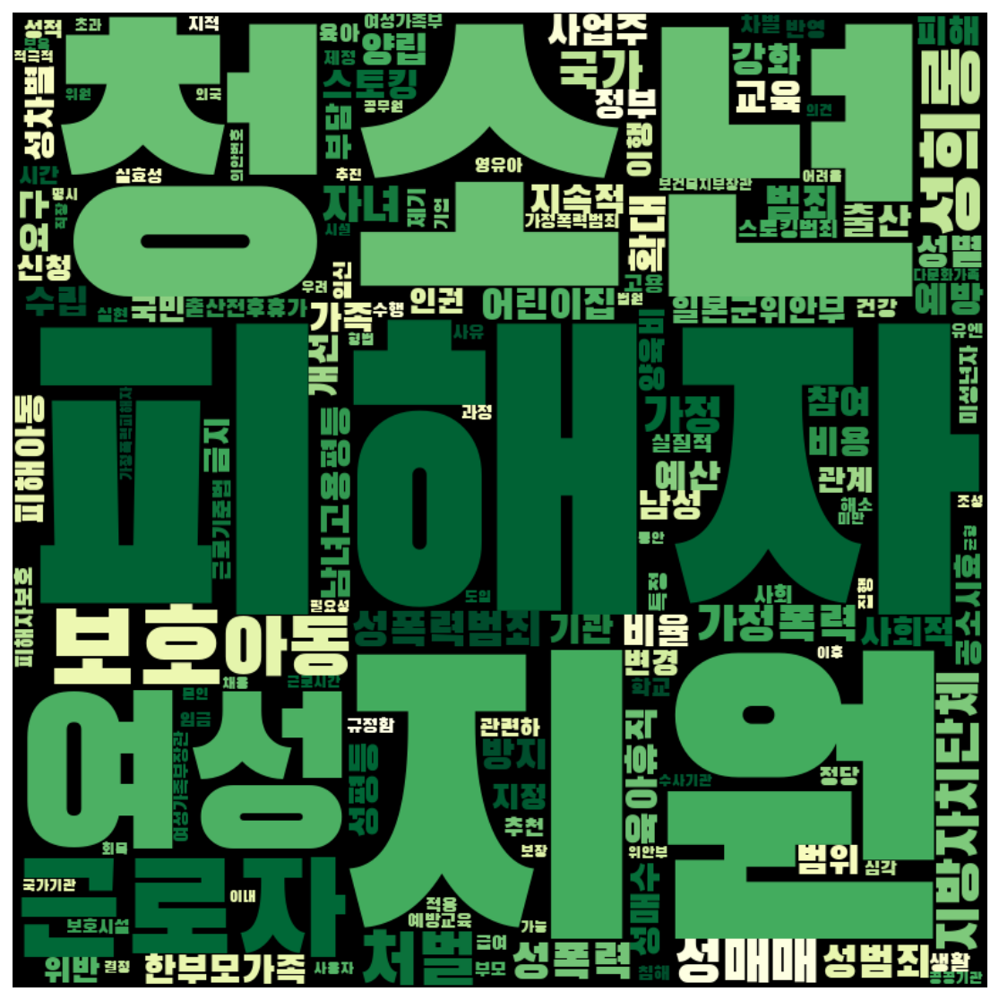

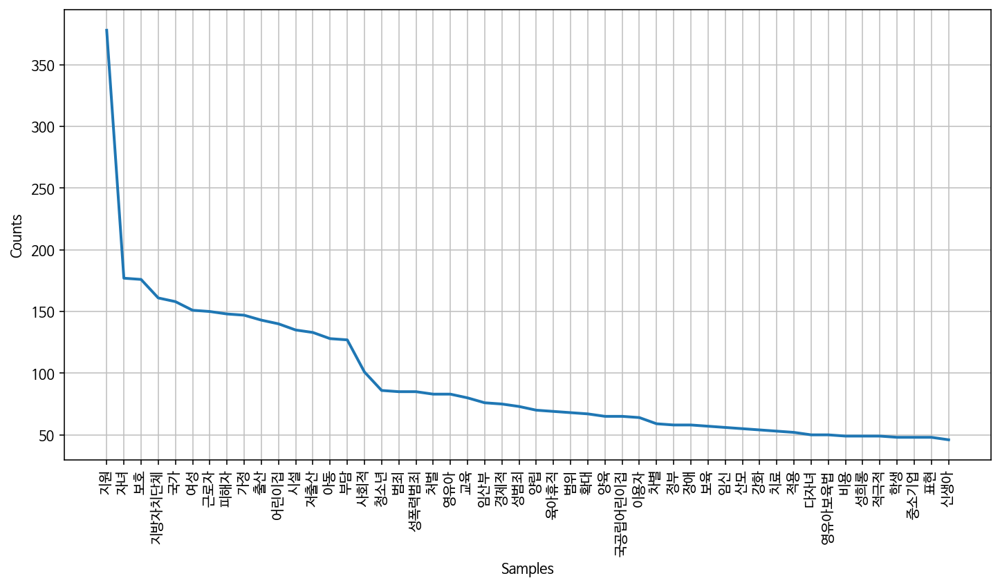

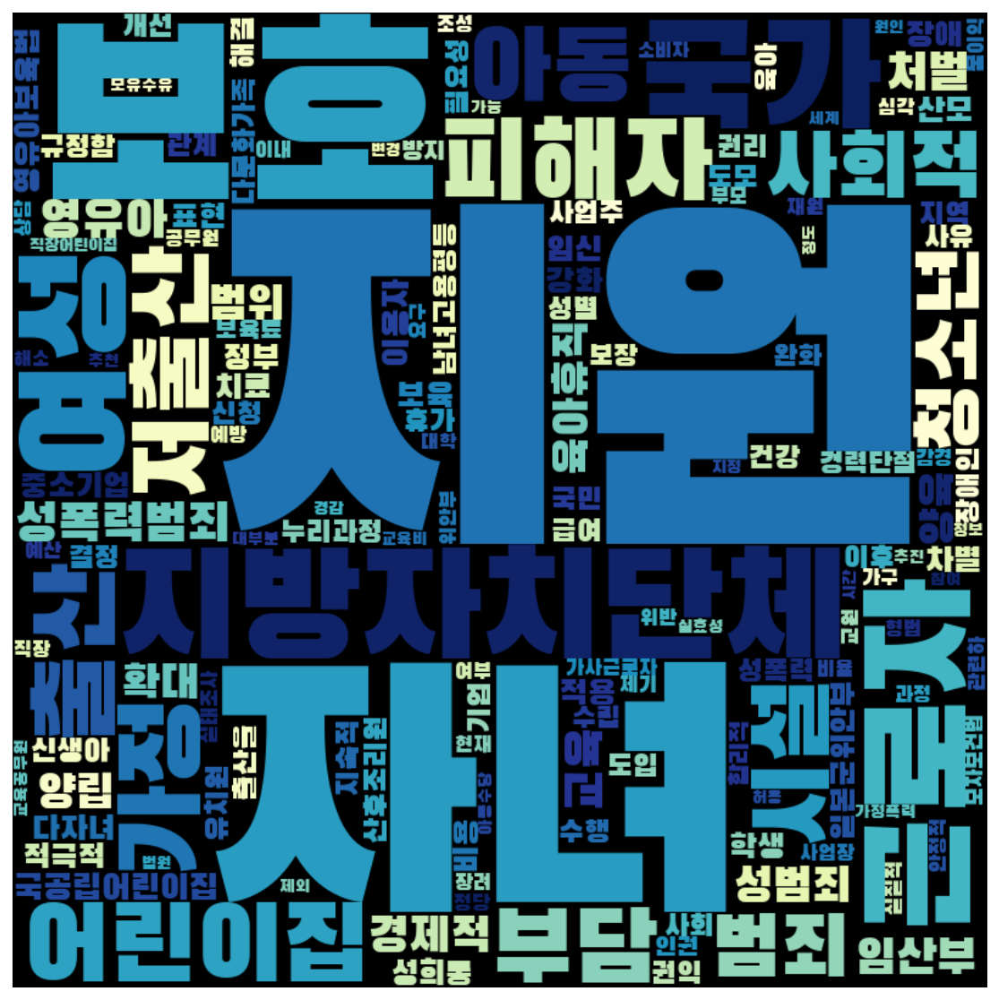

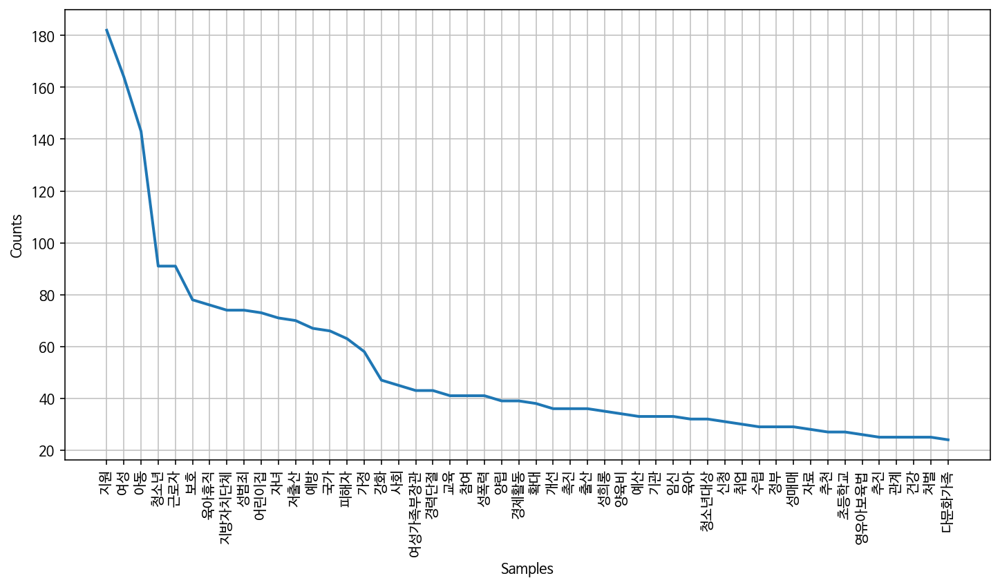

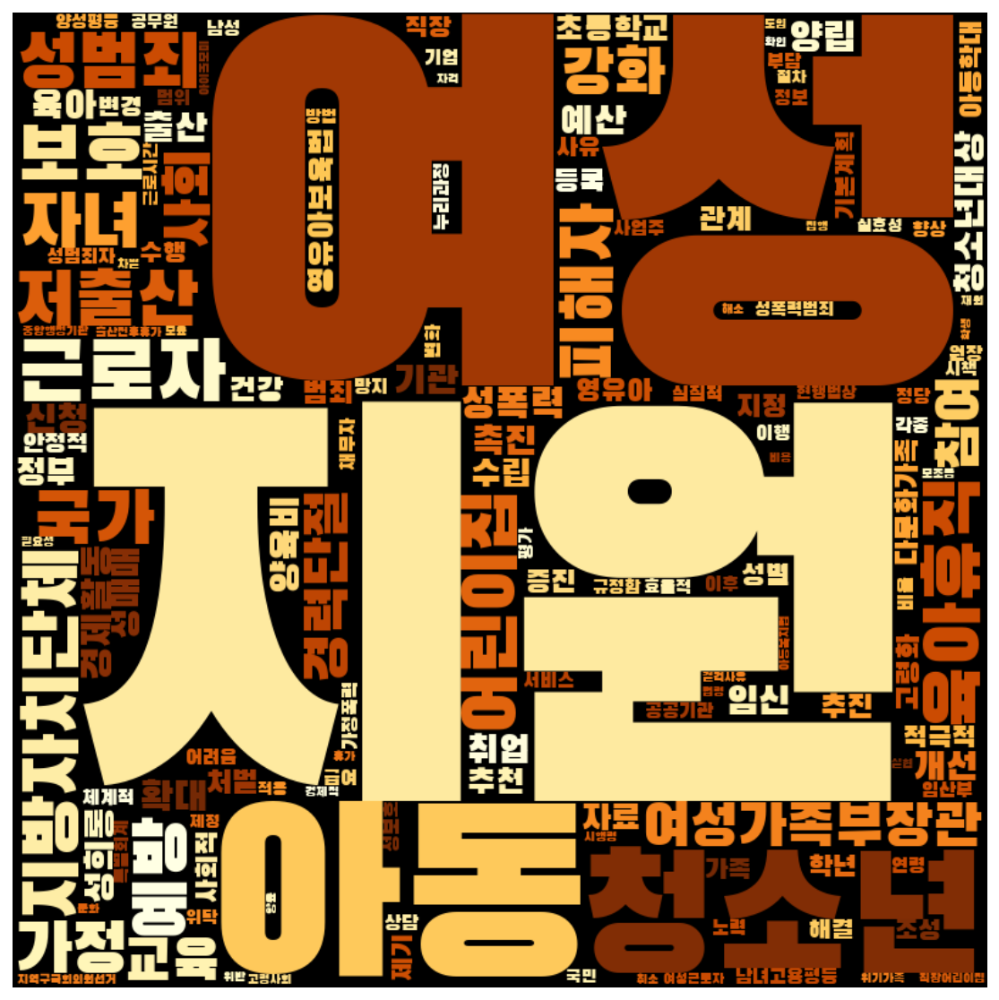

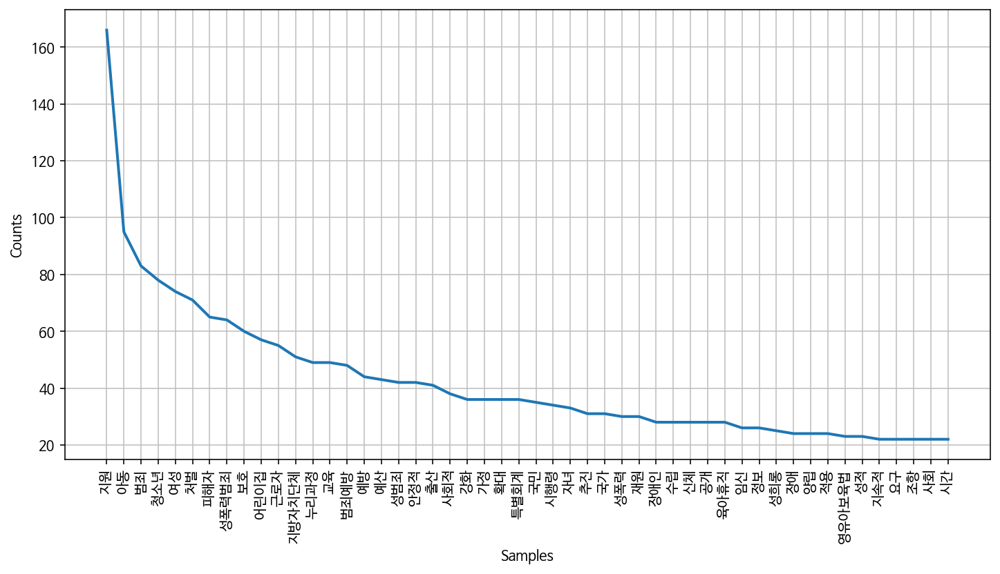

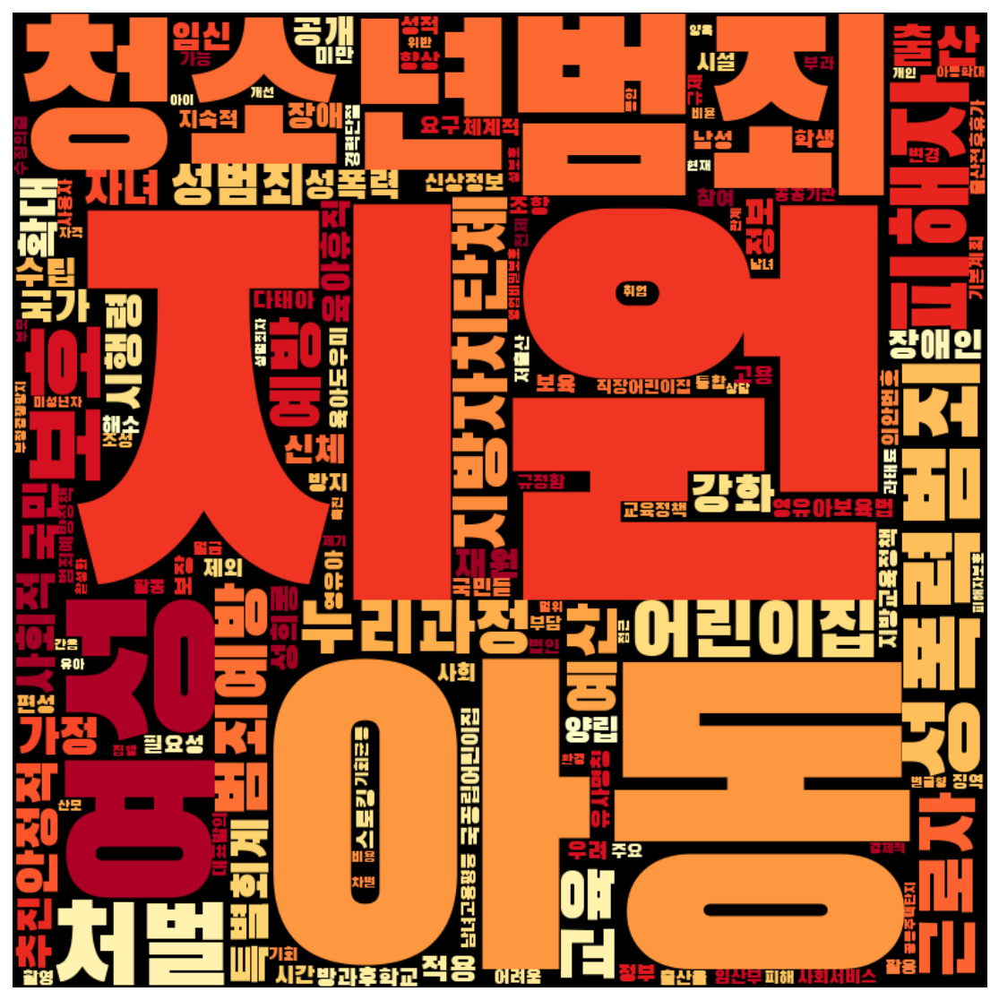

In [54]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [92]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-24 14:18:56,498 : INFO : collecting all words and their counts
2020-10-24 14:18:56,501 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-24 14:18:56,510 : INFO : collected 4538 word types from a corpus of 22897 raw words and 284 sentences
2020-10-24 14:18:56,511 : INFO : Loading a fresh vocabulary
2020-10-24 14:18:56,516 : INFO : effective_min_count=10 retains 503 unique words (11% of original 4538, drops 4035)
2020-10-24 14:18:56,517 : INFO : effective_min_count=10 leaves 13586 word corpus (59% of original 22897, drops 9311)
2020-10-24 14:18:56,521 : INFO : deleting the raw counts dictionary of 4538 items
2020-10-24 14:18:56,522 : INFO : sample=0.001 downsamples 85 most-common words
2020-10-24 14:18:56,523 : INFO : downsampling leaves estimated 10820 word corpus (79.6% of prior 13586)
2020-10-24 14:18:56,525 : INFO : estimated required memory for 503 words and 100 dimensions: 653900 bytes
2020-10-24 14:18:56,526 : INFO : resetting layer weights

2020-10-24 14:18:57,516 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:57,533 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:57,539 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:57,542 : INFO : EPOCH - 15 : training on 22897 raw words (10832 effective words) took 0.0s, 219222 effective words/s
2020-10-24 14:18:57,548 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:57,576 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:57,587 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:57,601 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:57,602 : INFO : EPOCH - 16 : training on 22897 raw words (10806 effective words) took 0.1s, 190167 effective words/s
2020-10-24 14:18:57,615 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:18:58,444 : INFO : EPOCH - 31 : training on 22897 raw words (10802 effective words) took 0.0s, 217394 effective words/s
2020-10-24 14:18:58,454 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:58,475 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:58,486 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:58,495 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:58,495 : INFO : EPOCH - 32 : training on 22897 raw words (10768 effective words) took 0.0s, 221772 effective words/s
2020-10-24 14:18:58,500 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:58,534 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:58,539 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:58,547 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:18:59,341 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:59,360 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:59,362 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:59,363 : INFO : EPOCH - 48 : training on 22897 raw words (10813 effective words) took 0.0s, 238008 effective words/s
2020-10-24 14:18:59,369 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:18:59,388 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:18:59,413 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:18:59,416 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:18:59,416 : INFO : EPOCH - 49 : training on 22897 raw words (10845 effective words) took 0.1s, 215025 effective words/s
2020-10-24 14:18:59,422 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:19:00,210 : INFO : EPOCH - 64 : training on 22897 raw words (10822 effective words) took 0.1s, 182573 effective words/s
2020-10-24 14:19:00,217 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:00,236 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:00,258 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:00,268 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:00,269 : INFO : EPOCH - 65 : training on 22897 raw words (10763 effective words) took 0.1s, 197037 effective words/s
2020-10-24 14:19:00,276 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:00,291 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:00,317 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:00,318 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:19:01,200 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:01,221 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:01,222 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:01,223 : INFO : EPOCH - 81 : training on 22897 raw words (10877 effective words) took 0.0s, 286408 effective words/s
2020-10-24 14:19:01,227 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:01,244 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:01,262 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:01,267 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:01,267 : INFO : EPOCH - 82 : training on 22897 raw words (10868 effective words) took 0.0s, 254622 effective words/s
2020-10-24 14:19:01,271 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:19:02,002 : INFO : EPOCH - 97 : training on 22897 raw words (10818 effective words) took 0.0s, 259267 effective words/s
2020-10-24 14:19:02,006 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:02,035 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:02,053 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:02,060 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:02,061 : INFO : EPOCH - 98 : training on 22897 raw words (10825 effective words) took 0.1s, 189137 effective words/s
2020-10-24 14:19:02,069 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:02,089 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:02,113 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:02,121 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:19:02,919 : INFO : EPOCH - 11 : training on 25671 raw words (12481 effective words) took 0.0s, 252018 effective words/s
2020-10-24 14:19:02,922 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:02,956 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:02,966 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:02,968 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:02,969 : INFO : EPOCH - 12 : training on 25671 raw words (12480 effective words) took 0.0s, 260463 effective words/s
2020-10-24 14:19:02,972 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:03,011 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:03,013 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:03,022 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:19:03,897 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:03,910 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:03,911 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:03,912 : INFO : EPOCH - 28 : training on 25671 raw words (12396 effective words) took 0.0s, 319949 effective words/s
2020-10-24 14:19:03,923 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:03,954 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:03,961 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:03,963 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:03,965 : INFO : EPOCH - 29 : training on 25671 raw words (12364 effective words) took 0.0s, 293723 effective words/s
2020-10-24 14:19:03,974 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:19:04,832 : INFO : EPOCH - 44 : training on 25671 raw words (12403 effective words) took 0.1s, 238120 effective words/s
2020-10-24 14:19:04,839 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:04,869 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:04,878 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:04,891 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:04,892 : INFO : EPOCH - 45 : training on 25671 raw words (12441 effective words) took 0.1s, 224705 effective words/s
2020-10-24 14:19:04,905 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:04,935 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:04,939 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:04,950 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:19:05,820 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:05,823 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:05,833 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:05,835 : INFO : EPOCH - 61 : training on 25671 raw words (12453 effective words) took 0.1s, 218223 effective words/s
2020-10-24 14:19:05,848 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:05,877 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:05,888 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:05,899 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:05,902 : INFO : EPOCH - 62 : training on 25671 raw words (12437 effective words) took 0.1s, 202513 effective words/s
2020-10-24 14:19:05,916 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:19:06,771 : INFO : EPOCH - 77 : training on 25671 raw words (12505 effective words) took 0.1s, 228856 effective words/s
2020-10-24 14:19:06,778 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:06,817 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:06,819 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:06,830 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:06,830 : INFO : EPOCH - 78 : training on 25671 raw words (12398 effective words) took 0.1s, 227225 effective words/s
2020-10-24 14:19:06,836 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:06,873 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:06,877 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:06,888 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:19:07,744 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:07,750 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:07,759 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:07,760 : INFO : EPOCH - 94 : training on 25671 raw words (12420 effective words) took 0.1s, 214405 effective words/s
2020-10-24 14:19:07,772 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:07,798 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:07,805 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:07,812 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:07,813 : INFO : EPOCH - 95 : training on 25671 raw words (12419 effective words) took 0.0s, 275820 effective words/s
2020-10-24 14:19:07,822 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:19:08,444 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:08,456 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:08,465 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:08,466 : INFO : EPOCH - 8 : training on 12329 raw words (4354 effective words) took 0.0s, 159293 effective words/s
2020-10-24 14:19:08,477 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:08,478 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:08,495 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:08,498 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:08,500 : INFO : EPOCH - 9 : training on 12329 raw words (4316 effective words) took 0.0s, 144452 effective words/s
2020-10-24 14:19:08,505 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-24 14:19:09,004 : INFO : EPOCH - 24 : training on 12329 raw words (4312 effective words) took 0.0s, 157385 effective words/s
2020-10-24 14:19:09,015 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:09,017 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:09,023 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:09,038 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:09,040 : INFO : EPOCH - 25 : training on 12329 raw words (4289 effective words) took 0.0s, 162745 effective words/s
2020-10-24 14:19:09,051 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:09,053 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:09,060 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:09,076 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:19:09,576 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:09,591 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:09,591 : INFO : EPOCH - 41 : training on 12329 raw words (4338 effective words) took 0.0s, 158908 effective words/s
2020-10-24 14:19:09,600 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:09,603 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:09,610 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:09,623 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:09,624 : INFO : EPOCH - 42 : training on 12329 raw words (4339 effective words) took 0.0s, 150565 effective words/s
2020-10-24 14:19:09,630 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:09,636 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:19:10,138 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:10,144 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:10,147 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:10,155 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:10,157 : INFO : EPOCH - 58 : training on 12329 raw words (4380 effective words) took 0.0s, 150950 effective words/s
2020-10-24 14:19:10,168 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:10,173 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:10,176 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:10,188 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:10,190 : INFO : EPOCH - 59 : training on 12329 raw words (4315 effective words) took 0.0s, 151982 effective words/s
2020-1

2020-10-24 14:19:10,674 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:10,675 : INFO : EPOCH - 74 : training on 12329 raw words (4269 effective words) took 0.0s, 162199 effective words/s
2020-10-24 14:19:10,680 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:10,687 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:10,693 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:10,704 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:10,704 : INFO : EPOCH - 75 : training on 12329 raw words (4343 effective words) took 0.0s, 164881 effective words/s
2020-10-24 14:19:10,710 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:10,712 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:10,720 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:19:11,194 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:11,203 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:11,209 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:11,210 : INFO : EPOCH - 91 : training on 12329 raw words (4350 effective words) took 0.0s, 189567 effective words/s
2020-10-24 14:19:11,226 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:11,228 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:11,235 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:11,241 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:11,243 : INFO : EPOCH - 92 : training on 12329 raw words (4363 effective words) took 0.0s, 163613 effective words/s
2020-10-24 14:19:11,254 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-24 14:19:11,721 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:11,727 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:11,734 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:11,735 : INFO : EPOCH - 5 : training on 12008 raw words (3866 effective words) took 0.0s, 159689 effective words/s
2020-10-24 14:19:11,745 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:11,756 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:11,761 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:11,763 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:11,764 : INFO : EPOCH - 6 : training on 12008 raw words (3831 effective words) took 0.0s, 157177 effective words/s
2020-10-24 14:19:11,770 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-24 14:19:12,175 : INFO : EPOCH - 21 : training on 12008 raw words (3846 effective words) took 0.0s, 175670 effective words/s
2020-10-24 14:19:12,181 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:12,187 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:12,192 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:12,200 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:12,202 : INFO : EPOCH - 22 : training on 12008 raw words (3856 effective words) took 0.0s, 167231 effective words/s
2020-10-24 14:19:12,210 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:12,211 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:12,214 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:12,226 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:19:12,670 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:12,678 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:12,678 : INFO : EPOCH - 38 : training on 12008 raw words (3822 effective words) took 0.0s, 166719 effective words/s
2020-10-24 14:19:12,685 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:12,692 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:12,697 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:12,706 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:12,706 : INFO : EPOCH - 39 : training on 12008 raw words (3874 effective words) took 0.0s, 183102 effective words/s
2020-10-24 14:19:12,712 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:12,718 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:19:13,156 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:13,160 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:13,164 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:13,166 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:13,170 : INFO : EPOCH - 55 : training on 12008 raw words (3859 effective words) took 0.0s, 151799 effective words/s
2020-10-24 14:19:13,175 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:13,180 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:13,189 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:13,195 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:13,196 : INFO : EPOCH - 56 : training on 12008 raw words (3810 effective words) took 0.0s, 166596 effective words/s
2020-1

2020-10-24 14:19:13,609 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:13,611 : INFO : EPOCH - 71 : training on 12008 raw words (3865 effective words) took 0.0s, 161828 effective words/s
2020-10-24 14:19:13,617 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:13,620 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:13,625 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:13,638 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:13,639 : INFO : EPOCH - 72 : training on 12008 raw words (3893 effective words) took 0.0s, 170699 effective words/s
2020-10-24 14:19:13,649 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:13,654 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:13,657 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:19:14,059 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:14,061 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:14,069 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:14,070 : INFO : EPOCH - 88 : training on 12008 raw words (3855 effective words) took 0.0s, 199209 effective words/s
2020-10-24 14:19:14,077 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:19:14,090 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:19:14,094 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:19:14,096 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:19:14,098 : INFO : EPOCH - 89 : training on 12008 raw words (3831 effective words) took 0.0s, 176175 effective words/s
2020-10-24 14:19:14,105 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

In [93]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-24 14:19:14,410 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:19:14,413 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:19:14,415 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:19:14,417 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('남성', 0.49943187832832336), ('정치참여', 0.46297115087509155), ('참여', 0.45764636993408203), ('공직선거법', 0.4522724151611328), ('지역구', 0.447858065366745), ('추천', 0.43405506014823914), ('경력단절', 0.3966459631919861), ('실현', 0.38605570793151855), ('양성평등', 0.3773784637451172), ('경제활동', 0.3749632239341736)]
진보 남성: [('재고용', 0.44697099924087524), ('경력단절', 0.43956321477890015), ('선거', 0.4266992211341858), ('기혼여성', 0.41933876276016235), ('관점', 0.4067102074623108), ('경제활동', 0.4000367224216461), ('후보자', 0.3877544403076172), ('평등', 0.38301512598991394), ('결혼', 0.378109335899353), ('추천', 0.3719637393951416)]
보수 여성: [('경제활동', 0.5805579423904419), ('정수', 0.5648409128189087), ('촉진', 0.5014622211456299), ('확대', 0.49396249651908875), ('경력단절여성등', 0.4862993061542511), ('후보자', 0.4512060880661011), ('경력단절', 0.44888514280319214), ('확산', 0.4408529996871948), ('특성', 0.4152984917163849), ('촉진법', 0.4126202166080475)]
보수 남성: [('육아', 0.49079394340515137), ('출산', 0.46918919682502747), ('경력단절', 0.46855977177619934),

In [94]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

<ipython-input-94-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-94-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
<ipython-input-94-4fb28107e7ed>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [95]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [96]:
pro_women['category'].value_counts()

1    126
0    100
2     58
Name: category, dtype: int64

In [97]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
pro_women_g3 = pro_women[pro_women['category'] == 2]

In [98]:
pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
pro_women_g3_tokens = total_tokens(pro_women_g3['tokens'])

In [99]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
pro_women_g3_tokens = [each_word for each_word in pro_women_g3_tokens if each_word not in stopwords]

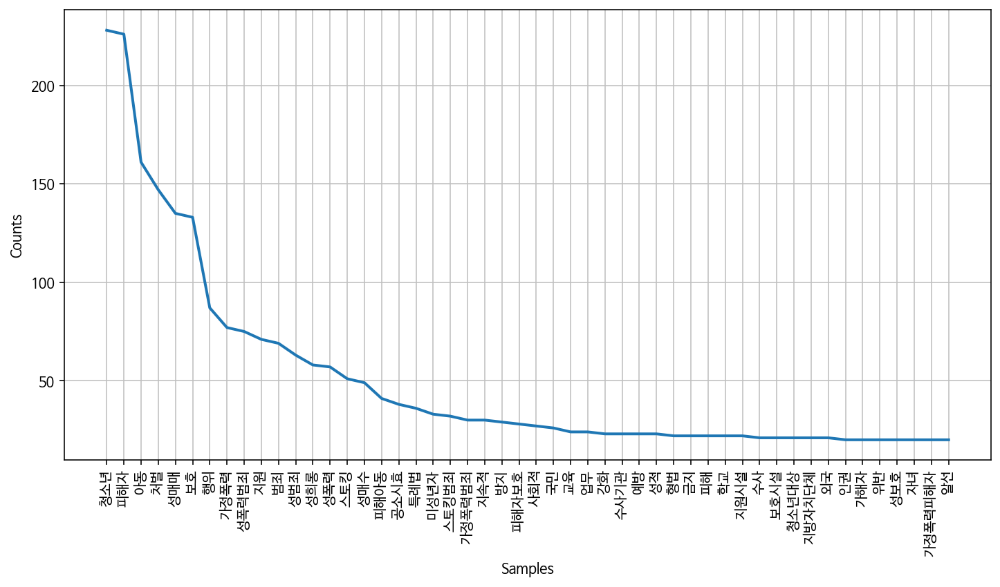

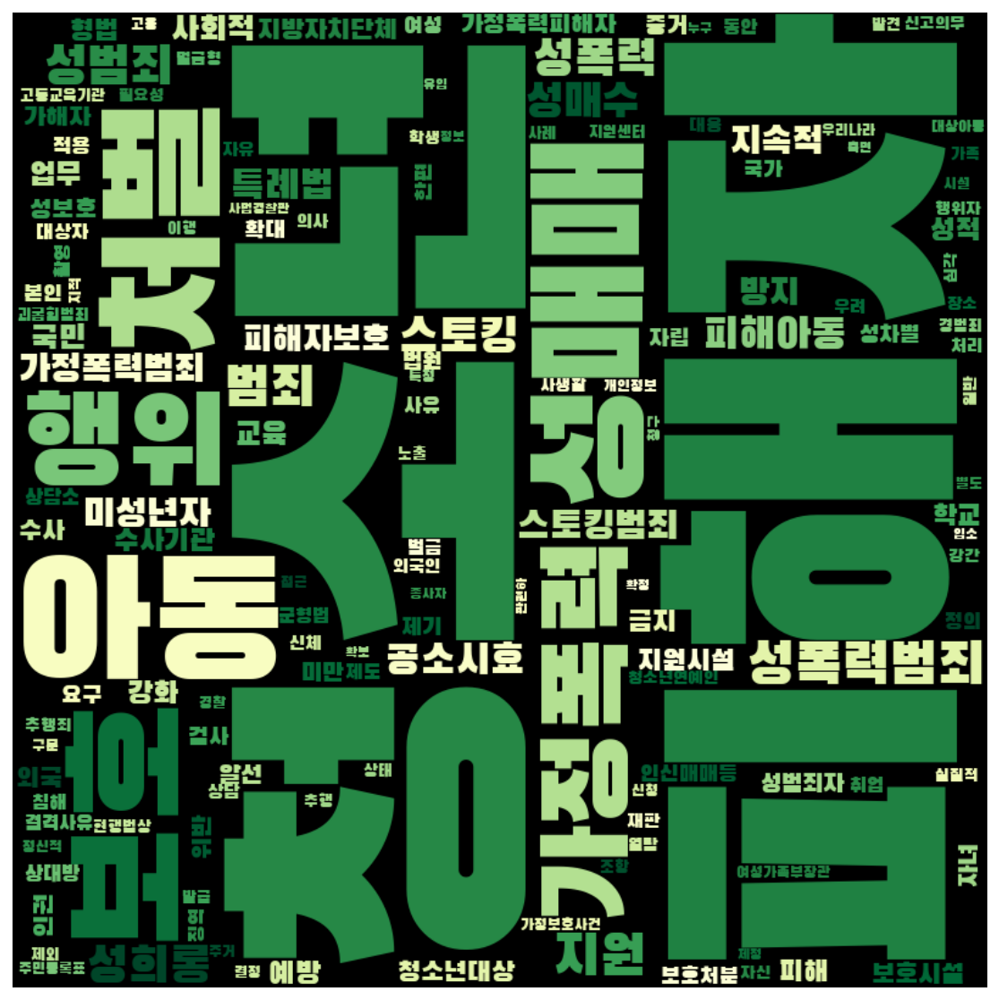

In [100]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

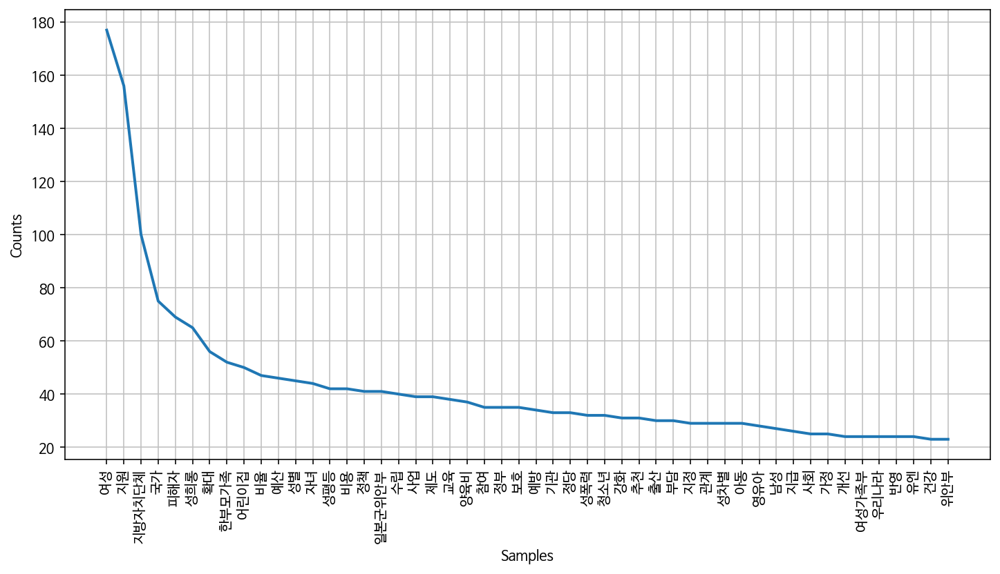

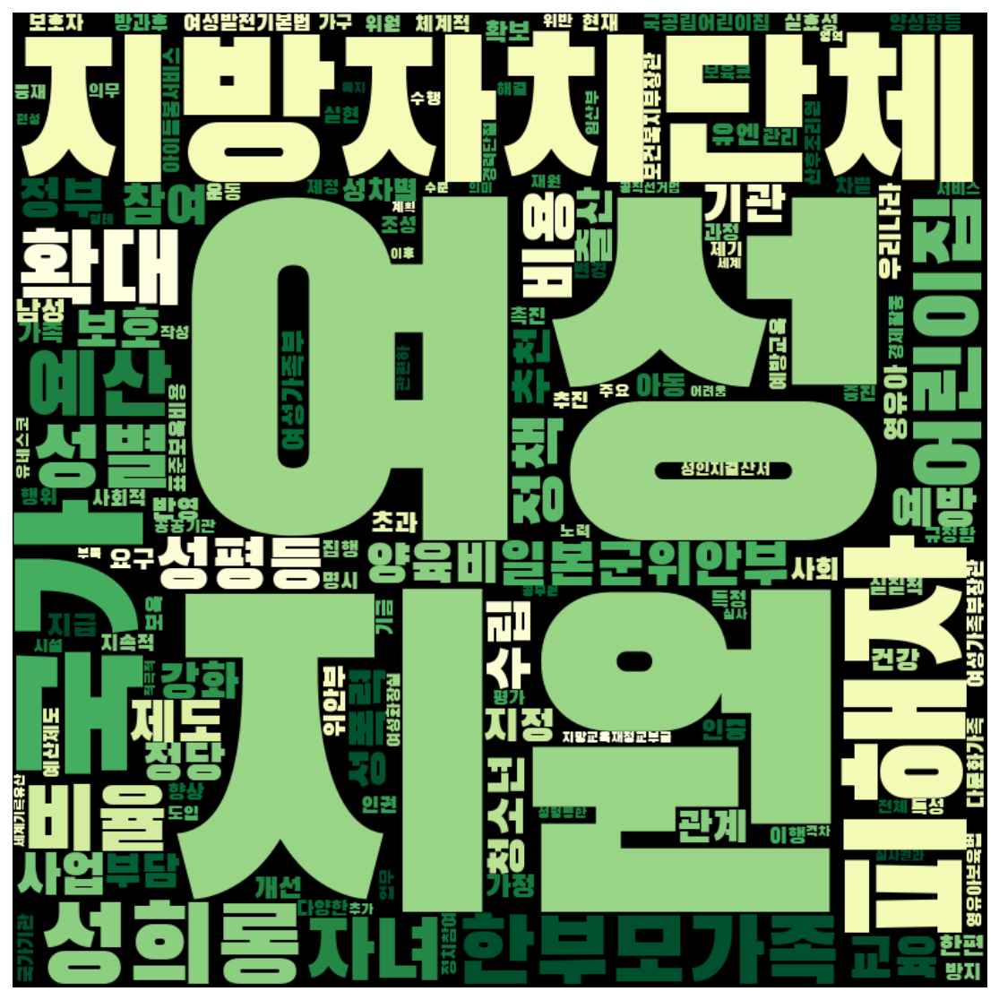

In [101]:
frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens,'YlGn')

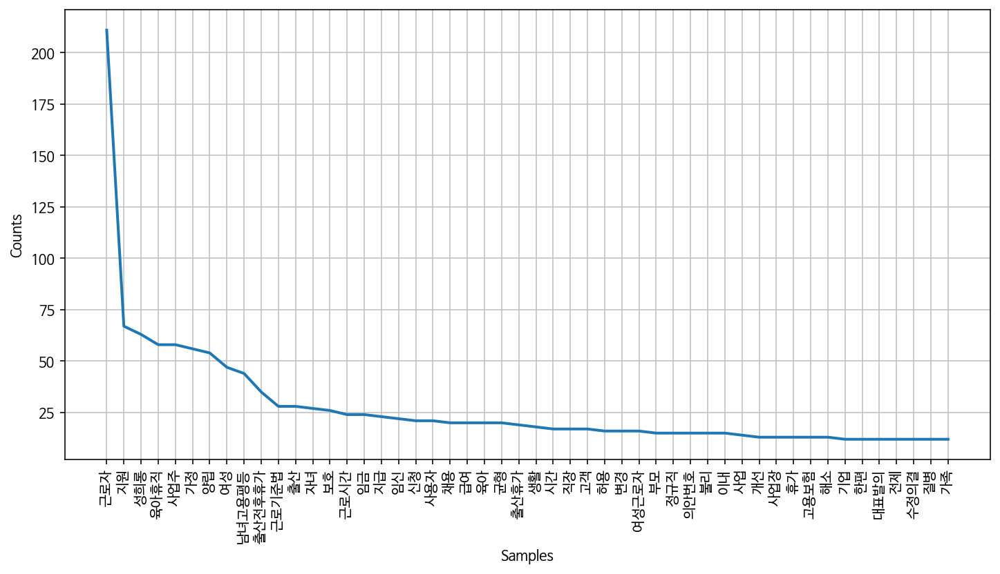

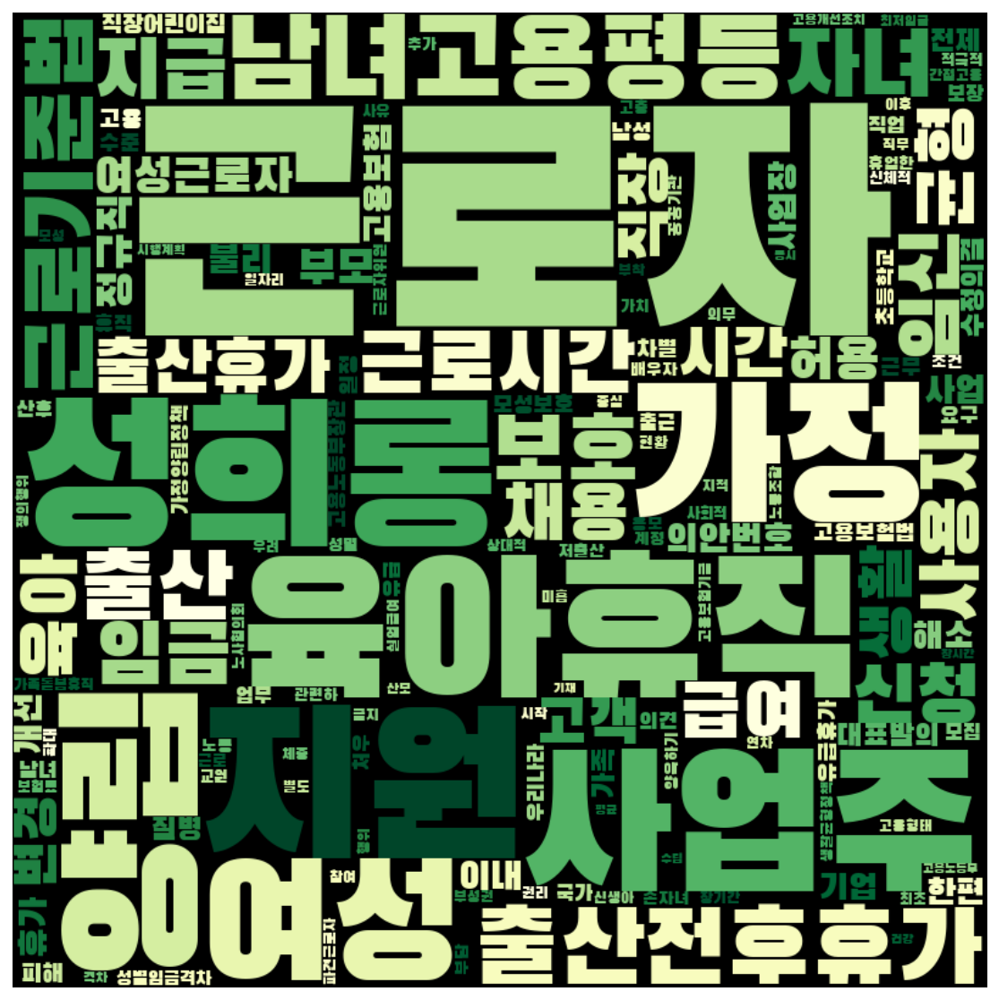

In [102]:
frewords_vis(pro_women_g3_tokens)
wordcloud_vis(pro_women_g3_tokens,'YlGn')

In [103]:
pro_men = pro_men[pro_men['명사수'] > 1]

# K means 수행 
word_vectors_pro_men = pro_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_men)
pro_men['category'] = idx

print(pro_men['category'].value_counts())

pro_men_g1 = pro_men[pro_men['category'] == 0]
pro_men_g2 = pro_men[pro_men['category'] == 1]
pro_men_g3 = pro_men[pro_men['category'] == 2]

pro_men_g1_tokens = total_tokens(pro_men_g1['tokens'])
pro_men_g2_tokens = total_tokens(pro_men_g2['tokens'])
pro_men_g3_tokens = total_tokens(pro_men_g3['tokens'])


stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_men_g1_tokens = [each_word for each_word in pro_men_g1_tokens if each_word not in stopwords]
pro_men_g2_tokens = [each_word for each_word in pro_men_g2_tokens if each_word not in stopwords]
pro_men_g3_tokens = [each_word for each_word in pro_men_g3_tokens if each_word not in stopwords]

2    237
0     90
1     64
Name: category, dtype: int64


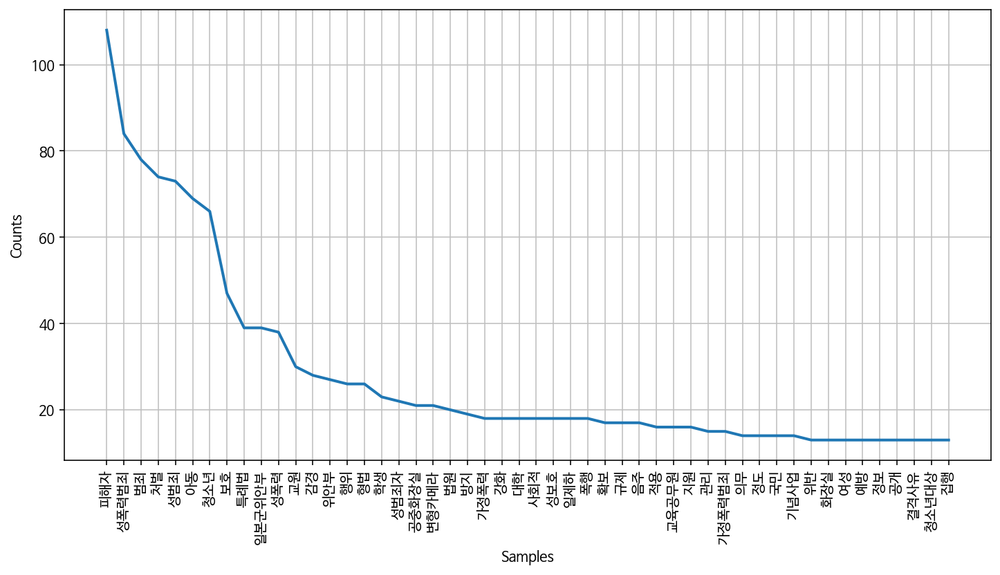

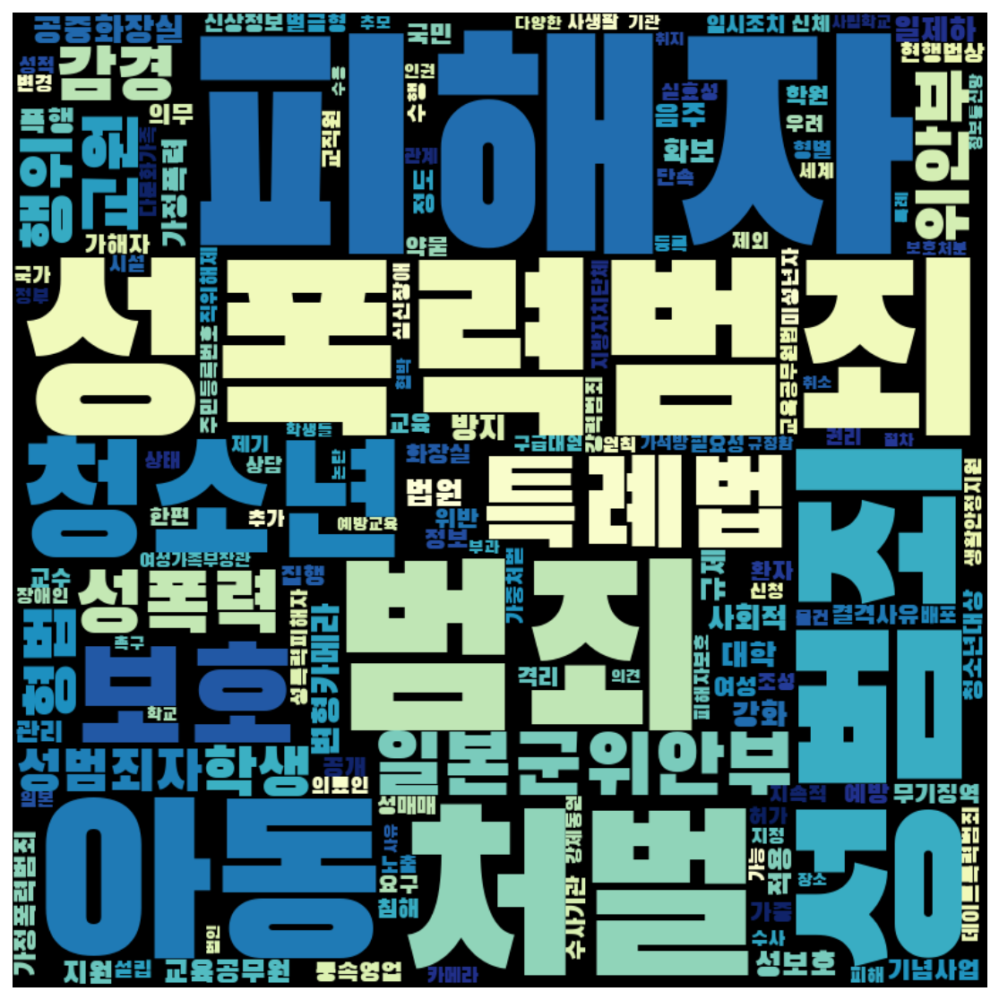

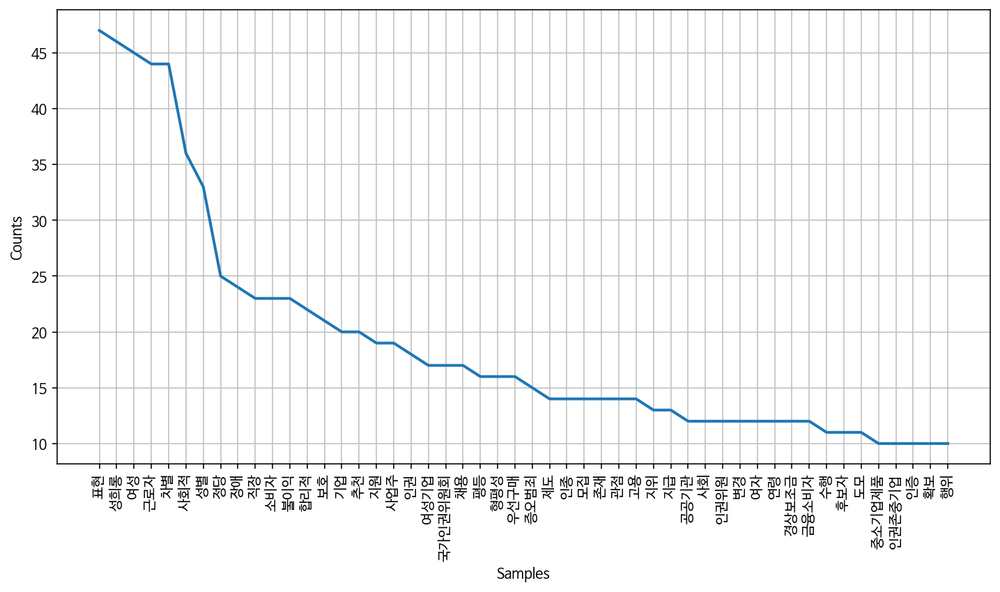

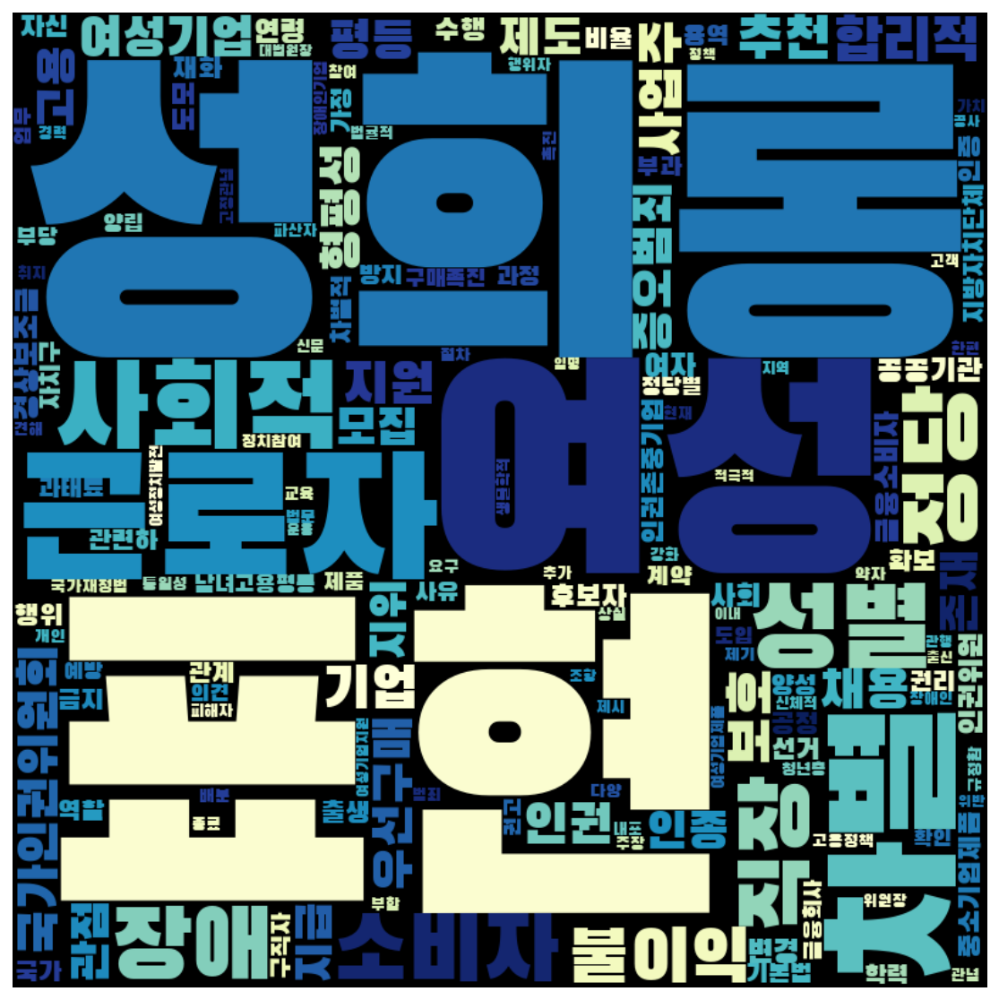

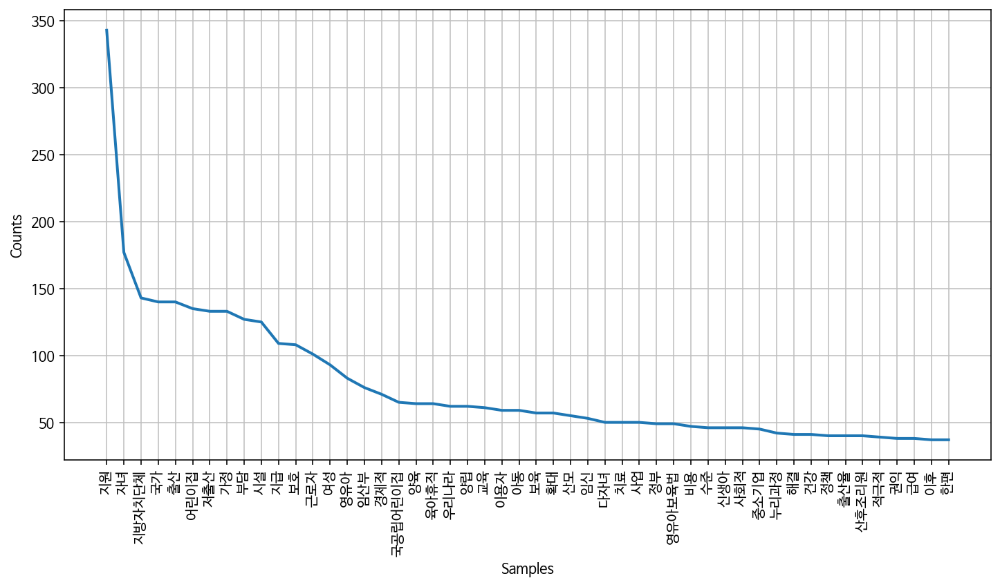

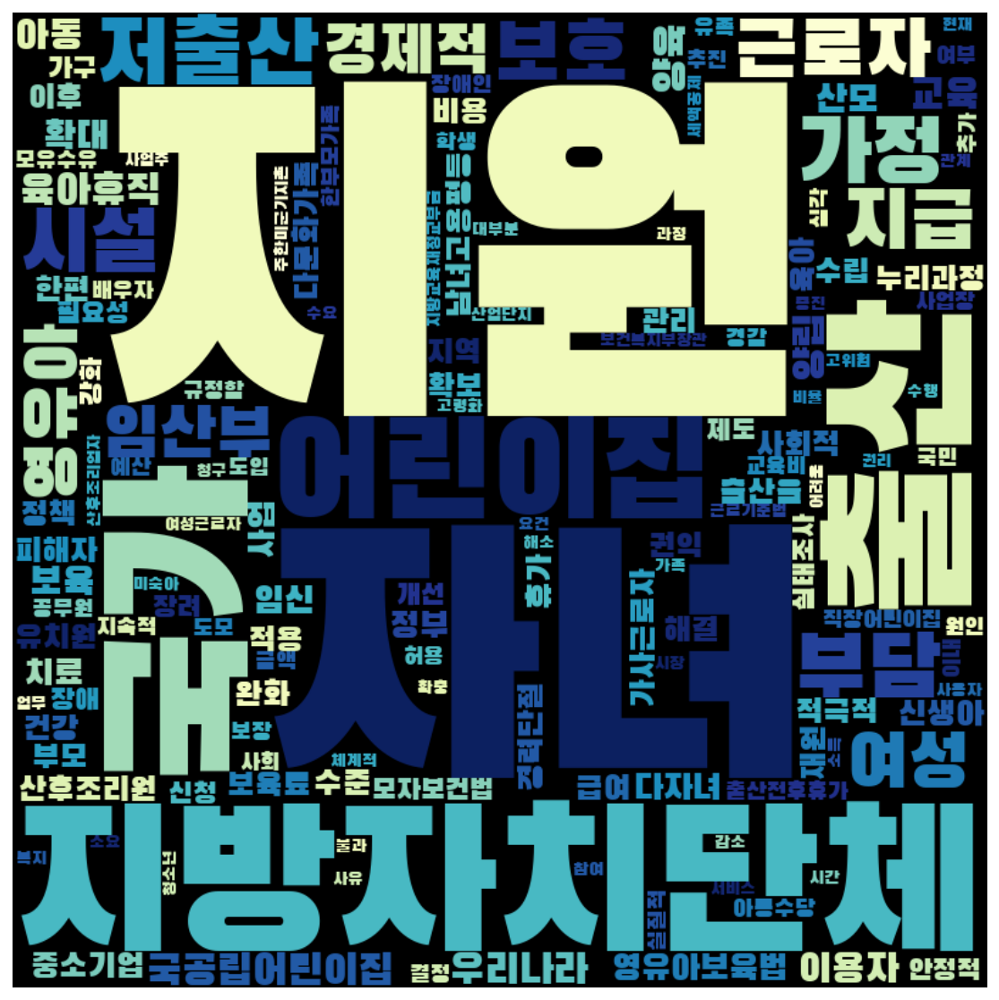

In [104]:
frewords_vis(pro_men_g1_tokens)
wordcloud_vis(pro_men_g1_tokens, 'YlGnBu')

frewords_vis(pro_men_g2_tokens)
wordcloud_vis(pro_men_g2_tokens, 'YlGnBu')

frewords_vis(pro_men_g3_tokens)
wordcloud_vis(pro_men_g3_tokens, 'YlGnBu')

In [105]:
con_women = con_women[con_women['명사수'] > 1]

# K means 수행 
word_vectors_con_women = con_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_women)
con_women['category'] = idx

print(con_women['category'].value_counts())

con_women_g1 = con_women[con_women['category'] == 0]
con_women_g2 = con_women[con_women['category'] == 1]
con_women_g3 = con_women[con_women['category'] == 2]

con_women_g1_tokens = total_tokens(con_women_g1['tokens'])
con_women_g2_tokens = total_tokens(con_women_g2['tokens'])
con_women_g3_tokens = total_tokens(con_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_women_g1_tokens = [each_word for each_word in con_women_g1_tokens if each_word not in stopwords]
con_women_g2_tokens = [each_word for each_word in con_women_g2_tokens if each_word not in stopwords]
con_women_g3_tokens = [each_word for each_word in con_women_g3_tokens if each_word not in stopwords]

2    111
0     33
1     24
Name: category, dtype: int64


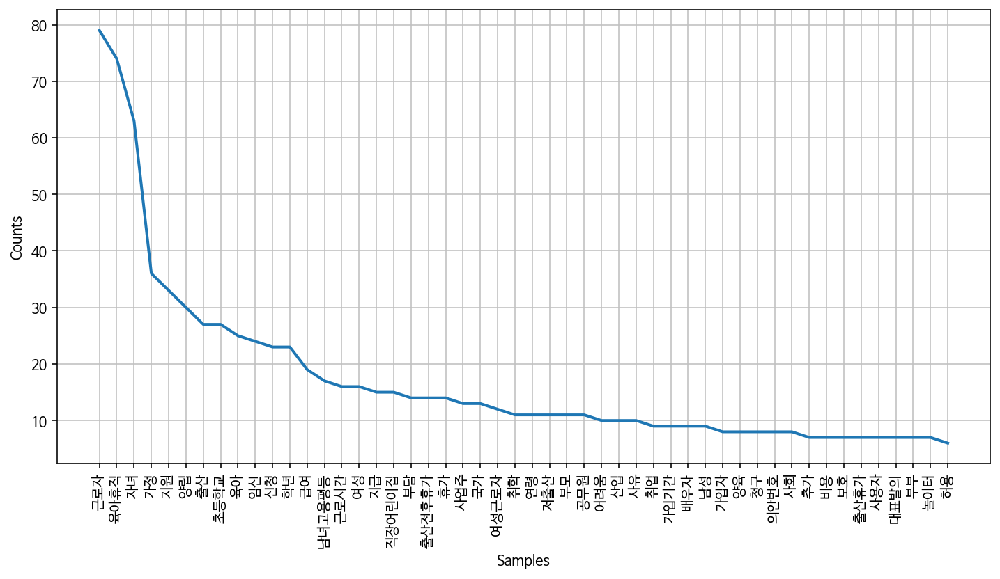

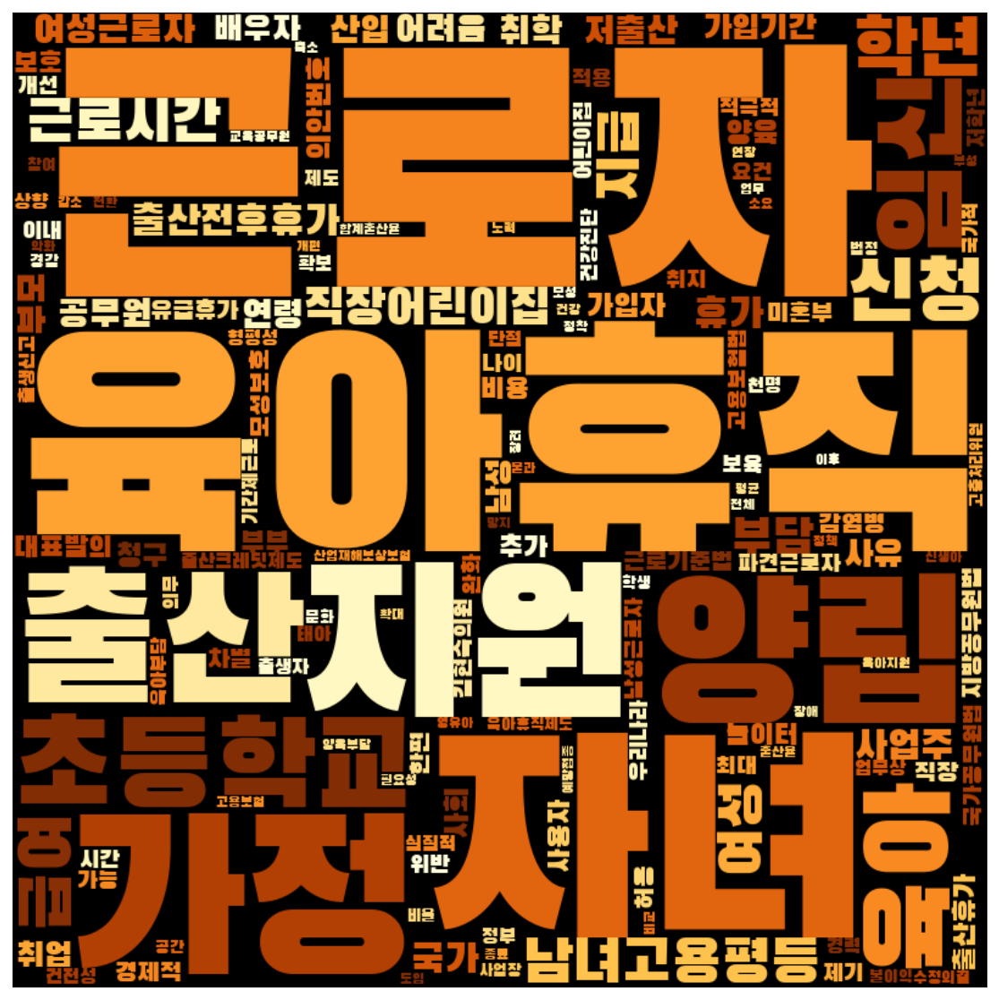

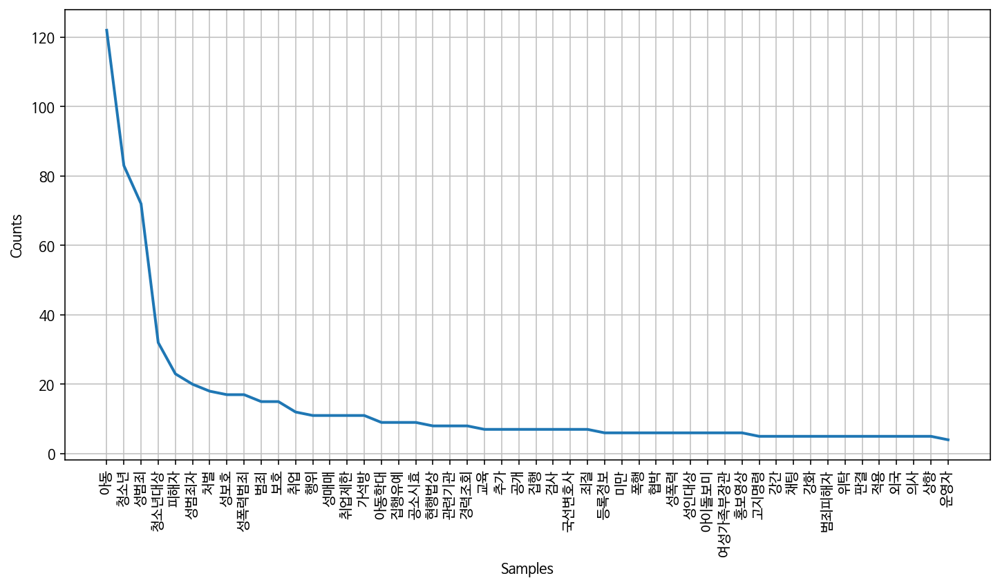

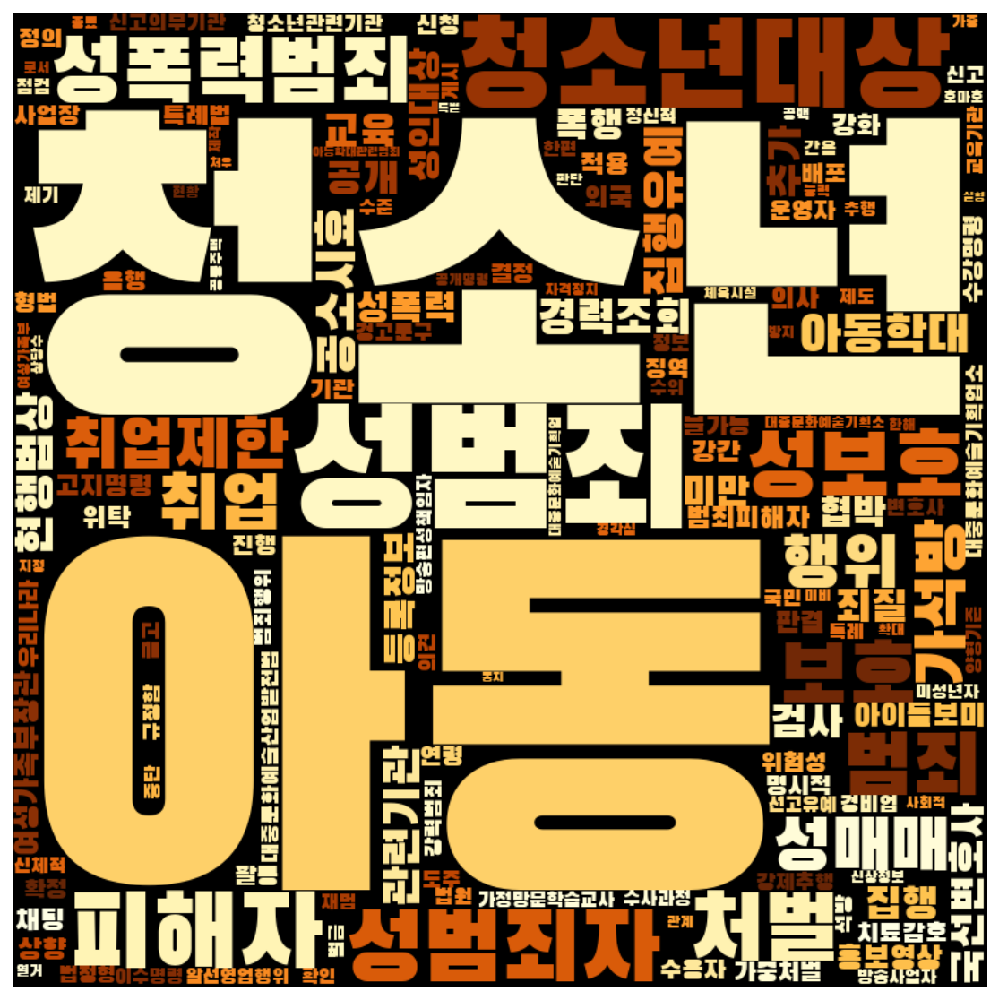

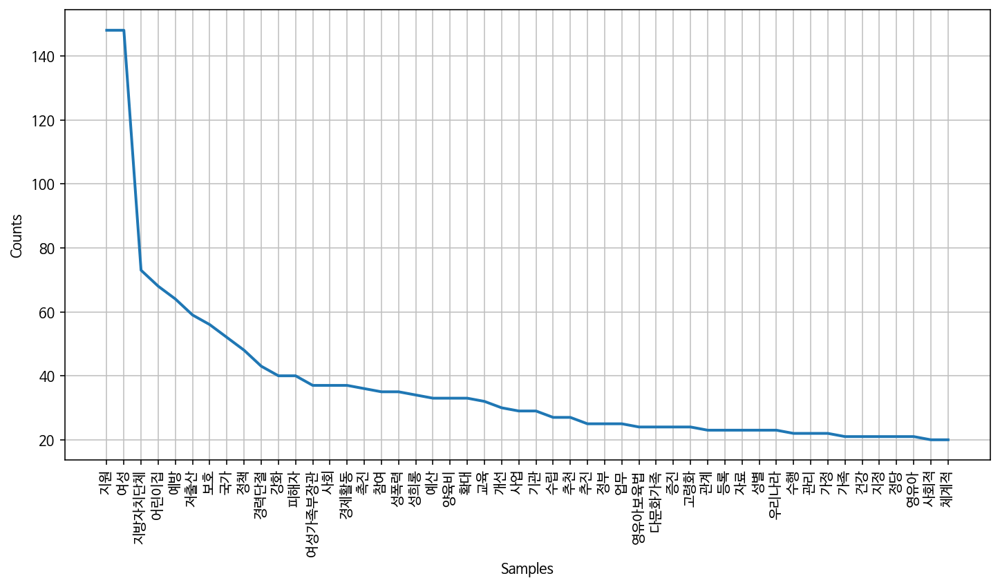

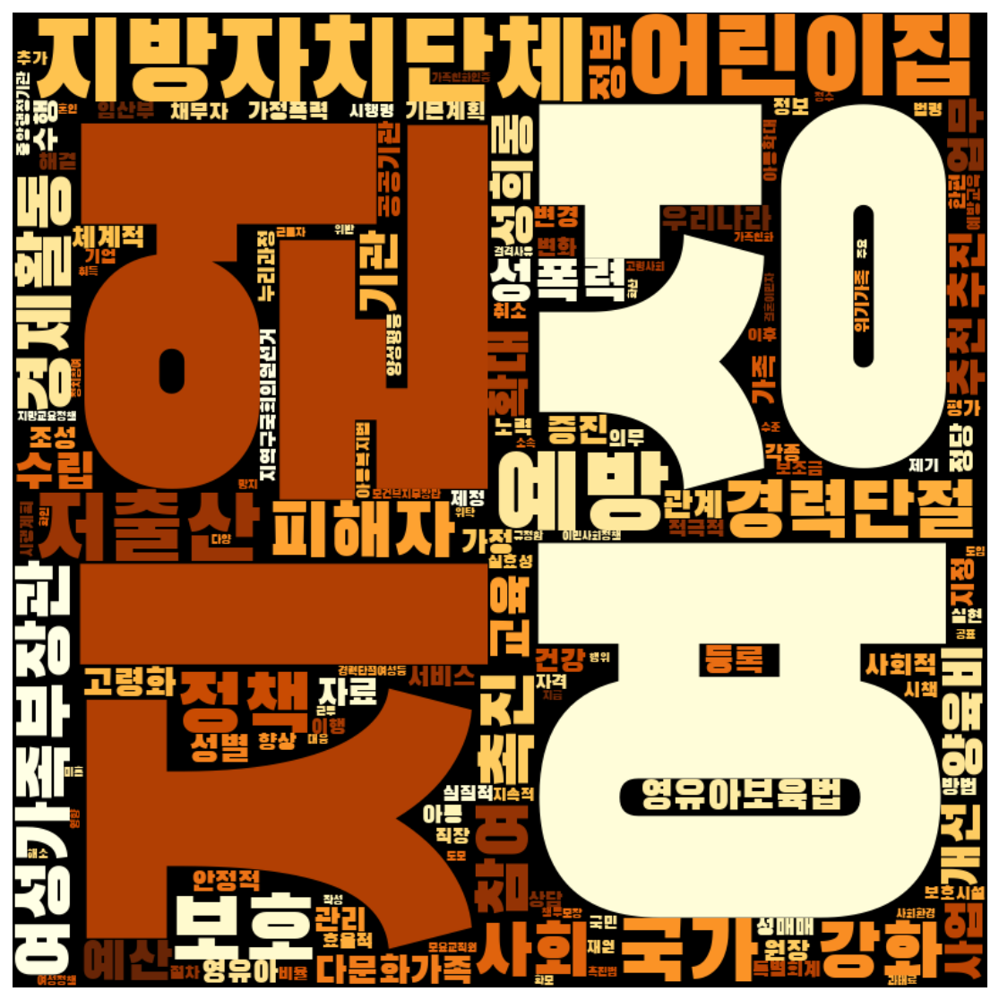

In [106]:
frewords_vis(con_women_g1_tokens)
wordcloud_vis(con_women_g1_tokens, 'YlOrBr')

frewords_vis(con_women_g2_tokens)
wordcloud_vis(con_women_g2_tokens, 'YlOrBr')

frewords_vis(con_women_g3_tokens)
wordcloud_vis(con_women_g3_tokens, 'YlOrBr')

In [107]:
con_men = con_men[con_men['명사수'] > 1]

# K means 수행 
word_vectors_con_men = con_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_men)
con_men['category'] = idx

print(con_men['category'].value_counts())

con_men_g1 = con_men[con_men['category'] == 0]
con_men_g2 = con_men[con_men['category'] == 1]
con_men_g3 = con_men[con_men['category'] == 2]

con_men_g1_tokens = total_tokens(con_men_g1['tokens'])
con_men_g2_tokens = total_tokens(con_men_g2['tokens'])
con_men_g3_tokens = total_tokens(con_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_men_g1_tokens = [each_word for each_word in con_men_g1_tokens if each_word not in stopwords]
con_men_g2_tokens = [each_word for each_word in con_men_g2_tokens if each_word not in stopwords]
con_men_g3_tokens = [each_word for each_word in con_men_g3_tokens if each_word not in stopwords]

0    96
1    65
2     9
Name: category, dtype: int64


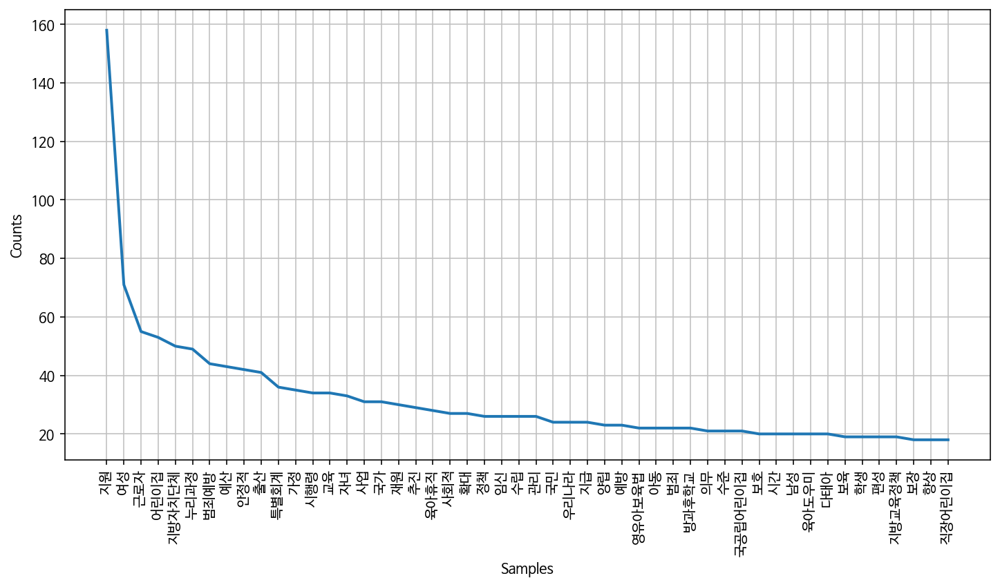

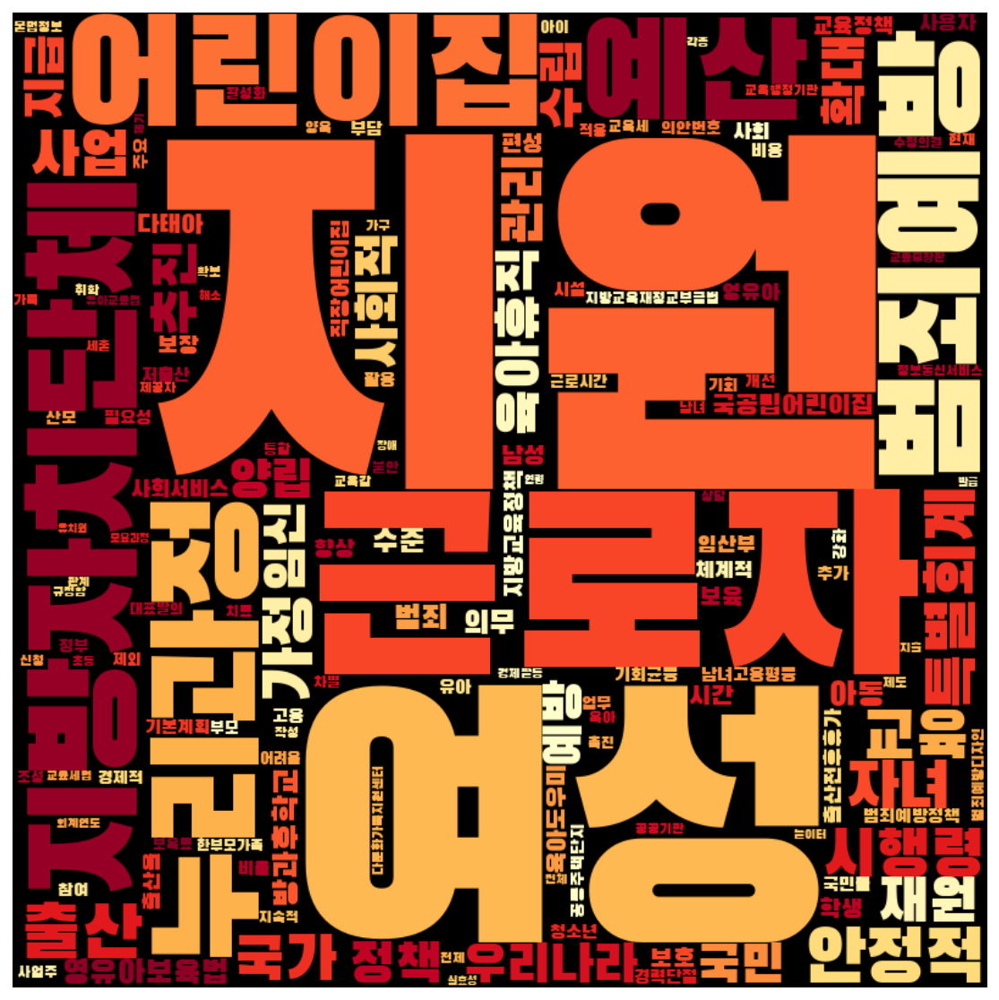

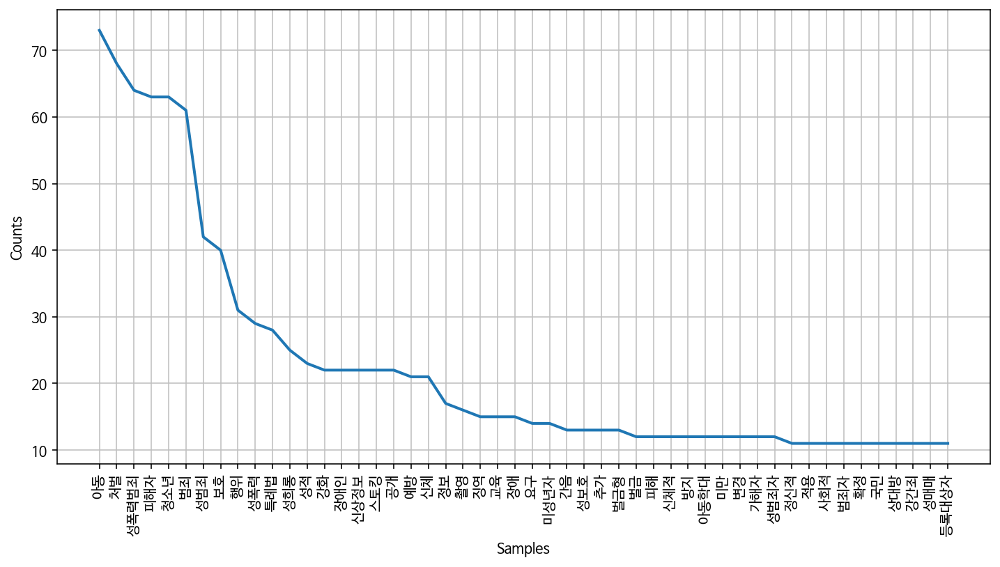

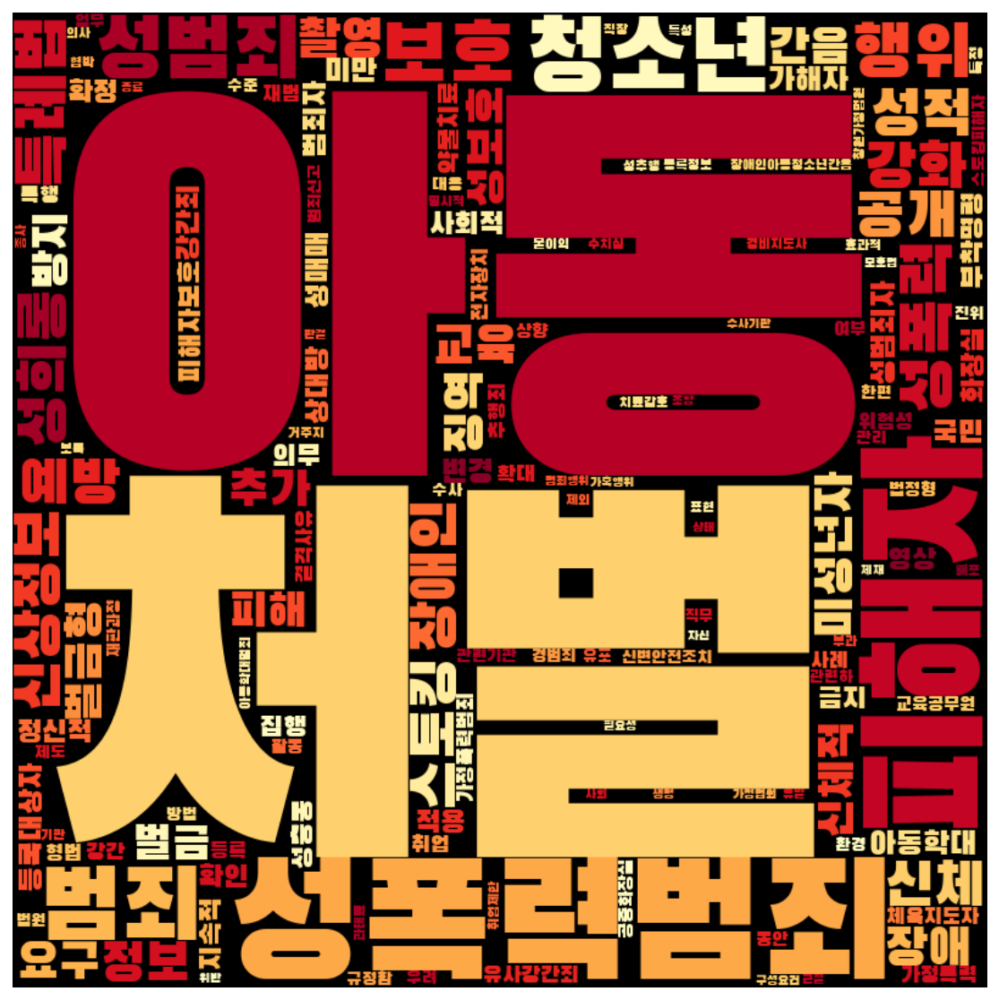

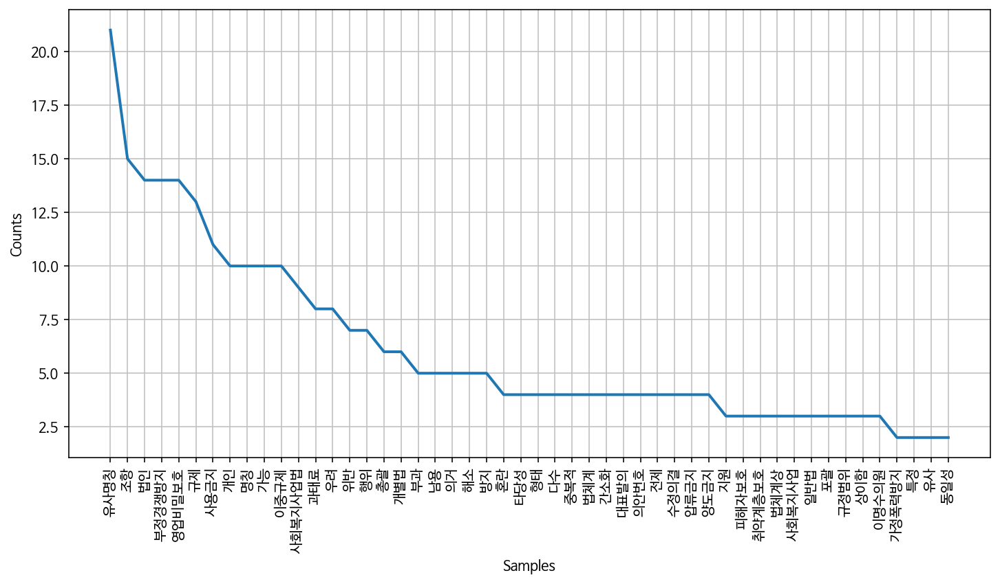

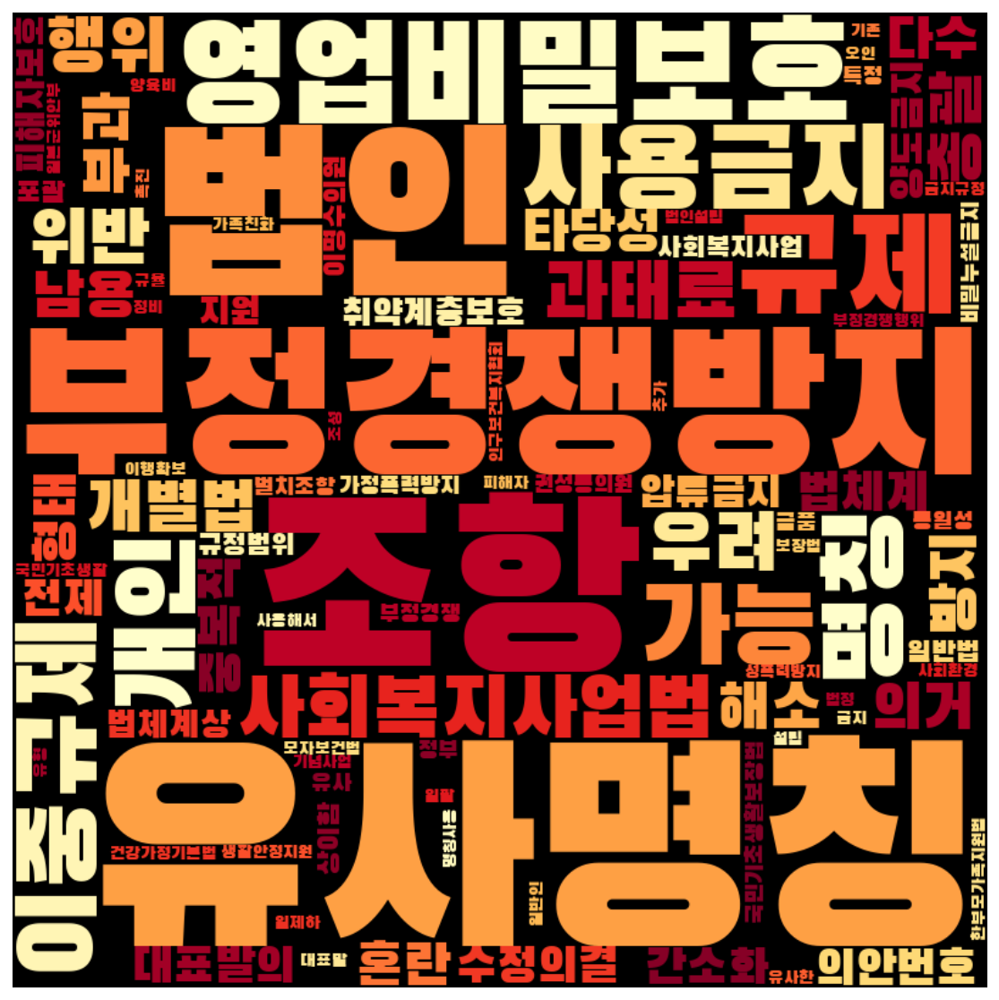

In [108]:
frewords_vis(con_men_g1_tokens)
wordcloud_vis(con_men_g1_tokens, 'YlOrRd')

frewords_vis(con_men_g2_tokens)
wordcloud_vis(con_men_g2_tokens, 'YlOrRd')

frewords_vis(con_men_g3_tokens)
wordcloud_vis(con_men_g3_tokens, 'YlOrRd')

## 문재인 정권 
- 2017.05.10 ~

In [55]:
moonjaein = gender[(gender['제안일자'] > datetime.date(2017,5,10))]
moonjaein.shape

(1636, 19)

In [56]:
moonjaein['성별'].value_counts()

남성    978
여성    534
Name: 성별, dtype: int64

In [57]:
pd.DataFrame(moonjaein.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  234
     여성  184
진보   남성  728
     여성  349

In [58]:
pro_women = moonjaein[(moonjaein['성별'] == '여성') & (moonjaein['정당성향'] == '진보')]
pro_men = moonjaein[(moonjaein['성별'] == '남성') & (moonjaein['정당성향'] == '진보')]
con_women = moonjaein[(moonjaein['성별'] == '여성') & (moonjaein['정당성향'] == '보수')]
con_men = moonjaein[(moonjaein['성별'] == '남성') & (moonjaein['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장',
            '현상','인사상']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

In [76]:
ko_pro_women = nltk.Text(pro_women_word, name='진보 여성')
ko_pro_men = nltk.Text(pro_men_word, name='진보 남성')
ko_con_women = nltk.Text(con_women_word, name='보수 여성')
ko_con_men = nltk.Text(con_men_word, name='보수 남성')

print('부녀 단어 수:', ko_pro_women.count('부녀'))
print('여자 단어 수:', ko_pro_women.count('여자'))
print('여성 단어 수:', ko_pro_women.count('여성'))
print('젠더 단어 수:', ko_pro_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_women.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_women.count('양성평등'))
print('성평등 단어 수:', ko_pro_women.count('성평등'))
print('성인지적 단어 수:', ko_pro_women.count('성인지적'))
print('성주류화 단어 수:', ko_pro_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_women.count('청소년'))
print('아동 단어 수:', ko_pro_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_pro_men.count('부녀'))
print('여자 단어 수:', ko_pro_men.count('여자'))
print('여성 단어 수:', ko_pro_men.count('여성'))
print('젠더 단어 수:', ko_pro_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_pro_men.count('남녀평등'))
print('양성평등 단어 수:', ko_pro_men.count('양성평등'))
print('성평등 단어 수:', ko_pro_men.count('성평등'))
print('성인지적 단어 수:', ko_pro_men.count('성인지적'))
print('성주류화 단어 수:', ko_pro_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_pro_men.count('청소년'))
print('아동 단어 수:', ko_pro_men.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_women.count('부녀'))
print('여자 단어 수:', ko_con_women.count('여자'))
print('여성 단어 수:', ko_con_women.count('여성'))
print('젠더 단어 수:', ko_con_women.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_women.count('남녀평등'))
print('양성평등 단어 수:', ko_con_women.count('양성평등'))
print('성평등 단어 수:', ko_con_women.count('성평등'))
print('성인지적 단어 수:', ko_con_women.count('성인지적'))
print('성주류화 단어 수:', ko_con_women.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_women.count('청소년'))
print('아동 단어 수:', ko_con_women.count('아동'))

print('###################')

print('부녀 단어 수:', ko_con_men.count('부녀'))
print('여자 단어 수:', ko_con_men.count('여자'))
print('여성 단어 수:', ko_con_men.count('여성'))
print('젠더 단어 수:', ko_con_men.count('젠더'))
print()

print('남녀평등 단어 수:', ko_con_men.count('남녀평등'))
print('양성평등 단어 수:', ko_con_men.count('양성평등'))
print('성평등 단어 수:', ko_con_men.count('성평등'))
print('성인지적 단어 수:', ko_con_men.count('성인지적'))
print('성주류화 단어 수:', ko_con_men.count('성주류화'))
print()

print('청소년 단어 수:', ko_con_men.count('청소년'))
print('아동 단어 수:', ko_con_men.count('아동'))

부녀 단어 수: 3
여자 단어 수: 2
여성 단어 수: 173
젠더 단어 수: 4

남녀평등 단어 수: 1
양성평등 단어 수: 16
성평등 단어 수: 24
성인지적 단어 수: 3
성주류화 단어 수: 2

청소년 단어 수: 132
아동 단어 수: 245
###################
부녀 단어 수: 9
여자 단어 수: 17
여성 단어 수: 2348
젠더 단어 수: 0

남녀평등 단어 수: 1
양성평등 단어 수: 29
성평등 단어 수: 8
성인지적 단어 수: 4
성주류화 단어 수: 0

청소년 단어 수: 146
아동 단어 수: 189
###################
부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 140
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 20
성평등 단어 수: 3
성인지적 단어 수: 1
성주류화 단어 수: 0

청소년 단어 수: 49
아동 단어 수: 61
###################
부녀 단어 수: 0
여자 단어 수: 0
여성 단어 수: 67
젠더 단어 수: 0

남녀평등 단어 수: 0
양성평등 단어 수: 7
성평등 단어 수: 3
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 74
아동 단어 수: 74


In [77]:
# 호주제
print('호주제 단어 수:', ko_pro_women.count('호주제'))
print('가족법 단어 수:', ko_pro_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_women.count('저출산'))
print('육아휴직 단어 수:', ko_pro_women.count('육아휴직'))
print('보육 단어 수:', ko_pro_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_women.count('성범죄'))
print('강간 단어 수:', ko_pro_women.count('강간'))
print('성희롱 단어 수:', ko_pro_women.count('성희롱'))
print('성폭력 단어 수:', ko_pro_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_women.count('윤락'))
print('윤락행위 단어 수:', ko_pro_women.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_women.count('기생관광'))
print('성매매 단어 수:', ko_pro_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_women.count('낙태'))
print('임신중절 단어 수:', ko_pro_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_women.count('불법촬영'))
print('몰카 단어 수:', ko_pro_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_pro_men.count('호주제'))
print('가족법 단어 수:', ko_pro_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_pro_men.count('저출산'))
print('육아휴직 단어 수:', ko_pro_men.count('육아휴직'))
print('보육 단어 수:', ko_pro_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_pro_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_pro_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_pro_men.count('성범죄'))
print('강간 단어 수:', ko_pro_men.count('강간'))
print('성희롱 단어 수:', ko_pro_men.count('성희롱'))
print('성폭력 단어 수:', ko_pro_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_pro_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_pro_men.count('윤락'))
print('윤락행위 단어 수:', ko_pro_men.count('윤락행위'))
print('기생관광 단어 수:', ko_pro_men.count('기생관광'))
print('성매매 단어 수:', ko_pro_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_pro_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_pro_men.count('낙태'))
print('임신중절 단어 수:', ko_pro_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_pro_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_pro_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_pro_men.count('불법촬영'))
print('몰카 단어 수:', ko_pro_men.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_women.count('호주제'))
print('가족법 단어 수:', ko_con_women.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_women.count('저출산'))
print('육아휴직 단어 수:', ko_con_women.count('육아휴직'))
print('보육 단어 수:', ko_con_women.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_women.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_women.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_women.count('성범죄'))
print('강간 단어 수:', ko_con_women.count('강간'))
print('성희롱 단어 수:', ko_con_women.count('성희롱'))
print('성폭력 단어 수:', ko_con_women.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_women.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_women.count('윤락'))
print('윤락행위 단어 수:', ko_con_women.count('윤락행위'))
print('기생관광 단어 수:', ko_con_women.count('기생관광'))
print('성매매 단어 수:', ko_con_women.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_women.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_women.count('낙태'))
print('임신중절 단어 수:', ko_con_women.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_women.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_women.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_women.count('불법촬영'))
print('몰카 단어 수:', ko_con_women.count('몰카'))

print('###################')

# 호주제
print('호주제 단어 수:', ko_con_men.count('호주제'))
print('가족법 단어 수:', ko_con_men.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko_con_men.count('저출산'))
print('육아휴직 단어 수:', ko_con_men.count('육아휴직'))
print('보육 단어 수:', ko_con_men.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko_con_men.count('위안부'))
print('일본군성노예제 단어 수:', ko_con_men.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko_con_men.count('성범죄'))
print('강간 단어 수:', ko_con_men.count('강간'))
print('성희롱 단어 수:', ko_con_men.count('성희롱'))
print('성폭력 단어 수:', ko_con_men.count('성폭력'))
print('성폭력범죄 단어 수:', ko_con_men.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko_con_men.count('윤락'))
print('윤락행위 단어 수:', ko_con_men.count('윤락행위'))
print('기생관광 단어 수:', ko_con_men.count('기생관광'))
print('성매매 단어 수:', ko_con_men.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko_con_men.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko_con_men.count('낙태'))
print('임신중절 단어 수:', ko_con_men.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko_con_men.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko_con_men.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko_con_men.count('불법촬영'))
print('몰카 단어 수:', ko_con_men.count('몰카'))

호주제 단어 수: 1
가족법 단어 수: 0

저출산 단어 수: 21
육아휴직 단어 수: 38
보육 단어 수: 10

위안부 단어 수: 18
일본군성노예제 단어 수: 22

성범죄 단어 수: 188
강간 단어 수: 15
성희롱 단어 수: 244
성폭력 단어 수: 183
성폭력범죄 단어 수: 134

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 69

가정폭력 단어 수: 47

낙태 단어 수: 9
임신중절 단어 수: 2

스토킹 단어 수: 20

미투 단어 수: 24

불법촬영 단어 수: 3
몰카 단어 수: 0
###################
호주제 단어 수: 2
가족법 단어 수: 0

저출산 단어 수: 88
육아휴직 단어 수: 77
보육 단어 수: 18

위안부 단어 수: 3
일본군성노예제 단어 수: 17

성범죄 단어 수: 225
강간 단어 수: 35
성희롱 단어 수: 174
성폭력 단어 수: 137
성폭력범죄 단어 수: 194

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 19

가정폭력 단어 수: 38

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 24

미투 단어 수: 16

불법촬영 단어 수: 3
몰카 단어 수: 2
###################
호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 21
육아휴직 단어 수: 49
보육 단어 수: 9

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 66
강간 단어 수: 20
성희롱 단어 수: 64
성폭력 단어 수: 94
성폭력범죄 단어 수: 70

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 1

가정폭력 단어 수: 30

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 13

불법촬영 단어 수: 1
몰카 단어 수: 0
###################
호주제 단어 수: 0
가족법 단어 수: 0

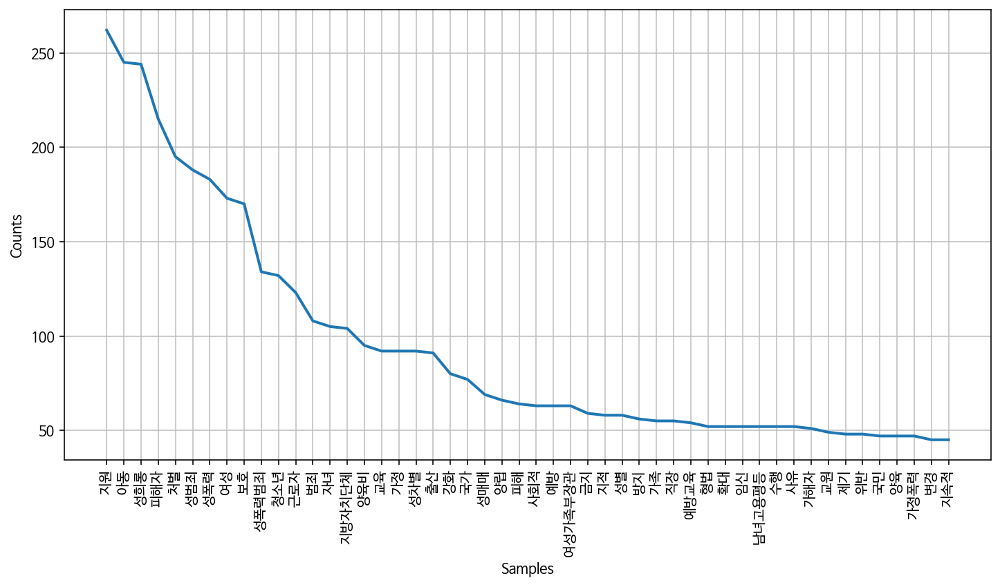

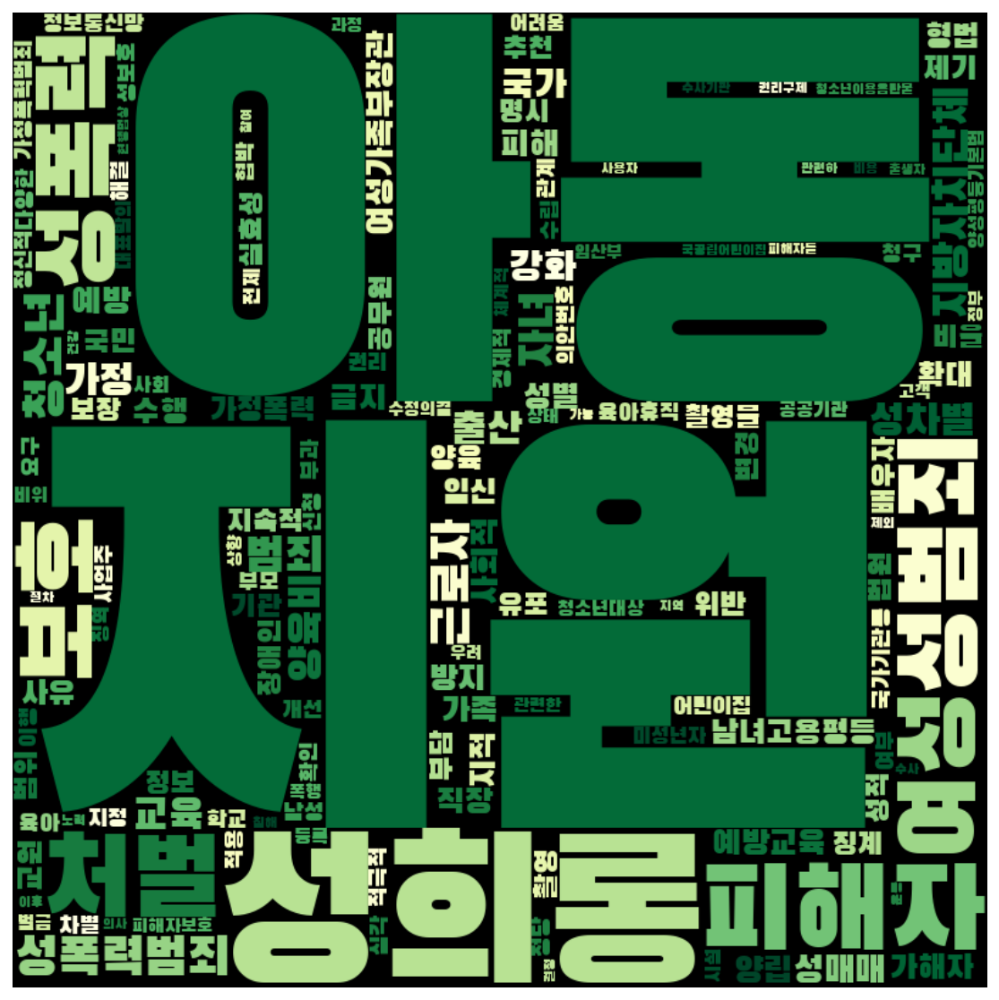

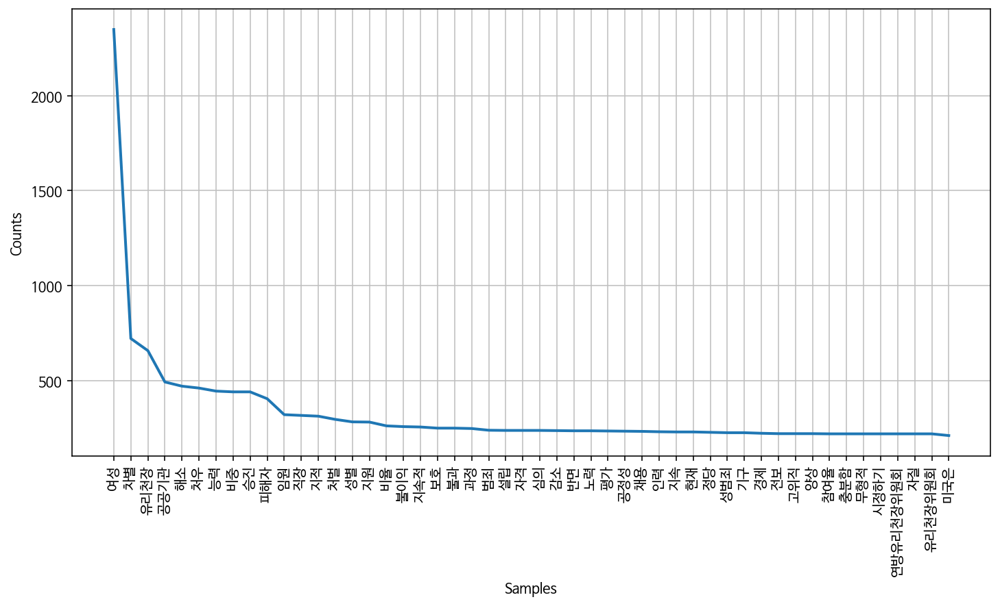

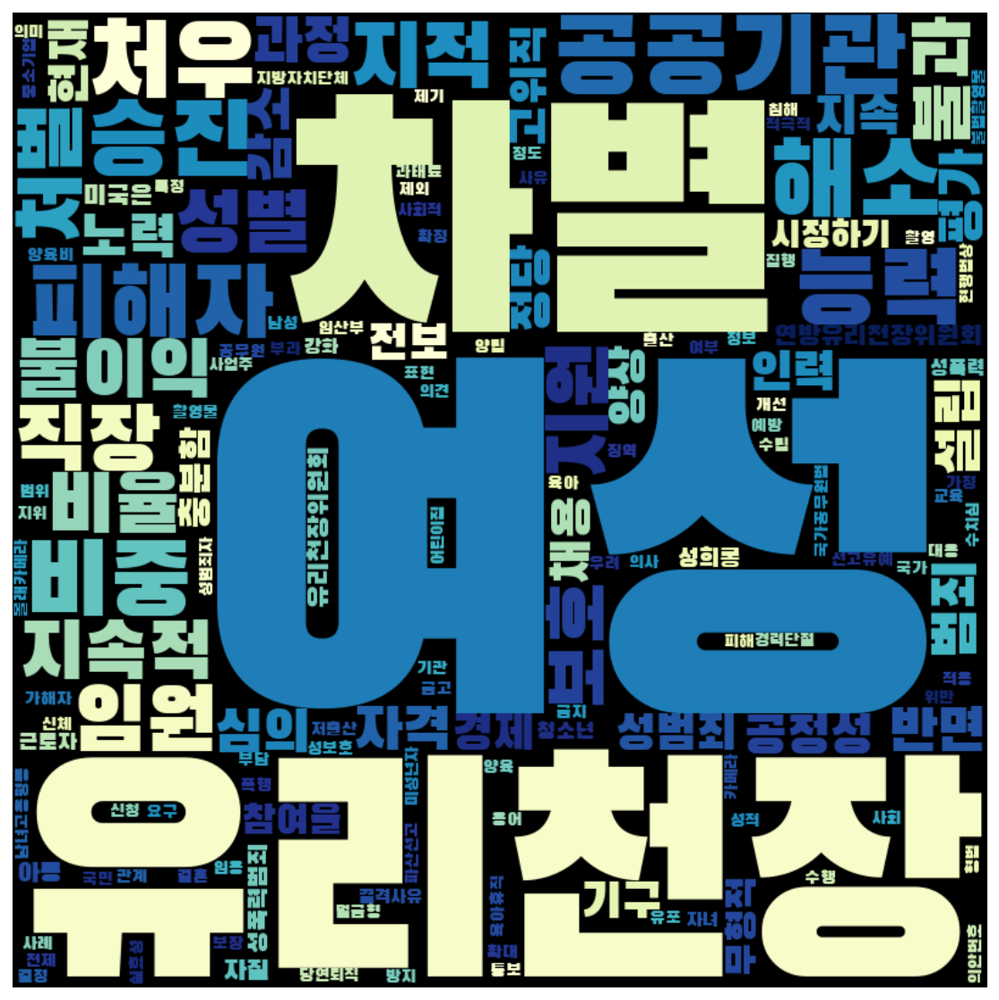

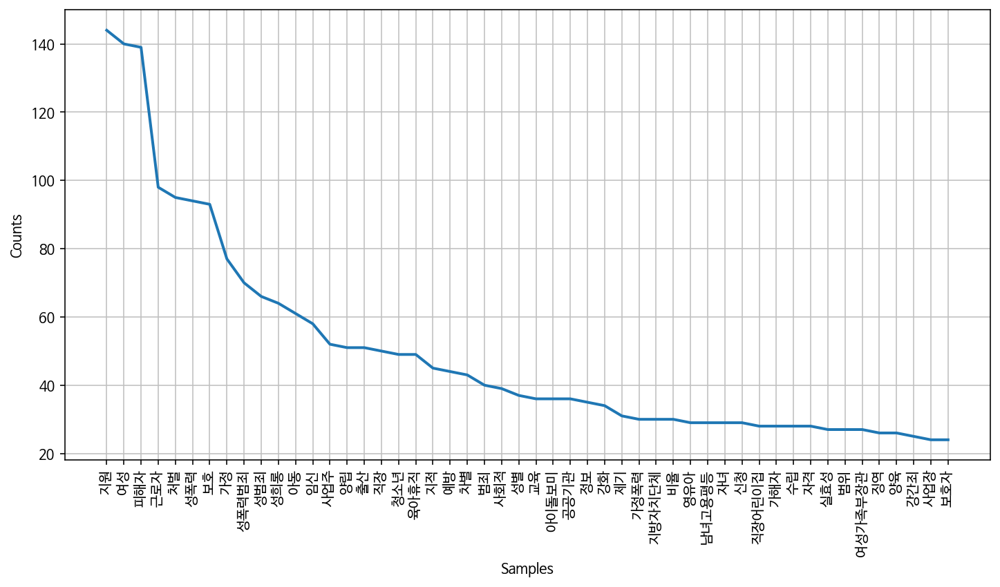

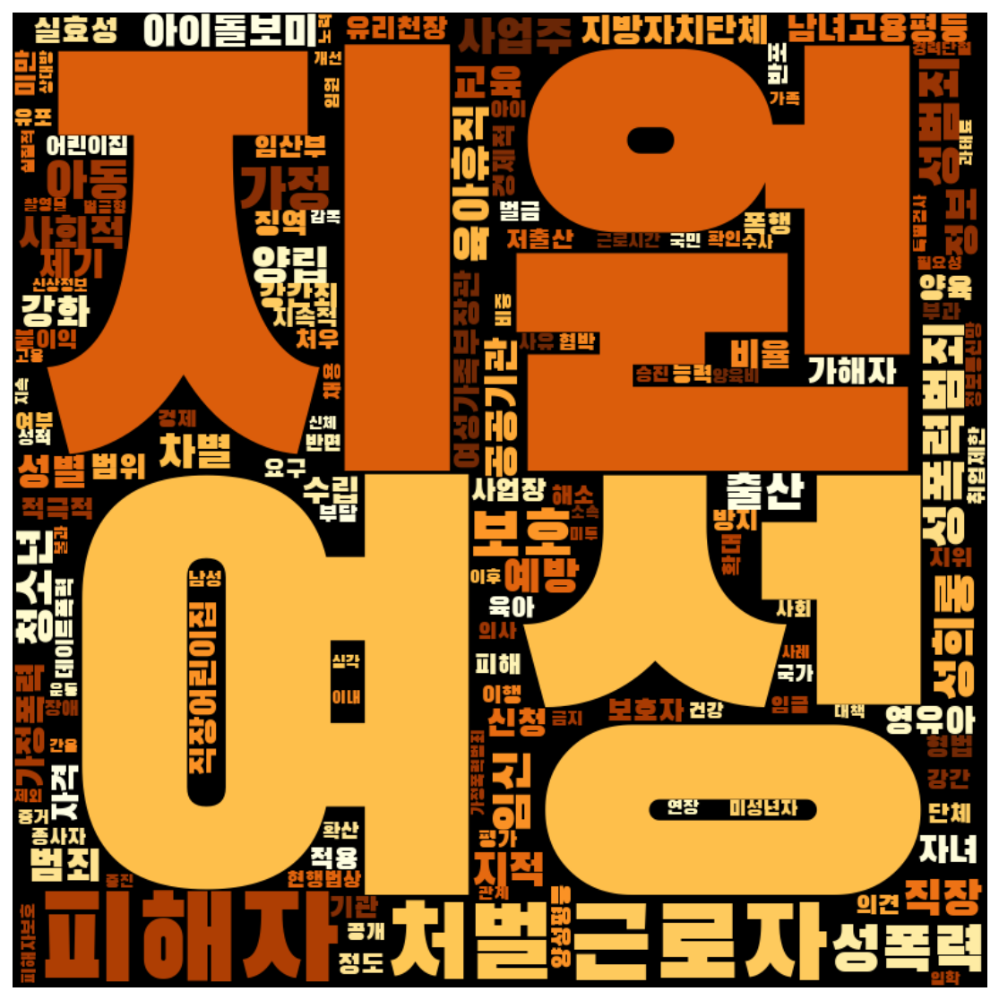

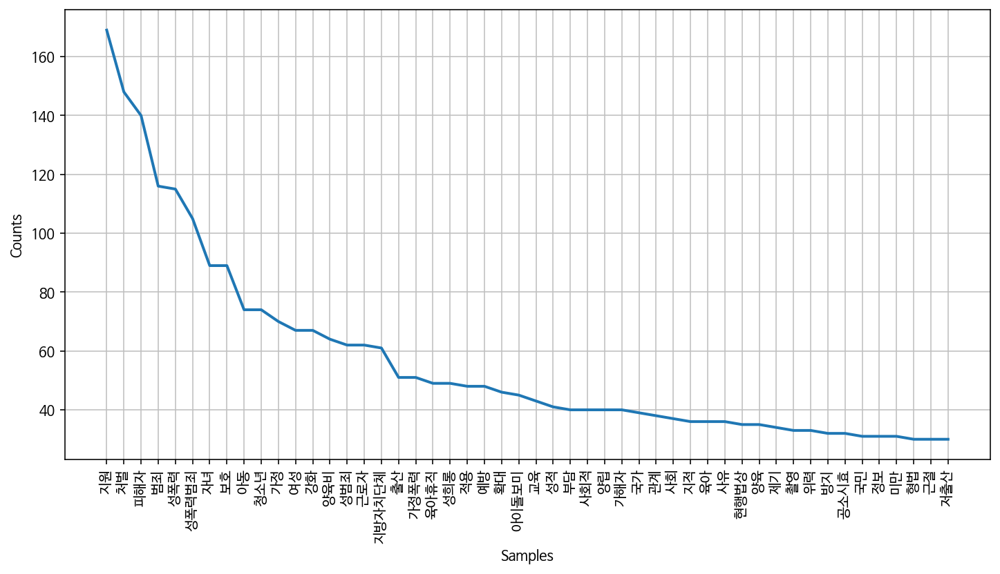

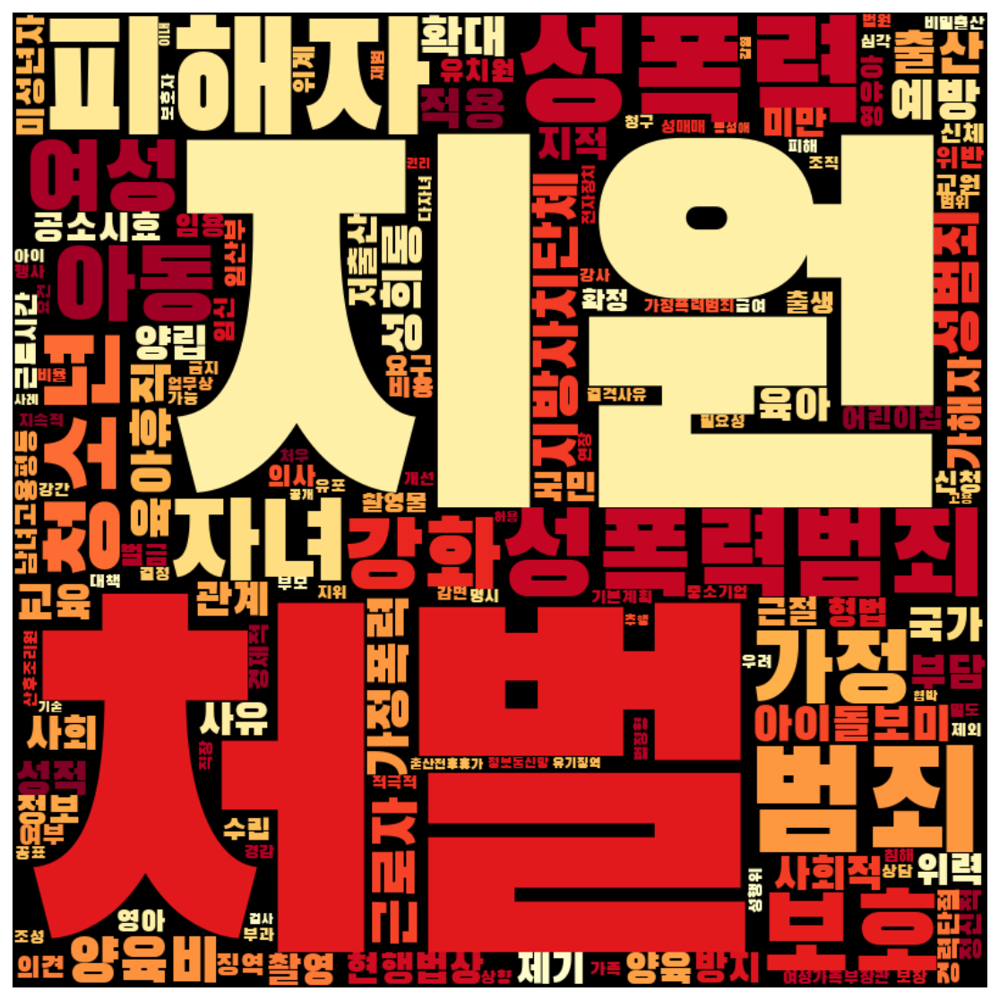

In [59]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [115]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-24 14:20:12,806 : INFO : collecting all words and their counts
2020-10-24 14:20:12,808 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-24 14:20:12,815 : INFO : collected 4731 word types from a corpus of 24077 raw words and 349 sentences
2020-10-24 14:20:12,816 : INFO : Loading a fresh vocabulary
2020-10-24 14:20:12,820 : INFO : effective_min_count=10 retains 496 unique words (10% of original 4731, drops 4235)
2020-10-24 14:20:12,821 : INFO : effective_min_count=10 leaves 14309 word corpus (59% of original 24077, drops 9768)
2020-10-24 14:20:12,825 : INFO : deleting the raw counts dictionary of 4731 items
2020-10-24 14:20:12,828 : INFO : sample=0.001 downsamples 90 most-common words
2020-10-24 14:20:12,829 : INFO : downsampling leaves estimated 11432 word corpus (79.9% of prior 14309)
2020-10-24 14:20:12,831 : INFO : estimated required memory for 496 words and 100 dimensions: 644800 bytes
2020-10-24 14:20:12,832 : INFO : resetting layer weights

2020-10-24 14:20:13,831 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:13,839 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:13,853 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:13,853 : INFO : EPOCH - 15 : training on 24077 raw words (11438 effective words) took 0.1s, 211825 effective words/s
2020-10-24 14:20:13,859 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:13,892 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:13,899 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:13,912 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:13,913 : INFO : EPOCH - 16 : training on 24077 raw words (11414 effective words) took 0.1s, 201692 effective words/s
2020-10-24 14:20:13,922 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:20:14,809 : INFO : EPOCH - 31 : training on 24077 raw words (11357 effective words) took 0.1s, 215939 effective words/s
2020-10-24 14:20:14,816 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:14,842 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:14,856 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:14,867 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:14,868 : INFO : EPOCH - 32 : training on 24077 raw words (11393 effective words) took 0.1s, 206142 effective words/s
2020-10-24 14:20:14,873 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:14,903 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:14,912 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:14,927 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:20:15,759 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:15,774 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:15,783 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:15,785 : INFO : EPOCH - 48 : training on 24077 raw words (11466 effective words) took 0.0s, 233725 effective words/s
2020-10-24 14:20:15,796 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:15,819 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:15,831 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:15,844 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:15,844 : INFO : EPOCH - 49 : training on 24077 raw words (11472 effective words) took 0.1s, 214273 effective words/s
2020-10-24 14:20:15,850 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:20:16,715 : INFO : EPOCH - 64 : training on 24077 raw words (11385 effective words) took 0.1s, 196555 effective words/s
2020-10-24 14:20:16,729 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:16,743 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:16,765 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:16,773 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:16,773 : INFO : EPOCH - 65 : training on 24077 raw words (11415 effective words) took 0.1s, 222273 effective words/s
2020-10-24 14:20:16,780 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:16,798 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:16,819 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:16,823 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:20:17,665 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:17,667 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:17,688 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:17,689 : INFO : EPOCH - 81 : training on 24077 raw words (11488 effective words) took 0.1s, 183802 effective words/s
2020-10-24 14:20:17,698 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:17,724 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:17,736 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:17,744 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:17,745 : INFO : EPOCH - 82 : training on 24077 raw words (11446 effective words) took 0.0s, 237770 effective words/s
2020-10-24 14:20:17,749 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:20:18,615 : INFO : EPOCH - 97 : training on 24077 raw words (11421 effective words) took 0.1s, 202779 effective words/s
2020-10-24 14:20:18,621 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:18,646 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:18,665 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:18,672 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:18,672 : INFO : EPOCH - 98 : training on 24077 raw words (11510 effective words) took 0.1s, 209967 effective words/s
2020-10-24 14:20:18,678 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:18,712 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:18,717 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:18,730 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:20:20,144 : INFO : EPOCH - 11 : training on 48732 raw words (25710 effective words) took 0.1s, 285381 effective words/s
2020-10-24 14:20:20,209 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:20,214 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:20,226 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:20,249 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:20,250 : INFO : EPOCH - 12 : training on 48732 raw words (25629 effective words) took 0.1s, 250342 effective words/s
2020-10-24 14:20:20,314 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:20,318 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:20,334 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:20,355 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:20:21,934 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:21,938 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:21,958 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:21,959 : INFO : EPOCH - 28 : training on 48732 raw words (25679 effective words) took 0.1s, 265743 effective words/s
2020-10-24 14:20:22,033 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:22,034 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:22,053 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:22,079 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:22,080 : INFO : EPOCH - 29 : training on 48732 raw words (25567 effective words) took 0.1s, 217038 effective words/s
2020-10-24 14:20:22,166 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:20:23,660 : INFO : EPOCH - 44 : training on 48732 raw words (25748 effective words) took 0.1s, 269507 effective words/s
2020-10-24 14:20:23,725 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:23,726 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:23,740 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:23,767 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:23,771 : INFO : EPOCH - 45 : training on 48732 raw words (25710 effective words) took 0.1s, 241652 effective words/s
2020-10-24 14:20:23,849 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:23,850 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:23,867 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:23,888 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:20:25,520 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:25,526 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:25,571 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:25,573 : INFO : EPOCH - 61 : training on 48732 raw words (25604 effective words) took 0.1s, 209927 effective words/s
2020-10-24 14:20:25,631 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:25,635 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:25,651 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:25,674 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:25,675 : INFO : EPOCH - 62 : training on 48732 raw words (25648 effective words) took 0.1s, 260902 effective words/s
2020-10-24 14:20:25,751 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:20:27,306 : INFO : EPOCH - 77 : training on 48732 raw words (25712 effective words) took 0.1s, 241624 effective words/s
2020-10-24 14:20:27,365 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:27,377 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:27,385 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:27,404 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:27,408 : INFO : EPOCH - 78 : training on 48732 raw words (25594 effective words) took 0.1s, 257152 effective words/s
2020-10-24 14:20:27,461 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:27,477 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:27,481 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:27,507 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-24 14:20:29,047 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:29,055 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:29,074 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:29,075 : INFO : EPOCH - 94 : training on 48732 raw words (25725 effective words) took 0.1s, 283800 effective words/s
2020-10-24 14:20:29,134 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:29,137 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:29,150 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:29,169 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:29,170 : INFO : EPOCH - 95 : training on 48732 raw words (25726 effective words) took 0.1s, 279728 effective words/s
2020-10-24 14:20:29,229 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-24 14:20:30,019 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:30,027 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:30,037 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:30,037 : INFO : EPOCH - 8 : training on 11454 raw words (3882 effective words) took 0.0s, 194806 effective words/s
2020-10-24 14:20:30,043 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:30,048 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:30,052 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:30,064 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:30,065 : INFO : EPOCH - 9 : training on 11454 raw words (3822 effective words) took 0.0s, 165200 effective words/s
2020-10-24 14:20:30,072 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-24 14:20:30,484 : INFO : EPOCH - 24 : training on 11454 raw words (3864 effective words) took 0.0s, 183167 effective words/s
2020-10-24 14:20:30,492 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:30,497 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:30,499 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:30,511 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:30,513 : INFO : EPOCH - 25 : training on 11454 raw words (3807 effective words) took 0.0s, 172272 effective words/s
2020-10-24 14:20:30,518 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:30,519 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:30,523 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:30,538 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:20:30,982 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:30,992 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:30,993 : INFO : EPOCH - 41 : training on 11454 raw words (3815 effective words) took 0.0s, 145068 effective words/s
2020-10-24 14:20:31,001 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:31,001 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:31,005 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:31,020 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:31,022 : INFO : EPOCH - 42 : training on 11454 raw words (3879 effective words) took 0.0s, 152717 effective words/s
2020-10-24 14:20:31,033 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:31,044 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:20:31,476 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:31,482 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:31,486 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:31,499 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:31,501 : INFO : EPOCH - 58 : training on 11454 raw words (3857 effective words) took 0.0s, 147663 effective words/s
2020-10-24 14:20:31,508 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:31,520 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:31,526 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:31,529 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:31,531 : INFO : EPOCH - 59 : training on 11454 raw words (3837 effective words) took 0.0s, 152191 effective words/s
2020-1

2020-10-24 14:20:31,940 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:31,942 : INFO : EPOCH - 74 : training on 11454 raw words (3838 effective words) took 0.0s, 172326 effective words/s
2020-10-24 14:20:31,956 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:31,965 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:31,968 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:31,969 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:31,971 : INFO : EPOCH - 75 : training on 11454 raw words (3802 effective words) took 0.0s, 150920 effective words/s
2020-10-24 14:20:31,980 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:31,984 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:31,986 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:20:32,416 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:32,419 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:32,436 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:32,437 : INFO : EPOCH - 91 : training on 11454 raw words (3837 effective words) took 0.0s, 156181 effective words/s
2020-10-24 14:20:32,448 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:32,455 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:32,458 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:32,467 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:32,468 : INFO : EPOCH - 92 : training on 11454 raw words (3884 effective words) took 0.0s, 162791 effective words/s
2020-10-24 14:20:32,480 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-24 14:20:32,982 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:33,000 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:33,010 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:33,011 : INFO : EPOCH - 5 : training on 15119 raw words (5666 effective words) took 0.0s, 161915 effective words/s
2020-10-24 14:20:33,020 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:33,025 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:33,038 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:33,049 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:33,050 : INFO : EPOCH - 6 : training on 15119 raw words (5648 effective words) took 0.0s, 186601 effective words/s
2020-10-24 14:20:33,059 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-24 14:20:33,589 : INFO : EPOCH - 21 : training on 15119 raw words (5607 effective words) took 0.0s, 233311 effective words/s
2020-10-24 14:20:33,594 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:33,603 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:33,615 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:33,623 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:33,624 : INFO : EPOCH - 22 : training on 15119 raw words (5680 effective words) took 0.0s, 179291 effective words/s
2020-10-24 14:20:33,631 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:33,632 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:33,648 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:33,657 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-24 14:20:34,183 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:34,194 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:34,195 : INFO : EPOCH - 38 : training on 15119 raw words (5661 effective words) took 0.0s, 197814 effective words/s
2020-10-24 14:20:34,199 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:34,207 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:34,224 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:34,227 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:34,228 : INFO : EPOCH - 39 : training on 15119 raw words (5667 effective words) took 0.0s, 181271 effective words/s
2020-10-24 14:20:34,233 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:34,239 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-24 14:20:34,789 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:34,803 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:34,814 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:34,817 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:34,820 : INFO : EPOCH - 55 : training on 15119 raw words (5673 effective words) took 0.0s, 171879 effective words/s
2020-10-24 14:20:34,826 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:34,829 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:34,845 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:34,855 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:34,858 : INFO : EPOCH - 56 : training on 15119 raw words (5700 effective words) took 0.0s, 165112 effective words/s
2020-1

2020-10-24 14:20:35,408 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:35,410 : INFO : EPOCH - 71 : training on 15119 raw words (5634 effective words) took 0.0s, 174720 effective words/s
2020-10-24 14:20:35,417 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:35,424 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:35,435 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:35,441 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:35,442 : INFO : EPOCH - 72 : training on 15119 raw words (5613 effective words) took 0.0s, 219865 effective words/s
2020-10-24 14:20:35,453 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:35,457 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:35,469 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-24 14:20:35,988 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:36,001 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:36,009 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:36,010 : INFO : EPOCH - 88 : training on 15119 raw words (5668 effective words) took 0.0s, 190040 effective words/s
2020-10-24 14:20:36,016 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-24 14:20:36,018 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-24 14:20:36,034 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-24 14:20:36,043 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-24 14:20:36,045 : INFO : EPOCH - 89 : training on 15119 raw words (5642 effective words) took 0.0s, 176980 effective words/s
2020-10-24 14:20:36,051 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

In [116]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-24 14:20:36,457 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:20:36,461 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:20:36,463 : INFO : precomputing L2-norms of word weight vectors
2020-10-24 14:20:36,465 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('임원', 0.5391951203346252), ('남성', 0.5350939035415649), ('비율', 0.42277249693870544), ('세계', 0.40997612476348877), ('선출공직', 0.36337751150131226), ('임기만료', 0.3523624539375305), ('수유', 0.3442263603210449), ('국회의원', 0.33403265476226807), ('촉진', 0.3293397128582001), ('각종', 0.3272302448749542)]
진보 남성: [('유리천장', 0.7581343650817871), ('인사상', 0.7532362937927246), ('현상', 0.7316113710403442), ('승진', 0.7245551347732544), ('비중', 0.6401824355125427), ('충분함', 0.6299870014190674), ('무형적', 0.6209949254989624), ('처우', 0.6179983615875244), ('전보', 0.6138062477111816), ('양상', 0.6018764972686768)]
보수 여성: [('승진', 0.5961965322494507), ('유리천장', 0.5937104225158691), ('비중', 0.5273513793945312), ('인사상', 0.47507724165916443), ('현상', 0.4730910360813141), ('비율', 0.4717535674571991), ('임원', 0.4619289040565491), ('능력', 0.4388706386089325), ('해소', 0.4179496169090271), ('남성', 0.40225404500961304)]
보수 남성: [('기업', 0.372083842754364), ('경력단절', 0.3689916133880615), ('비율', 0.3583715558052063), ('중소기업', 0.344995170831

In [117]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

/usr/local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
<ipython-input-117-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-117-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_p

In [118]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [119]:
pro_women['category'].value_counts()

1    124
2    112
0    112
Name: category, dtype: int64

In [120]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
pro_women_g3 = pro_women[pro_women['category'] == 2]

pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
pro_women_g3_tokens = total_tokens(pro_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
pro_women_g3_tokens = [each_word for each_word in pro_women_g3_tokens if each_word not in stopwords]

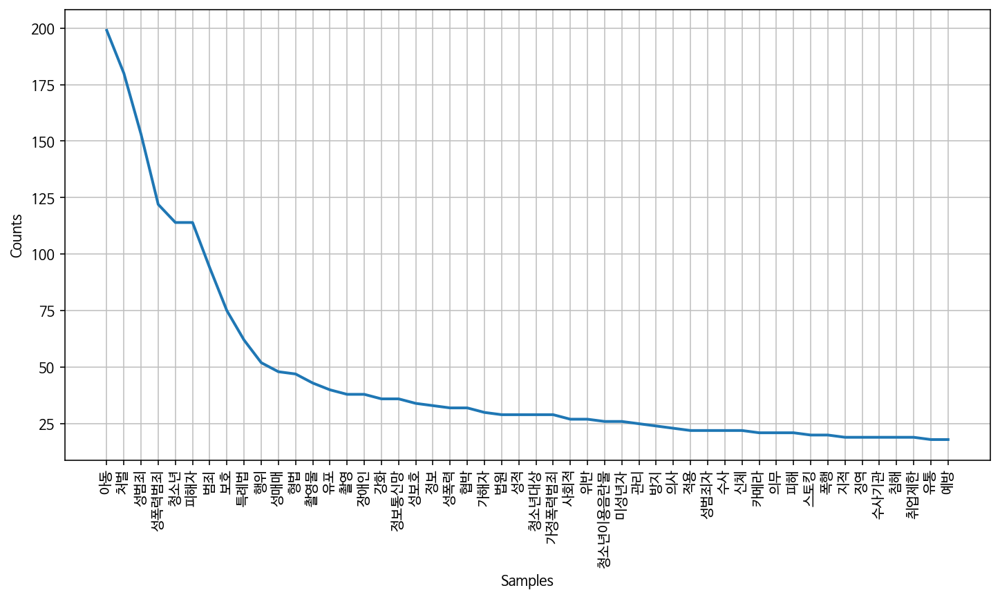

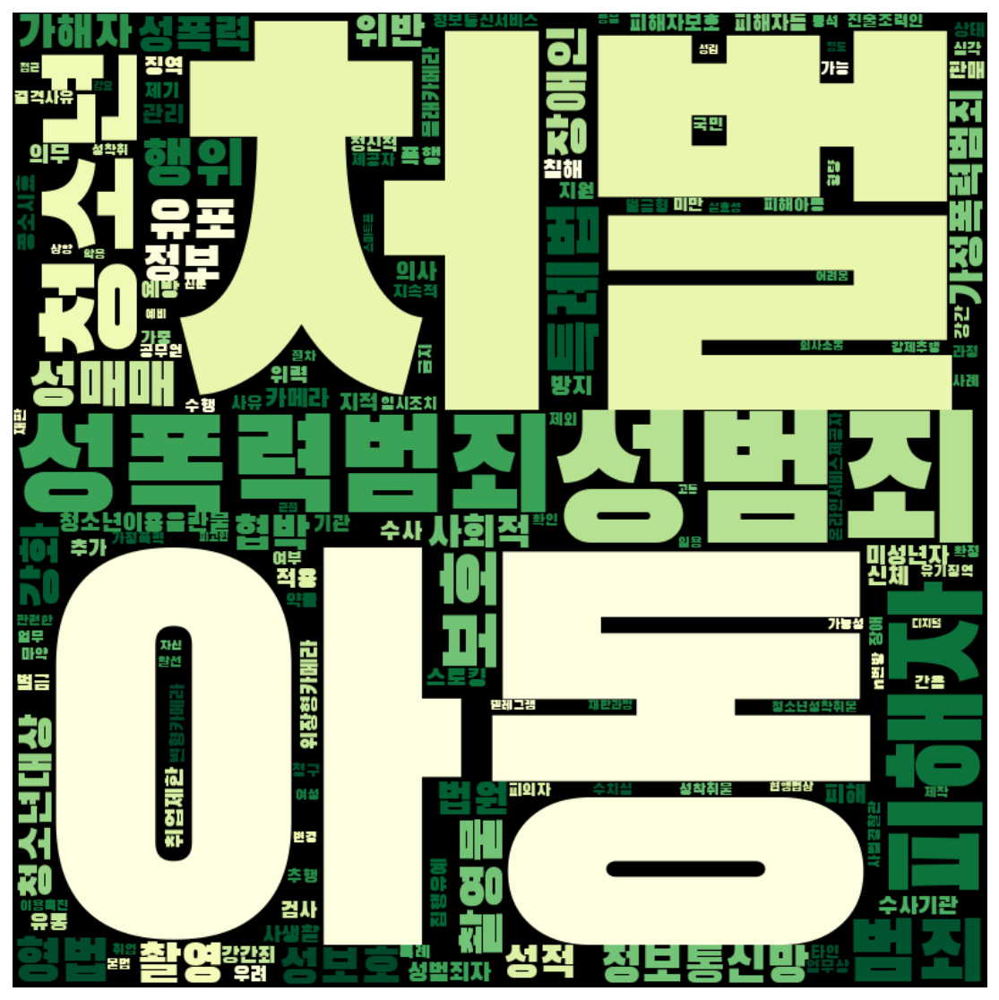

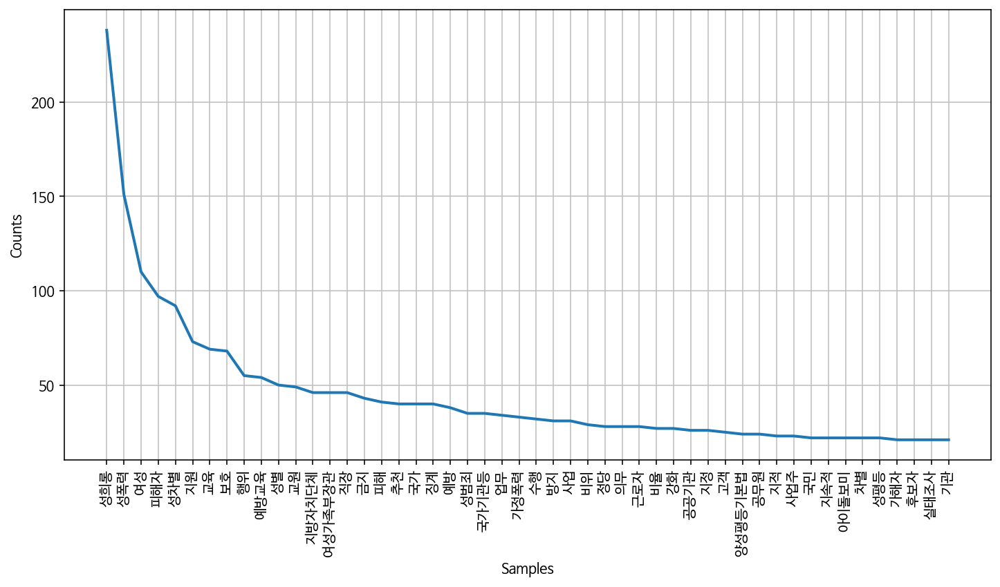

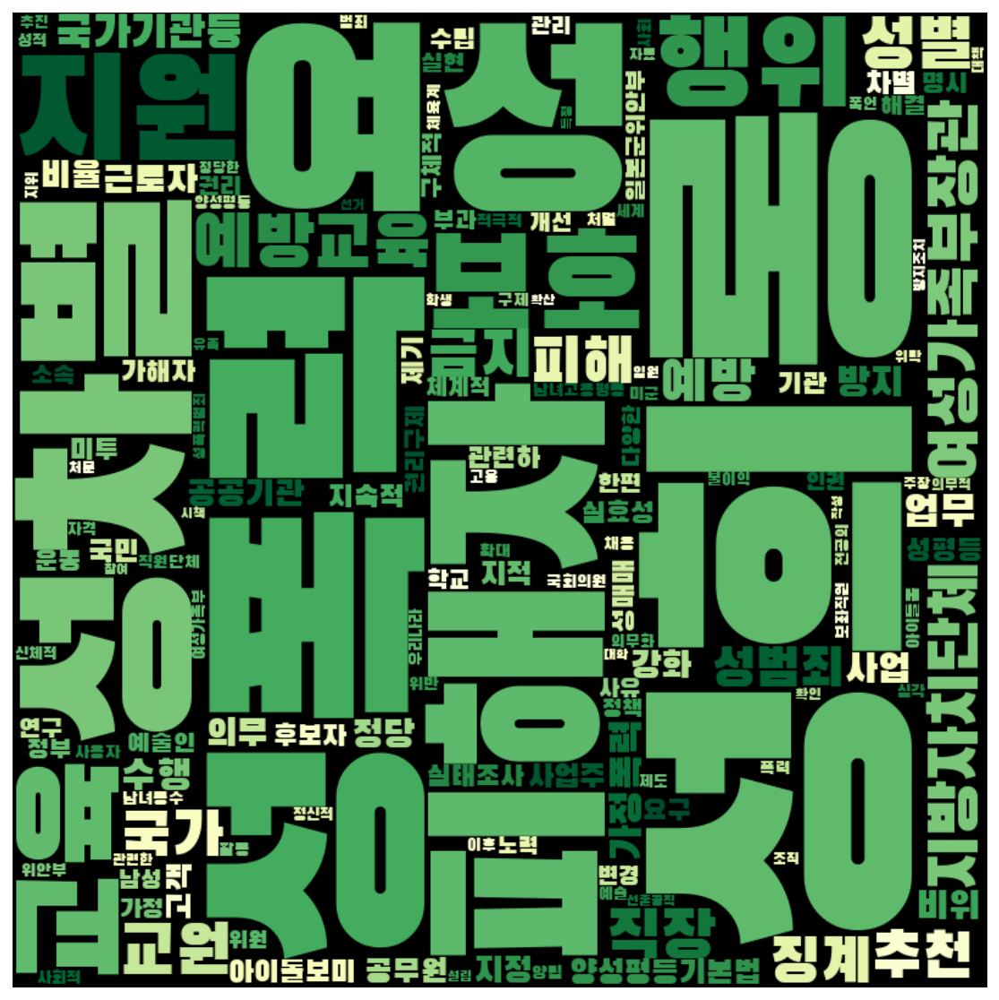

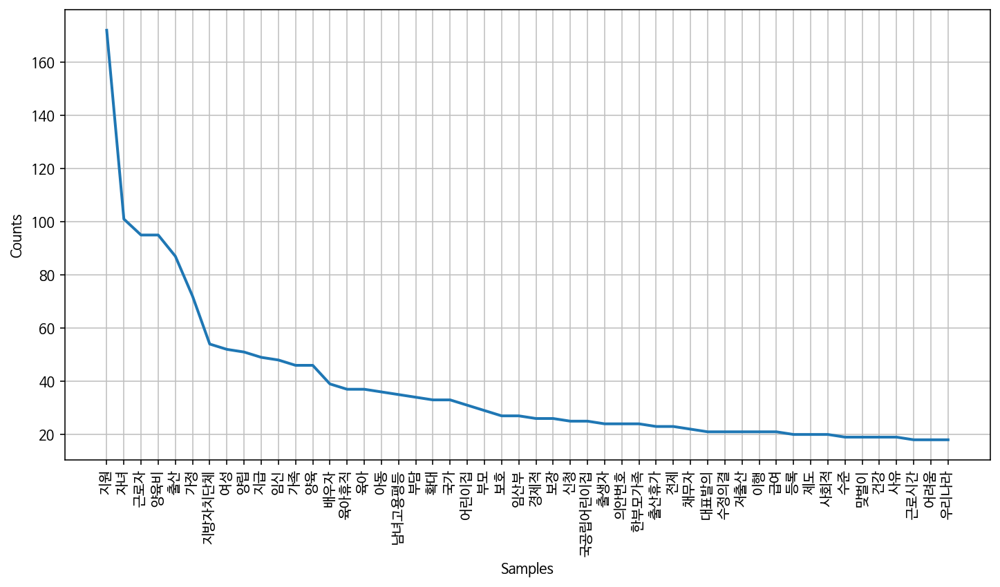

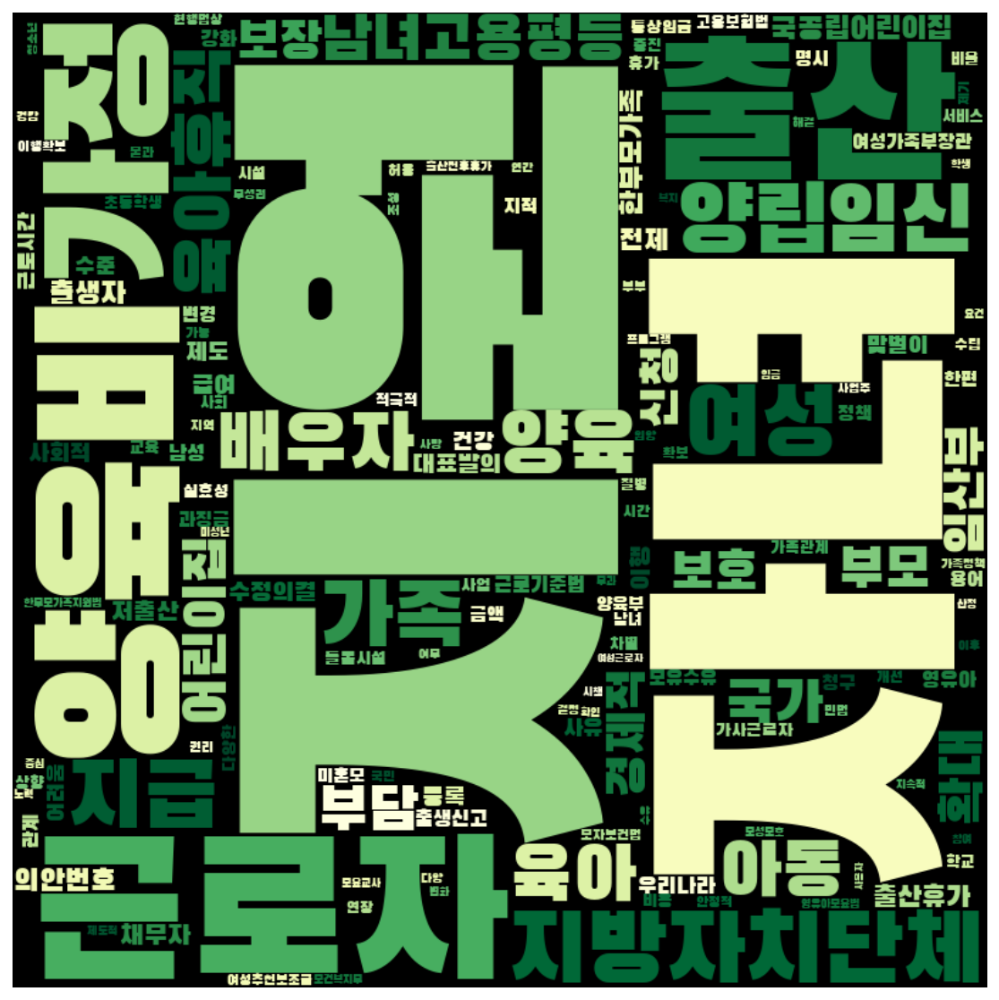

In [121]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens,'YlGn')

frewords_vis(pro_women_g3_tokens)
wordcloud_vis(pro_women_g3_tokens,'YlGn')

In [122]:
pro_men = pro_men[pro_men['명사수'] > 1]

# K means 수행 
word_vectors_pro_men = pro_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_men)
pro_men['category'] = idx

print(pro_men['category'].value_counts())

pro_men_g1 = pro_men[pro_men['category'] == 0]
pro_men_g2 = pro_men[pro_men['category'] == 1]
pro_men_g3 = pro_men[pro_men['category'] == 2]

pro_men_g1_tokens = total_tokens(pro_men_g1['tokens'])
pro_men_g2_tokens = total_tokens(pro_men_g2['tokens'])
pro_men_g3_tokens = total_tokens(pro_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_men_g1_tokens = [each_word for each_word in pro_men_g1_tokens if each_word not in stopwords]
pro_men_g2_tokens = [each_word for each_word in pro_men_g2_tokens if each_word not in stopwords]
pro_men_g3_tokens = [each_word for each_word in pro_men_g3_tokens if each_word not in stopwords]

2    283
0    226
1    219
Name: category, dtype: int64


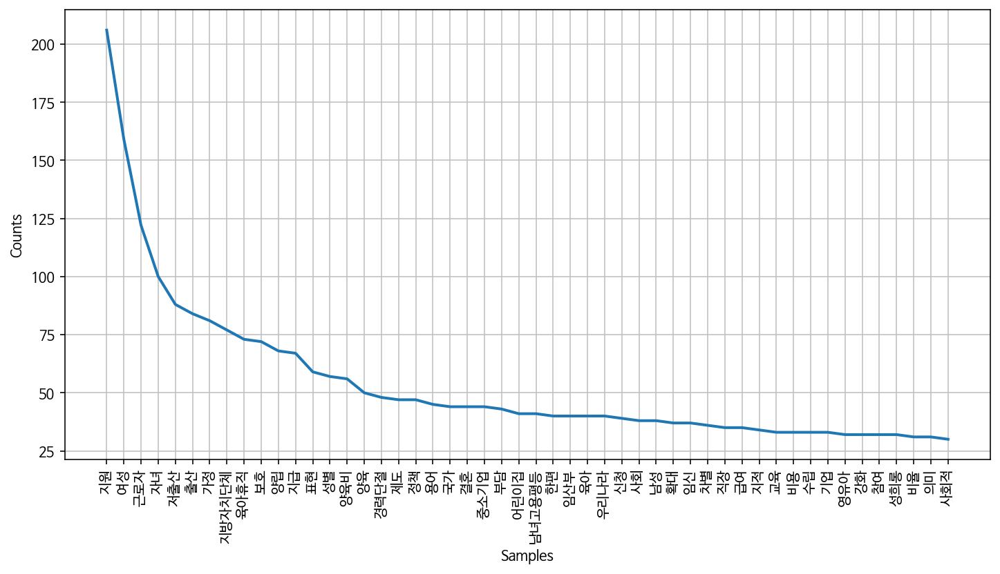

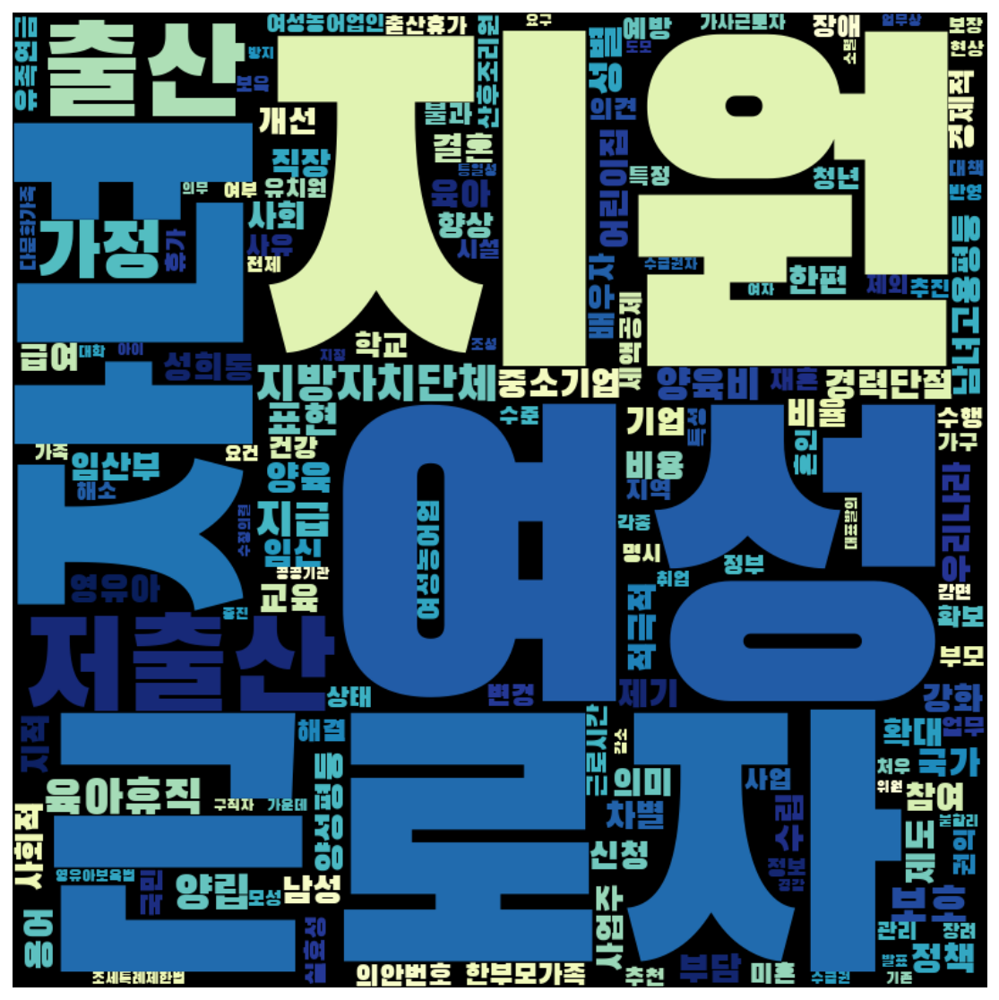

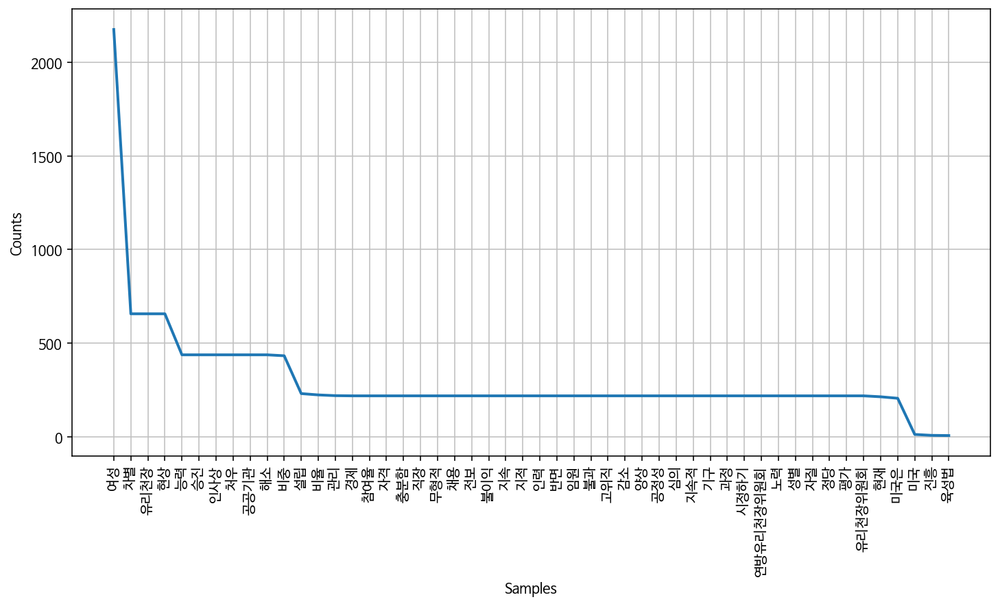

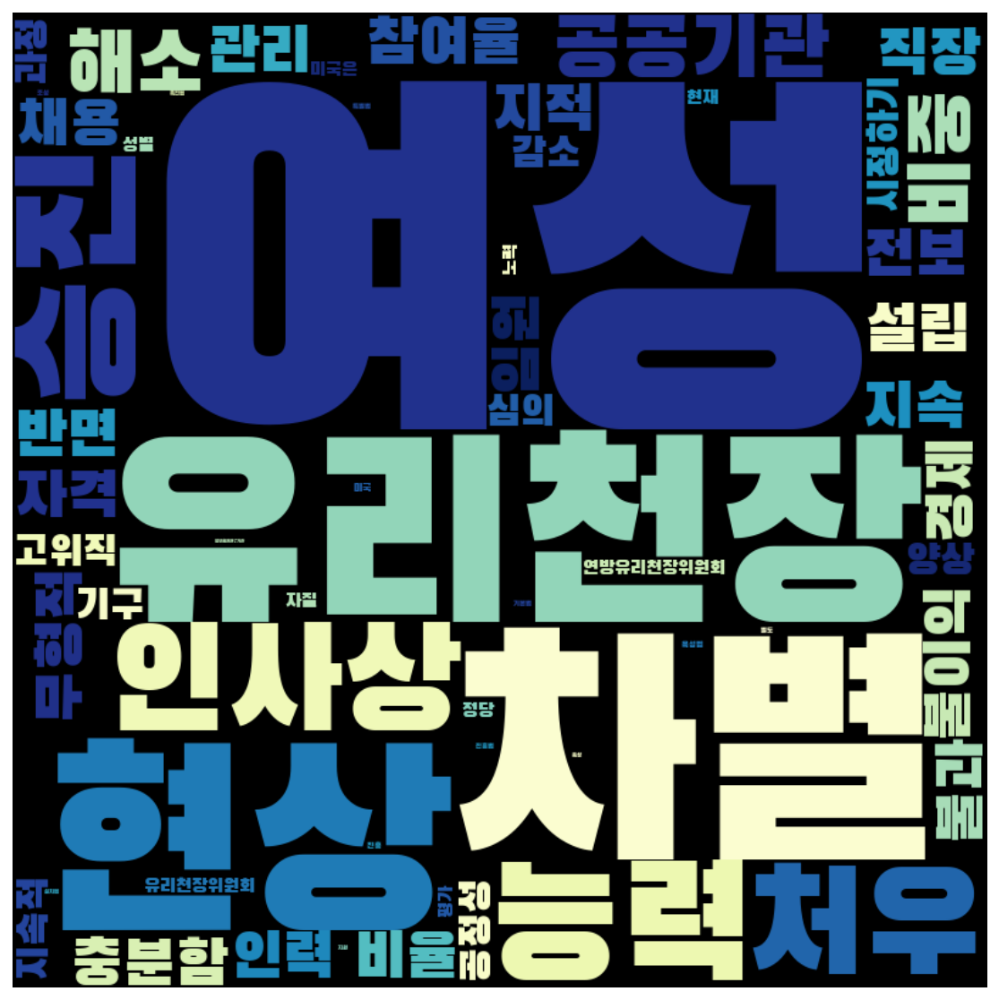

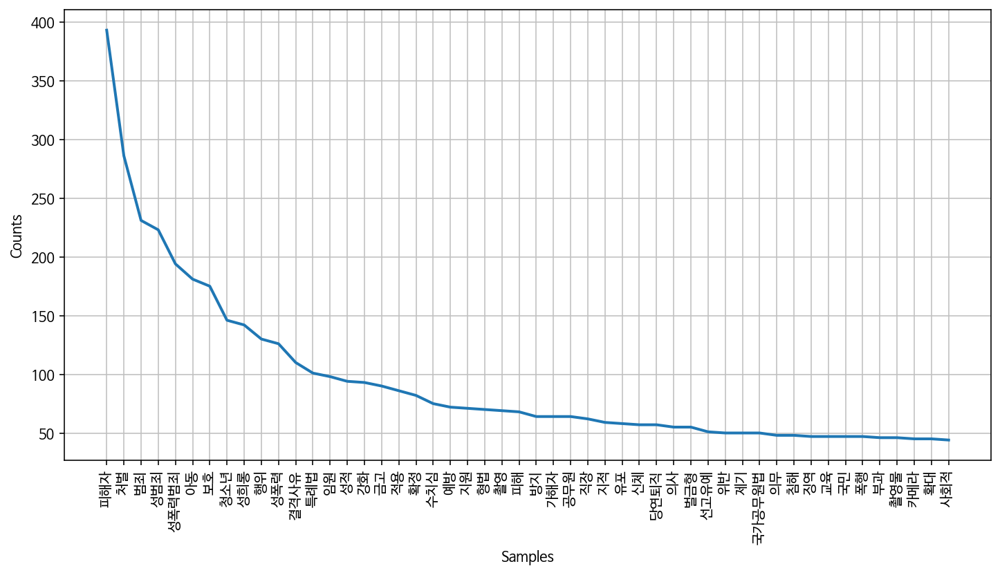

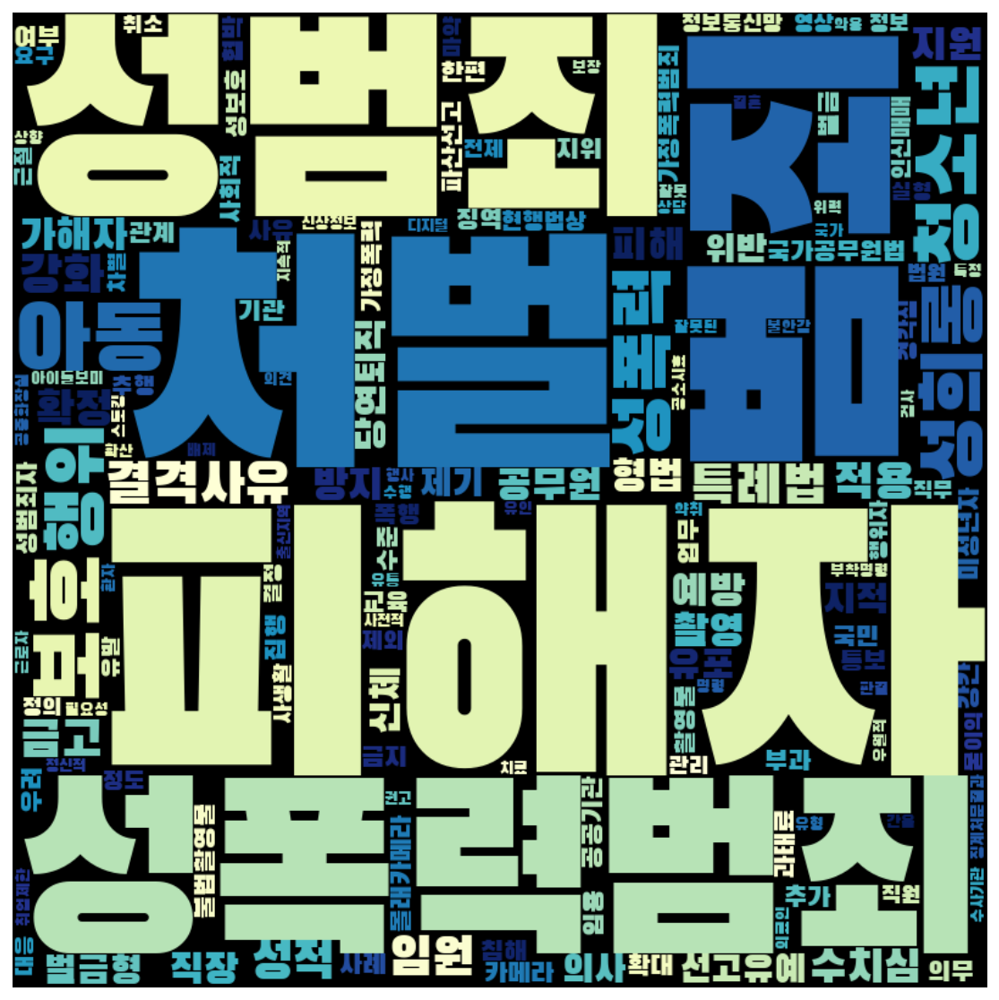

In [123]:
frewords_vis(pro_men_g1_tokens)
wordcloud_vis(pro_men_g1_tokens, 'YlGnBu')

frewords_vis(pro_men_g2_tokens)
wordcloud_vis(pro_men_g2_tokens, 'YlGnBu')

frewords_vis(pro_men_g3_tokens)
wordcloud_vis(pro_men_g3_tokens, 'YlGnBu')

In [124]:
con_women = con_women[con_women['명사수'] > 1]

# K means 수행 
word_vectors_con_women = con_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_women)
con_women['category'] = idx

print(con_women['category'].value_counts())

con_women_g1 = con_women[con_women['category'] == 0]
con_women_g2 = con_women[con_women['category'] == 1]
con_women_g3 = con_women[con_women['category'] == 2]

con_women_g1_tokens = total_tokens(con_women_g1['tokens'])
con_women_g2_tokens = total_tokens(con_women_g2['tokens'])
con_women_g3_tokens = total_tokens(con_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_women_g1_tokens = [each_word for each_word in con_women_g1_tokens if each_word not in stopwords]
con_women_g2_tokens = [each_word for each_word in con_women_g2_tokens if each_word not in stopwords]
con_women_g3_tokens = [each_word for each_word in con_women_g3_tokens if each_word not in stopwords]

2    91
0    72
1    21
Name: category, dtype: int64


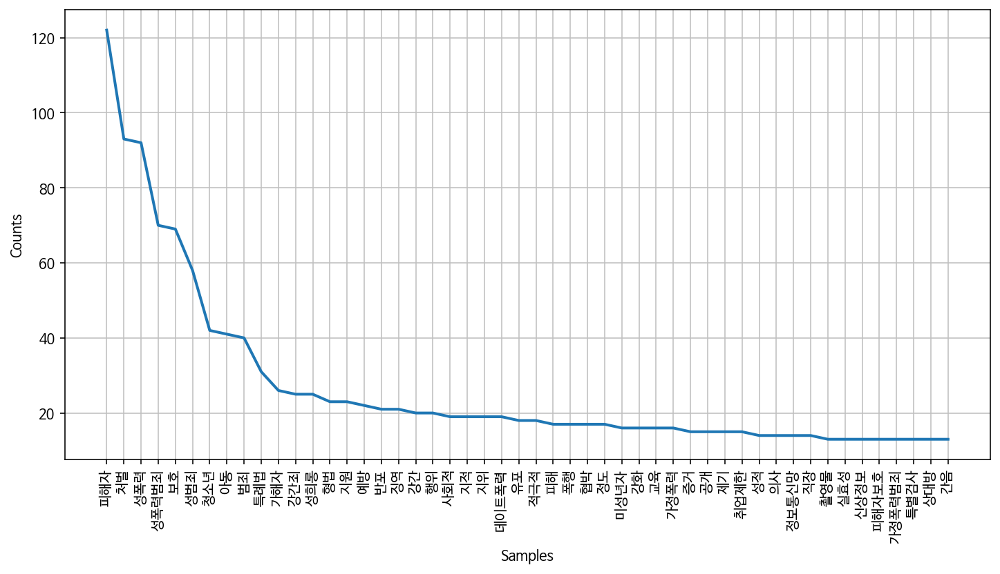

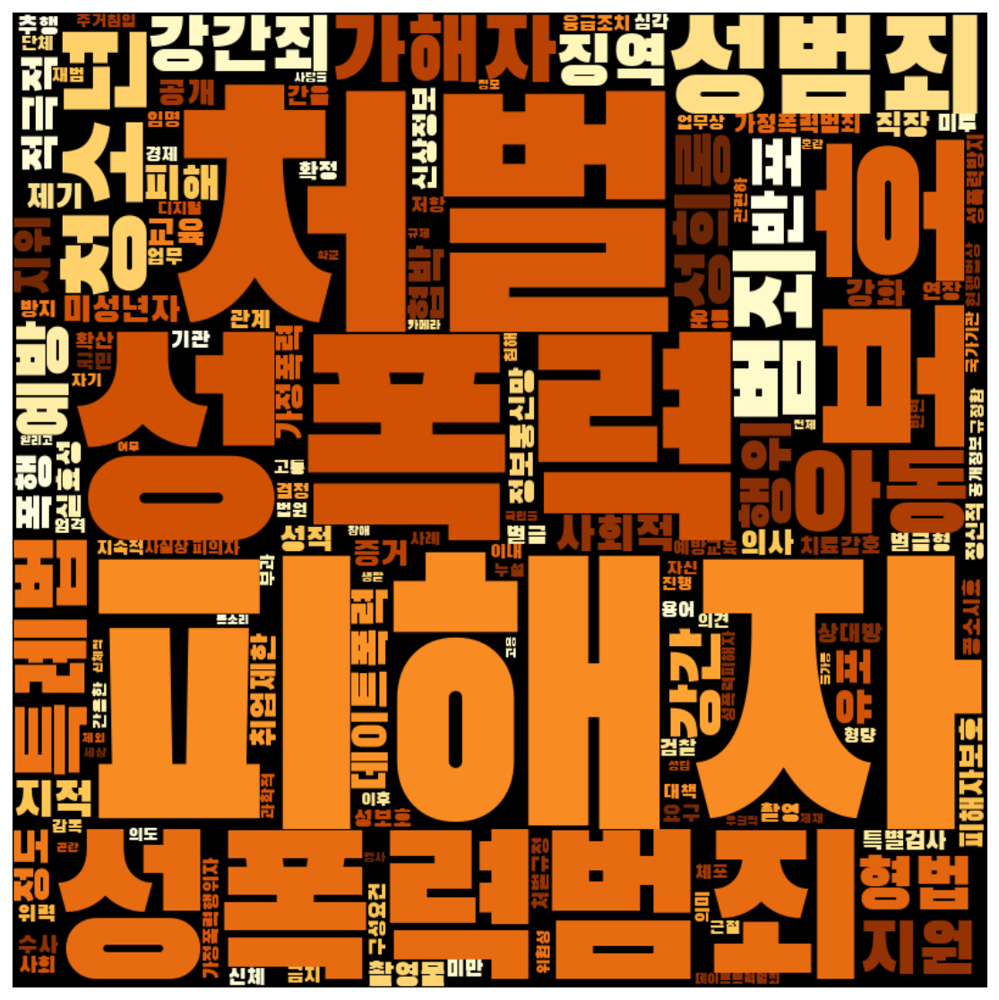

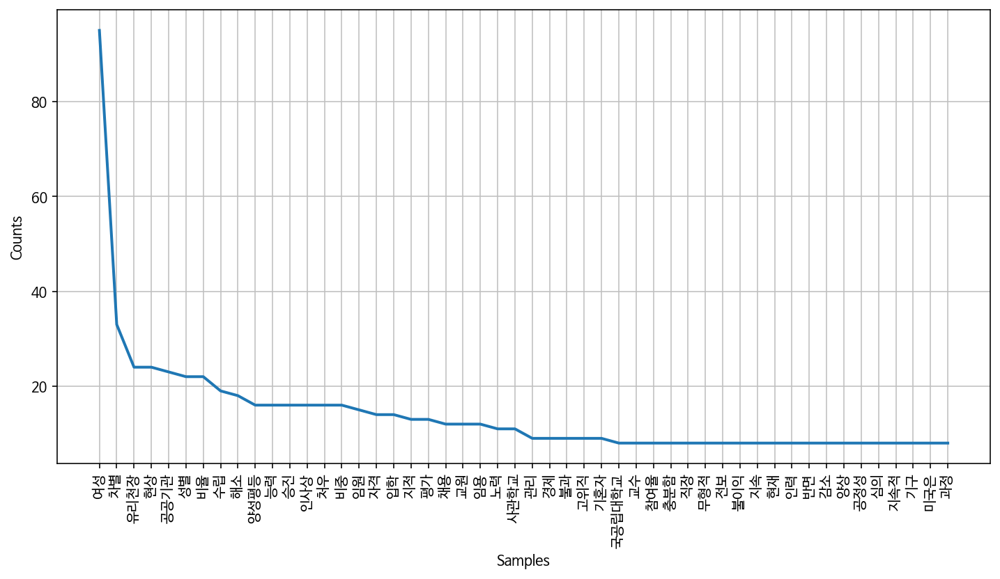

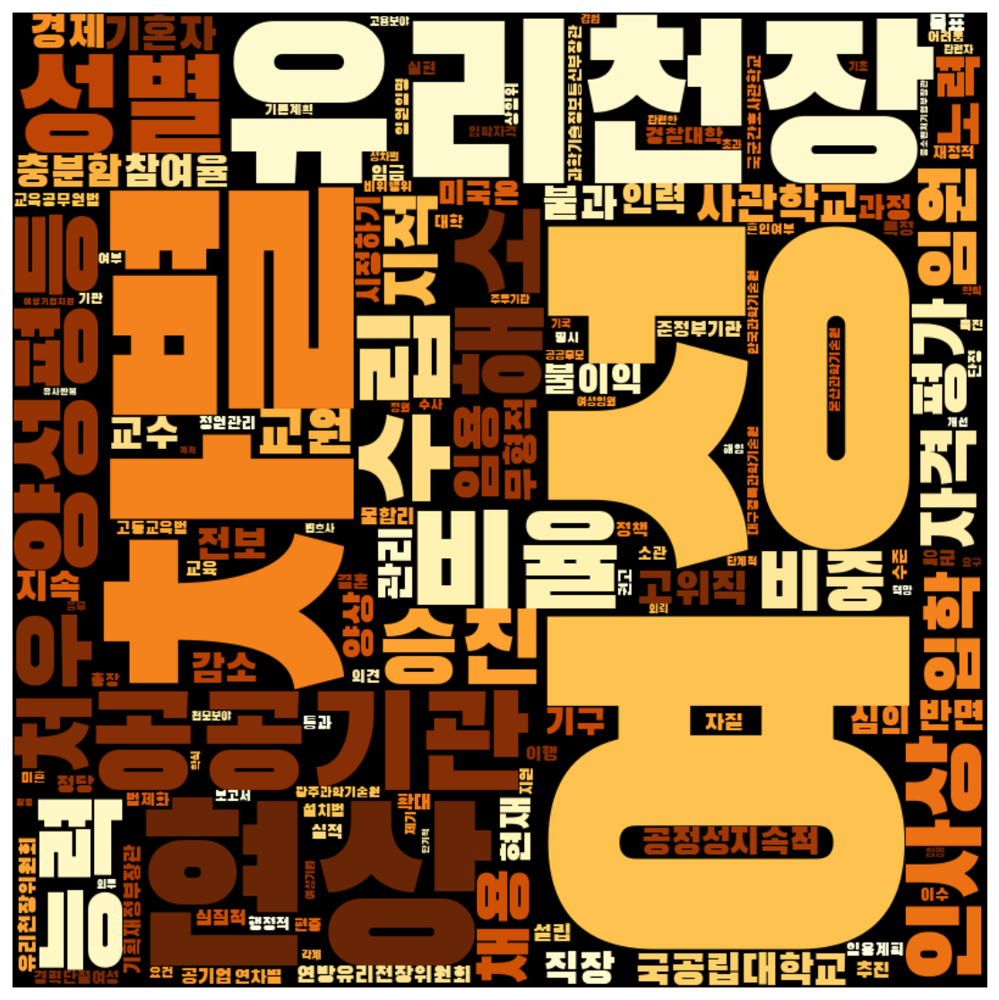

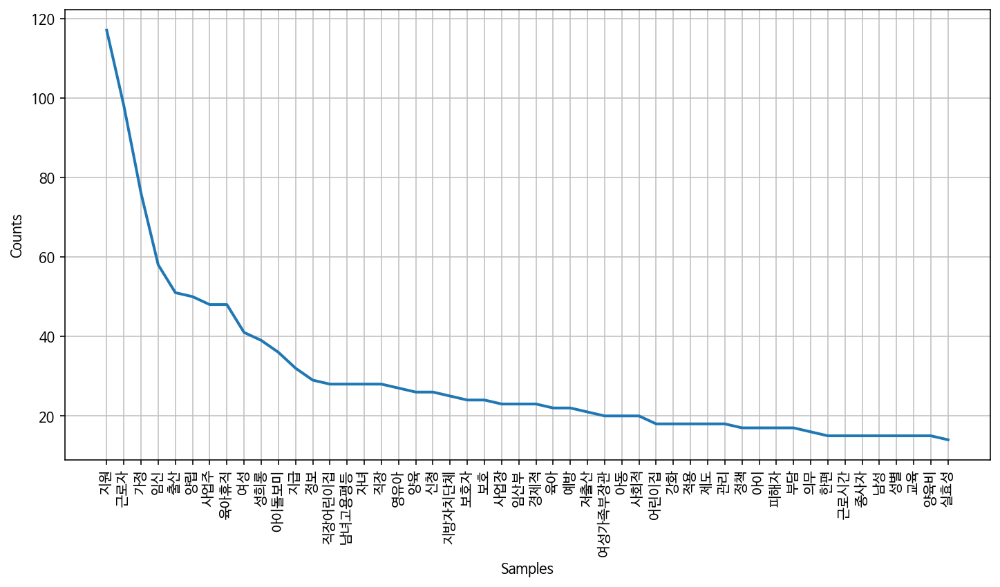

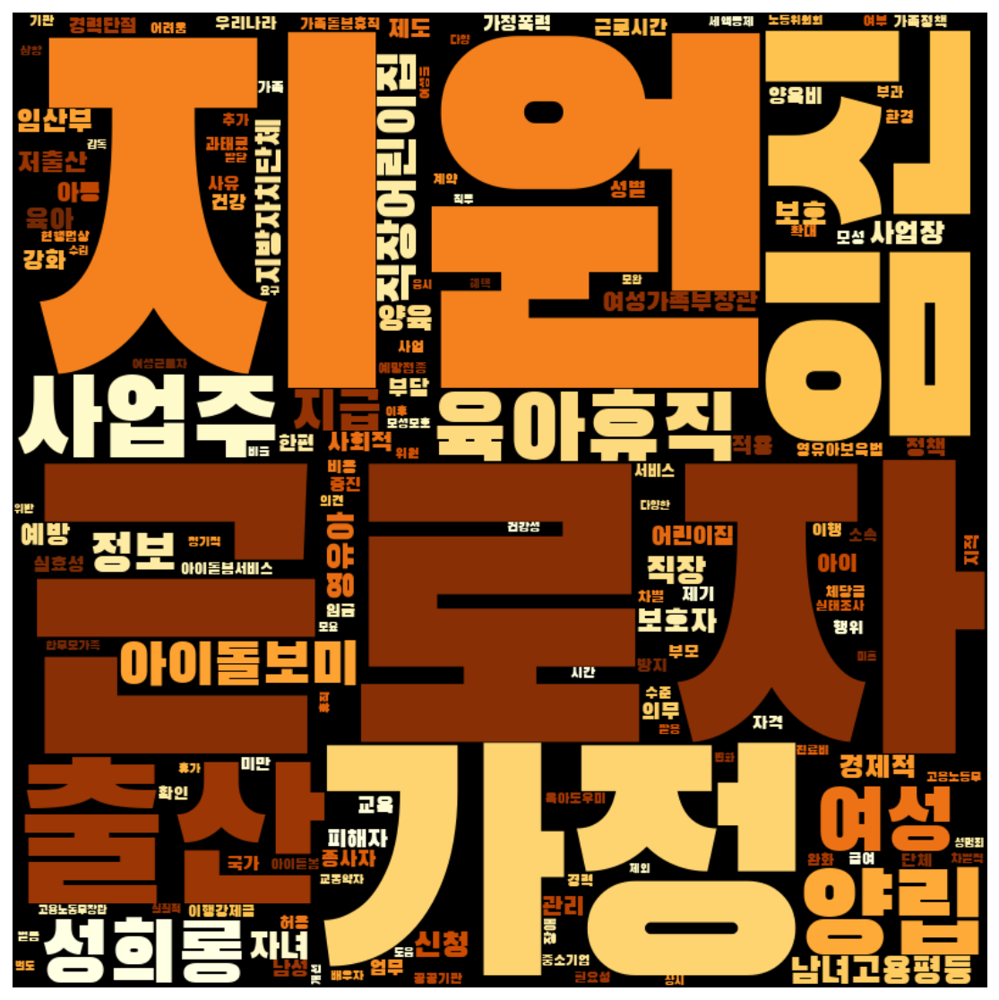

In [125]:
frewords_vis(con_women_g1_tokens)
wordcloud_vis(con_women_g1_tokens, 'YlOrBr')

frewords_vis(con_women_g2_tokens)
wordcloud_vis(con_women_g2_tokens, 'YlOrBr')

frewords_vis(con_women_g3_tokens)
wordcloud_vis(con_women_g3_tokens, 'YlOrBr')

In [126]:
con_men = con_men[con_men['명사수'] > 1]

# K means 수행 
word_vectors_con_men = con_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_men)
con_men['category'] = idx

print(con_men['category'].value_counts())

con_men_g1 = con_men[con_men['category'] == 0]
con_men_g2 = con_men[con_men['category'] == 1]
con_men_g3 = con_men[con_men['category'] == 2]

con_men_g1_tokens = total_tokens(con_men_g1['tokens'])
con_men_g2_tokens = total_tokens(con_men_g2['tokens'])
con_men_g3_tokens = total_tokens(con_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_men_g1_tokens = [each_word for each_word in con_men_g1_tokens if each_word not in stopwords]
con_men_g2_tokens = [each_word for each_word in con_men_g2_tokens if each_word not in stopwords]
con_men_g3_tokens = [each_word for each_word in con_men_g3_tokens if each_word not in stopwords]


ValueError: setting an array element with a sequence.

In [ ]:
frewords_vis(con_men_g1_tokens)
wordcloud_vis(con_men_g1_tokens, 'YlOrRd')

frewords_vis(con_men_g2_tokens)
wordcloud_vis(con_men_g2_tokens, 'YlOrRd')

frewords_vis(con_men_g3_tokens)
wordcloud_vis(con_men_g3_tokens, 'YlOrRd')